<a href="https://colab.research.google.com/github/MANMAID007/Road-Traffic-Accidents-Severity-Classification-Problem/blob/main/Python%20Notebooks/Road_Traffic_Accidents_Severity_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data
Data: https://www.kaggle.com/saurabhshahane/road-traffic-accidents

* Multiclass classification problem

In [1]:
# imports
# File system manangement
import time, psutil, os, sys

# colab data_table import
from google.colab import data_table
data_table.enable_dataframe_formatter()
data_table.DataTable.max_columns = 150

# Data manipulation
import numpy as np
np.set_printoptions(threshold=sys.maxsize)
import pandas as pd

# Plotting and visualization
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Missing data imputation
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer

# Categorical data encoding
from sklearn.preprocessing import LabelEncoder

# Train-test split and k-fold cross validation
from sklearn.model_selection import train_test_split, KFold,  GridSearchCV, cross_val_score, cross_validate

# Feature selection
from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif
from sklearn.decomposition import PCA

# Resampling
import imblearn
from imblearn.under_sampling import RandomUnderSampler, NearMiss
from imblearn.over_sampling import RandomOverSampler, SMOTE

# Classification algorithms
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import SGDClassifier
from sklearn.linear_model import RidgeClassifier
from sklearn.ensemble import AdaBoostClassifier

# Model evaluation
from sklearn import metrics
from sklearn.metrics import f1_score

# Hyperparameter tuning
!pip install optuna
import optuna

# Explainable AI
!pip install --quiet shap==0.39.0
import shap

# Warning suppression
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Loading the data
data = pd.read_csv('https://raw.githubusercontent.com/sugatagh/Road-Traffic-Accident-Severity-Classification/main/Dataset/RTA%20Dataset.csv')

# Stage 1:

### In this stage, we will apply simple transformations to visualize and analyse the data.

## General Functions

### All purpose use

In [ ]:
def format_float(x):
    return "{:.2f}".format(x)

def uniques(df, max_unique_values=20):
    '''
    This function returns a dataframe with unique value of each
    categorical column along with persentages of each categories.
    Input: Pandas DataFrame, max number of unique values should contain
           so that the the column quilifies as categorical data
    Output: Columns with unique values with ratio (in persentage)
    packages required: pandas, numpy
    '''
    column_list = df.columns
    df_len = len(df)
    req_col_list = []
    for column in column_list:
        x = len(df[column].unique())
        if x <= max_unique_values:
            req_col_list.append(column)
    df = df[req_col_list]
    d = {}
    for col in req_col_list:
        d[col] = []
        l = list(df[col].unique())
        if np.nan in l:
            l.remove(np.nan)
        col_value_counts = ((df[col].value_counts())/df_len) * 100
        for x in l:
            d[col].append(str(x) + ": " + str(format_float(col_value_counts[x])) + "%")
        if len(d[col]) < max_unique_values:
            d[col].extend([np.nan] * (max_unique_values - len(d[col])))

    df_uniques = pd.DataFrame(d)
    return df_uniques

def add_annotations(ax):
    '''
    Assign annotation to bar plot
    '''
    for p in ax.patches:
        frequency = p.get_height()
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_y() + p.get_height()
        ax.annotate(f'{frequency}', (x, y), size = 12, ha = 'center', va = 'bottom')

def column_barplot(df, column, target_col, top_fig_size=(20, 4), importance=2):
    '''
    This function give barplots for a cloumn along with th target column.
    In addition to that, it shows the relation between the column and the target column with barplot.
    Input: DataFrame, column with which you want to compare the target column, target column,
           figure size of main (first two) plots, importance which specifies if you want
           only top plot(1) or every plot.
    Output: Plots (no return)
    '''
    print("Showing Frequency Plots here for {}:\n".format(column))
    plt.figure(figsize = top_fig_size)
    ax_col = plt.subplot(1, 2, 1)
    count = sns.countplot(x = df[column])
    ax_col.set_xticklabels(labels = ax_col.get_xticklabels(), rotation = 90)
    ax_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_col)
    ax_target_col = plt.subplot(1, 2, 2)
    count = sns.countplot(x = df[target_col])
    ax_target_col.set_xticklabels(labels = ax_target_col.get_xticklabels(), rotation = 90)
    ax_target_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_target_col)
    plt.suptitle("Frequency of {} and {}".format(column, target_col), fontsize = 16)
    if importance == 1:
        plt.show()
    else:
        plt.show()

        print("\nShowing Frequency Comparison of {} vs {}\n".format(column, target_col))
        plt.figure(figsize = (18, 14))
        elements = list(df[column].unique())
        target_els = list(df[target_col].unique())
        if np.nan in elements:
            elements.remove(np.nan)
        l = len(elements)
        d = int(l / 3) + 1

        for i in range(l):
            ax = plt.subplot(d, 3, i+1)
            sub_df = df[df[column] == elements[i]]
            count = sns.countplot(x = sub_df[target_col], order=target_els)
            ax.set_title(str(elements[i]), fontsize=14)
            ax.set_xlabel('')
            ax.set_ylabel('')
            sns.despine(top = True, right = True)
            add_annotations(ax)
        plt.tight_layout()
        plt.suptitle("Frequency Comparison of {} vs {}".format(column, target_col), y=-0.03, fontsize = 16)
        plt.show()
    print("\n\n")

def na_count_table(df, show_missing_only=True):
    d = {"column": [], "na_count": [], "ratio (in persentage)": [], "is_missing": []}
    l = len(df)
    for col in df.columns:
        d["column"].append(col)
        d["na_count"].append(df[col].isna().sum())
        d["is_missing"].append(True if df[col].isna().sum() > 0 else False)
        d["ratio (in persentage)"].append(float(format_float((df[col].isna().sum() * 100) / l)))
    df_ = pd.DataFrame(d)
    if show_missing_only:
        return df_[df_.is_missing == True].drop("is_missing", axis=1)
    else:
        return df_.drop("is_missing", axis=1)

def missing_value_fillup_1(df, missed_col, fill_cats, target_col):
    df_ = df.copy()
    l = []
    for cat in fill_cats:
        df__ = df_[df_[missed_col] == cat]
        df__.drop(missed_col, axis=1, inplace=True)
        l.append(df__)
    final_values = []
    for df__ in l:
        x = []
        cols = [col for col in df__.columns if col is not target_col]
        for col in cols:
            x.append(max(df__[col].value_counts().to_dict().values()))
        final_values.append(int(sum(x) / len(x)))
    del df__
    missed_values = [x / sum(final_values) for x in final_values]
    df_["temp_col"] = df_[missed_col].apply(lambda x: True if x is np.nan else False)
    df_[missed_col] = df_.apply(lambda x: np.random.choice(fill_cats, p=missed_values) if x["temp_col"] else x[missed_col], axis=1)
    df_.drop("temp_col", axis=1, inplace=True)
    return df_

def convert_to_na(df, col, cats):
    df_ = df.copy()
    for cat in cats:
        assert cat in df_[col].unique(), f"Category {cat} is not in column {col}"
        df_[col] = df_[col].apply(lambda x: np.nan if x == cat else x)
    return df_

def cat_data_encoding(df, target_col, ohe=None, le=None, le_order=None):
    '''
    This function encode all column provided in the function arguments.
    The takes dataframe, target column, to be one-hot-encoded columns as 
    list, to be label-encoded columns as list and a list of lists which 
    contain the order of categories in  to be label-encoded columns.
    Note that the order should contain very categories of a column to
    be label-encoded. It also moves the target column to last. You 
    need to have each category as strings. Returns the modified
    dataframe.
    '''
    df_ = df.copy()
    assert target_col not in ohe, "Target column should not be label encoded"
    # one-hot-encoding
    if ohe is not None:
        for col in ohe:
            cats = list(df_[col].unique())
            assert np.nan not in cats, f"Remove NaN from column {col}"
            for cat in cats:
                df_[col + "_" + "_".join(cat.split(" "))] = df_[col].apply(lambda x: 1.0 if x == cat else 0)
            df_.drop(col, axis=1, inplace=True)
            df_.drop(sorted([col + "_" + "_".join(f.split(" ")) for f in cats])[-1], axis=1, inplace=True)
    # label-encoding
    if le is not None:
        assert len(le) == len(le_order), "Length of label encoding column and label encoding column order is not same."
        for i in range(len(le)):
            cats = list(df_[le[i]].unique())
            assert np.nan not in cats, f"Remove NaN from column {le[i]}"
            assert sorted(le_order[i]) == sorted(cats), f"The category order of column {le[i]} missing something..."
            d = {}
            idx = 1.0
            for cat in le_order[i]:
                d[cat] = idx
                idx += 1.0
            df_[le[i]] = df_[le[i]].map(d)
    # putting target column at the end of dataframe
    x = df_.pop(target_col)
    df_.insert(len(df_.columns), target_col, x)
    return df_

def heatmap(data, fig_size=(36, 27)):
    '''
    Generates Heatmap
    '''
    plt.figure(figsize = fig_size)
    sns.heatmap(data.corr(), annot = True, cmap = plt.cm.CMRmap_r)

def predictor_target_split(data, target):
    '''
    Splits target from main dataframe
    '''
    y = data[target] # target variable
    X = data.drop(target, axis = 1) # independent variables
    return X, y

### Dataframe related functions and pipeline

In [ ]:
def data_cat_reduction(df):
    '''
    This function reduces the number of categories.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df = df.copy()
    d = {}
    l = [f for f in df.Educational_level.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Junior high school" else val
    df["Educational_level"] = df["Educational_level"].map(d)

    d = {}
    l = [f for f in df.Vehicle_driver_relation.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Employee" else val
    df["Vehicle_driver_relation"] = df["Vehicle_driver_relation"].map(d)

    d = {}
    l = [f for f in df.Type_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Ridden horse', 'Other', 'Bajaj', 'Turbo', 'Motorcycle', 'Special vehicle', 'Bicycle'] else val
    df["Type_of_vehicle"] = df["Type_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Owner_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Owner" else val
    df["Owner_of_vehicle"] = df["Owner_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Area_accident_occured.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['  Recreational areas', ' Industrial areas', 'Other', ' Church areas', '  Market areas', 'Unknown', 'Rural village areas', ' Outside rural areas', ' Hospital areas', 'School areas', 'Rural village areasOffice areas', 'Recreational areas'] else val
    df["Area_accident_occured"] = df["Area_accident_occured"].map(d)

    d = {}
    l = [f for f in df.Road_allignment.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Tangent road with mild grade and flat terrain', 'Escarpments', 'Tangent road with rolling terrain', 'Gentle horizontal curve', 'Tangent road with mountainous terrain and', 'Steep grade downward with mountainous terrain', 'Sharp reverse curve', 'Steep grade upward with mountainous terrain'] else val
    df["Road_allignment"] = df["Road_allignment"].map(d)

    d = {}
    l = [f for f in df.Types_of_Junction.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['O Shape', 'Other', 'Unknown', 'T Shape', 'X Shape'] else val
    df["Types_of_Junction"] = df["Types_of_Junction"].map(d)

    d = {}
    l = [f for f in df.Road_surface_type.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Earth roads', 'Asphalt roads with some distress', 'Gravel roads', 'Other'] else val
    df["Road_surface_type"] = df["Road_surface_type"].map(d)

    d = {}
    l = [f for f in df.Road_surface_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Snow', 'Flood over 3cm. deep'] else val
    df["Road_surface_conditions"] = df["Road_surface_conditions"].map(d)

    d = {}
    l = [f for f in df.Weather_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Raining', 'Raining and Windy', 'Cloudy', 'Other', 'Windy', 'Snow', 'Unknown', 'Fog or mist'] else val
    df["Weather_conditions"] = df["Weather_conditions"].map(d)

    d = {}
    l = [f for f in df.Type_of_collision.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Collision with roadside-parked vehicles', 'Collision with animals', 'Other', 'Rollover', 'Fall from vehicles', 'Collision with pedestrians', 'With Train', 'Unknown'] else val
    df["Type_of_collision"] = df["Type_of_collision"].map(d)

    d = {}
    l = [f for f in df.Vehicle_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['U-Turn', 'Waiting to go', 'Unknown', 'Parked', 'Stopping', 'Overtaking', 'Other', 'Entering a junction'] else val
    df["Vehicle_movement"] = df["Vehicle_movement"].map(d)

    d = {}
    l = [f for f in df.Work_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Other', 'Unemployed', 'Student', 'Unknown'] else val
    df["Work_of_casuality"] = df["Work_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Fitness_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Deaf', 'Other', 'Blind', 'NormalNormal'] else val
    df["Fitness_of_casuality"] = df["Fitness_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Pedestrian_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Possibly Pedestrian" if val in ["Crossing from driver's nearside", 'Crossing from nearside - masked by parked or statioNot a Pedestrianry vehicle', 'Unknown or other', 'Crossing from offside - masked by  parked or statioNot a Pedestrianry vehicle', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing)', 'Walking along in carriageway, back to traffic', 'Walking along in carriageway, facing traffic', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing) - masked by parked or statioNot a Pedestrianry vehicle'] else val
    df["Pedestrian_movement"] = df["Pedestrian_movement"].map(d)
    return df

def modify_time_column(df):
    '''
    This function modifies the Time column and converts it
    to categorical column.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df['Time_of_Day'] = df.Time.apply(lambda x: int(x.split(":")[0]))
    df.Time_of_Day = df.Time_of_Day.apply(lambda x: "Morning" if 6 <= x <= 12 else ("Afternoon" if 12 < x <= 18 else ("Evening" if 18 < x <= 22 else "Night")))
    del df["Time"]
    t = df.pop("Time_of_Day")
    df.insert(0, "Time_of_day", t)
    return df

def missing_value_imputation(df):
    # missing more than 20%
    df.drop("Service_year_of_vehicle", axis=1, inplace=True)
    df.drop("Defect_of_vehicle", axis=1, inplace=True)
    df.drop("Fitness_of_casuality", axis=1, inplace=True)
    df = missing_value_fillup_1(df, "Work_of_casuality", ['Driver', 'Self-employed'], "Accident_severity")
    # missing less than 5%
    df.Area_accident_occured.fillna("Others", inplace=True)
    df.Road_allignment.fillna("Tangent road with flat terrain", inplace=True)
    df.Road_surface_type.fillna("Asphalt roads", inplace=True)
    df.Type_of_collision.fillna("Vehicle with vehicle collision", inplace=True)
    df.Vehicle_movement.fillna("Going straight", inplace=True)
    df.Owner_of_vehicle.fillna("Owner", inplace=True)
    df = convert_to_na(df, "Lanes_or_Medians", ["Unknown"])
    df = missing_value_fillup_1(df, "Lanes_or_Medians", ['Undivided Two way', 'Two-way (divided with broken lines road marking)'], "Accident_severity")
    df.Vehicle_driver_relation.fillna("Employee", inplace=True)
    # missing more than 5%
    df = missing_value_fillup_1(df, "Educational_level", ['Junior high school', 'Others'], "Accident_severity")
    df = convert_to_na(df, "Driving_experience", ["unknown"])
    df = missing_value_fillup_1(df, "Driving_experience", ['1-2yr', 'Above 10yr', '5-10yr', '2-5yr', 'Below 1yr'], "Accident_severity")
    df = missing_value_fillup_1(df, "Type_of_vehicle", ['Automobile', 'Lorry (41?100Q)'], "Accident_severity")
    df = missing_value_fillup_1(df, "Types_of_Junction", ['No junction', 'Y Shape'], "Accident_severity")
    # Remaining missings
    df.drop("Casualty_class", axis=1, inplace=True)
    df.drop("Sex_of_casualty", axis=1, inplace=True)
    df.drop("Age_band_of_casualty", axis=1, inplace=True)
    df.drop("Casualty_severity", axis=1, inplace=True)
    df = convert_to_na(df, "Sex_of_driver", ["Unknown"])
    df.Sex_of_driver.fillna("Male", inplace=True)
    df = convert_to_na(df, "Cause_of_accident", ["Unknown"])
    df.Cause_of_accident.fillna("No distancing", inplace=True)
    df = convert_to_na(df, "Age_band_of_driver", ["Unknown"])
    df = missing_value_fillup_1(df, "Age_band_of_driver", ['18-30', '31-50'], "Accident_severity")
    return df

def categorical_encoding_df(df):
    df_ = df.copy()
    ohe = ["Time_of_day", "Day_of_week", "Sex_of_driver", "Vehicle_driver_relation", "Type_of_vehicle", "Owner_of_vehicle", \
       "Area_accident_occured", "Lanes_or_Medians", "Road_allignment", "Types_of_Junction", "Road_surface_type", \
       "Road_surface_conditions", "Type_of_collision", "Vehicle_movement", "Work_of_casuality", "Pedestrian_movement", "Cause_of_accident"]
    le = ["Age_band_of_driver", "Educational_level", "Driving_experience", "Light_conditions", "Weather_conditions", "Accident_severity"]
    abod = ["Under 18", "18-30", "31-50", "Over 51"]
    edl = ["Junior high school", "Others"]
    dre = ["No Licence", "Below 1yr", "1-2yr", "2-5yr", "5-10yr", "Above 10yr"]
    lc = ["Daylight", "Darkness - lights lit", "Darkness - lights unlit", "Darkness - no lighting"]
    wc = ["Normal", "Others"]
    accs = ["Slight Injury", "Serious Injury", "Fatal injury"]
    le_order = [abod, edl, dre, lc, wc, accs]
    df_cat = cat_data_encoding(df_, target_col, ohe=ohe, le=le, le_order=le_order)
    return df_cat

## Understanding The Data

### A thorough look of the data

#### First look
Reading the data and checking the columns. 

In [ ]:
data.head()

,Time,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,17:02:00,Monday,18-30,Male,Above high school,Employee,1-2yr,Automobile,Owner,Above 10yr,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Moving Backward,Slight Injury
1,17:02:00,Monday,31-50,Male,Junior high school,Employee,Above 10yr,Public (> 45 seats),Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury
2,17:02:00,Monday,18-30,Male,Junior high school,Employee,1-2yr,Lorry (41?100Q),Owner,NaN,...,Going straight,Driver or rider,Male,31-50,3,Driver,NaN,Not a Pedestrian,Changing lane to the left,Serious Injury
3,1:06:00,Sunday,18-30,Male,Junior high school,Employee,5-10yr,Public (> 45 seats),Governmental,NaN,...,Going straight,Pedestrian,Female,18-30,3,Driver,Normal,Not a Pedestrian,Changing lane to the right,Slight Injury
4,1:06:00,Sunday,18-30,Male,Junior high school,Employee,2-5yr,NaN,Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury


In [ ]:
data.shape

(12316, 32)

In [ ]:
data.columns

Index(['Time', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Service_year_of_vehicle',
       'Defect_of_vehicle', 'Area_accident_occured', 'Lanes_or_Medians',
       'Road_allignment', 'Types_of_Junction', 'Road_surface_type',
       'Road_surface_conditions', 'Light_conditions', 'Weather_conditions',
       'Type_of_collision', 'Number_of_vehicles_involved',
       'Number_of_casualties', 'Vehicle_movement', 'Casualty_class',
       'Sex_of_casualty', 'Age_band_of_casualty', 'Casualty_severity',
       'Work_of_casuality', 'Fitness_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

In [ ]:
unique_data = uniques(data)
unique_data

,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,Defect_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Monday: 13.65%,18-30: 34.68%,Male: 92.86%,Above high school: 2.94%,Employee: 78.17%,1-2yr: 14.26%,Automobile: 26.02%,Owner: 84.92%,Above 10yr: 10.75%,No defect: 63.15%,...,Going straight: 66.24%,na: 36.08%,na: 36.08%,na: 36.08%,na: 36.08%,Driver: 47.93%,Normal: 78.01%,Not a Pedestrian: 92.48%,Moving Backward: 9.23%,Slight Injury: 84.56%
1,Sunday: 11.91%,31-50: 33.18%,Female: 5.69%,Junior high school: 61.86%,Unknown: 0.11%,Above 10yr: 18.37%,Public (> 45 seats): 3.28%,Governmental: 8.45%,5-10yrs: 10.39%,7: 0.62%,...,U-Turn: 0.41%,Driver or rider: 40.14%,Male: 42.65%,31-50: 19.93%,3: 57.45%,Other: 3.76%,Deaf: 0.15%,Crossing from driver's nearside: 1.14%,Overtaking: 3.49%,Serious Injury: 14.15%
2,Friday: 16.57%,Under 18: 6.70%,Unknown: 1.45%,Elementary school: 17.56%,Owner: 16.02%,5-10yr: 27.31%,Lorry (41?100Q): 17.75%,Organization: 2.53%,1-2yr: 6.71%,5: 0.29%,...,Moving Backward: 8.00%,Pedestrian: 13.39%,Female: 21.27%,18-30: 25.54%,2: 6.26%,Unemployed: 0.27%,Other: 0.15%,Crossing from nearside - masked by parked or s...,Changing lane to the left: 11.96%,Fatal injury: 1.28%
3,Wednesday: 14.94%,Over 51: 12.87%,NaN,High school: 9.01%,Other: 1.00%,2-5yr: 21.22%,Public (13?45 seats): 4.32%,Other: 0.18%,2-5yrs: 14.55%,NaN,...,Turnover: 3.97%,Passenger: 10.39%,NaN,Under 18: 8.40%,1: 0.21%,Employee: 4.49%,Blind: 0.15%,Unknown or other: 2.38%,Changing lane to the right: 14.68%,NaN
4,Saturday: 13.53%,Unknown: 12.57%,NaN,Unknown: 0.81%,NaN,No Licence: 0.96%,Lorry (11?40Q): 4.39%,NaN,Unknown: 23.41%,NaN,...,Waiting to go: 0.32%,NaN,NaN,Over 51: 8.07%,NaN,Self-employed: 16.60%,NormalNormal: 0.15%,Crossing from offside - masked by parked or s...,Overloading: 0.48%,NaN
5,Thursday: 15.03%,NaN,NaN,Illiterate: 0.37%,NaN,Below 1yr: 10.90%,Long lorry: 3.11%,NaN,Below 1yr: 2.29%,NaN,...,Getting off: 2.75%,NaN,NaN,5: 1.98%,NaN,Student: 0.84%,NaN,"In carriageway, statioNot a Pedestrianry - not...",Other: 3.70%,NaN
6,Tuesday: 14.37%,NaN,NaN,Writing & reading: 1.43%,NaN,unknown: 0.27%,Public (12 seats): 5.77%,NaN,NaN,NaN,...,Reversing: 4.57%,NaN,NaN,NaN,NaN,Unknown: 0.15%,NaN,"Walking along in carriageway, back to traffic:...",No priority to vehicle: 9.80%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.15%,NaN,NaN,NaN,...,Unknown: 0.71%,NaN,NaN,NaN,NaN,NaN,NaN,"Walking along in carriageway, facing traffic: ...",No priority to pedestrian: 5.85%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.58%,NaN,NaN,NaN,...,Parked: 0.08%,NaN,NaN,NaN,NaN,NaN,NaN,"In carriageway, statioNot a Pedestrianry - not...",No distancing: 18.37%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.58%,NaN,NaN,NaN,...,Stopping: 0.50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Getting off the vehicle improperly: 1.60%,NaN


Showing Frequency Plots here for Day_of_week:



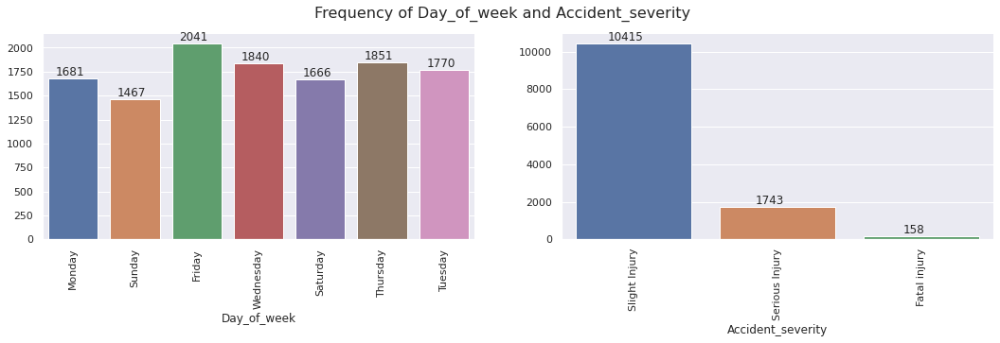


Showing Frequency Comparison of Day_of_week vs Accident_severity



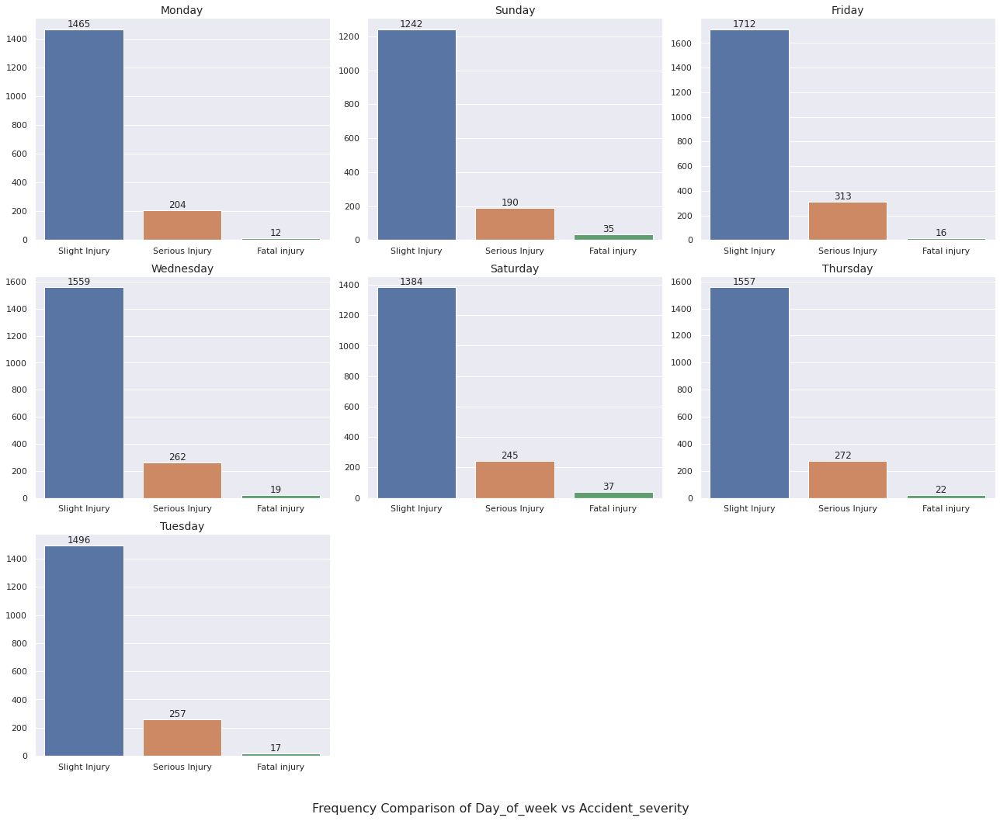




Showing Frequency Plots here for Age_band_of_driver:



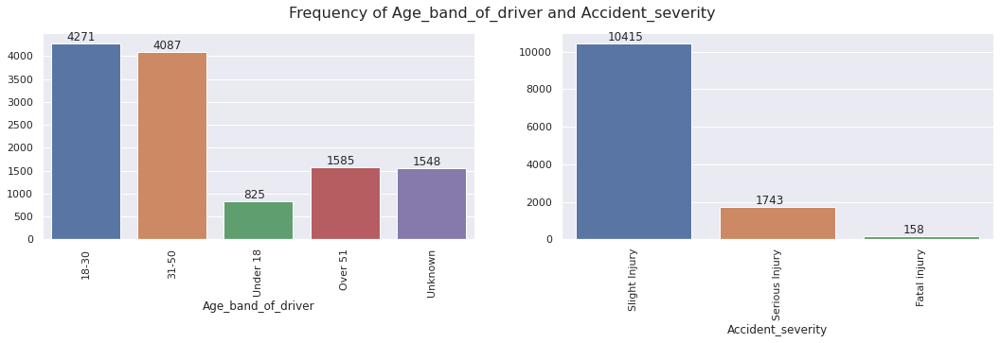


Showing Frequency Comparison of Age_band_of_driver vs Accident_severity



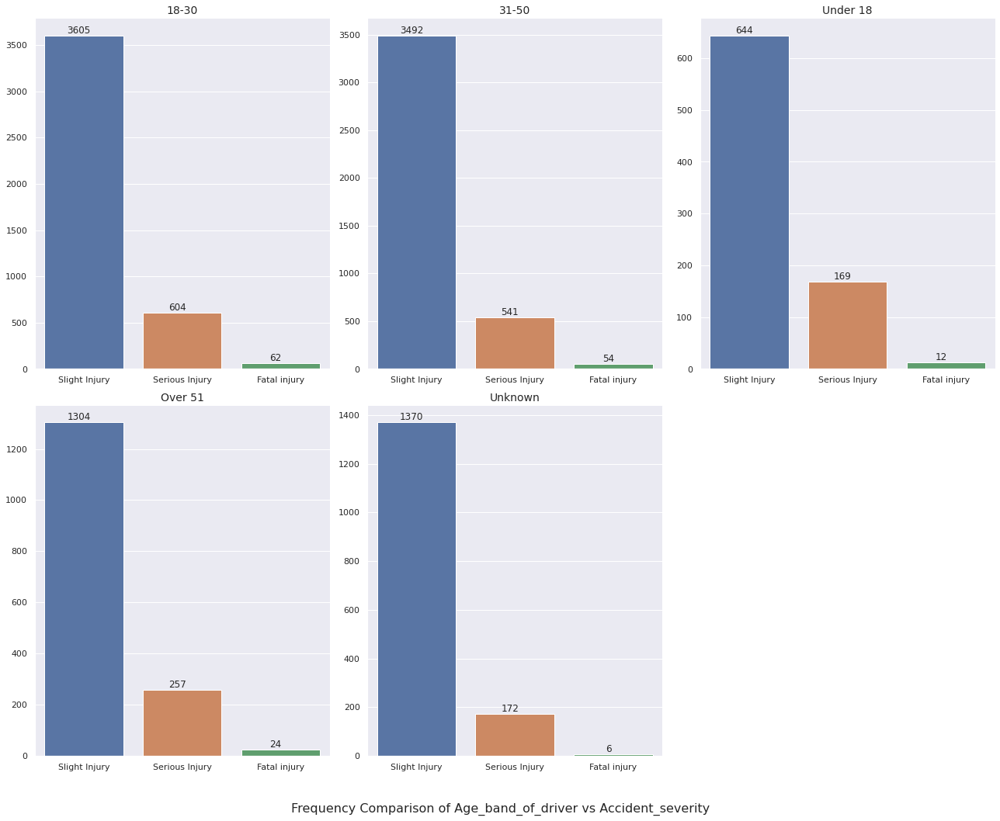




Showing Frequency Plots here for Sex_of_driver:



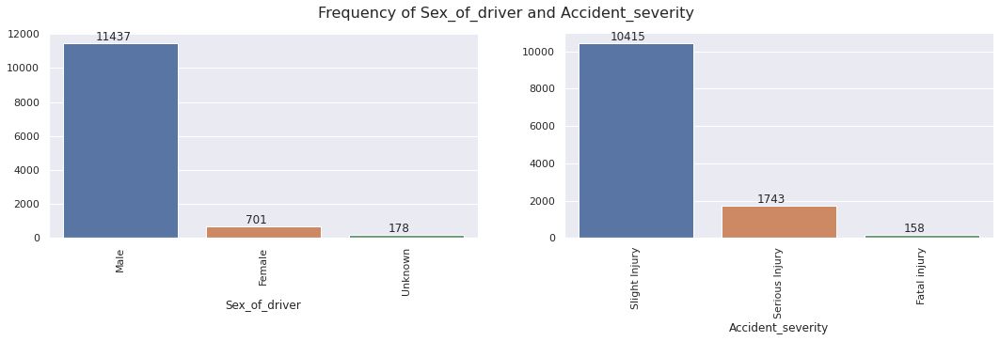


Showing Frequency Comparison of Sex_of_driver vs Accident_severity



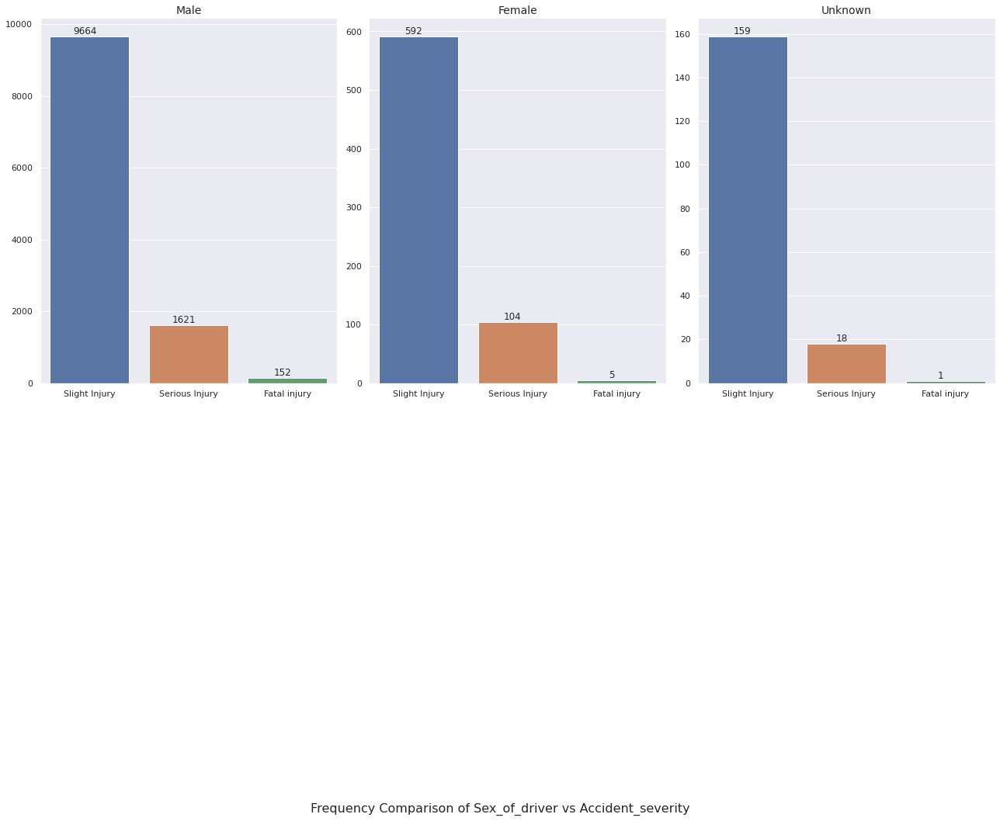




Showing Frequency Plots here for Educational_level:



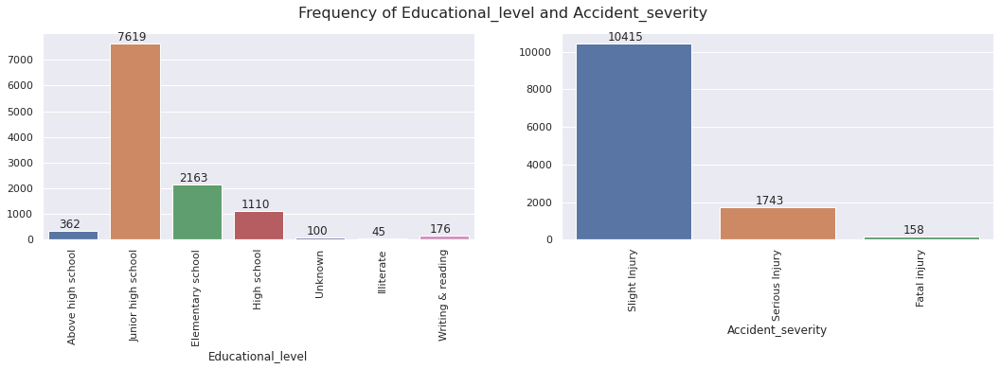


Showing Frequency Comparison of Educational_level vs Accident_severity



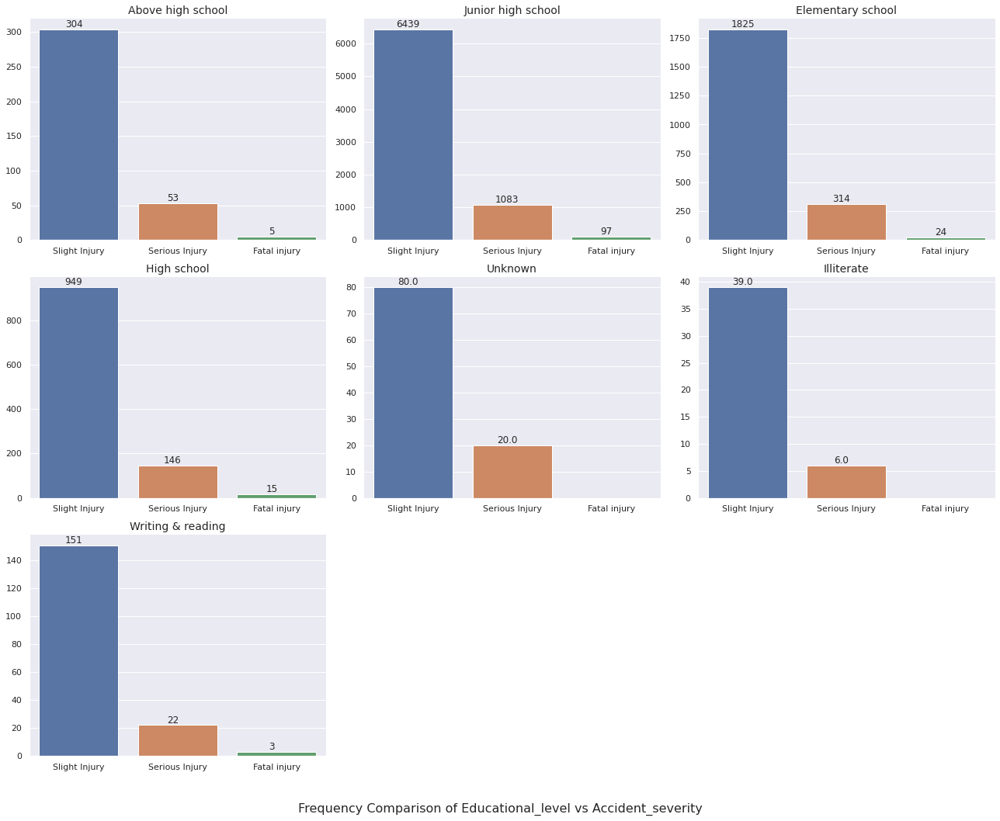




Showing Frequency Plots here for Vehicle_driver_relation:



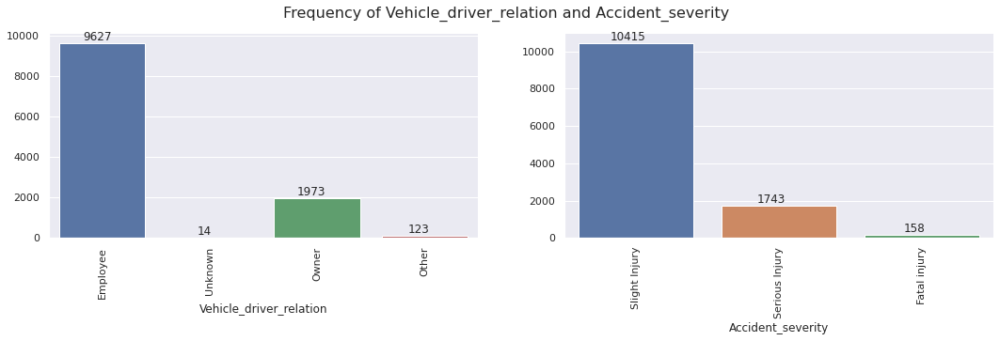


Showing Frequency Comparison of Vehicle_driver_relation vs Accident_severity



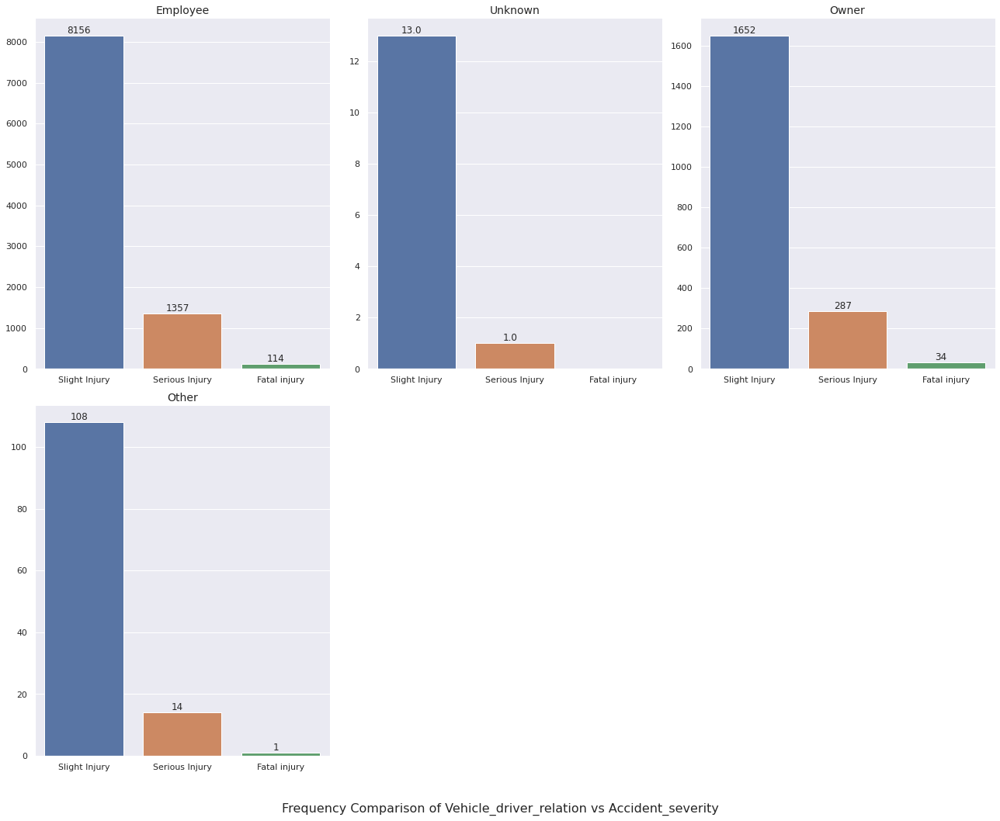




Showing Frequency Plots here for Driving_experience:



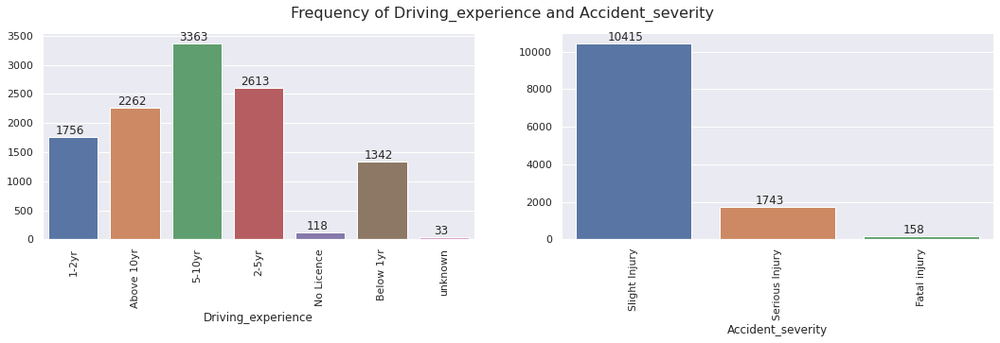


Showing Frequency Comparison of Driving_experience vs Accident_severity



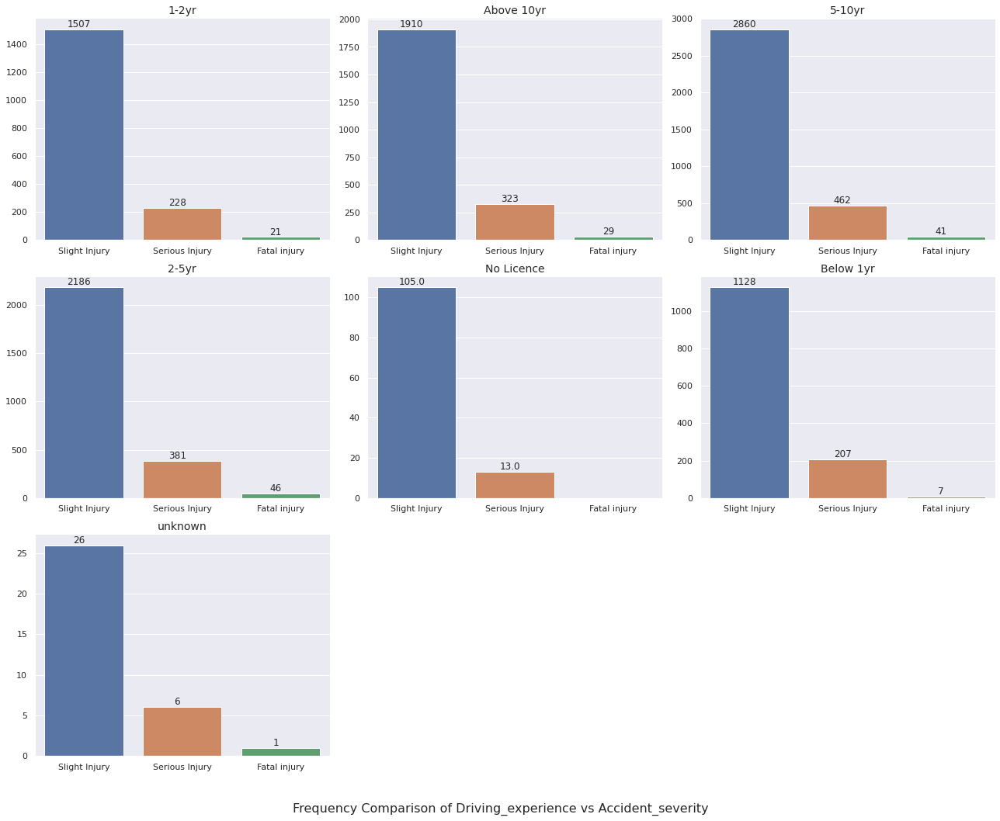




Showing Frequency Plots here for Type_of_vehicle:



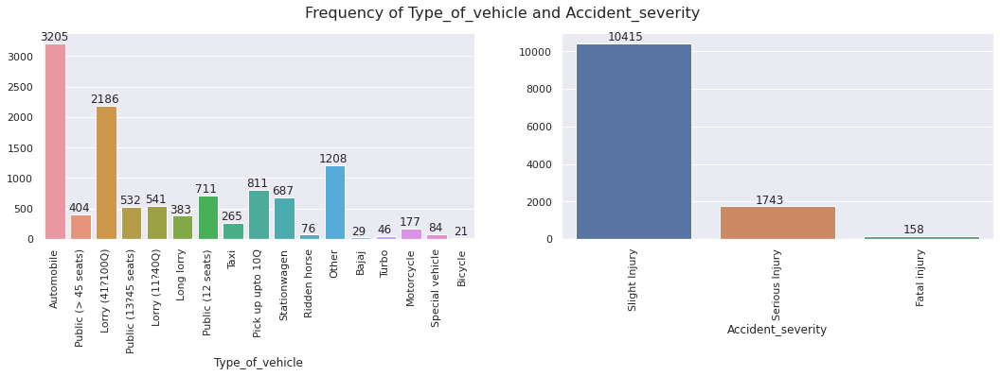


Showing Frequency Comparison of Type_of_vehicle vs Accident_severity



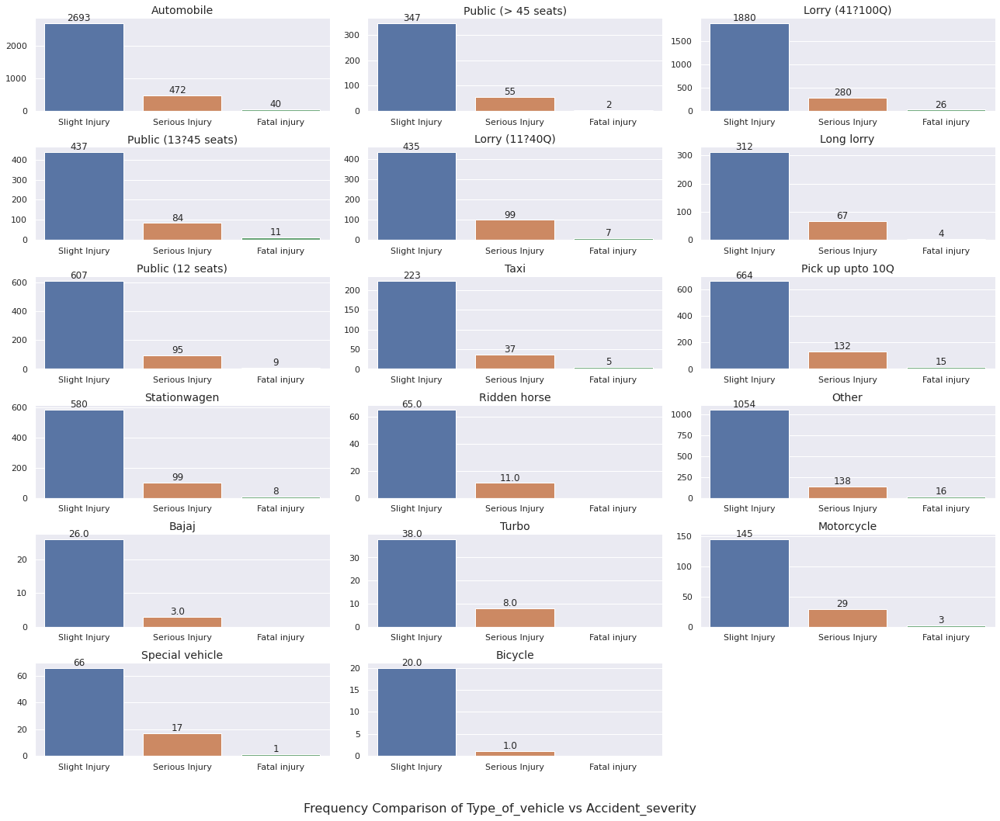




Showing Frequency Plots here for Owner_of_vehicle:



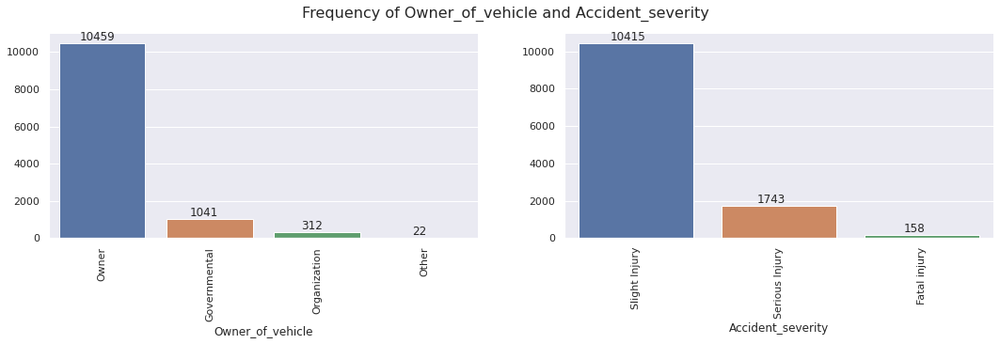


Showing Frequency Comparison of Owner_of_vehicle vs Accident_severity



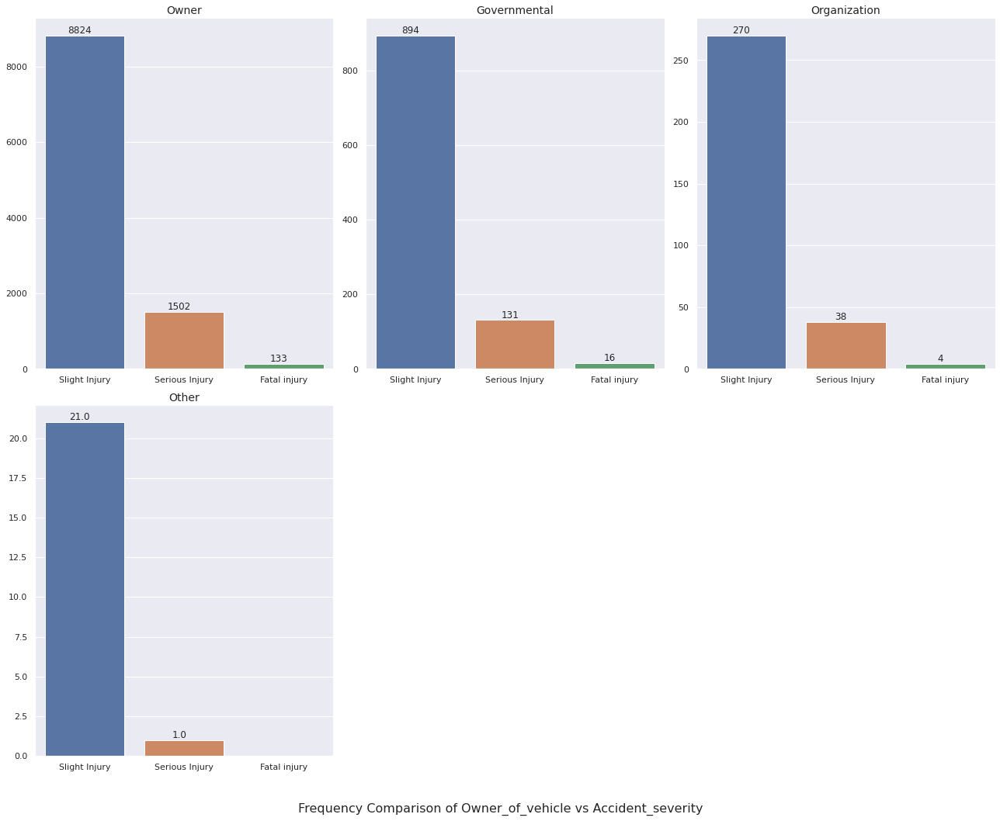




Showing Frequency Plots here for Service_year_of_vehicle:



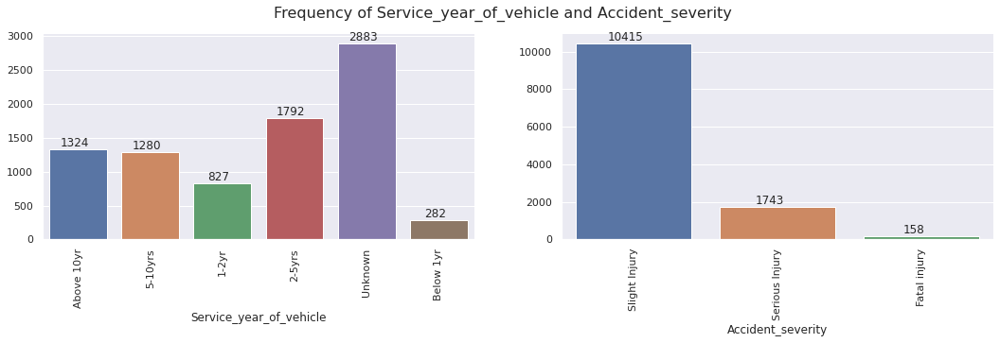


Showing Frequency Comparison of Service_year_of_vehicle vs Accident_severity



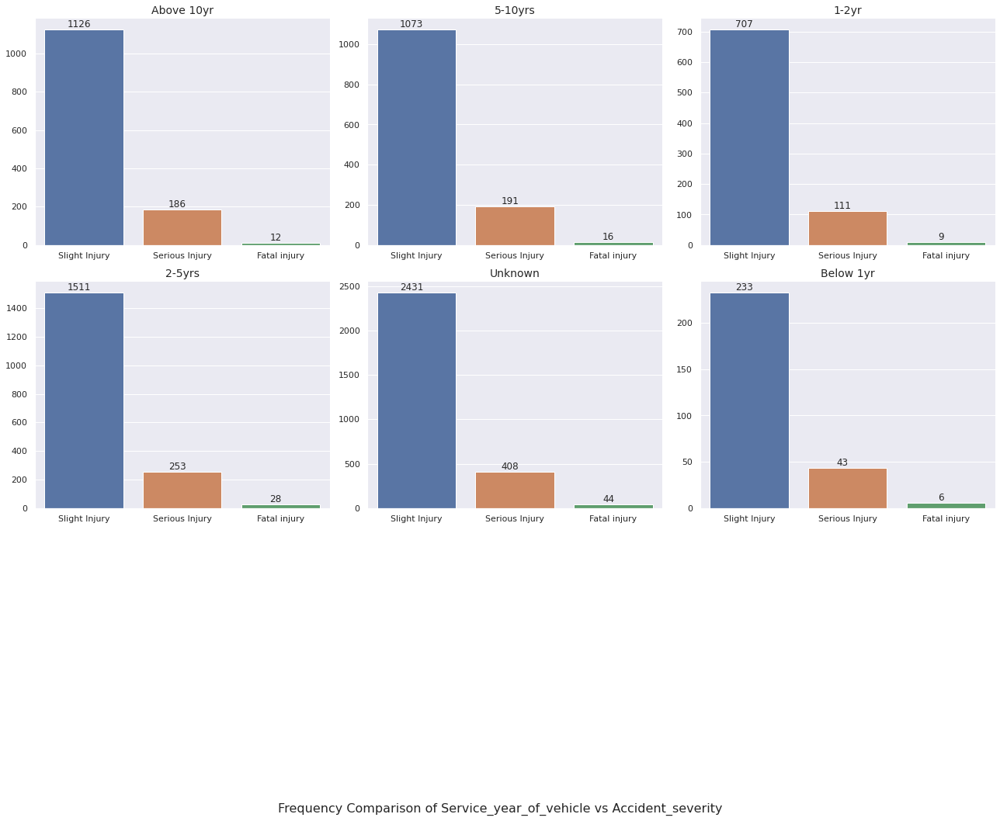




Showing Frequency Plots here for Defect_of_vehicle:



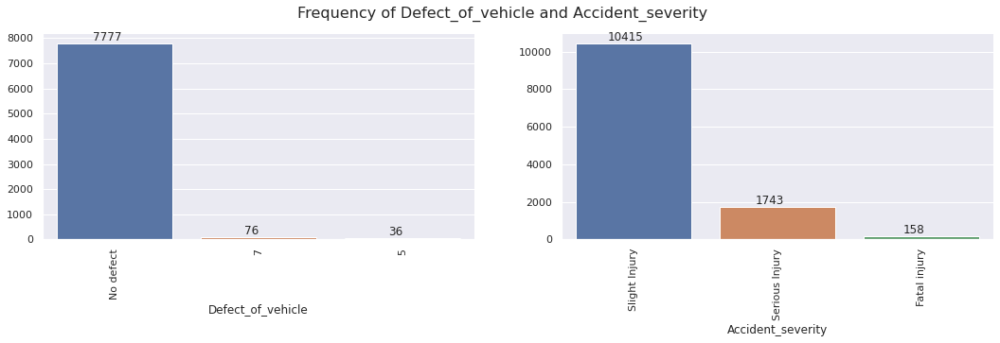


Showing Frequency Comparison of Defect_of_vehicle vs Accident_severity



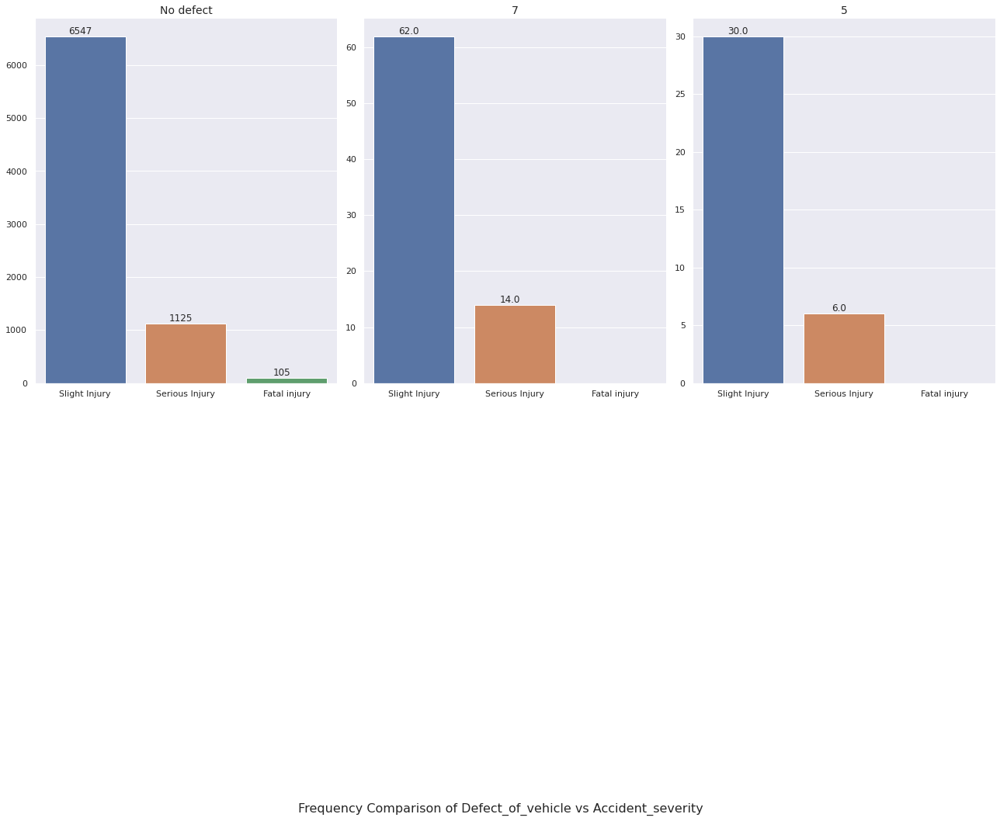




Showing Frequency Plots here for Area_accident_occured:



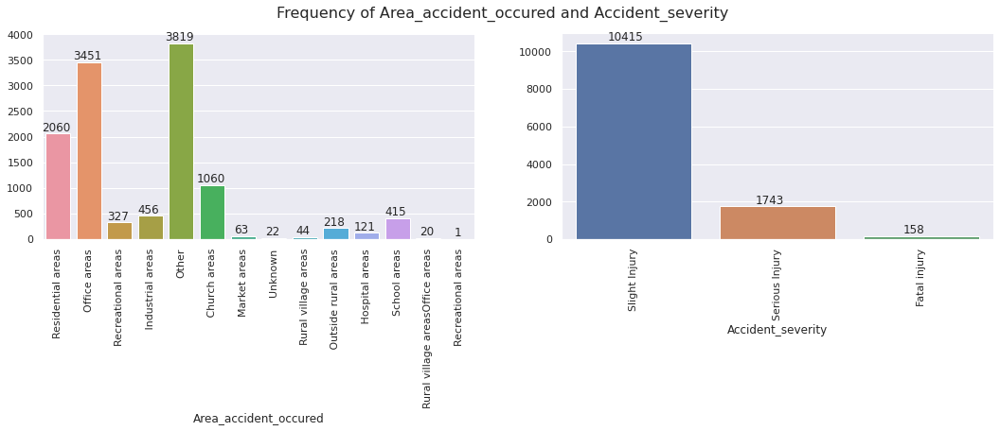


Showing Frequency Comparison of Area_accident_occured vs Accident_severity



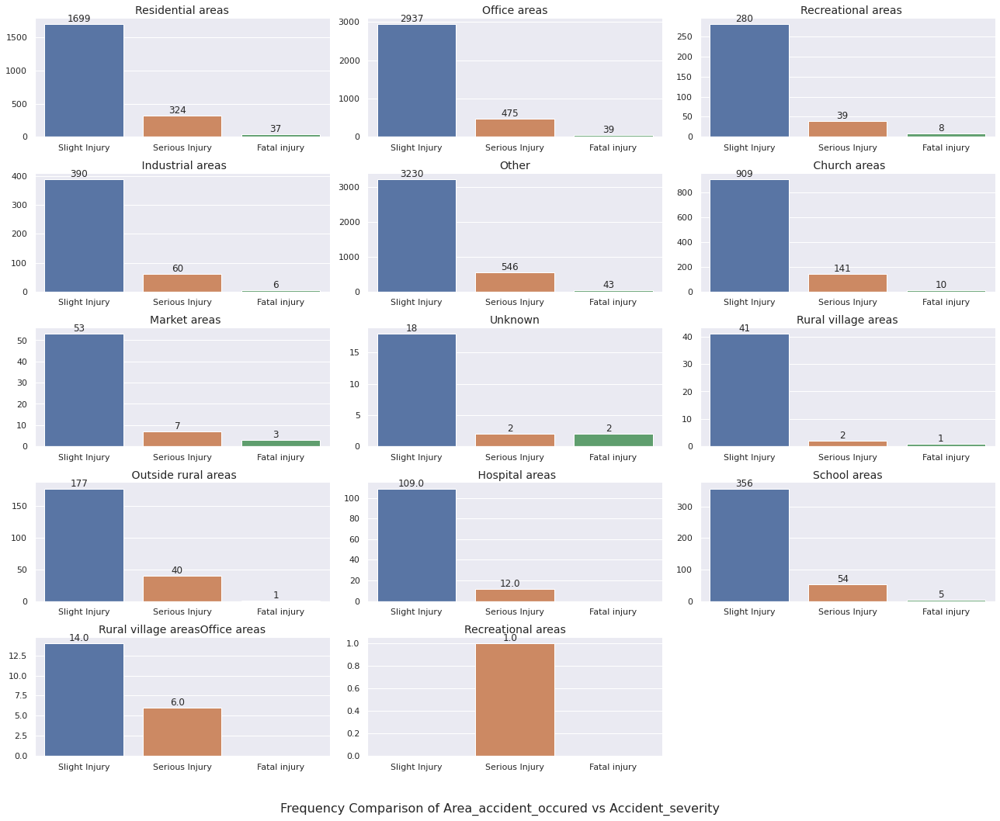




Showing Frequency Plots here for Lanes_or_Medians:



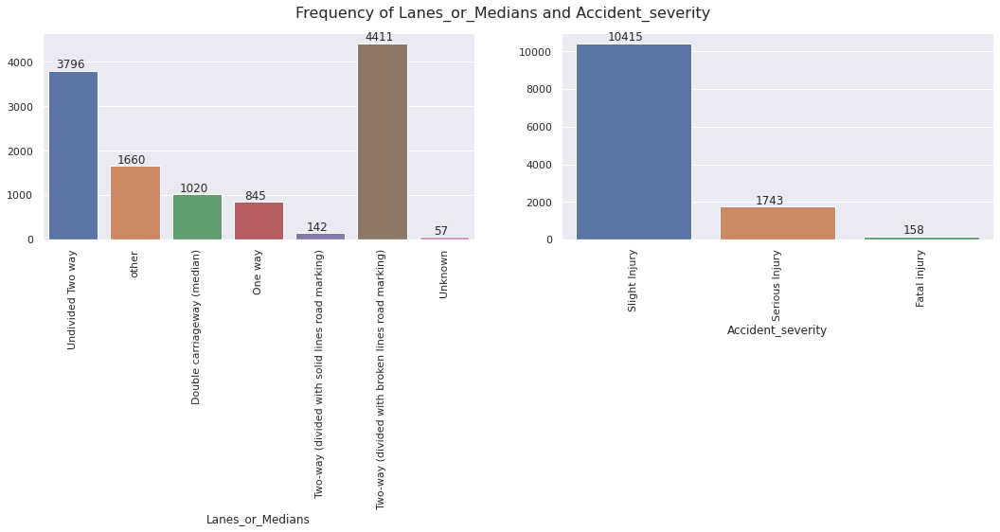


Showing Frequency Comparison of Lanes_or_Medians vs Accident_severity



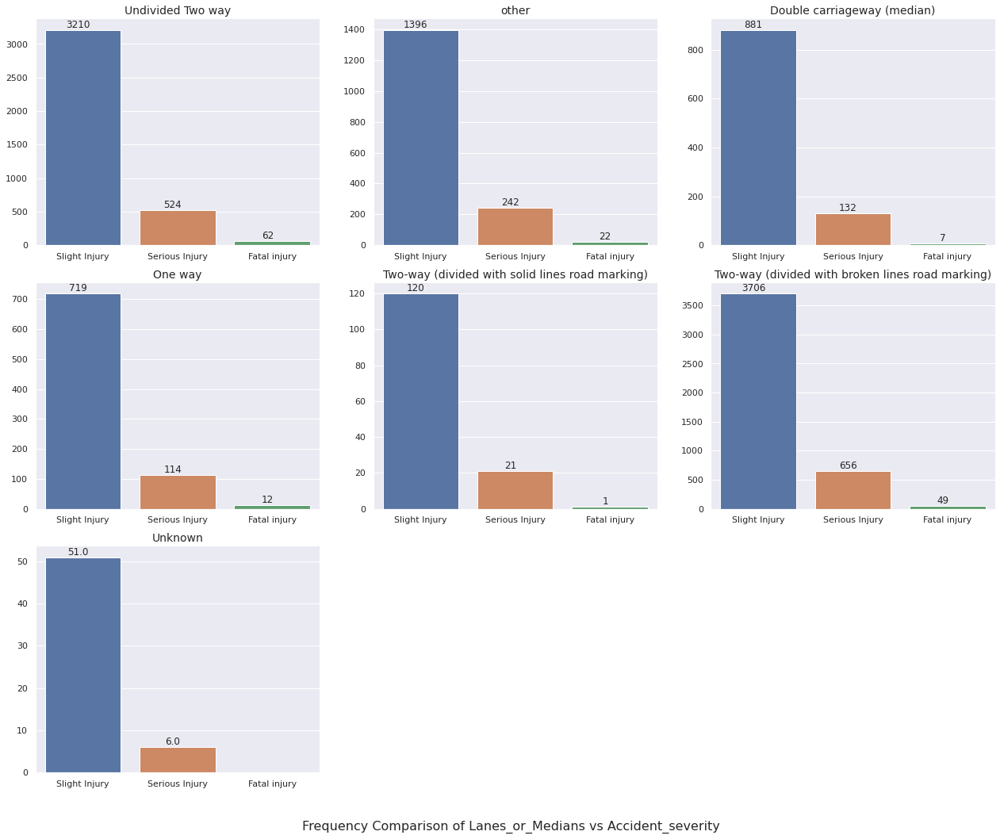




Showing Frequency Plots here for Road_allignment:



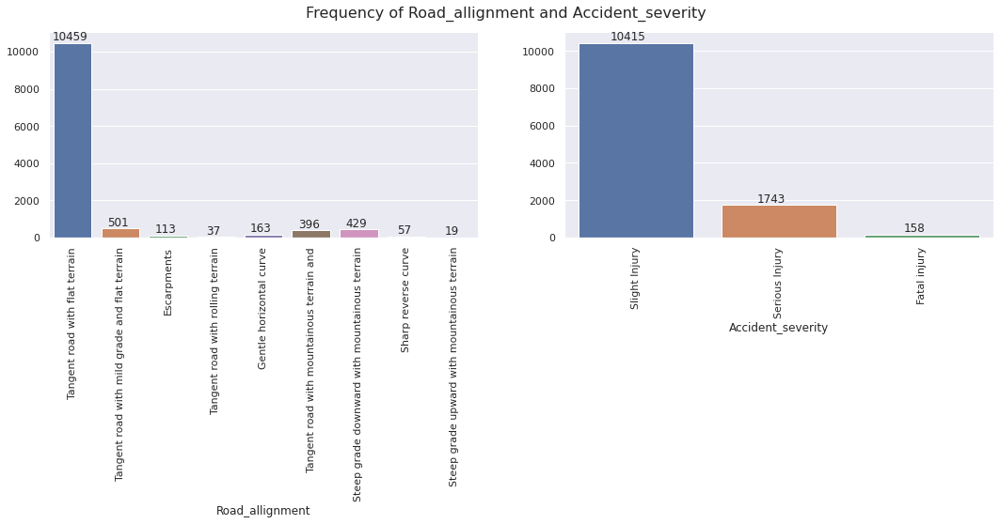


Showing Frequency Comparison of Road_allignment vs Accident_severity



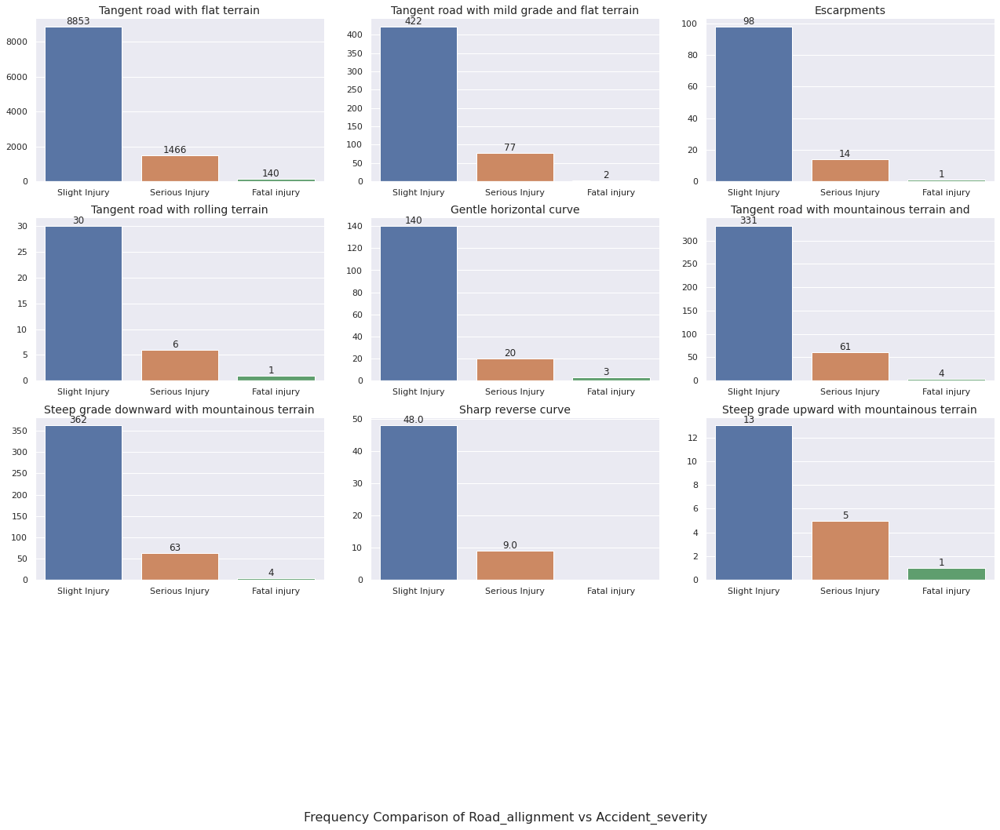




Showing Frequency Plots here for Types_of_Junction:



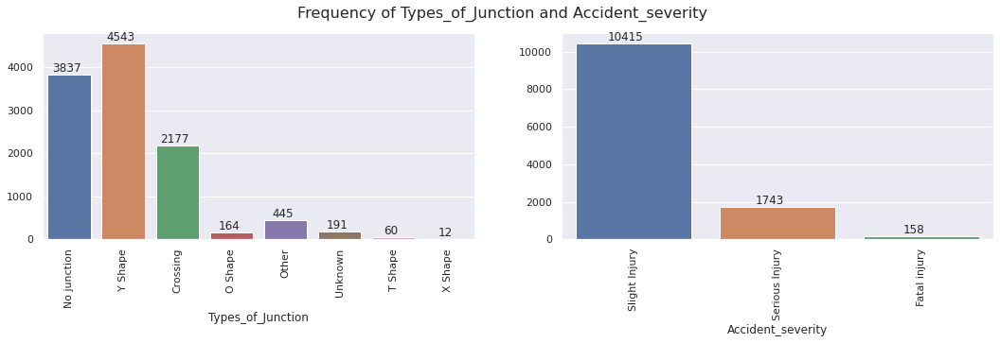


Showing Frequency Comparison of Types_of_Junction vs Accident_severity



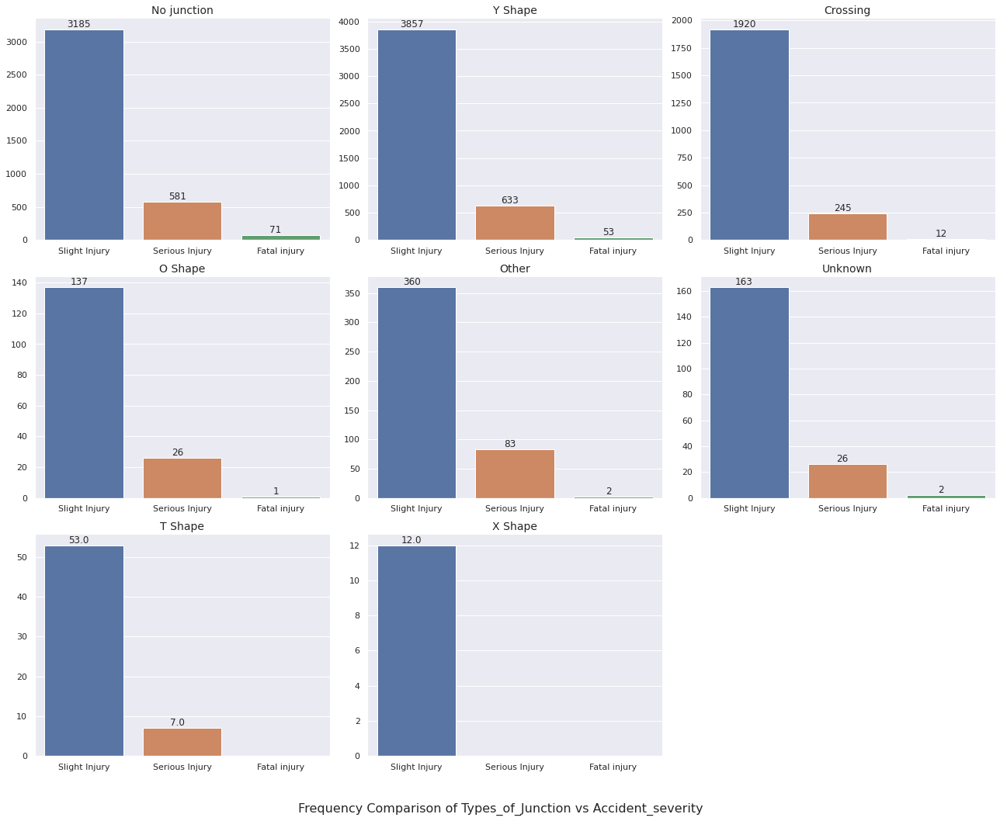




Showing Frequency Plots here for Road_surface_type:



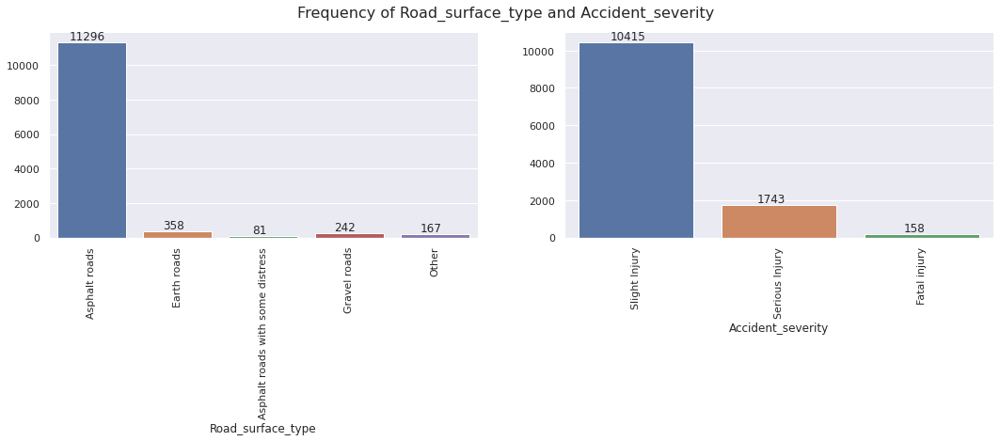


Showing Frequency Comparison of Road_surface_type vs Accident_severity



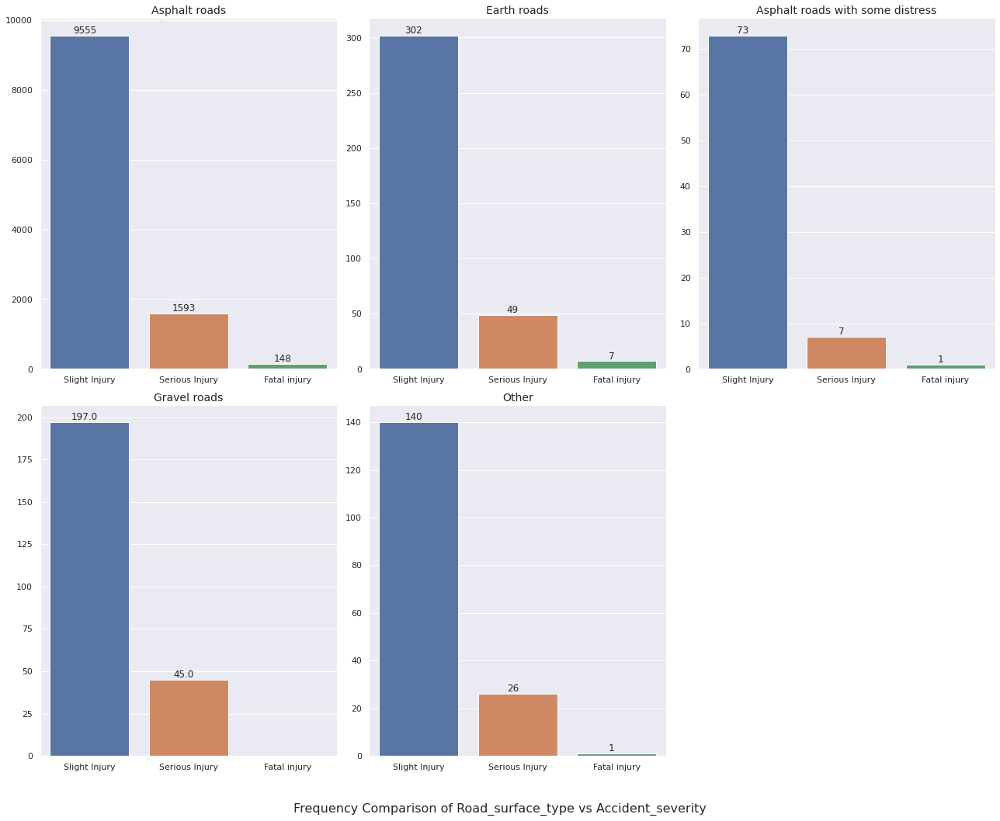




Showing Frequency Plots here for Road_surface_conditions:



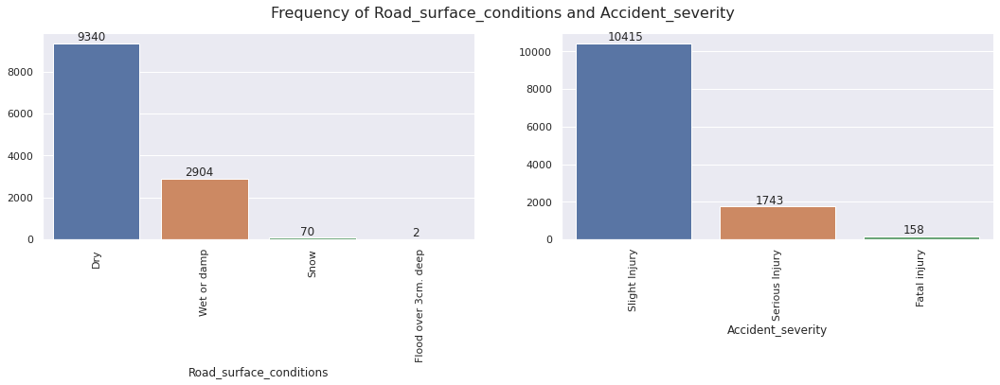


Showing Frequency Comparison of Road_surface_conditions vs Accident_severity



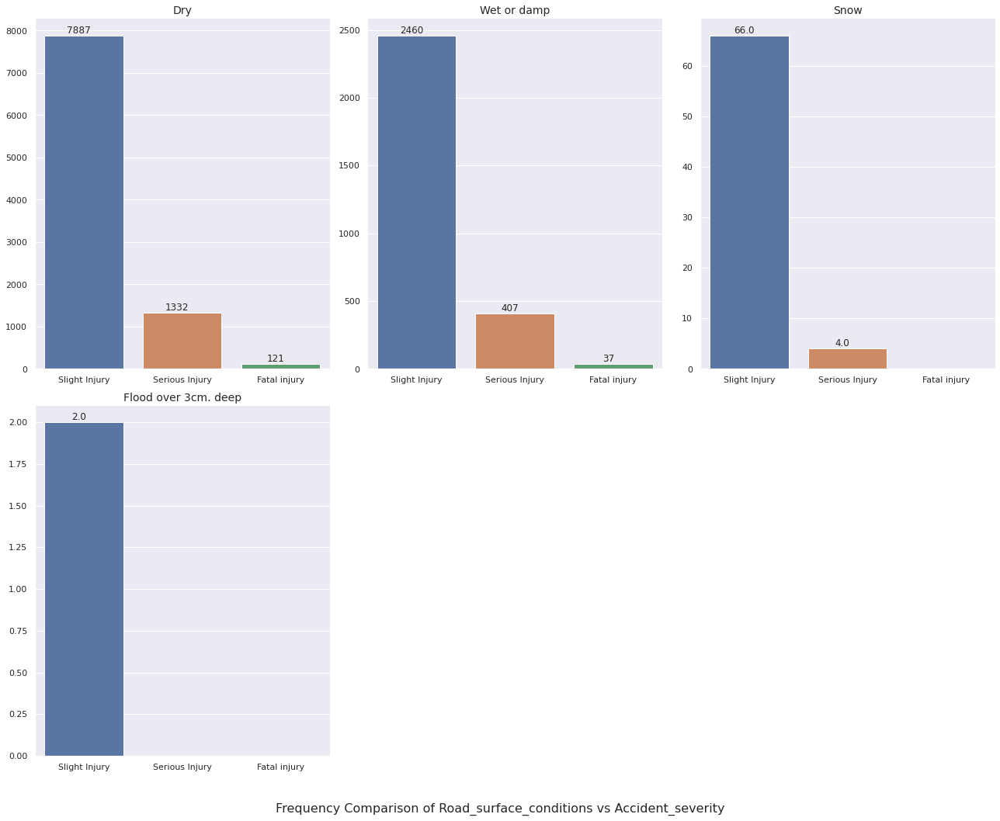




Showing Frequency Plots here for Light_conditions:



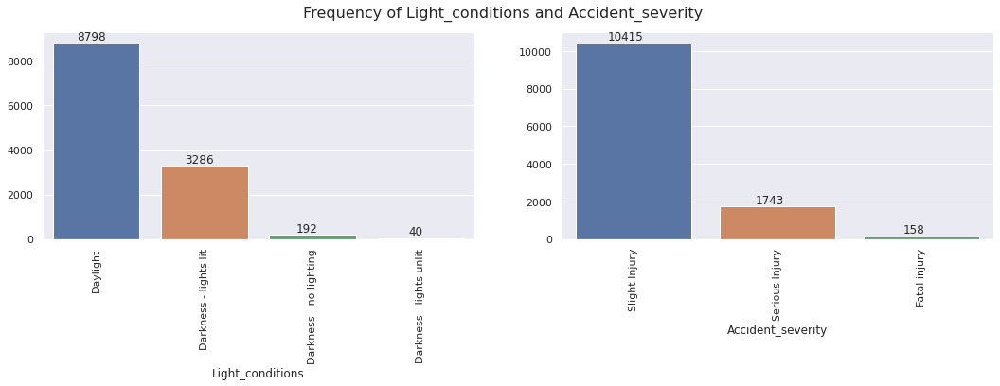


Showing Frequency Comparison of Light_conditions vs Accident_severity



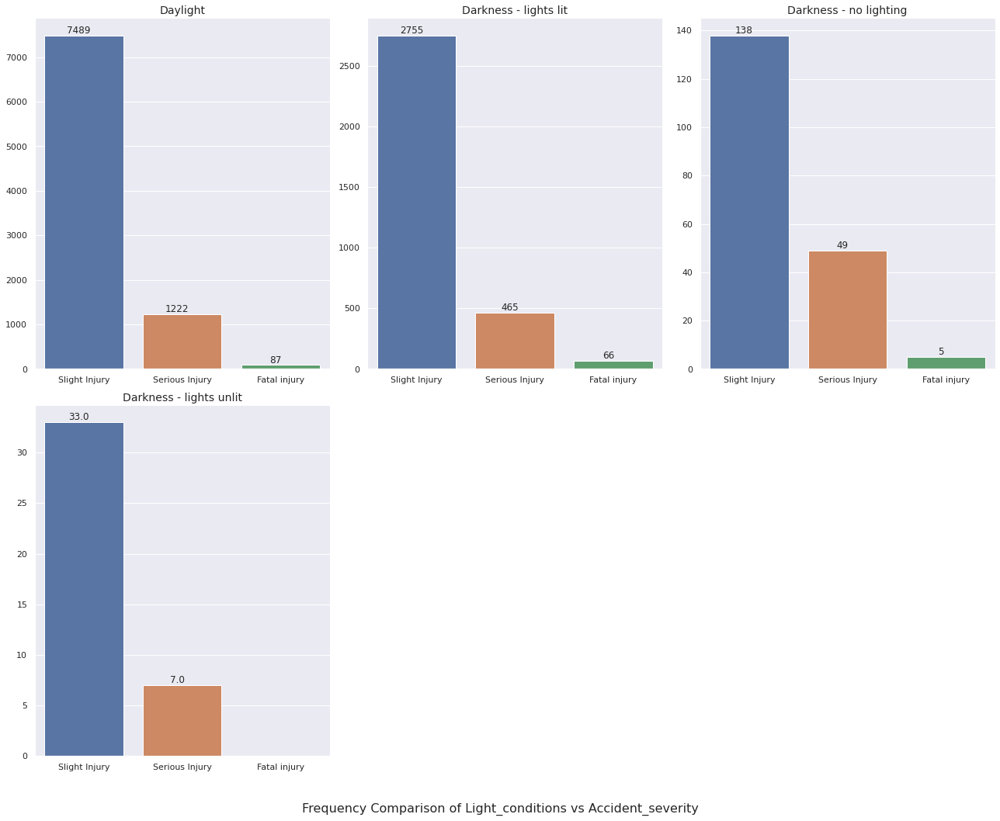




Showing Frequency Plots here for Weather_conditions:



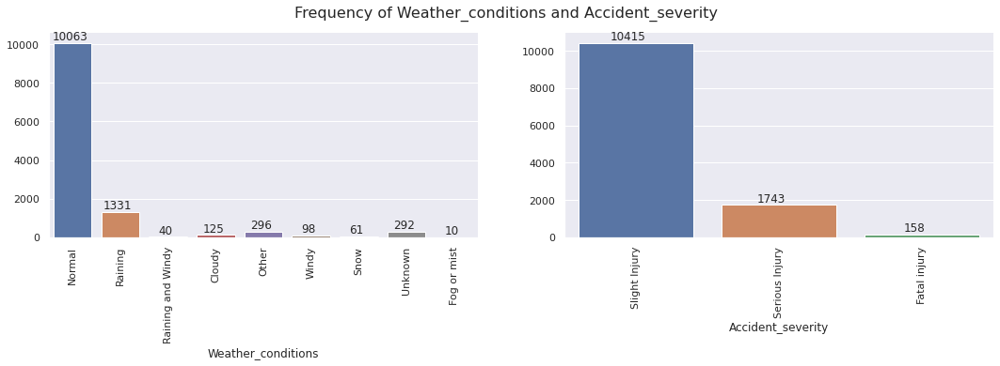


Showing Frequency Comparison of Weather_conditions vs Accident_severity



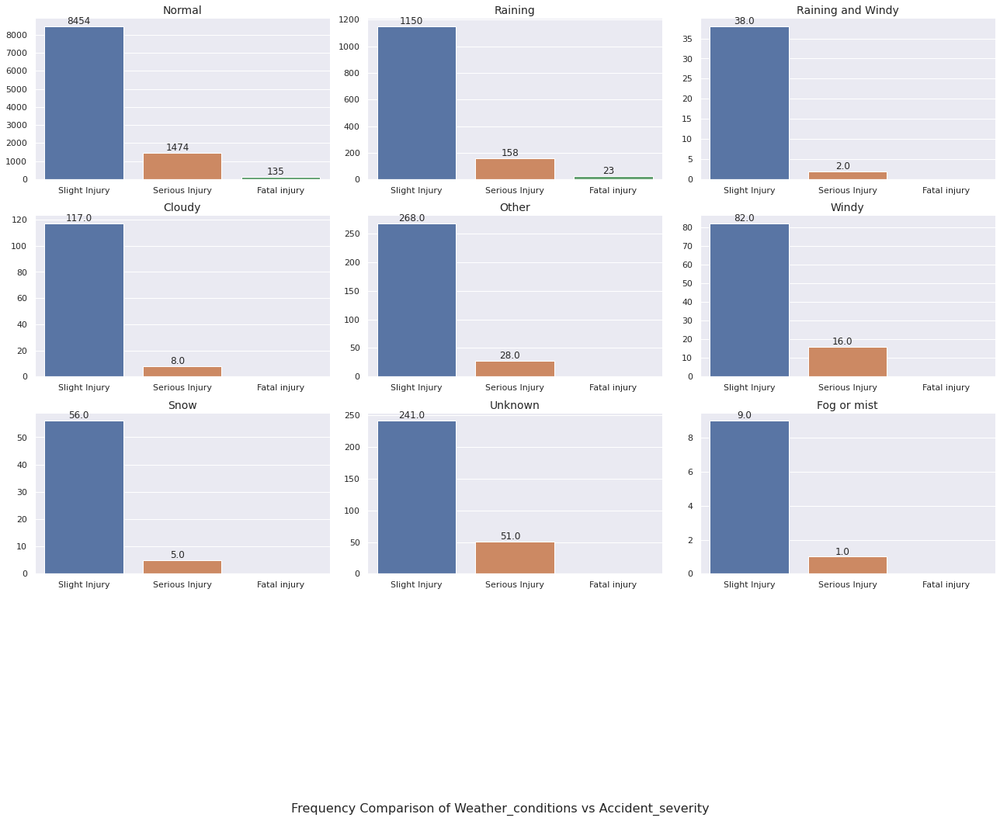




Showing Frequency Plots here for Type_of_collision:



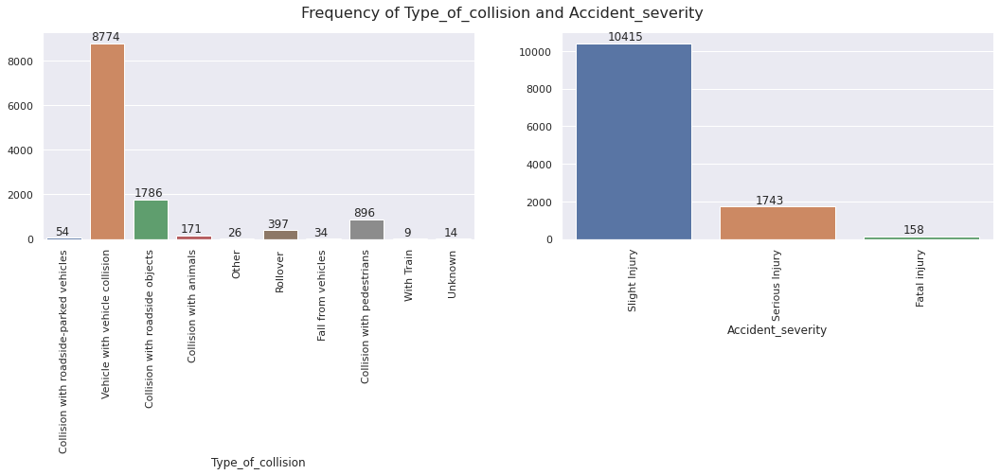


Showing Frequency Comparison of Type_of_collision vs Accident_severity



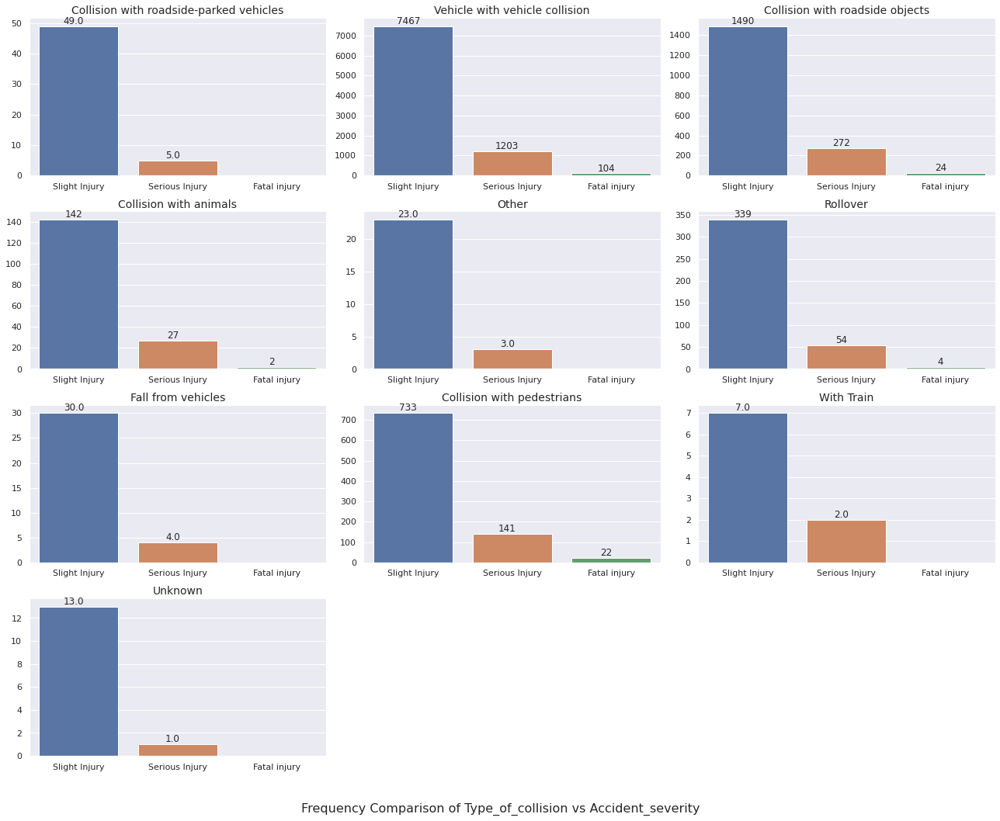




Showing Frequency Plots here for Number_of_vehicles_involved:



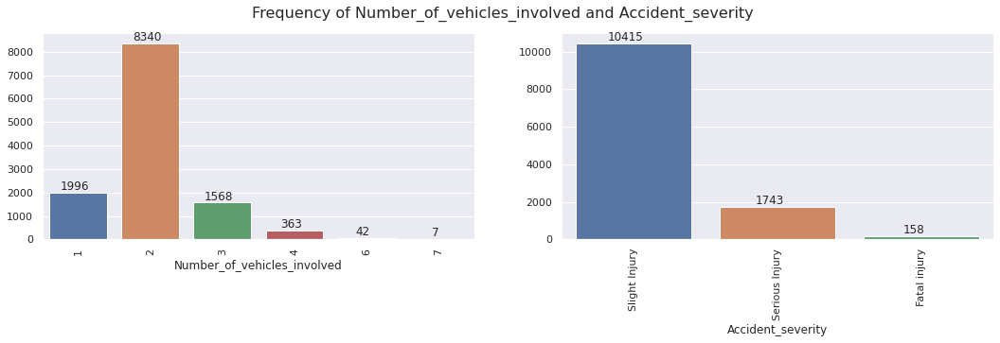


Showing Frequency Comparison of Number_of_vehicles_involved vs Accident_severity



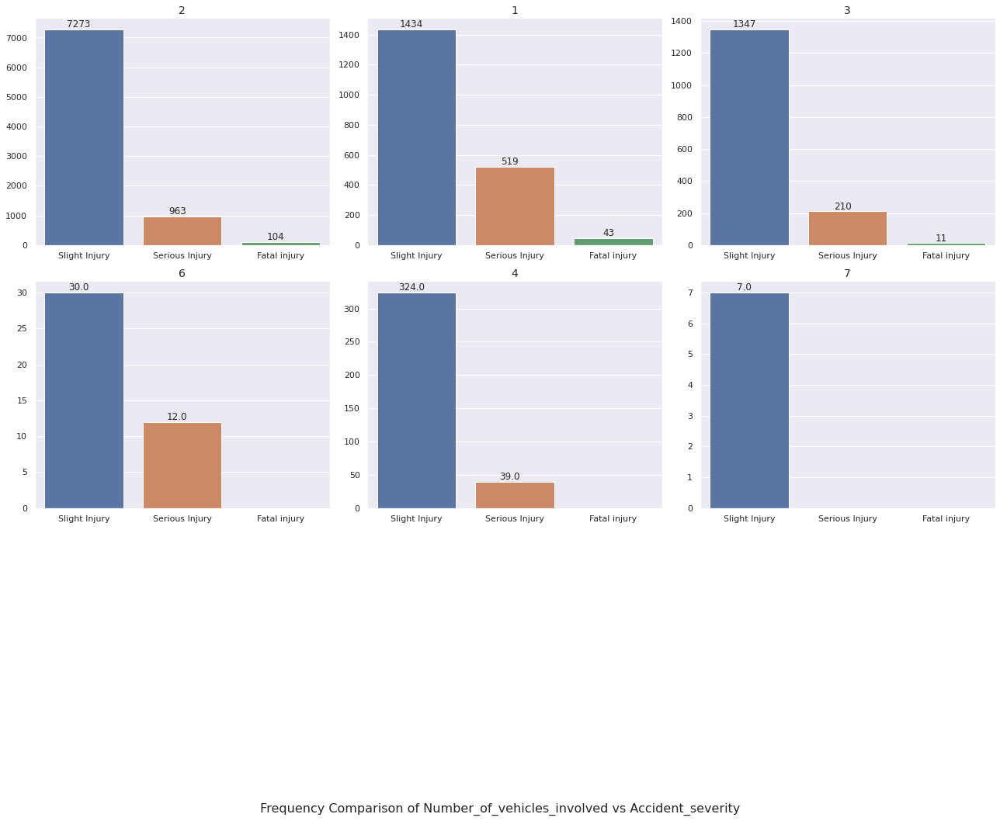




Showing Frequency Plots here for Number_of_casualties:



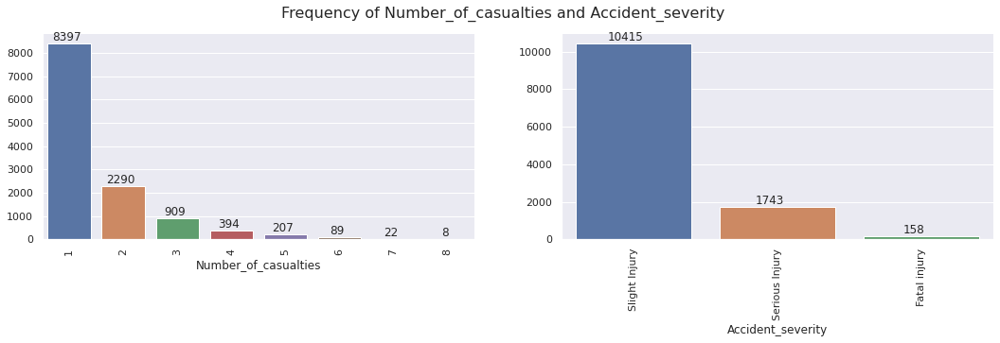


Showing Frequency Comparison of Number_of_casualties vs Accident_severity



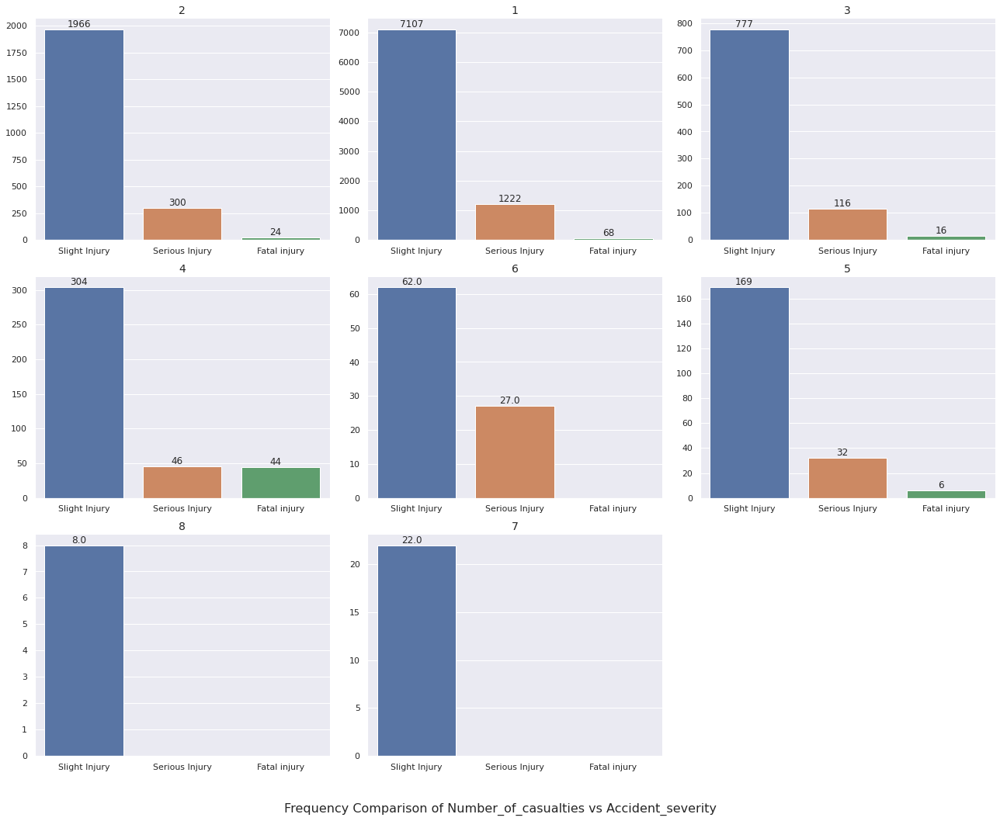




Showing Frequency Plots here for Vehicle_movement:



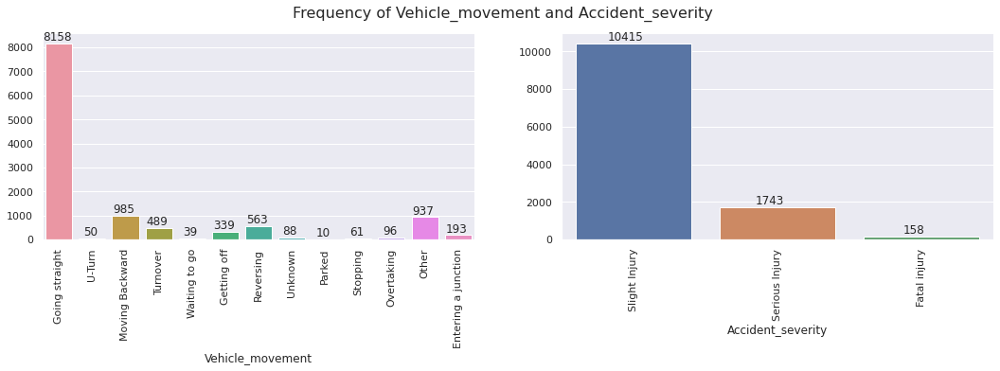


Showing Frequency Comparison of Vehicle_movement vs Accident_severity



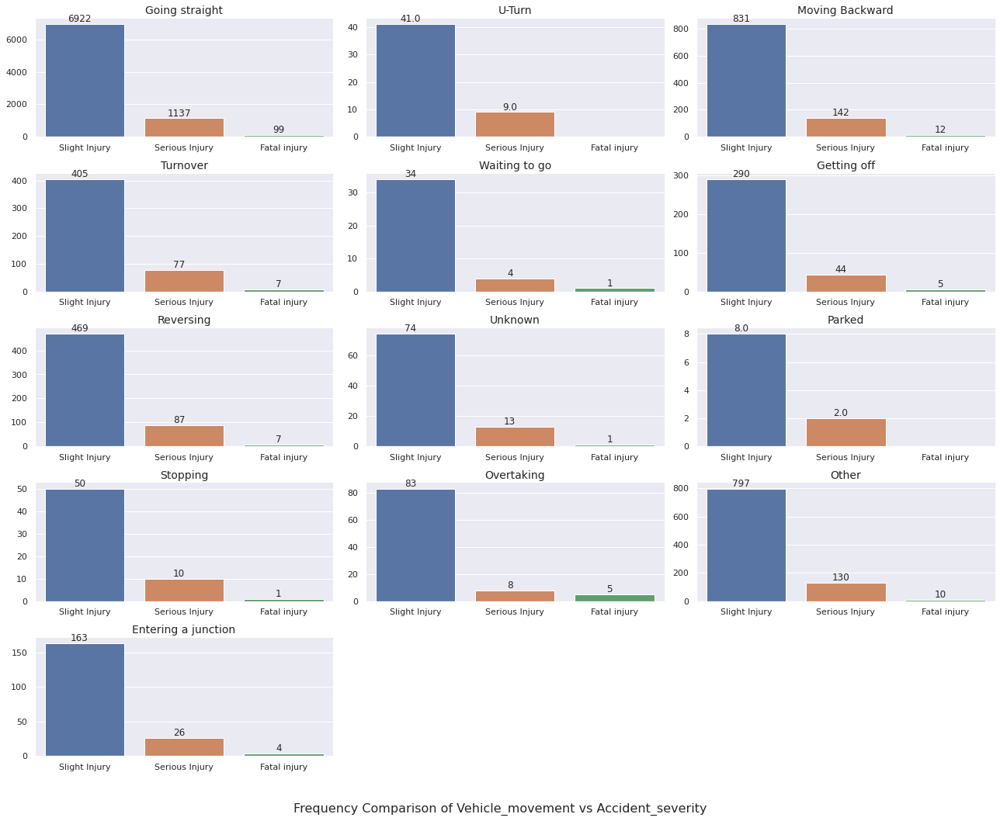




Showing Frequency Plots here for Casualty_class:



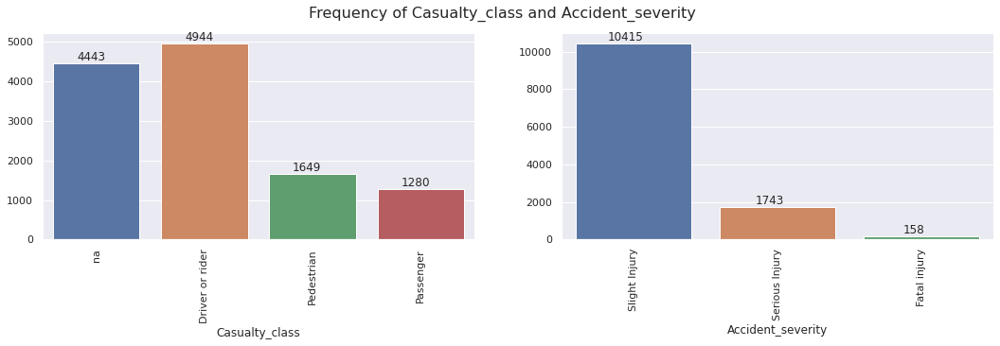


Showing Frequency Comparison of Casualty_class vs Accident_severity



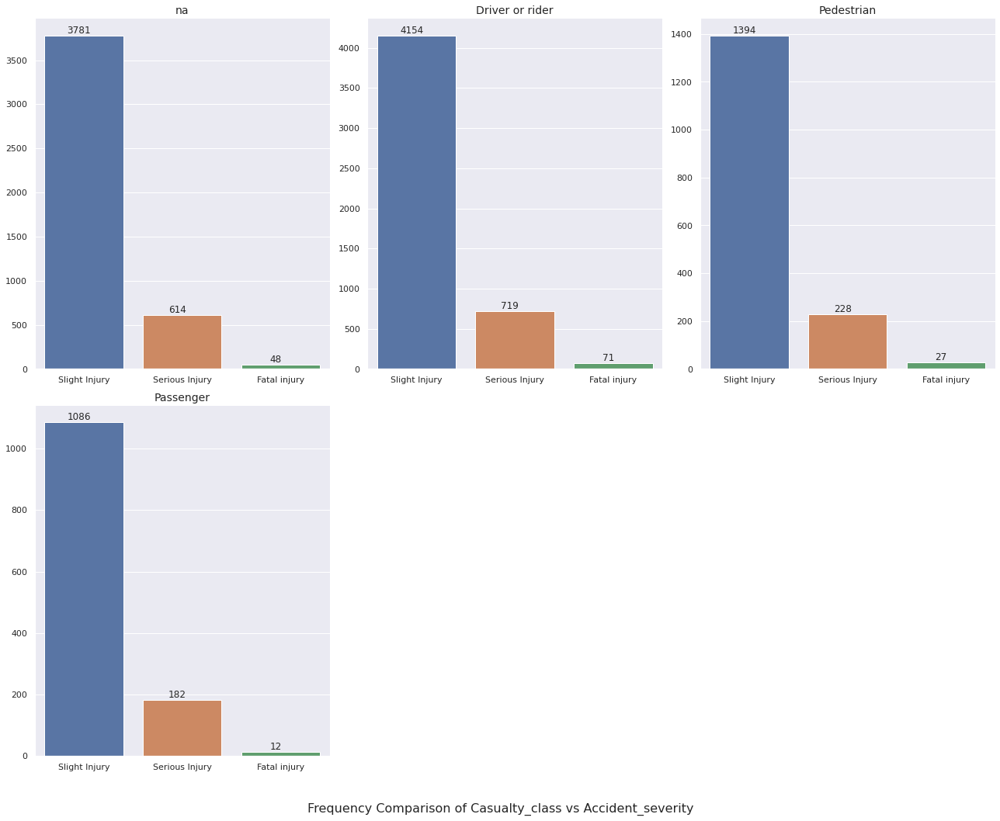




Showing Frequency Plots here for Sex_of_casualty:



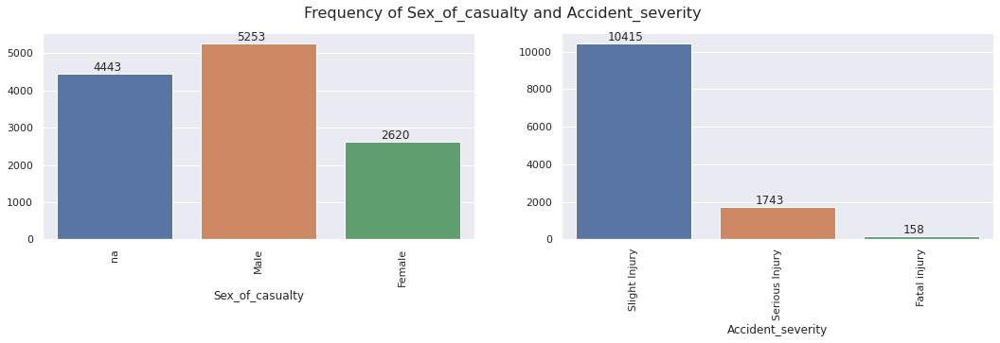


Showing Frequency Comparison of Sex_of_casualty vs Accident_severity



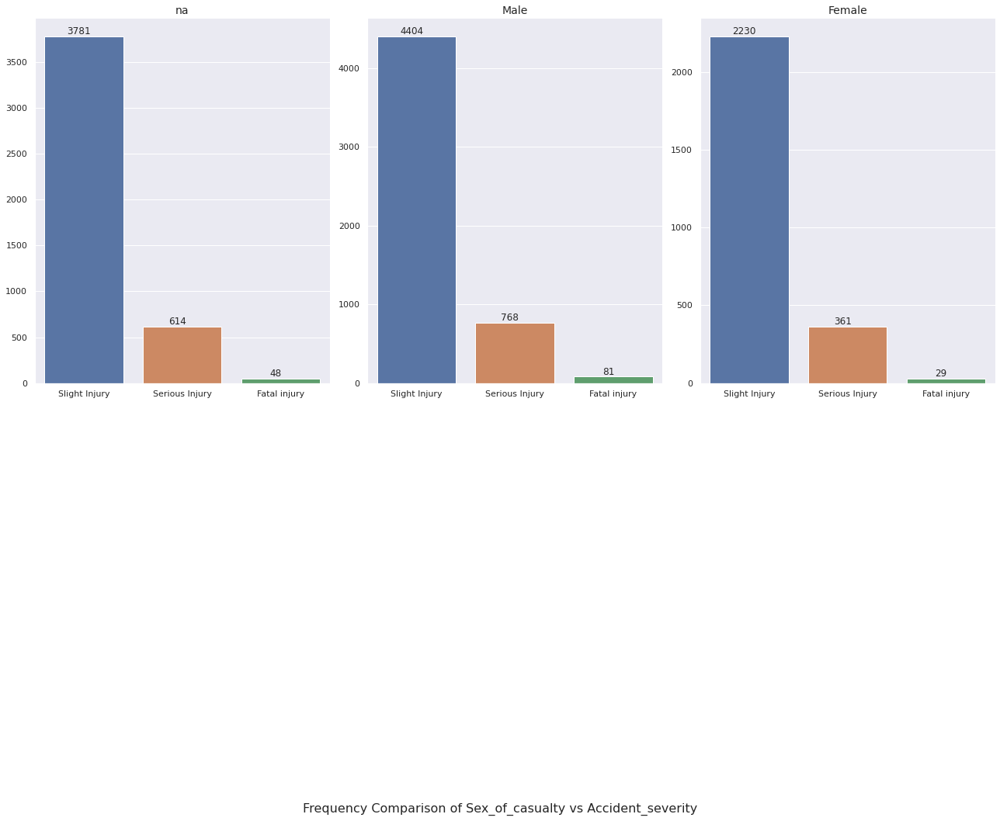




Showing Frequency Plots here for Age_band_of_casualty:



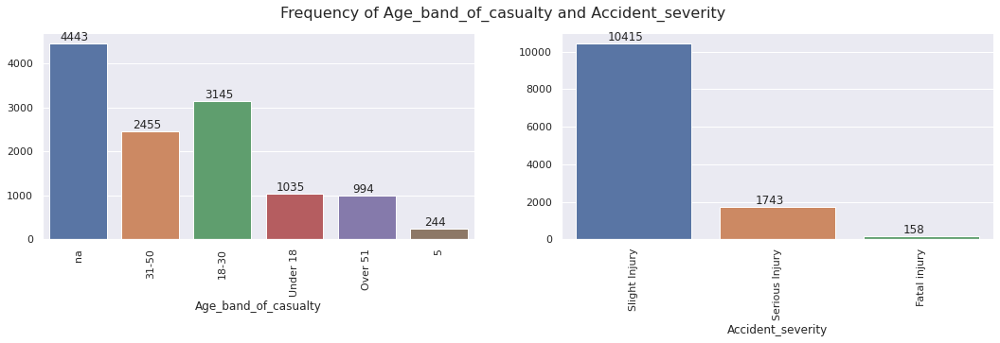


Showing Frequency Comparison of Age_band_of_casualty vs Accident_severity



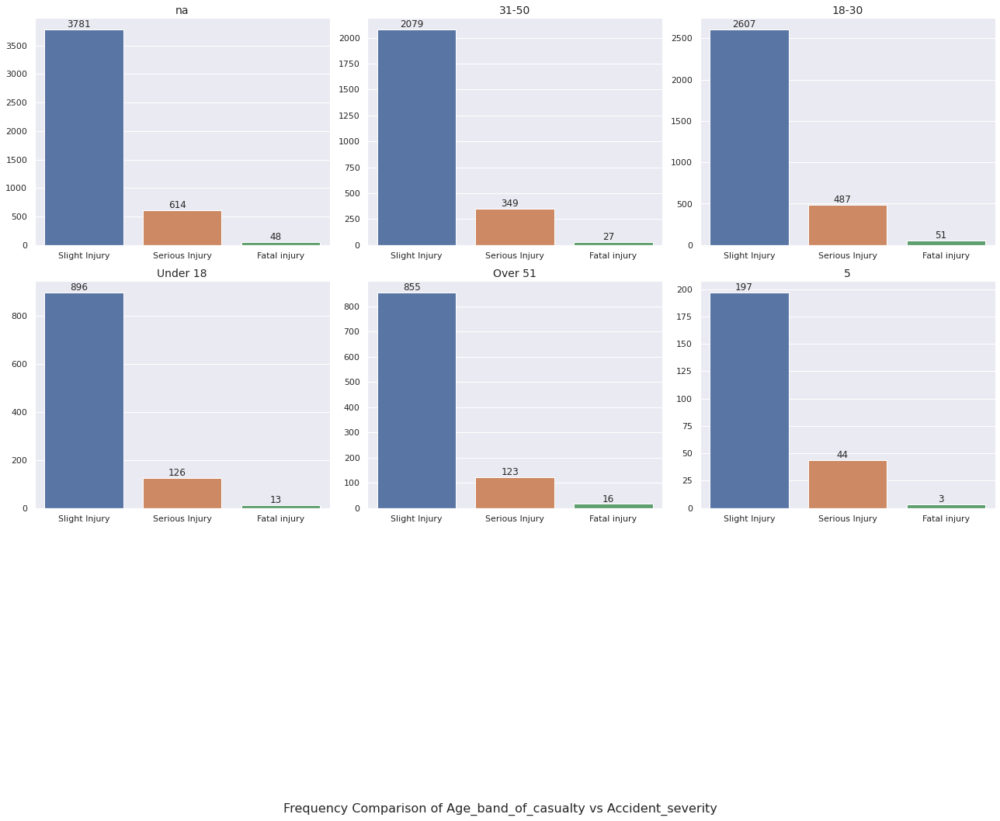




Showing Frequency Plots here for Casualty_severity:



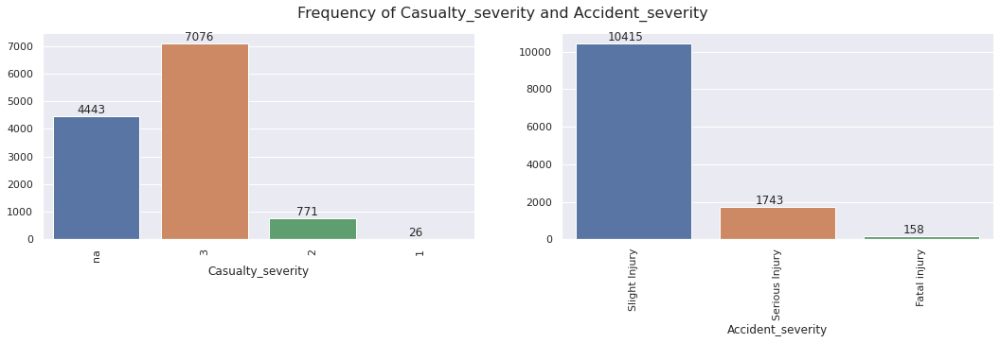


Showing Frequency Comparison of Casualty_severity vs Accident_severity



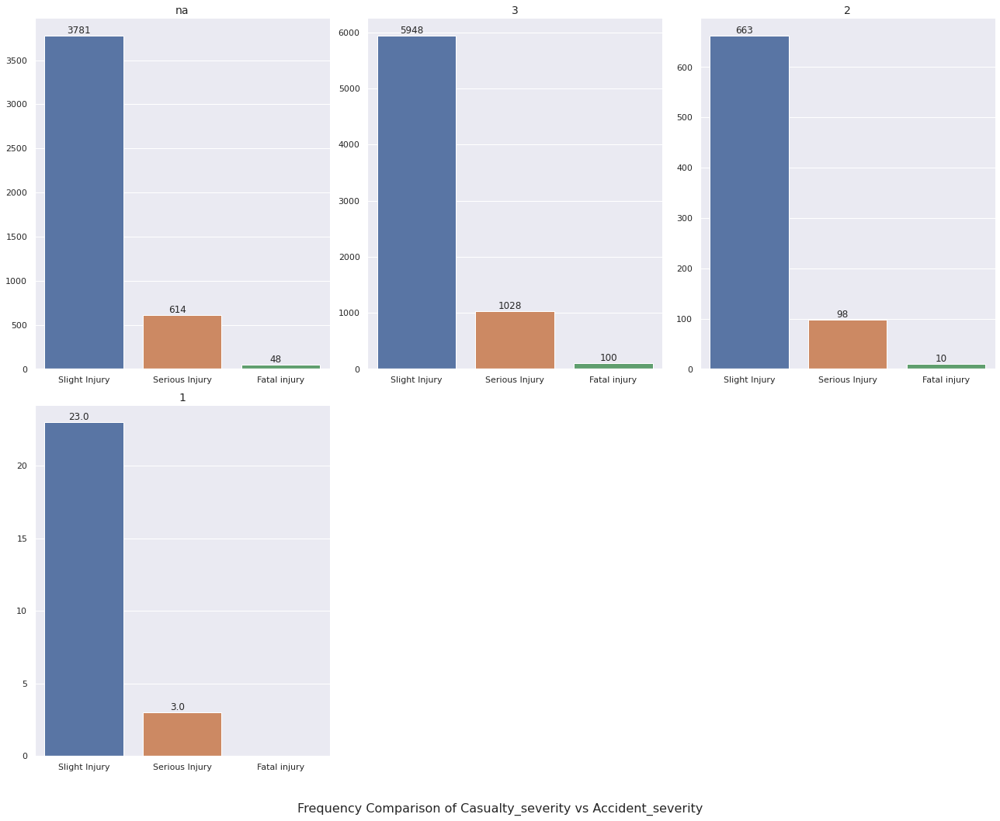




Showing Frequency Plots here for Work_of_casuality:



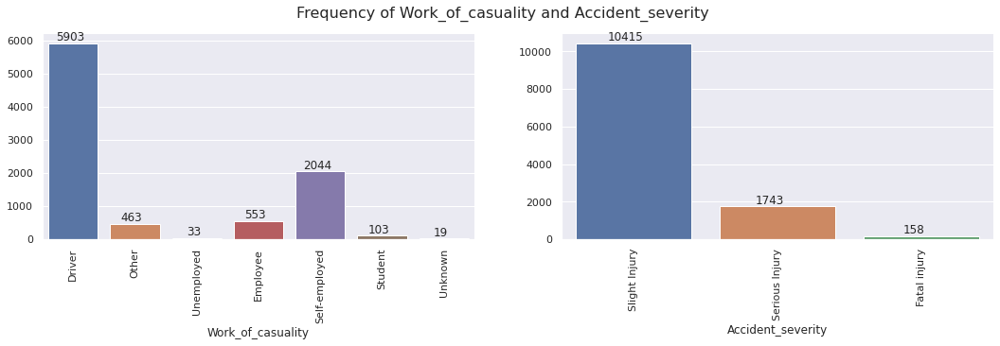


Showing Frequency Comparison of Work_of_casuality vs Accident_severity



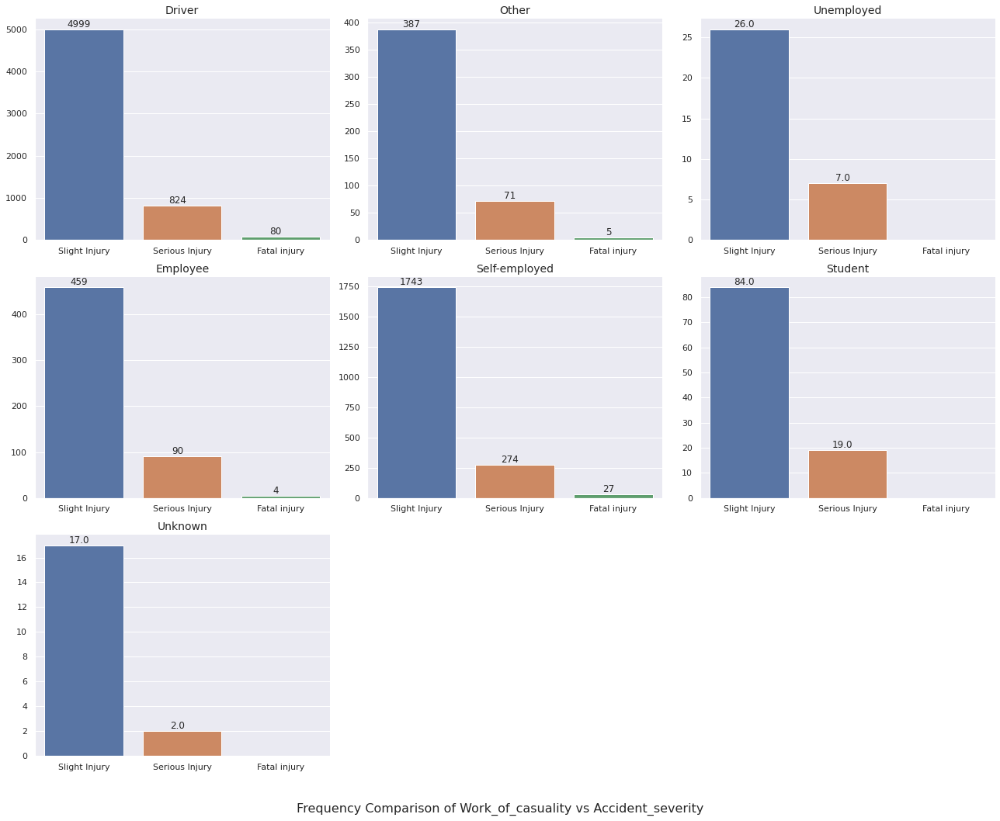




Showing Frequency Plots here for Fitness_of_casuality:



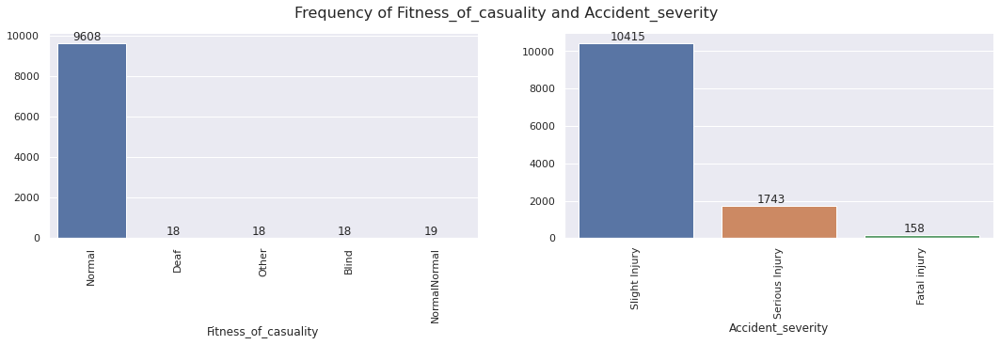


Showing Frequency Comparison of Fitness_of_casuality vs Accident_severity



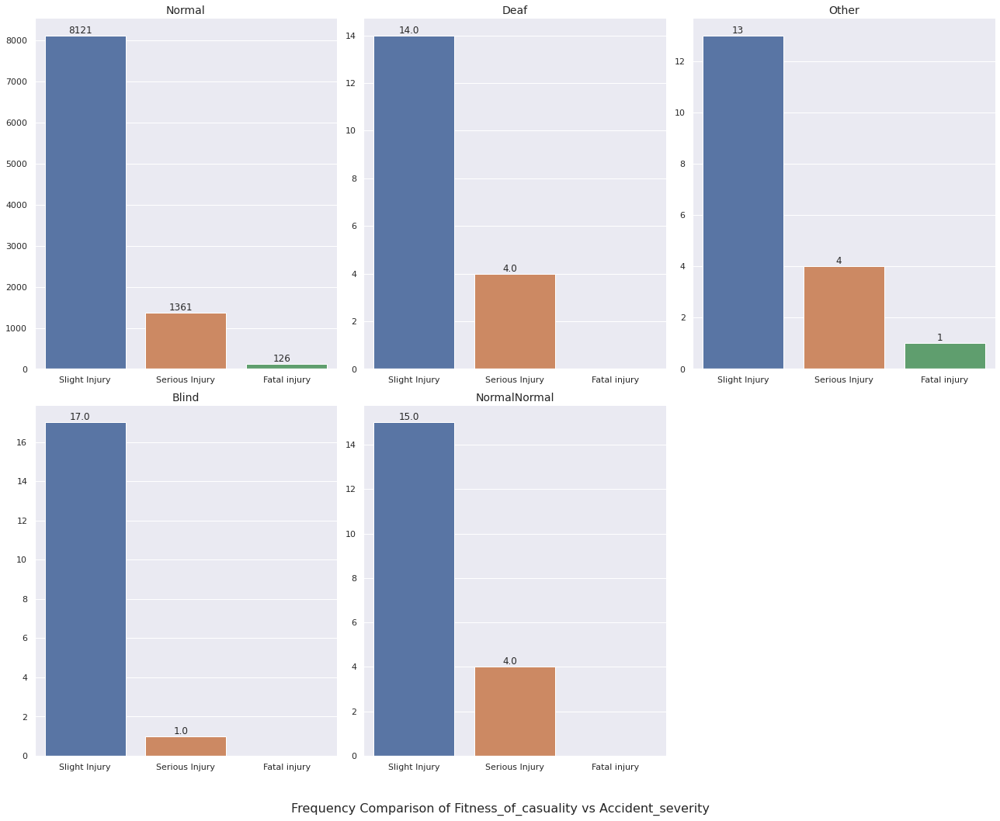




Showing Frequency Plots here for Pedestrian_movement:



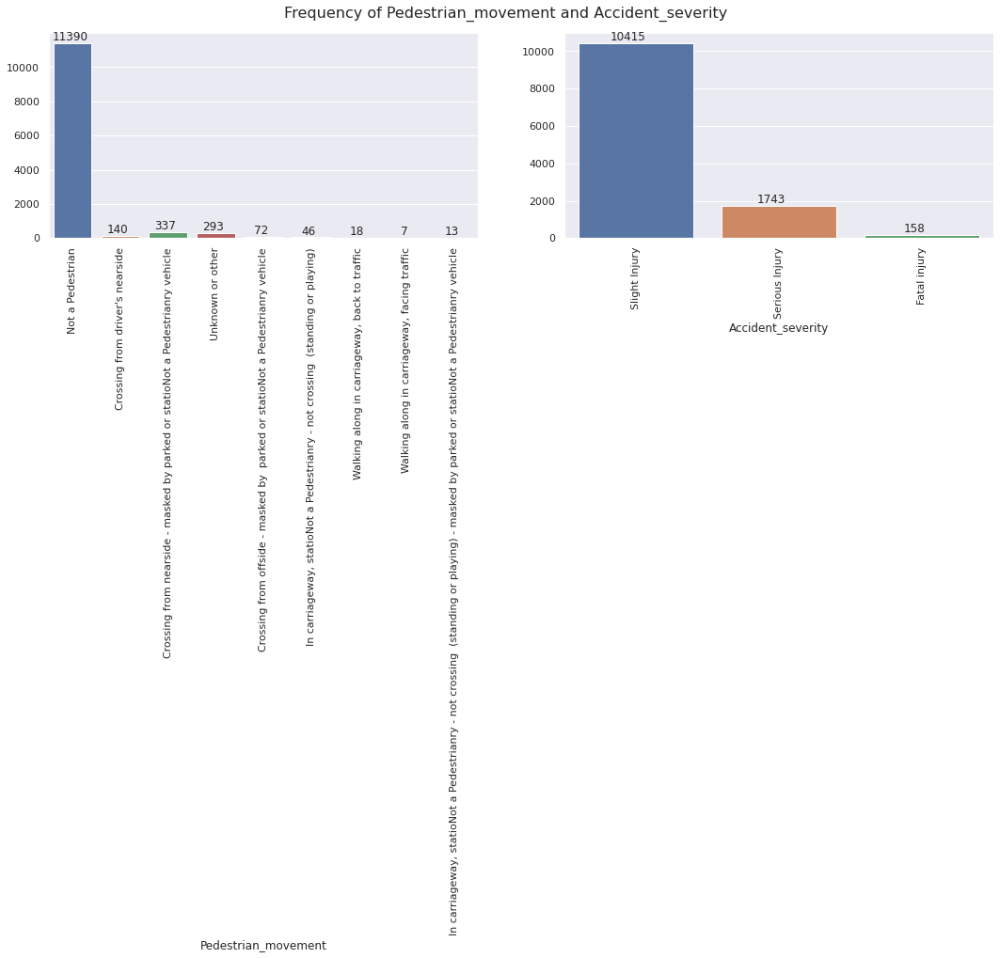


Showing Frequency Comparison of Pedestrian_movement vs Accident_severity



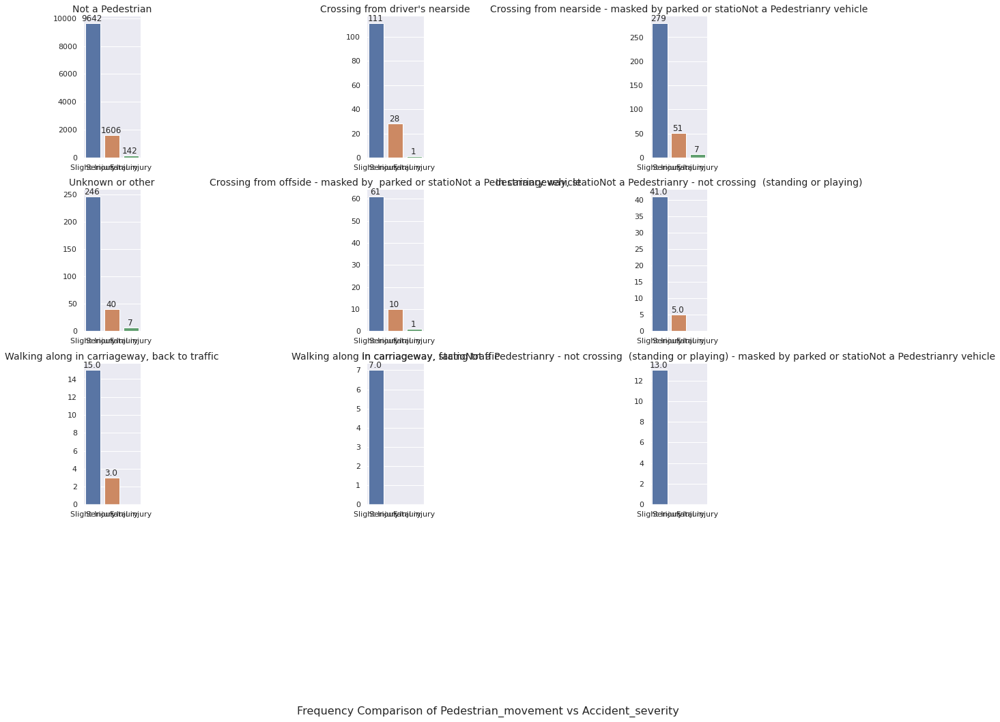




Showing Frequency Plots here for Cause_of_accident:



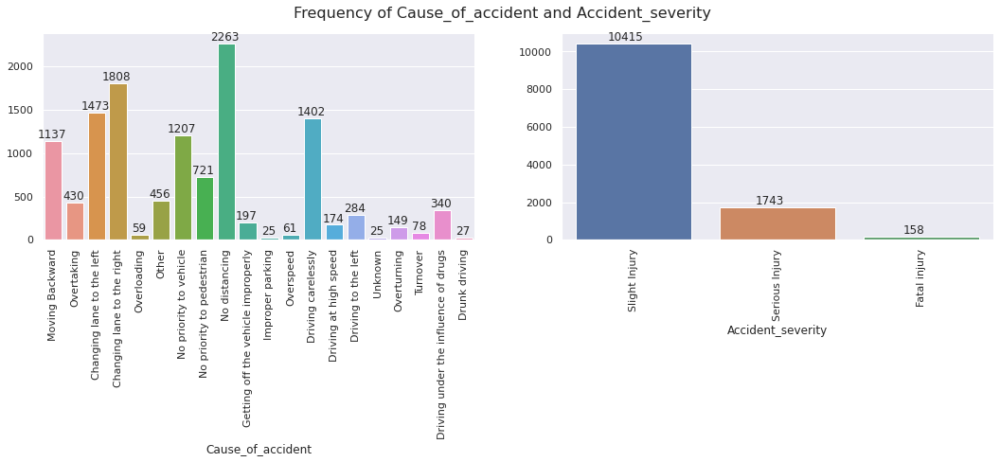


Showing Frequency Comparison of Cause_of_accident vs Accident_severity



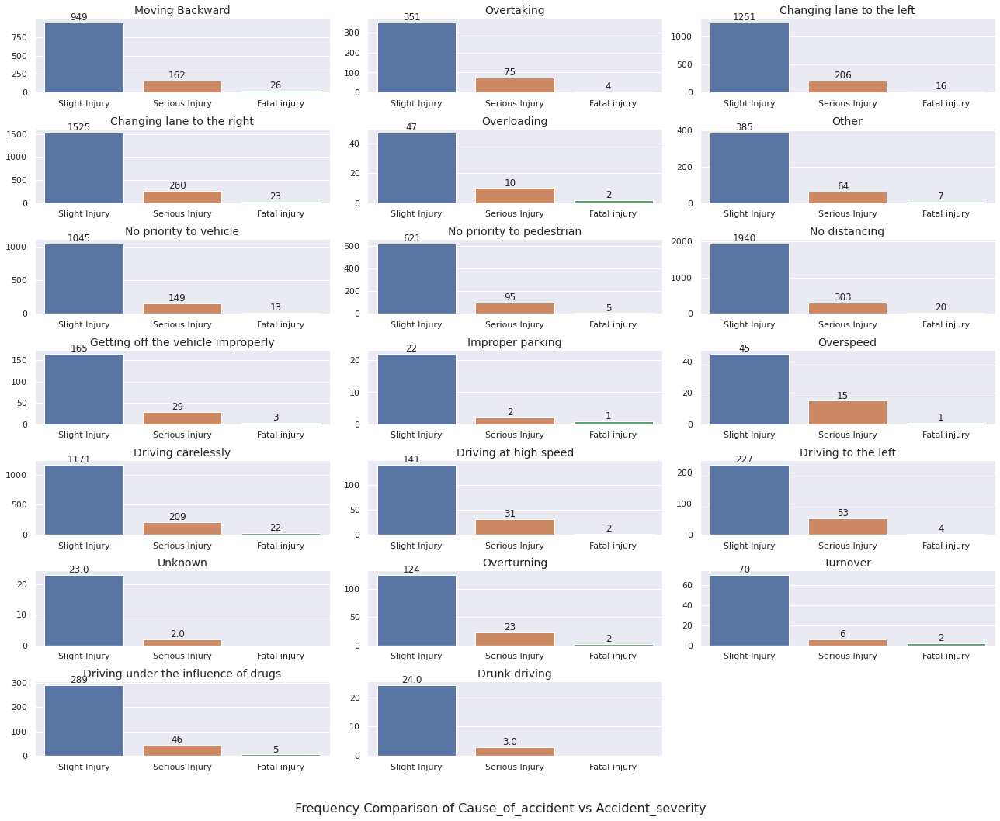




Showing Frequency Plots here for Accident_severity:



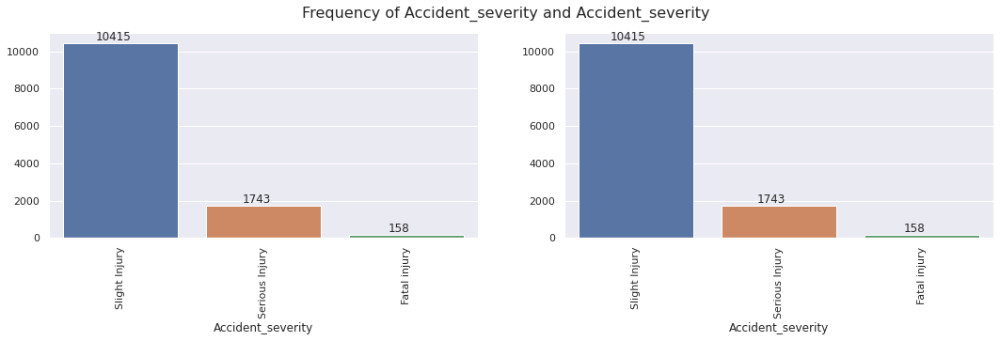


Showing Frequency Comparison of Accident_severity vs Accident_severity



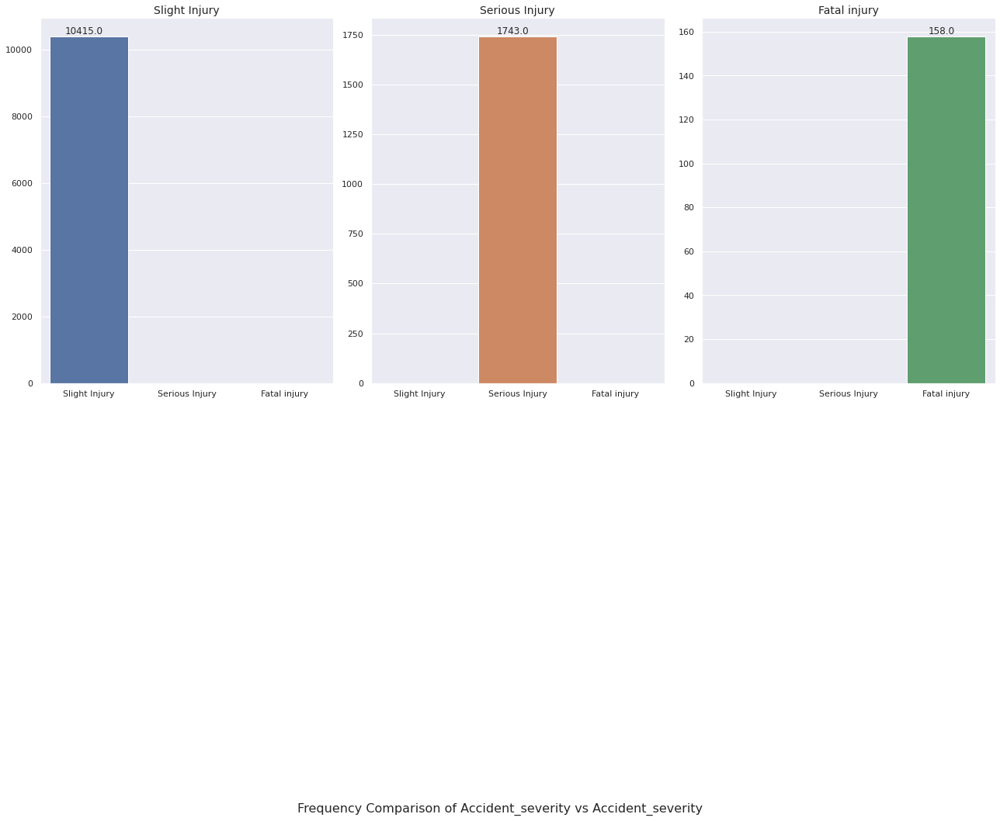

In [ ]:
for col in unique_data.columns:
    column_barplot(data, col, "Accident_severity", (18, 4))

Some important observations wchich might effect th analysis:
* Weekend has less accident but more fatal injury. Reason maybe drunk drive.
* Age_band_of_driver, Sex_of_driver, Education_level, Vehicle_driver_relation, Driving_experience, Owner_of_vehicle, Road_surface_conditions, Casualty_class, Age_band_of_casualty, Work_of_casuality, Fitness_of_casuality might not effect prediction.
* Type_of_vehicle, Service_year_of_vehicle, Type_of_junction, Light_conditions, Type_of_collision, Number_of_casualties, Pedestrian_movement, Cause_of_accident might effect the prdiction.
* Service_year_of_vehicle might effect the prediction but problem is a lot of them are "unknown".
* We can observe that Educational_level, Vehicle_driver_relation, Type_of_vehicle, Owner_of_vehicle, Area_accident_occured, Road_allignment, Types_of_Junction, Road_surface_type, Weather_conditions, Type_of_collision, Vehicle_movement, Work_of_casuality, Fitness_of_casuality, Pedestrian_movement has too many categories. We can reduce that.

#### Reduction of categories for smoother analysis

* We are reducing categories of the following attributes:
Educational_level, Vehicle_driver_relation, Type_of_vehicle, Owner_of_vehicle, Area_accident_occured, Road_allignment, Types_of_Junction, Road_surface_type, Weather_conditions, Type_of_collision, Vehicle_movement, Work_of_casuality, Fitness_of_casuality, Pedestrian_movement

* Although Cause_of_accident contain a lot of categories, at this stage we are hoping that this might help the analysis. We can change in next stage if required.

In [ ]:
# Reduction of Data categories
df = data_cat_reduction(data)

In [ ]:
df_uniques = uniques(df)
df_uniques

,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,Defect_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Monday: 13.65%,18-30: 34.68%,Male: 92.86%,Others: 32.12%,Employee: 78.17%,1-2yr: 14.26%,Automobile: 26.02%,Owner: 84.92%,Above 10yr: 10.75%,No defect: 63.15%,...,Going straight: 66.24%,na: 36.08%,na: 36.08%,na: 36.08%,na: 36.08%,Driver: 47.93%,Normal: 78.01%,Not a Pedestrian: 92.48%,Moving Backward: 9.23%,Slight Injury: 84.56%
1,Sunday: 11.91%,31-50: 33.18%,Female: 5.69%,Junior high school: 61.86%,Others: 17.13%,Above 10yr: 18.37%,Public (> 45 seats): 3.28%,Others: 11.16%,5-10yrs: 10.39%,7: 0.62%,...,Others: 11.97%,Driver or rider: 40.14%,Male: 42.65%,31-50: 19.93%,3: 57.45%,Others: 5.02%,Others: 0.59%,Possibly Pedestrian: 7.52%,Overtaking: 3.49%,Serious Injury: 14.15%
2,Friday: 16.57%,Under 18: 6.70%,Unknown: 1.45%,NaN,NaN,5-10yr: 27.31%,Lorry (41?100Q): 17.75%,NaN,1-2yr: 6.71%,5: 0.29%,...,Moving Backward: 8.00%,Pedestrian: 13.39%,Female: 21.27%,18-30: 25.54%,2: 6.26%,Employee: 4.49%,NaN,NaN,Changing lane to the left: 11.96%,Fatal injury: 1.28%
3,Wednesday: 14.94%,Over 51: 12.87%,NaN,NaN,NaN,2-5yr: 21.22%,Public (13?45 seats): 4.32%,NaN,2-5yrs: 14.55%,NaN,...,Turnover: 3.97%,Passenger: 10.39%,NaN,Under 18: 8.40%,1: 0.21%,Self-employed: 16.60%,NaN,NaN,Changing lane to the right: 14.68%,NaN
4,Saturday: 13.53%,Unknown: 12.57%,NaN,NaN,NaN,No Licence: 0.96%,Lorry (11?40Q): 4.39%,NaN,Unknown: 23.41%,NaN,...,Getting off: 2.75%,NaN,NaN,Over 51: 8.07%,NaN,NaN,NaN,NaN,Overloading: 0.48%,NaN
5,Thursday: 15.03%,NaN,NaN,NaN,NaN,Below 1yr: 10.90%,Long lorry: 3.11%,NaN,Below 1yr: 2.29%,NaN,...,Reversing: 4.57%,NaN,NaN,5: 1.98%,NaN,NaN,NaN,NaN,Other: 3.70%,NaN
6,Tuesday: 14.37%,NaN,NaN,NaN,NaN,unknown: 0.27%,Public (12 seats): 5.77%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to vehicle: 9.80%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.15%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to pedestrian: 5.85%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.58%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No distancing: 18.37%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.58%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Getting off the vehicle improperly: 1.60%,NaN


Showing Frequency Plots here for Day_of_week:



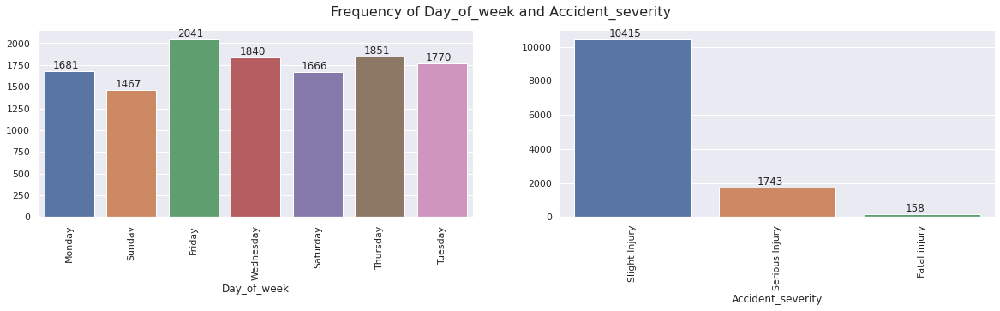


Showing Frequency Comparison of Day_of_week vs Accident_severity



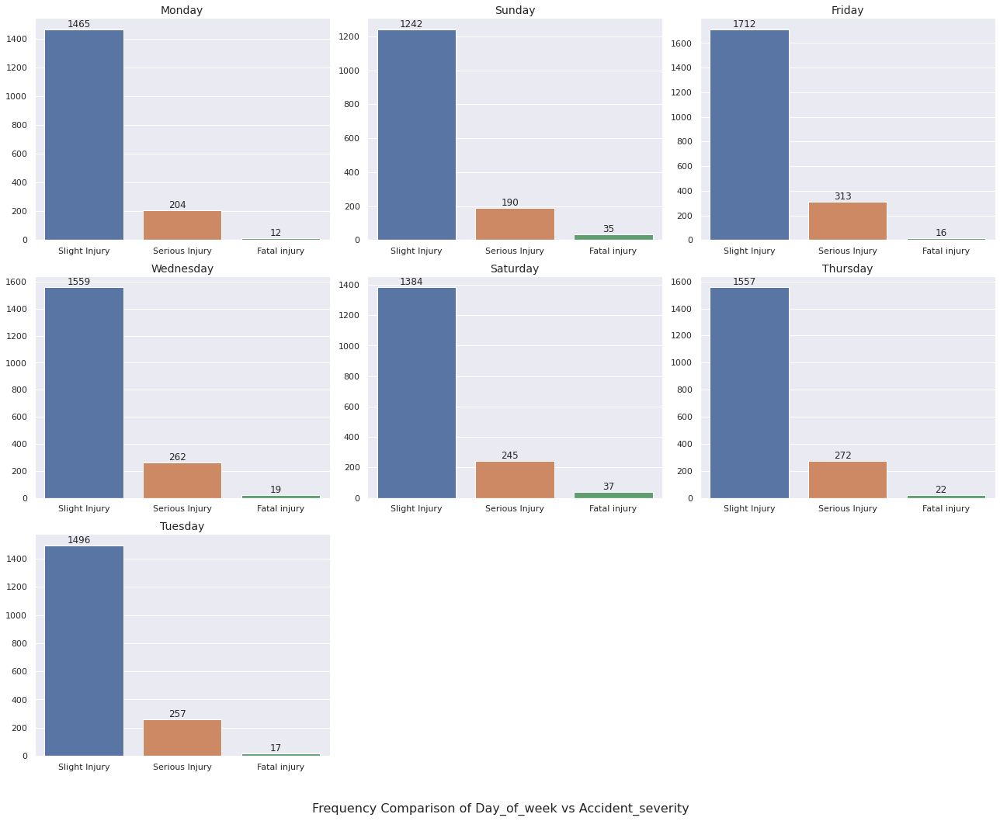




Showing Frequency Plots here for Age_band_of_driver:



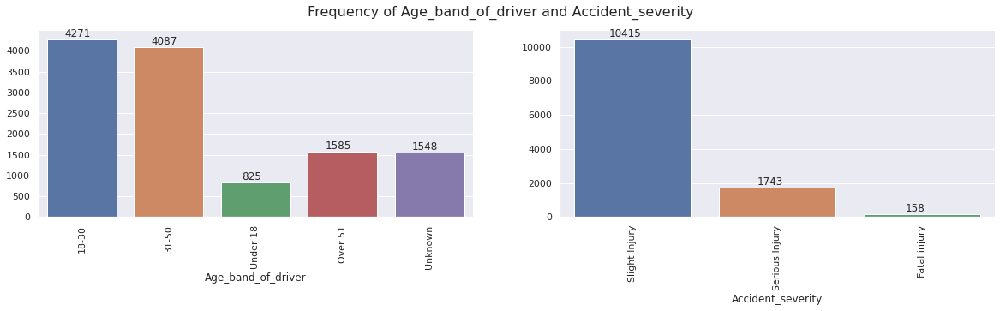


Showing Frequency Comparison of Age_band_of_driver vs Accident_severity



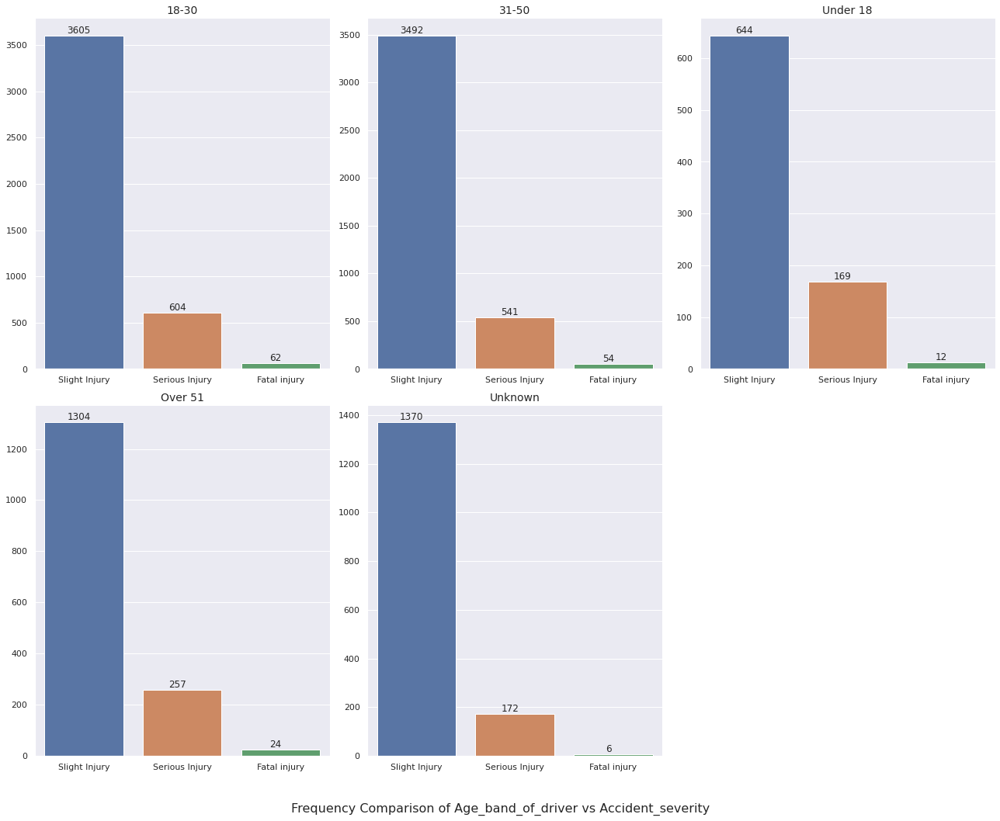




Showing Frequency Plots here for Sex_of_driver:



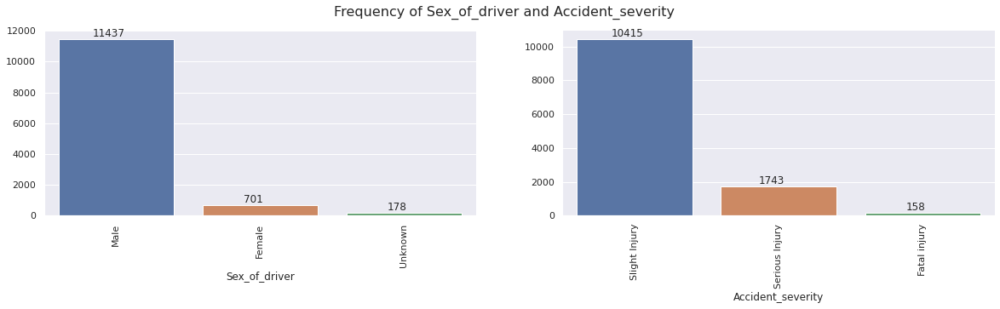


Showing Frequency Comparison of Sex_of_driver vs Accident_severity



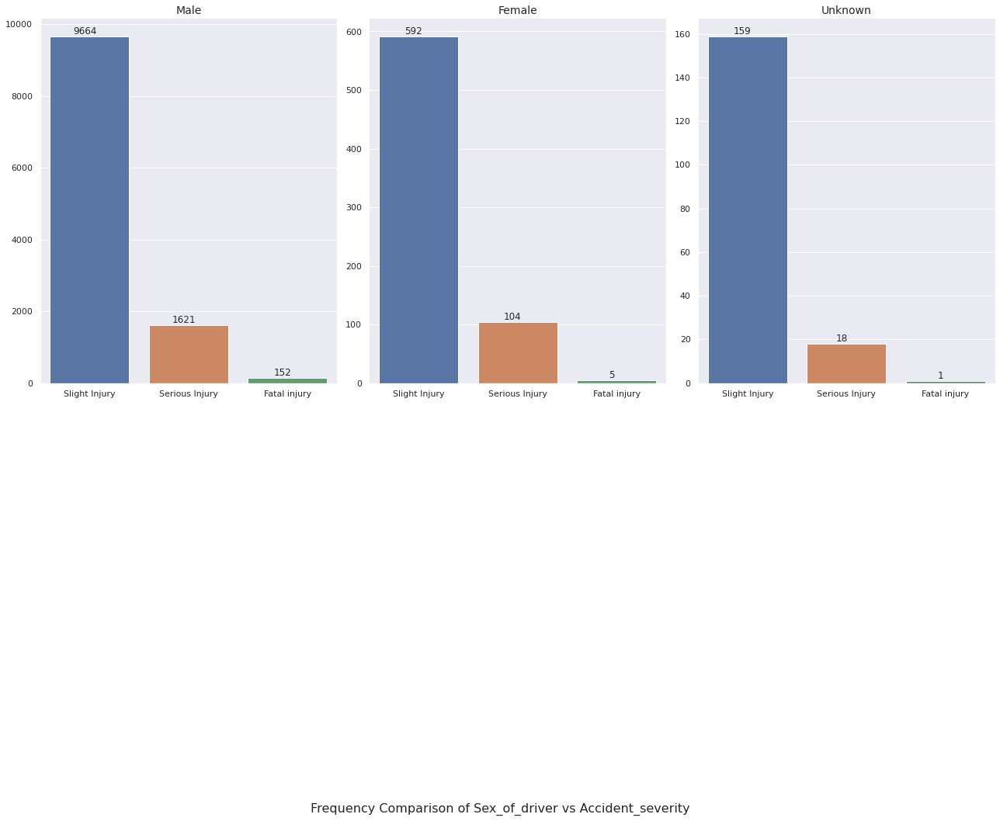




Showing Frequency Plots here for Educational_level:



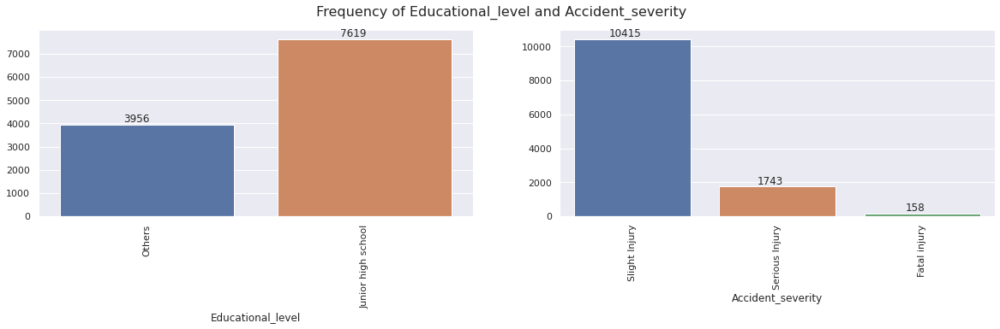


Showing Frequency Comparison of Educational_level vs Accident_severity



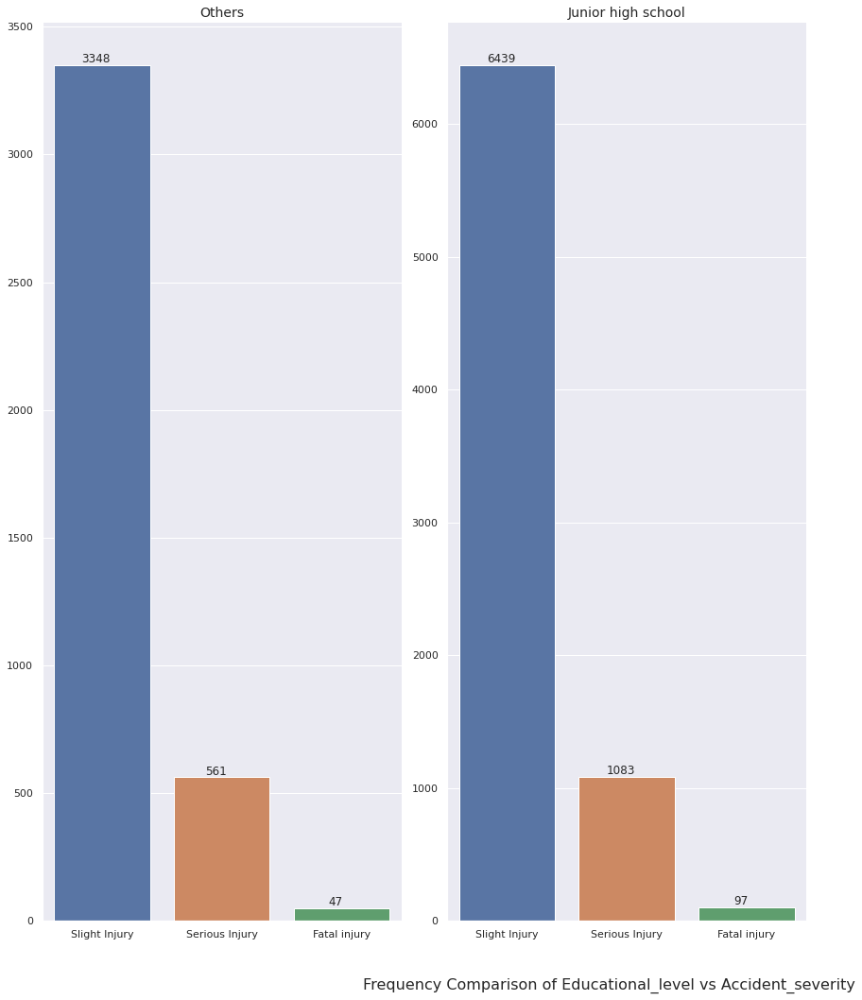




Showing Frequency Plots here for Vehicle_driver_relation:



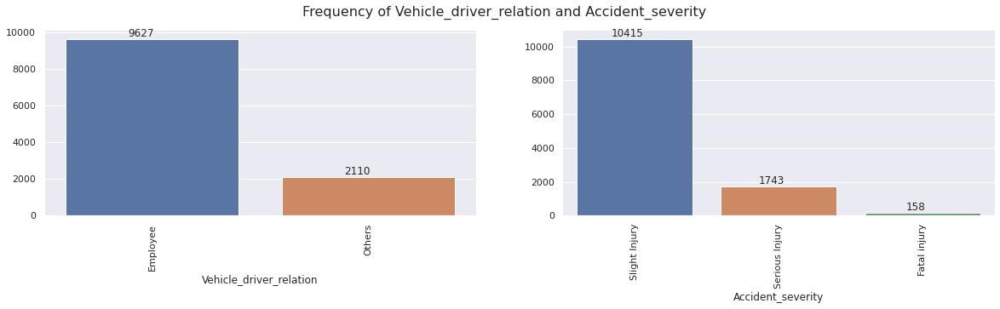


Showing Frequency Comparison of Vehicle_driver_relation vs Accident_severity



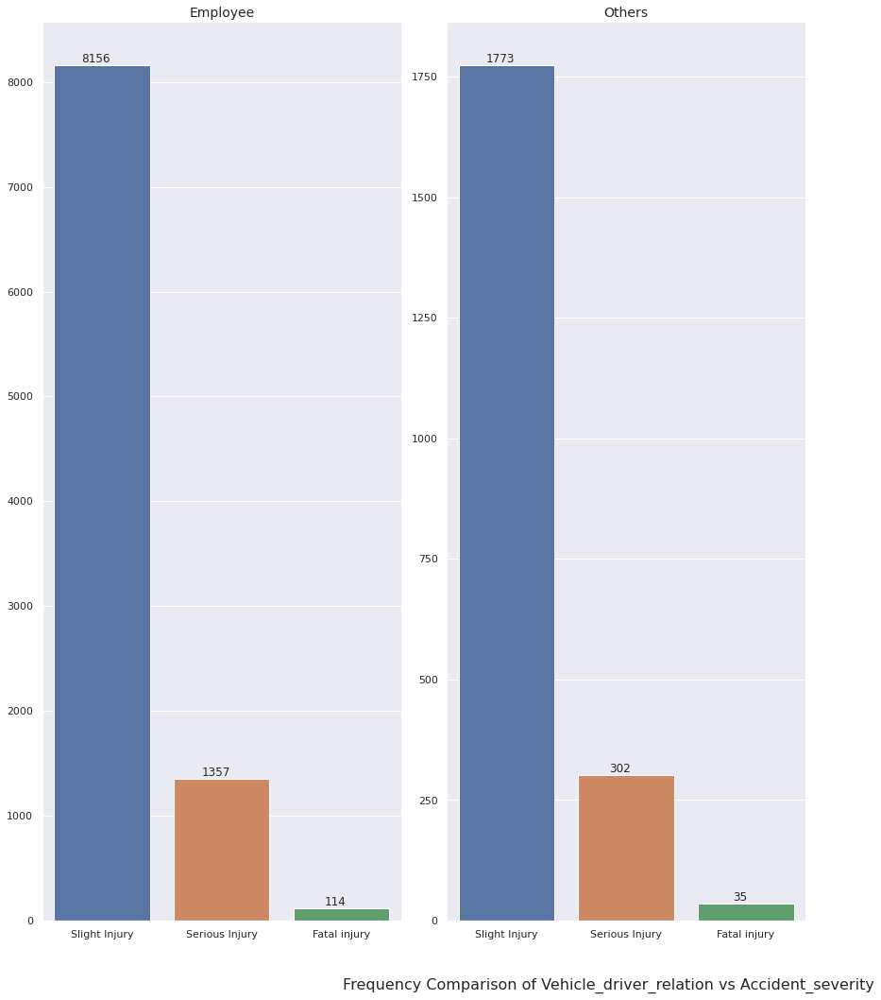




Showing Frequency Plots here for Driving_experience:



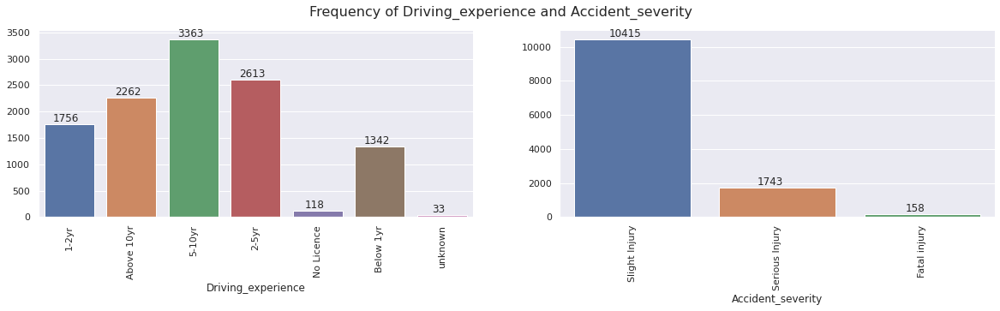


Showing Frequency Comparison of Driving_experience vs Accident_severity



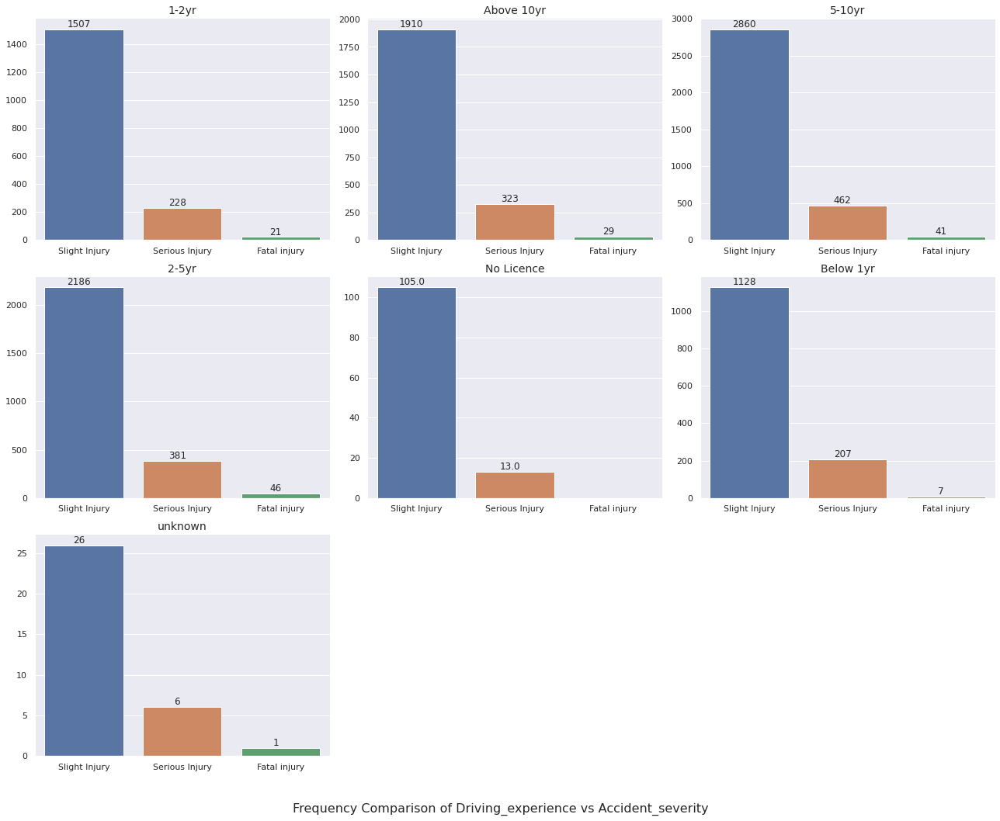




Showing Frequency Plots here for Type_of_vehicle:



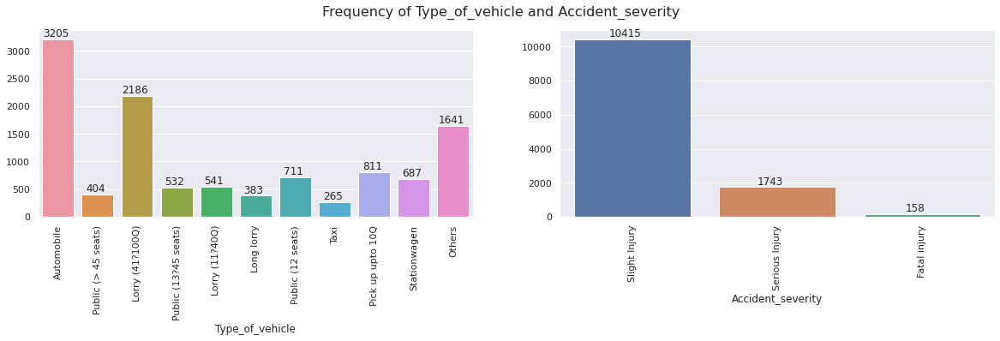


Showing Frequency Comparison of Type_of_vehicle vs Accident_severity



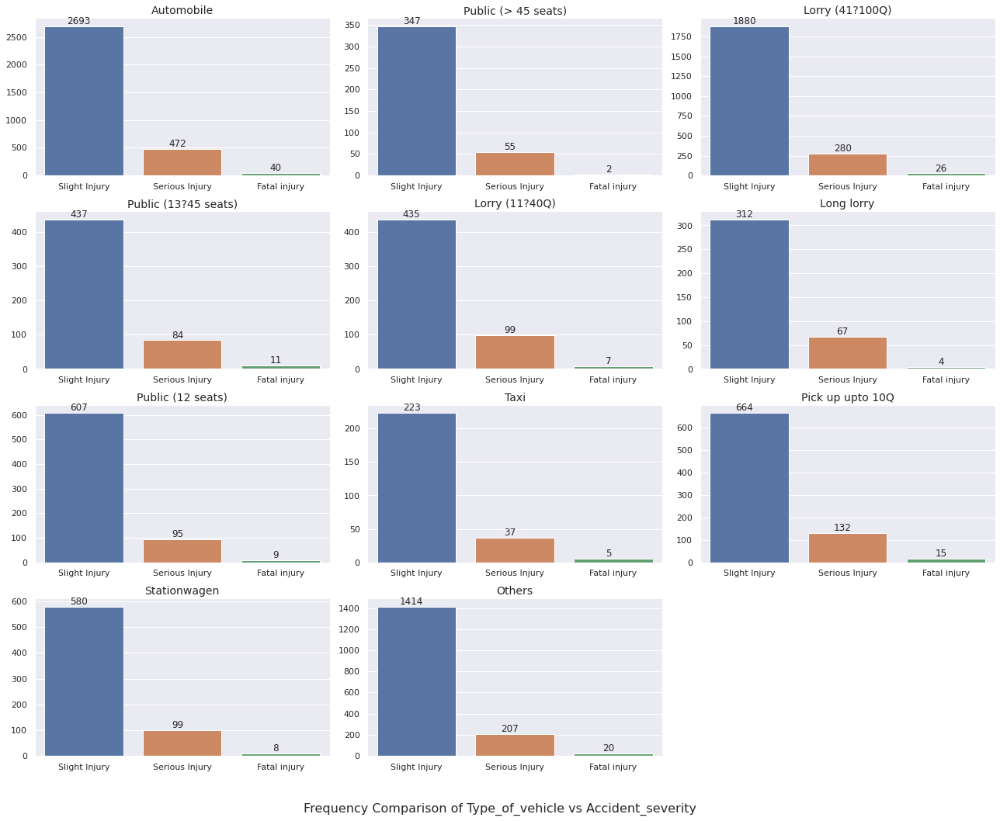




Showing Frequency Plots here for Owner_of_vehicle:



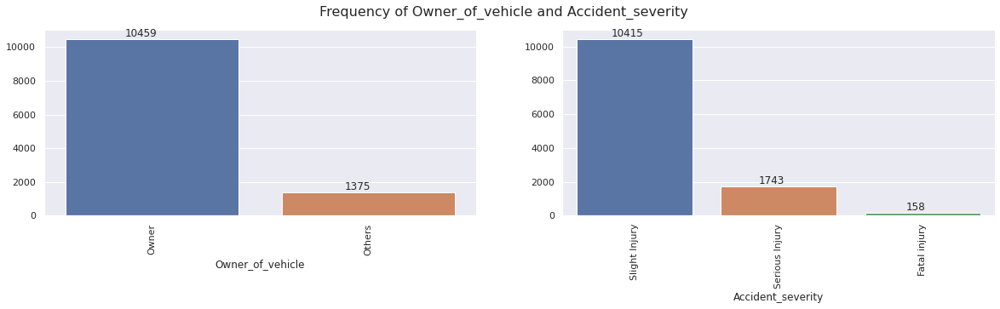


Showing Frequency Comparison of Owner_of_vehicle vs Accident_severity



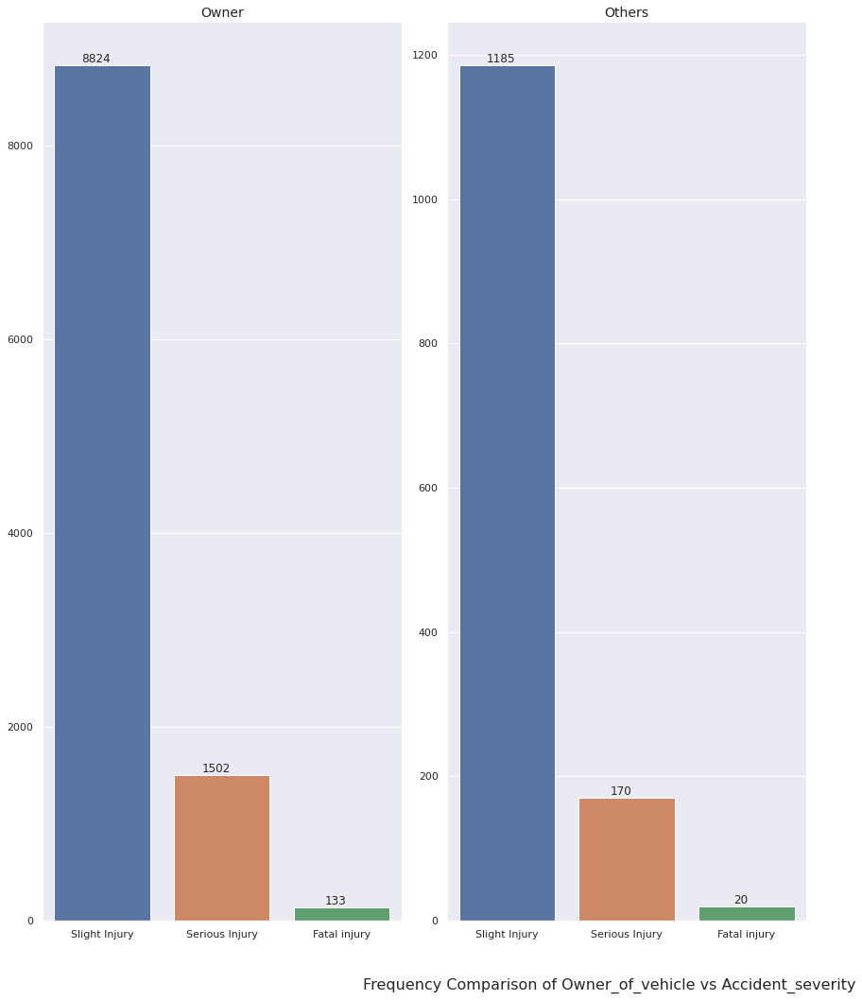




Showing Frequency Plots here for Service_year_of_vehicle:



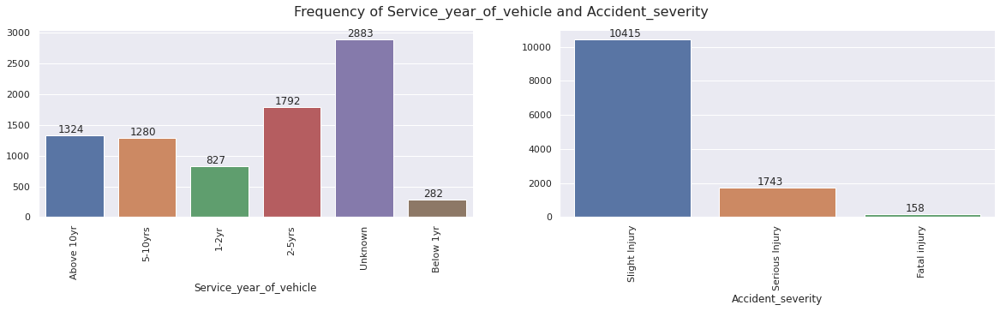


Showing Frequency Comparison of Service_year_of_vehicle vs Accident_severity



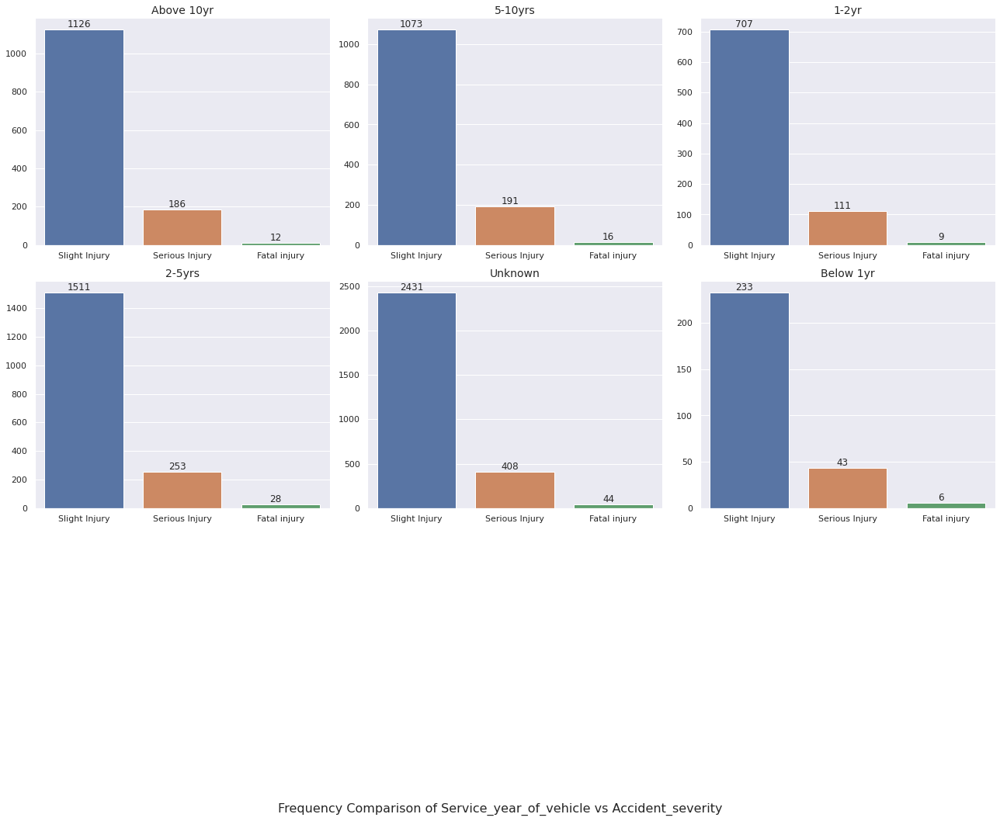




Showing Frequency Plots here for Defect_of_vehicle:



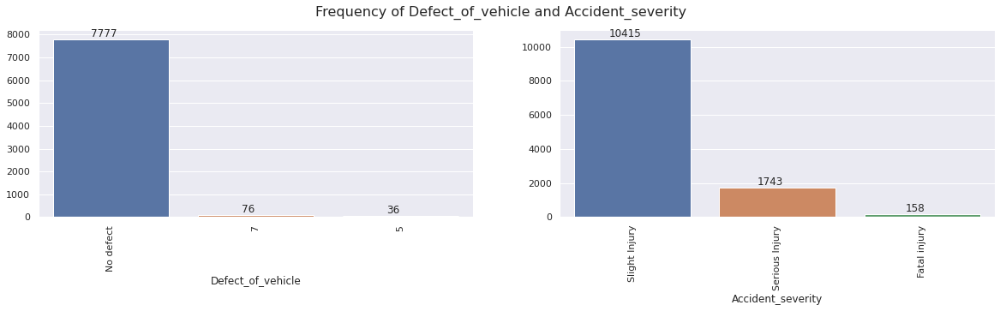


Showing Frequency Comparison of Defect_of_vehicle vs Accident_severity



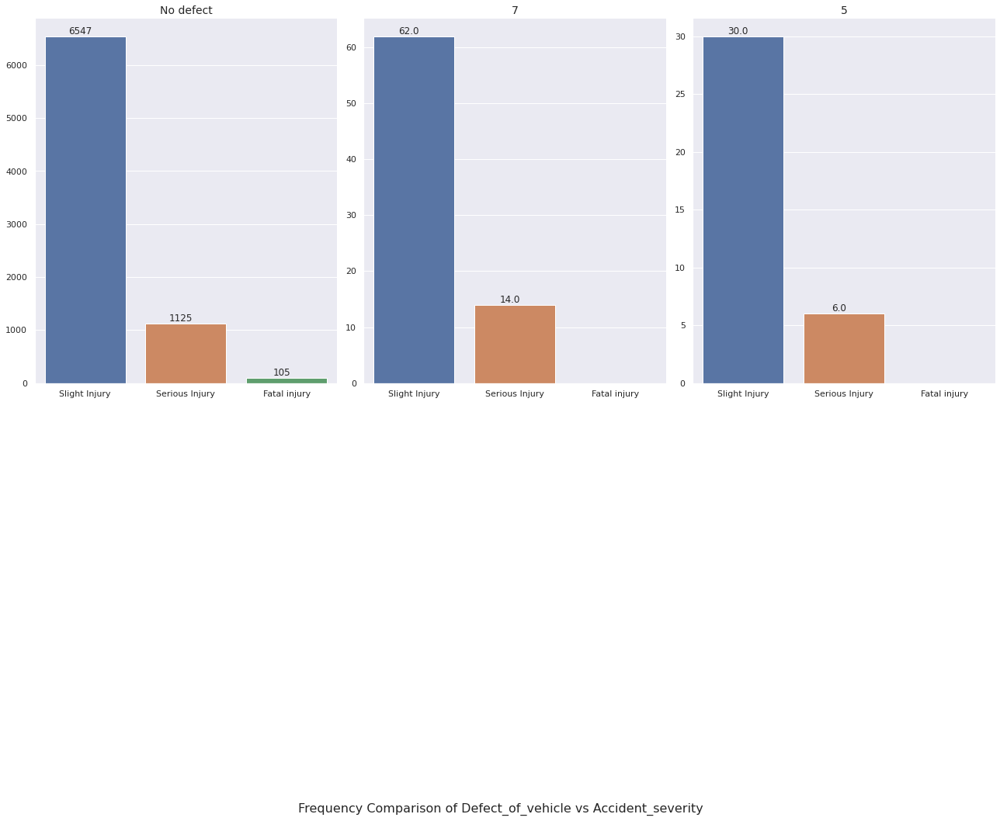




Showing Frequency Plots here for Area_accident_occured:



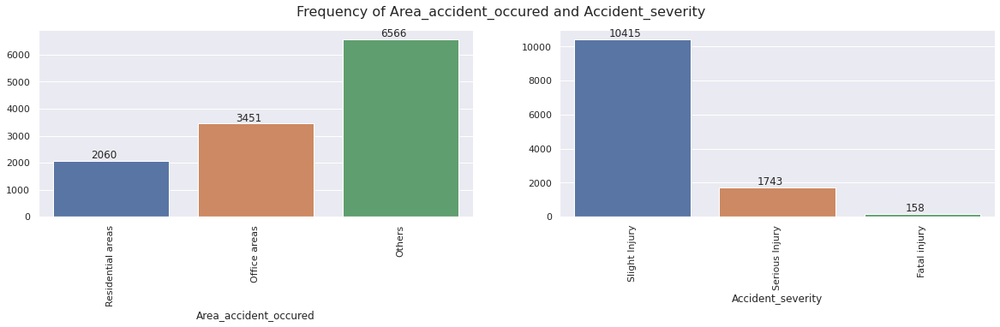


Showing Frequency Comparison of Area_accident_occured vs Accident_severity



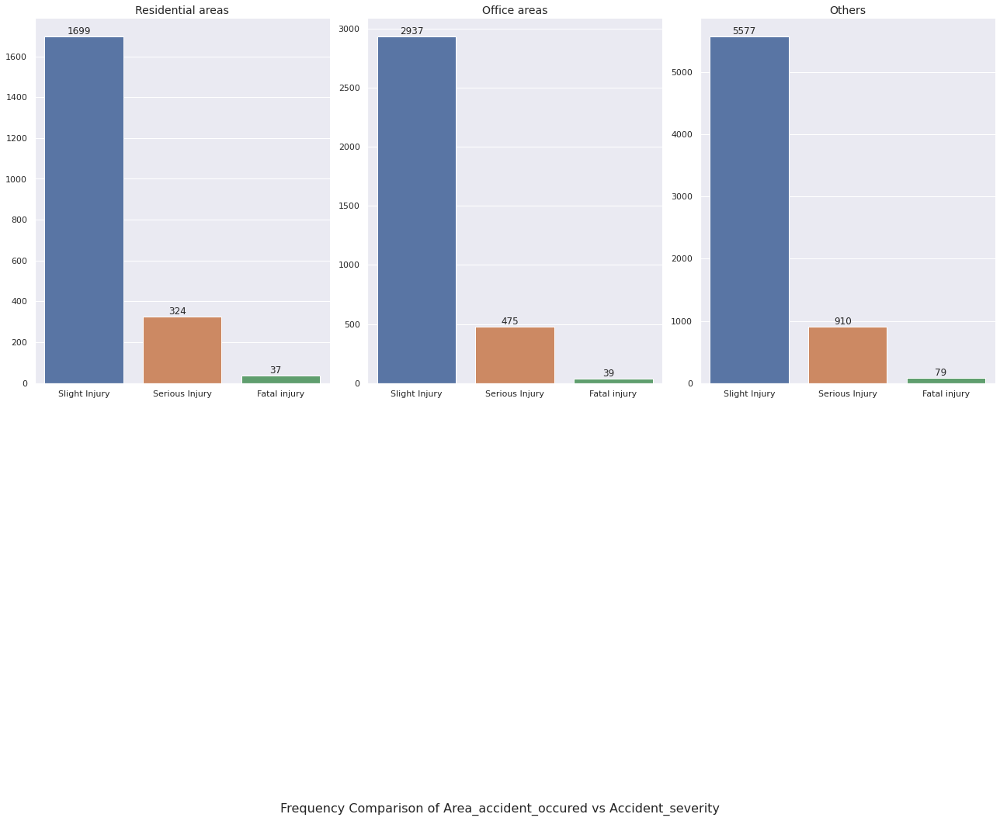




Showing Frequency Plots here for Lanes_or_Medians:



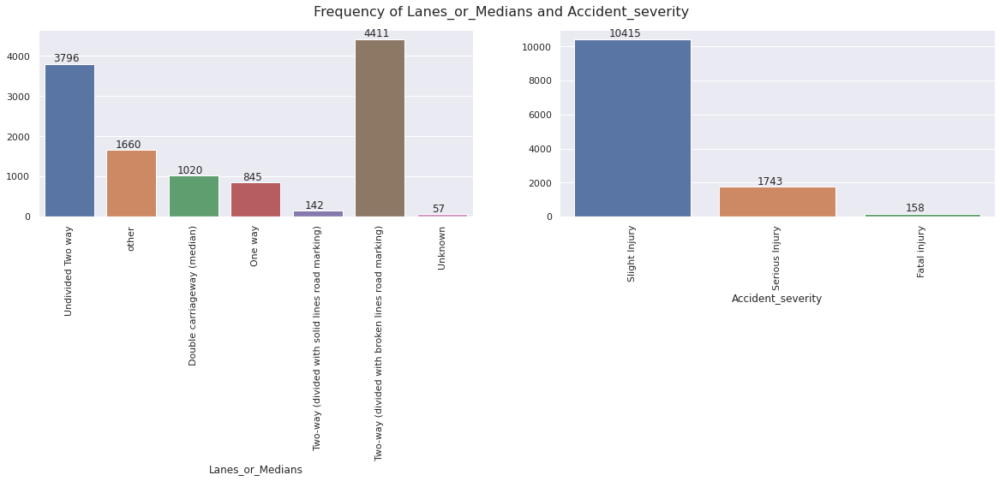


Showing Frequency Comparison of Lanes_or_Medians vs Accident_severity



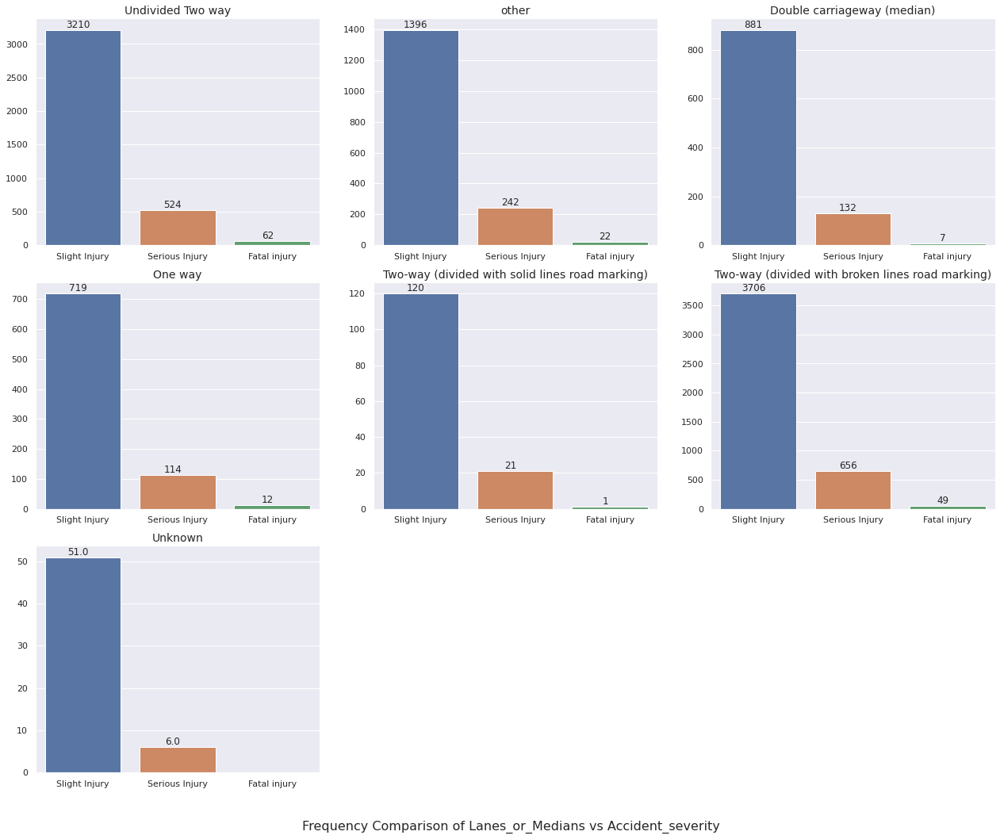




Showing Frequency Plots here for Road_allignment:



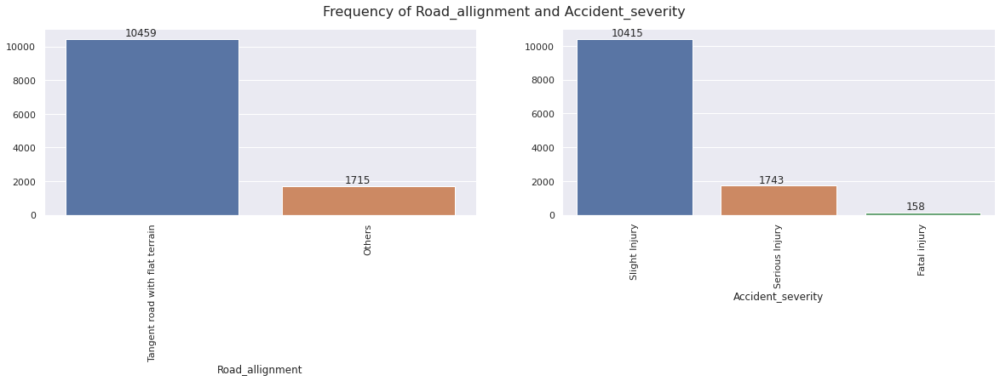


Showing Frequency Comparison of Road_allignment vs Accident_severity



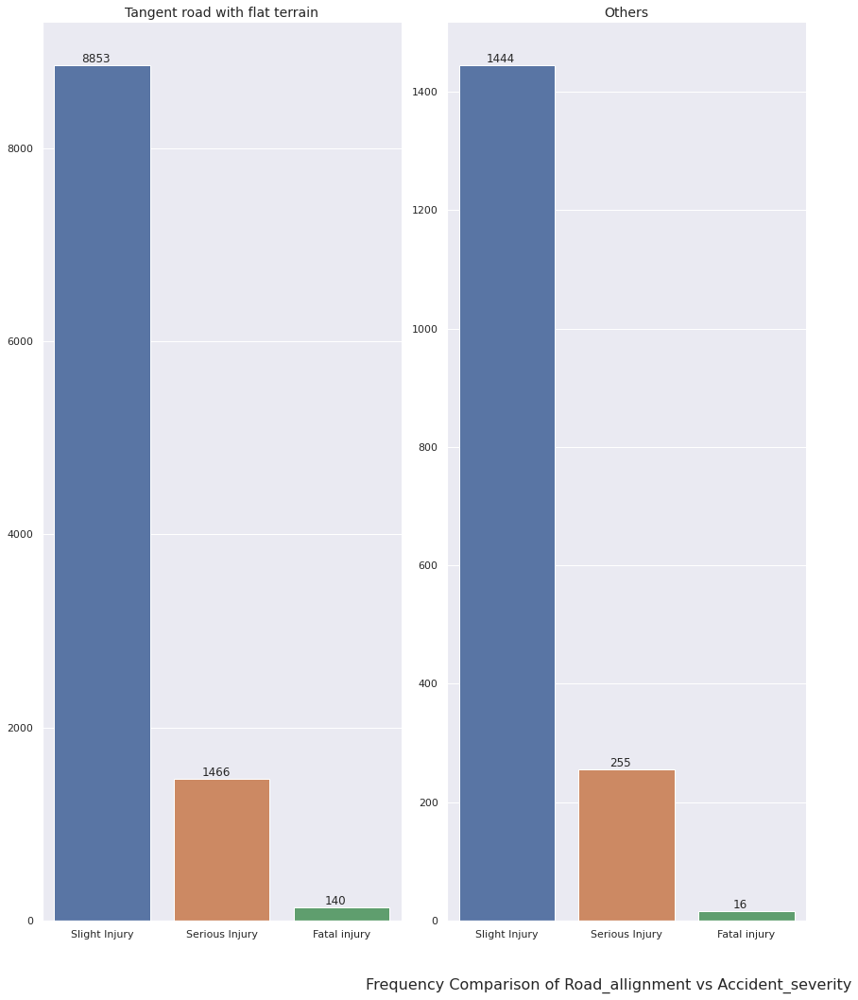




Showing Frequency Plots here for Types_of_Junction:



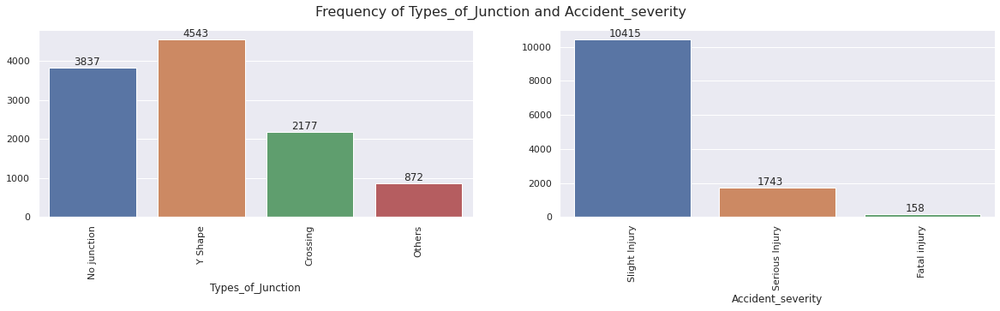


Showing Frequency Comparison of Types_of_Junction vs Accident_severity



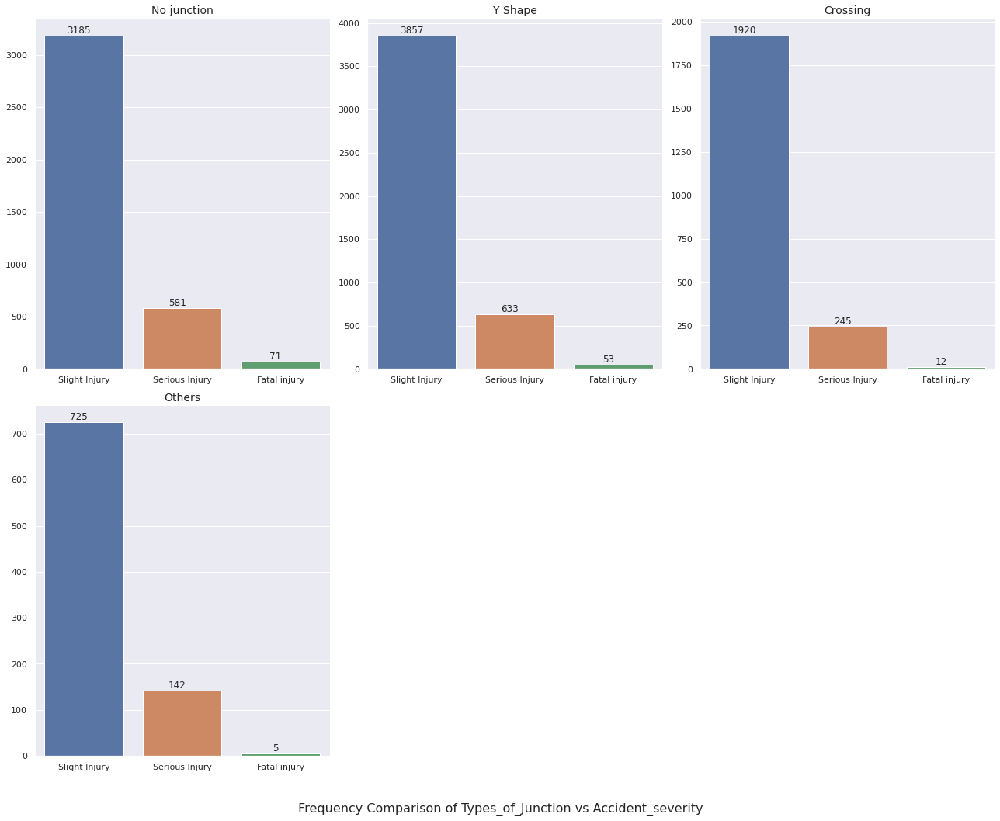




Showing Frequency Plots here for Road_surface_type:



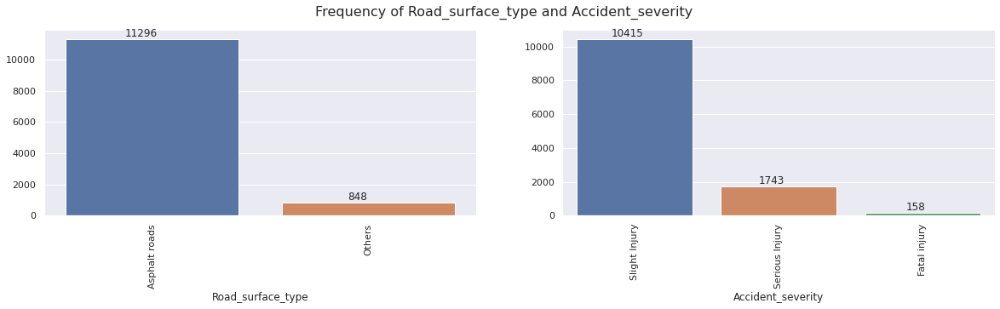


Showing Frequency Comparison of Road_surface_type vs Accident_severity



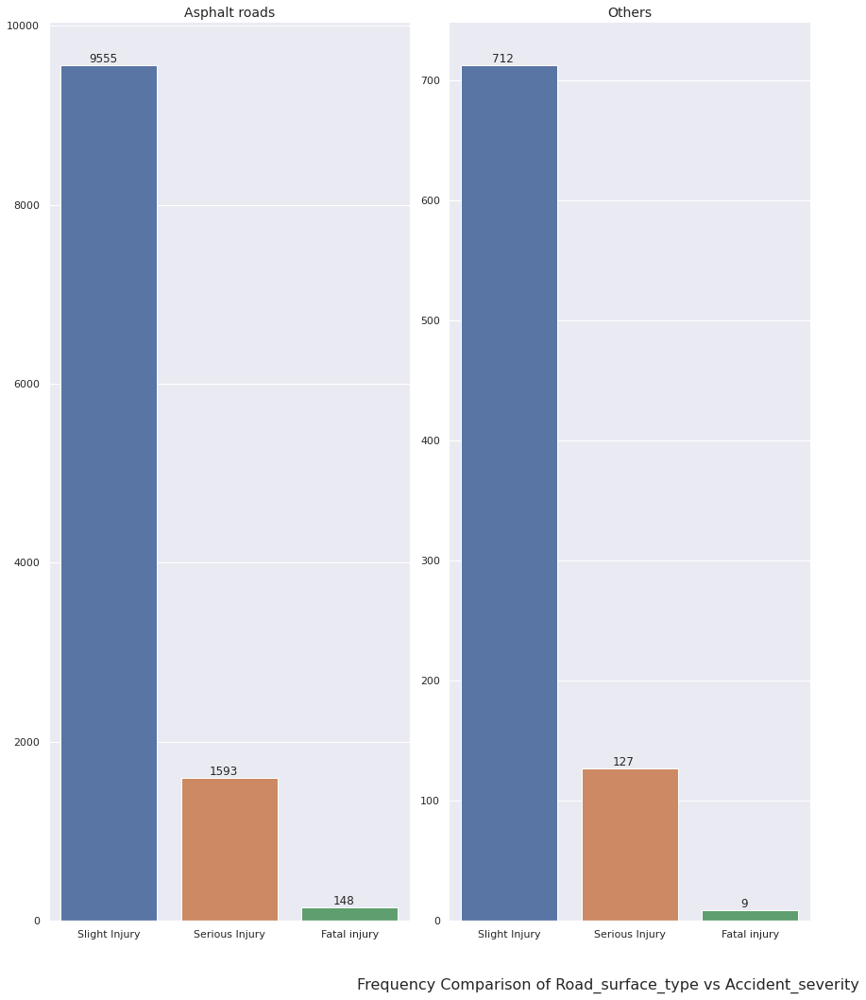




Showing Frequency Plots here for Road_surface_conditions:



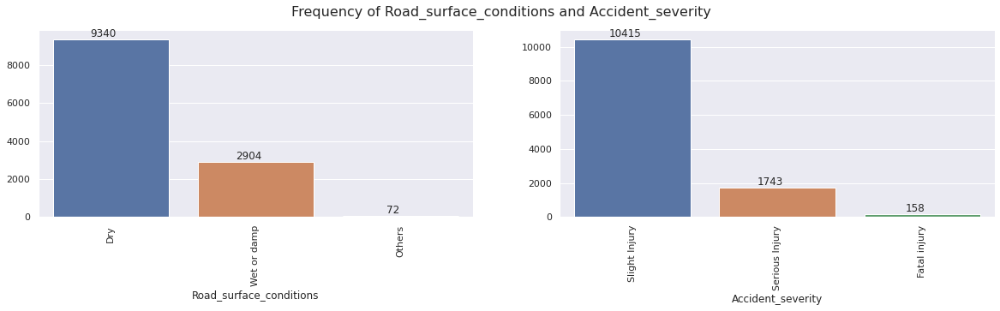


Showing Frequency Comparison of Road_surface_conditions vs Accident_severity



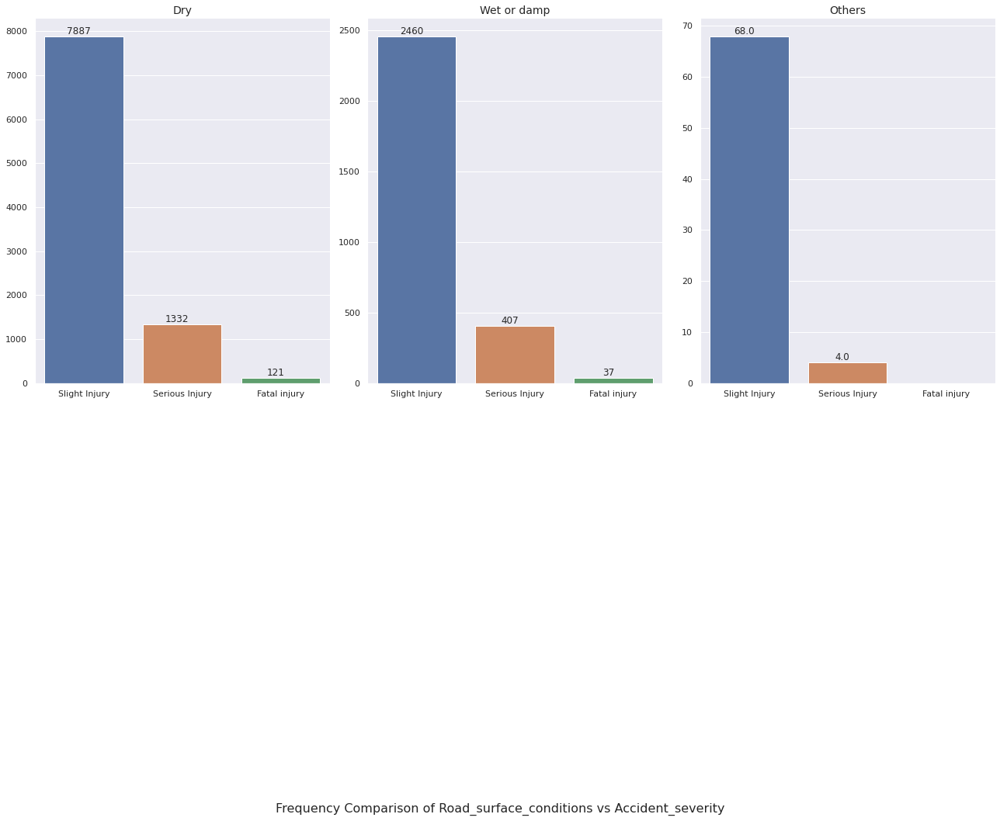




Showing Frequency Plots here for Light_conditions:



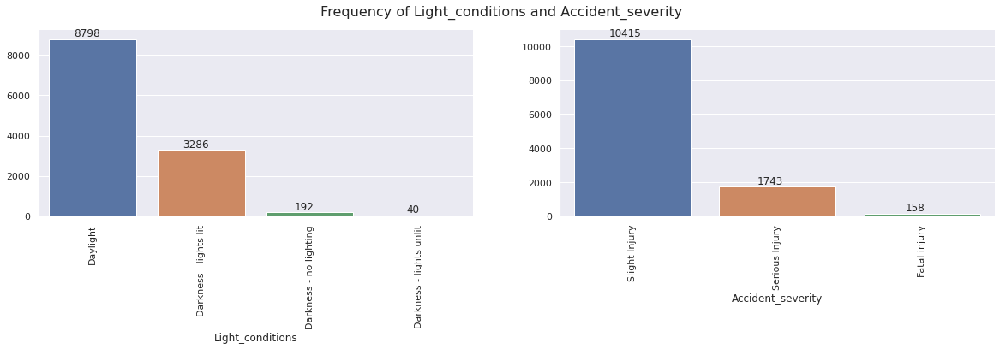


Showing Frequency Comparison of Light_conditions vs Accident_severity



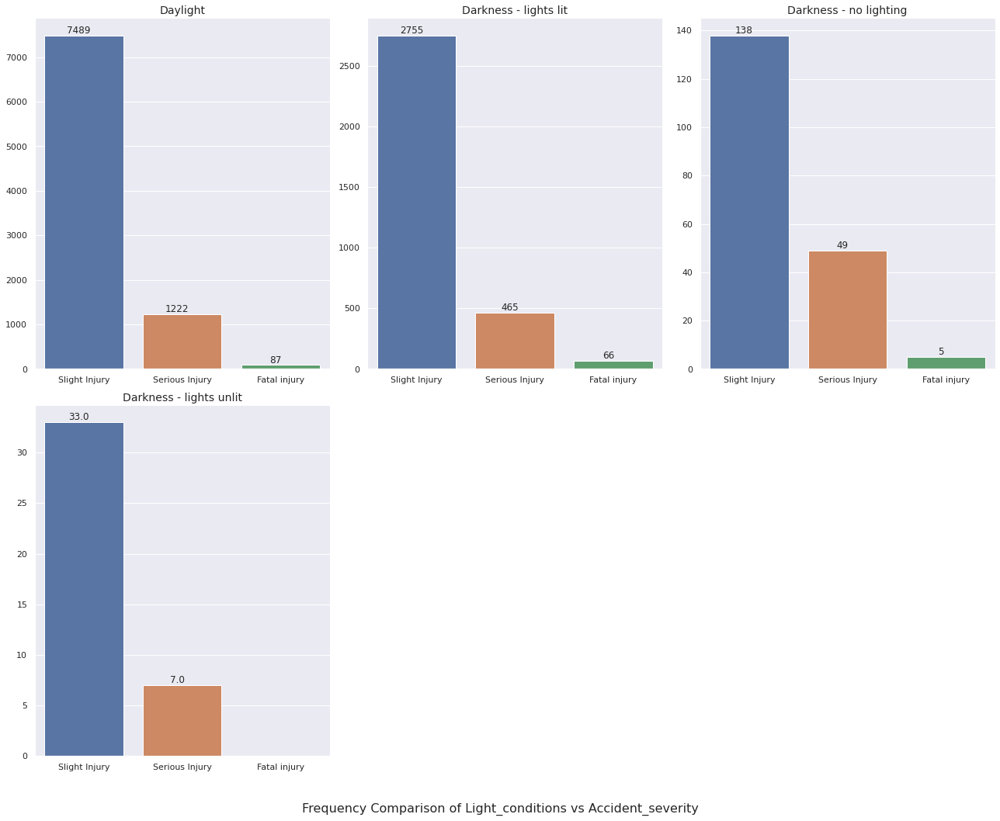




Showing Frequency Plots here for Weather_conditions:



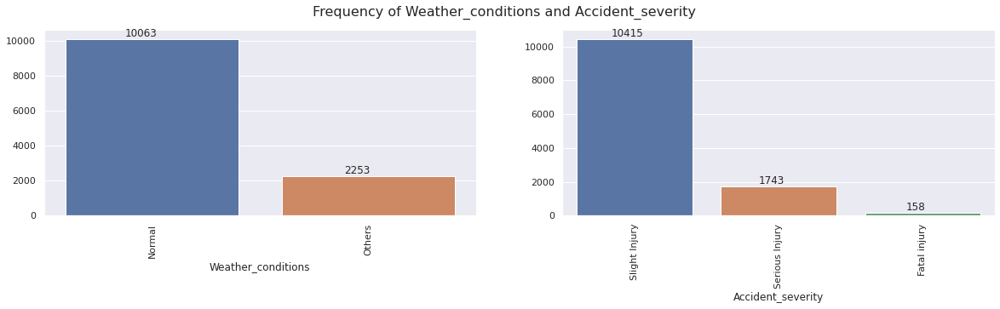


Showing Frequency Comparison of Weather_conditions vs Accident_severity



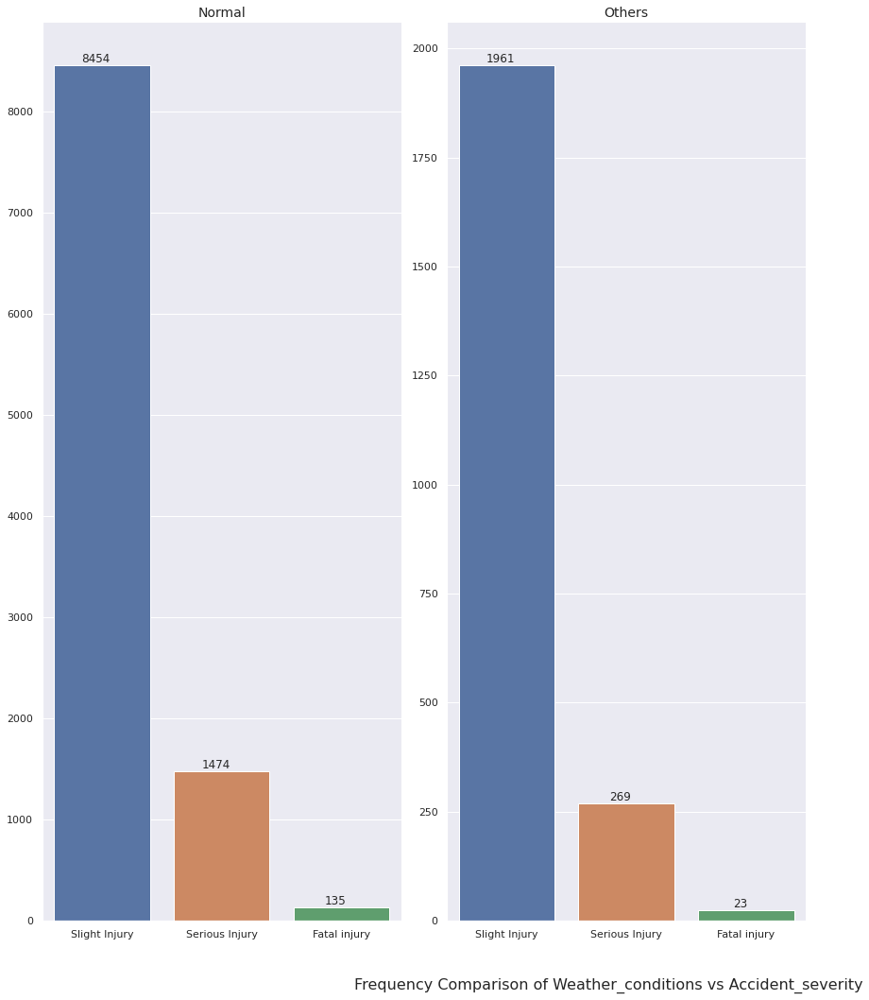




Showing Frequency Plots here for Type_of_collision:



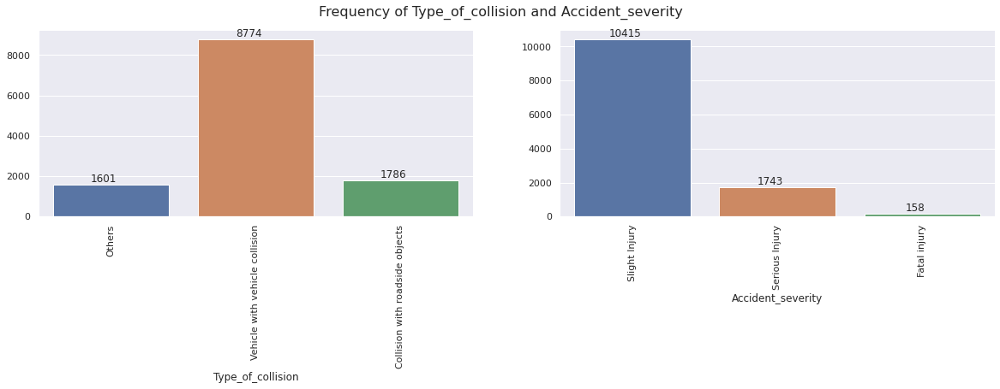


Showing Frequency Comparison of Type_of_collision vs Accident_severity



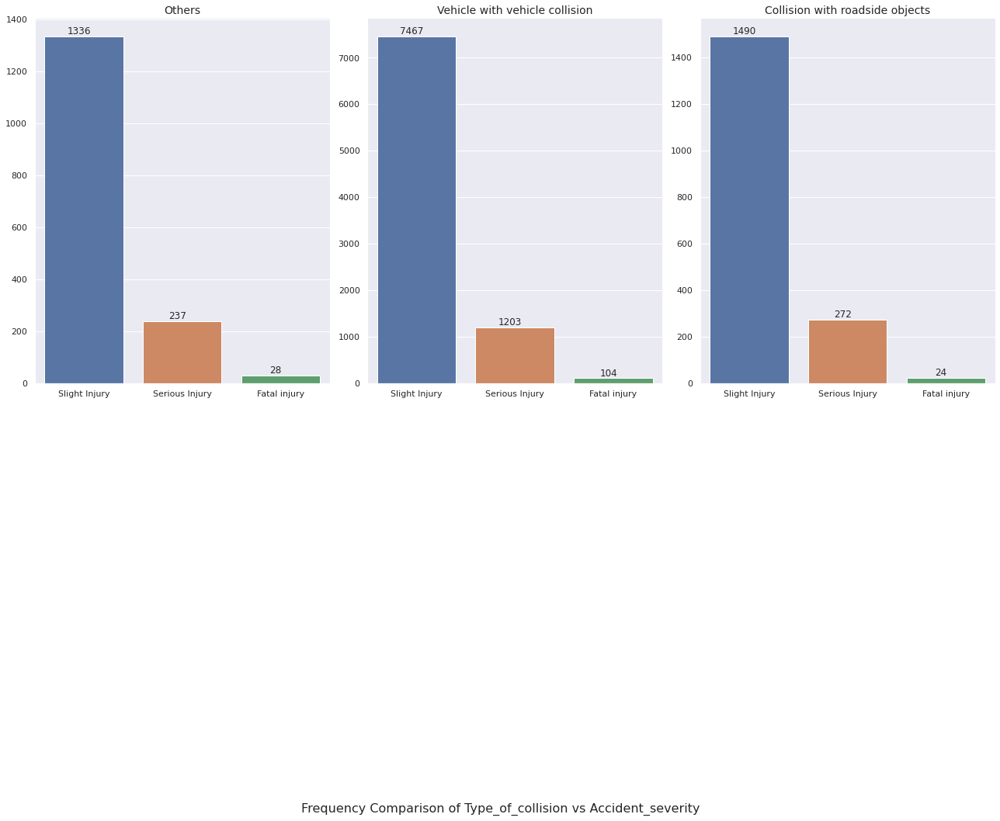




Showing Frequency Plots here for Number_of_vehicles_involved:



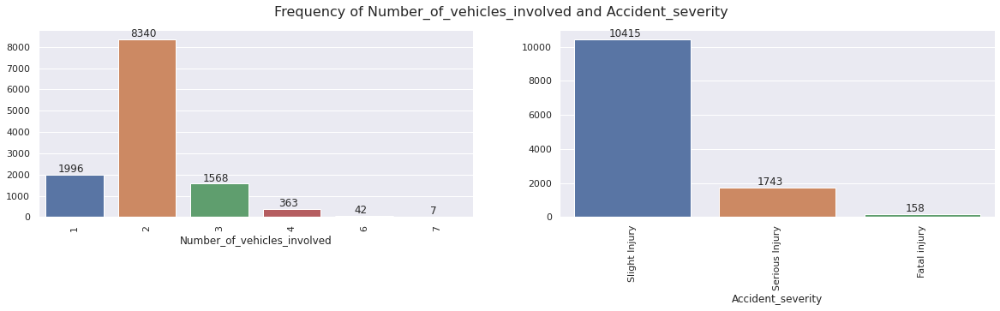


Showing Frequency Comparison of Number_of_vehicles_involved vs Accident_severity



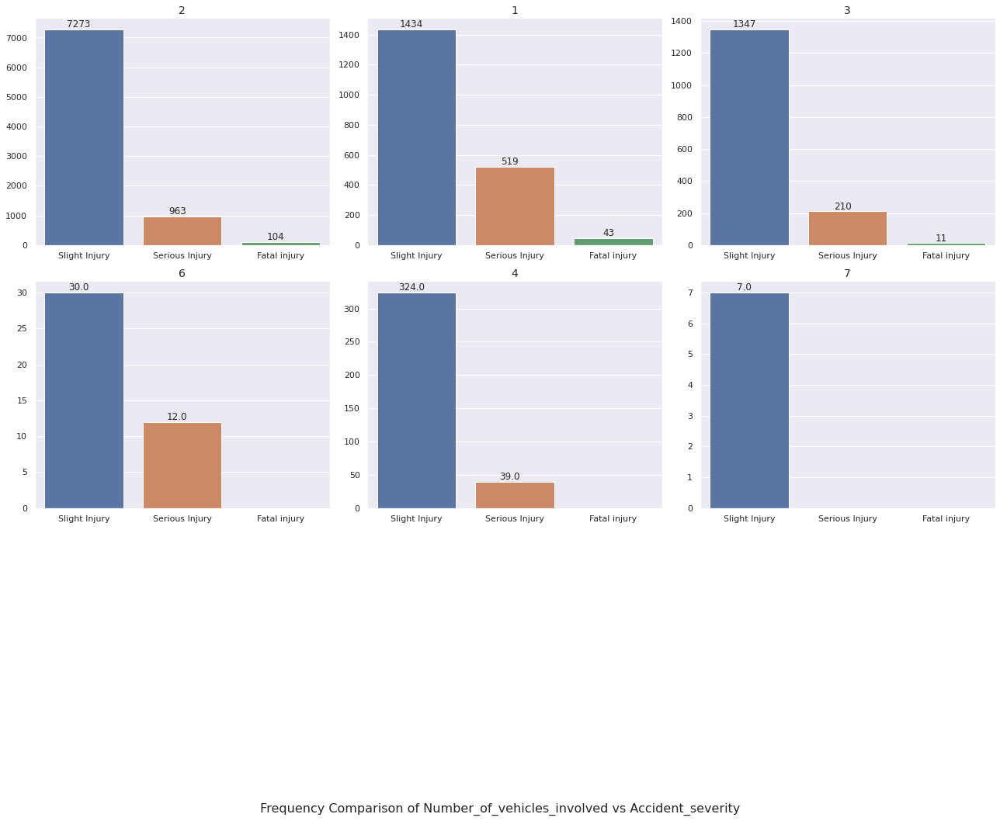




Showing Frequency Plots here for Number_of_casualties:



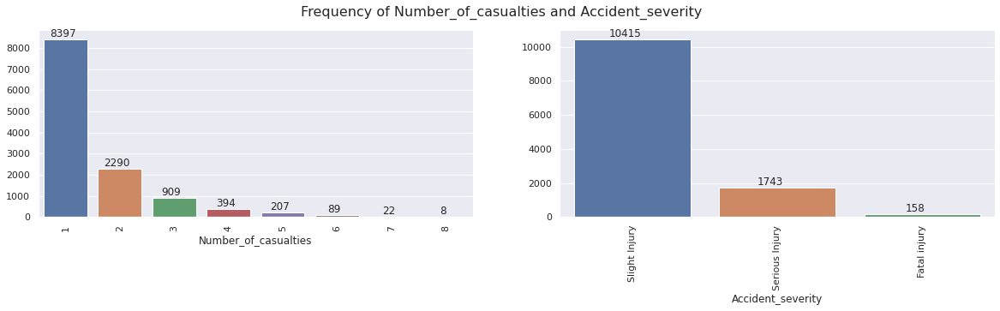


Showing Frequency Comparison of Number_of_casualties vs Accident_severity



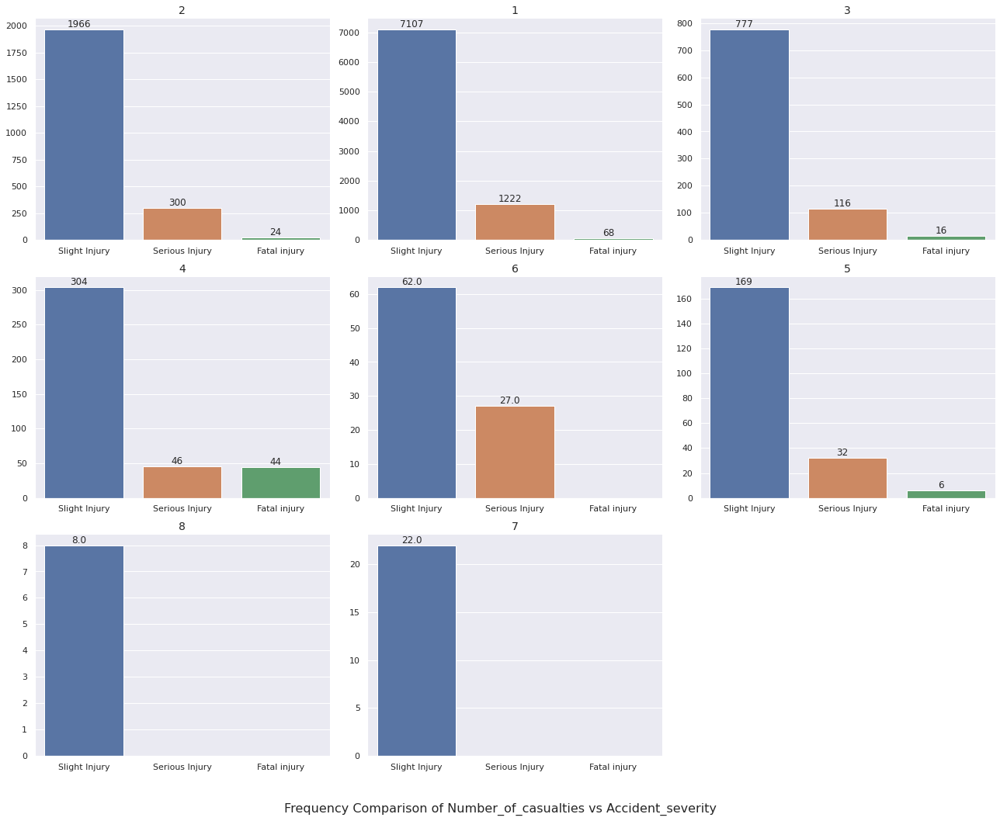




Showing Frequency Plots here for Vehicle_movement:



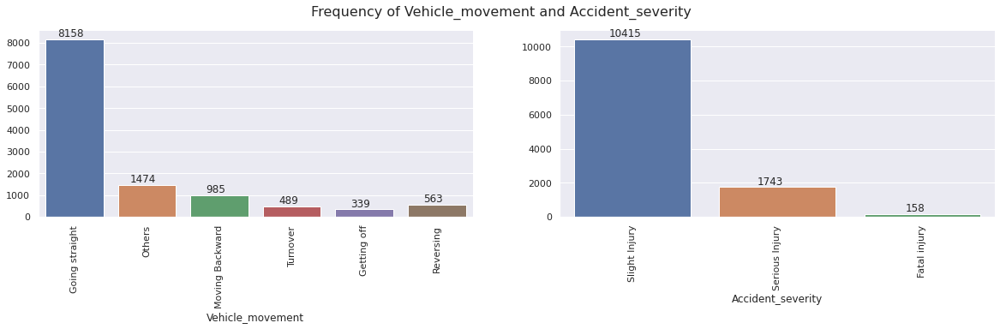


Showing Frequency Comparison of Vehicle_movement vs Accident_severity



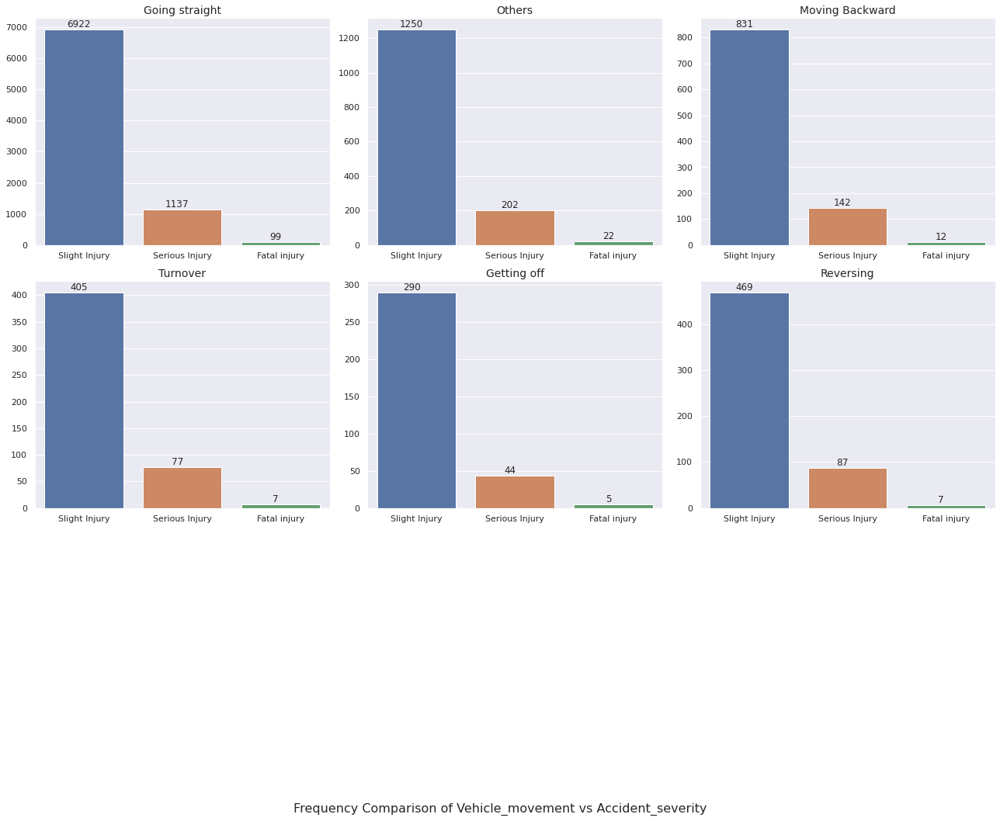




Showing Frequency Plots here for Casualty_class:



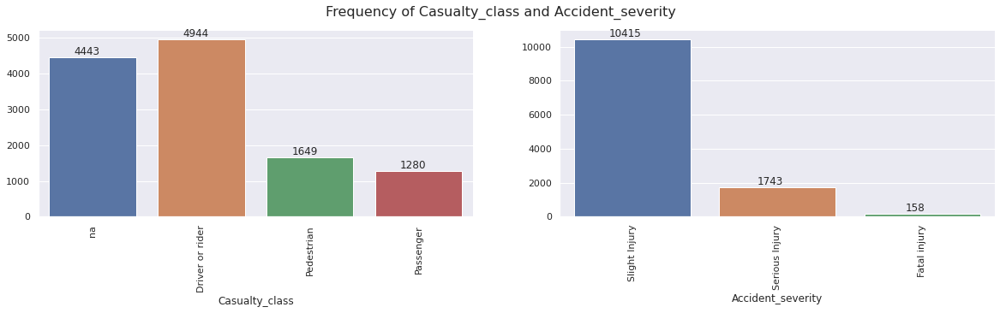


Showing Frequency Comparison of Casualty_class vs Accident_severity



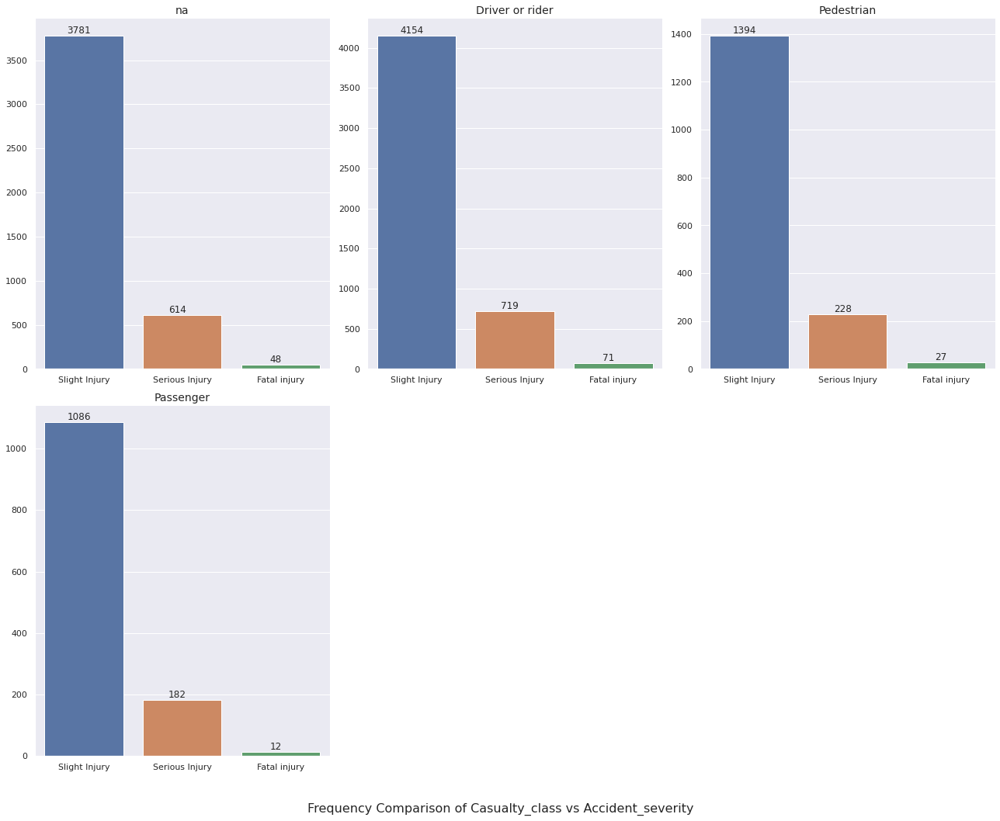




Showing Frequency Plots here for Sex_of_casualty:



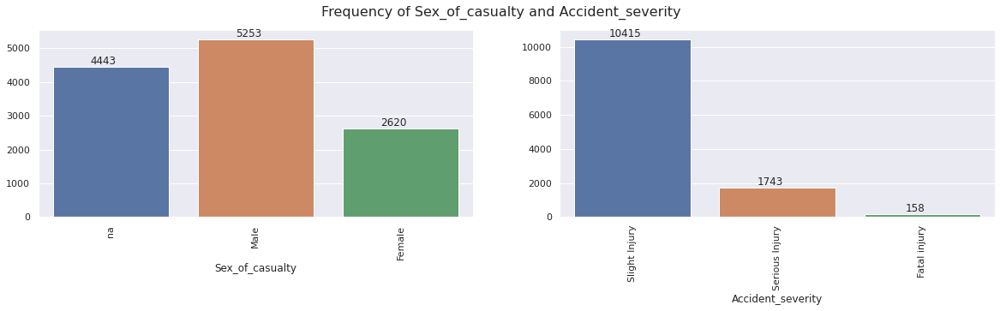


Showing Frequency Comparison of Sex_of_casualty vs Accident_severity



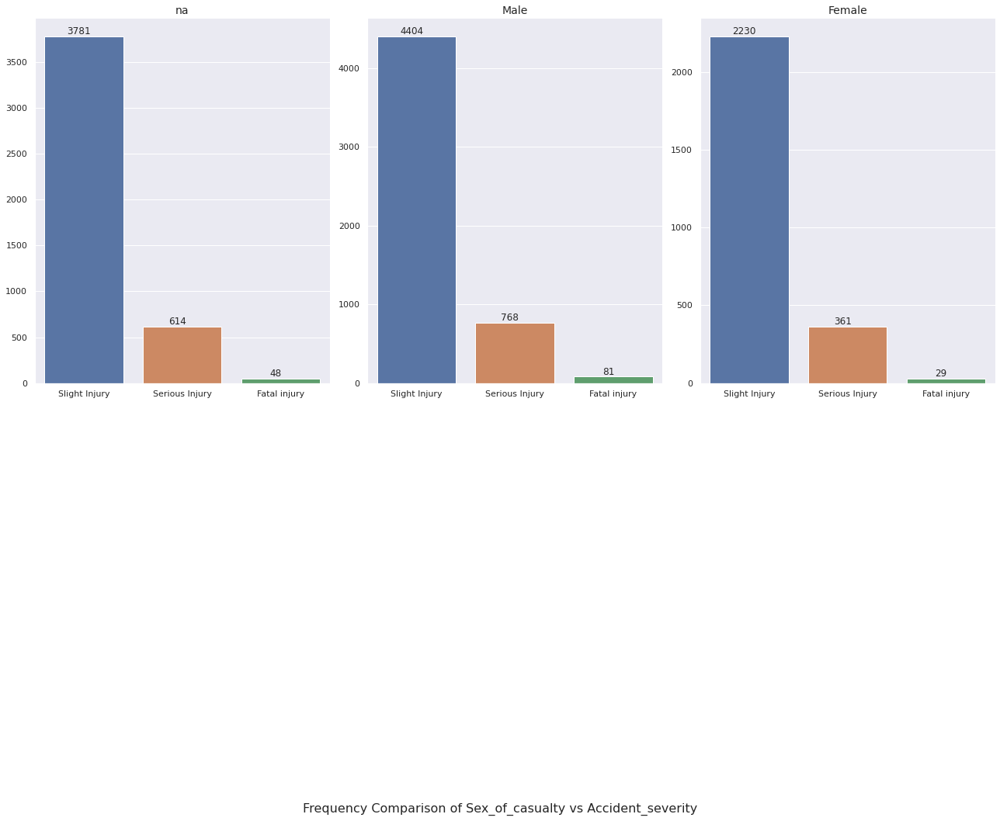




Showing Frequency Plots here for Age_band_of_casualty:



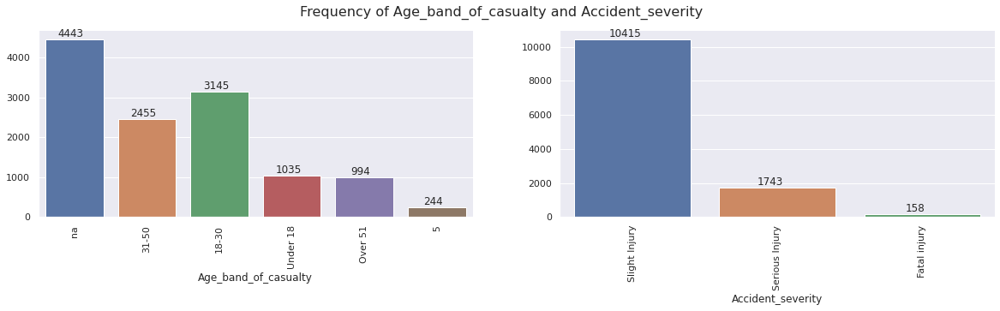


Showing Frequency Comparison of Age_band_of_casualty vs Accident_severity



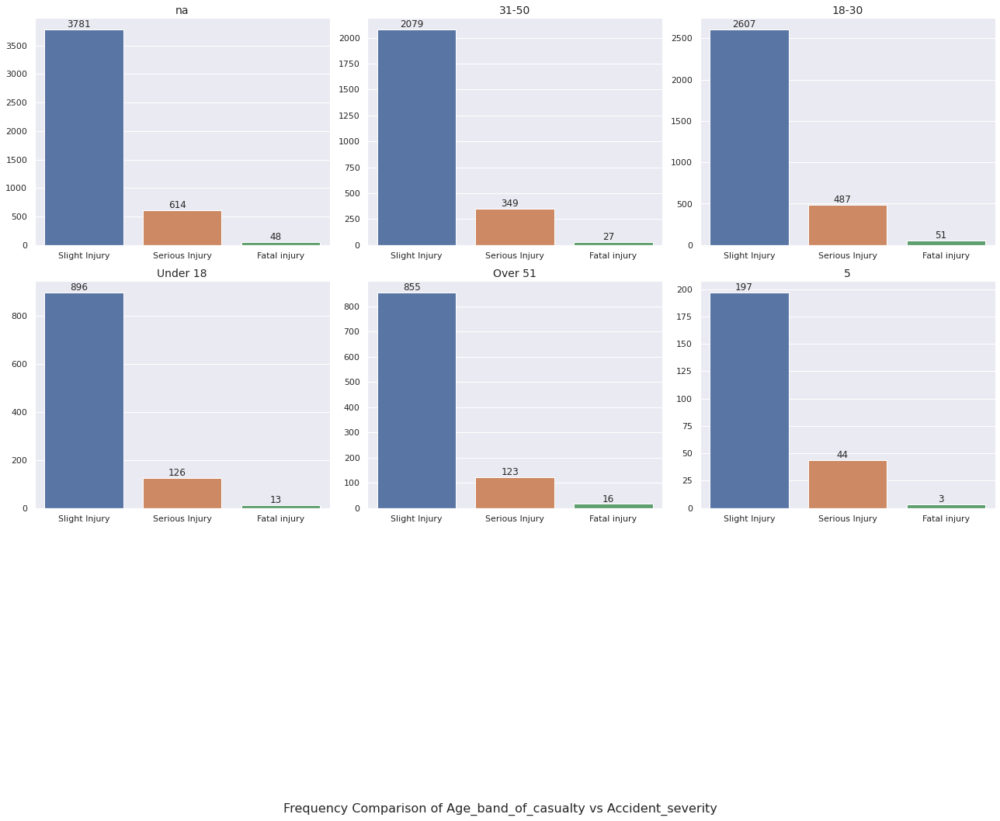




Showing Frequency Plots here for Casualty_severity:



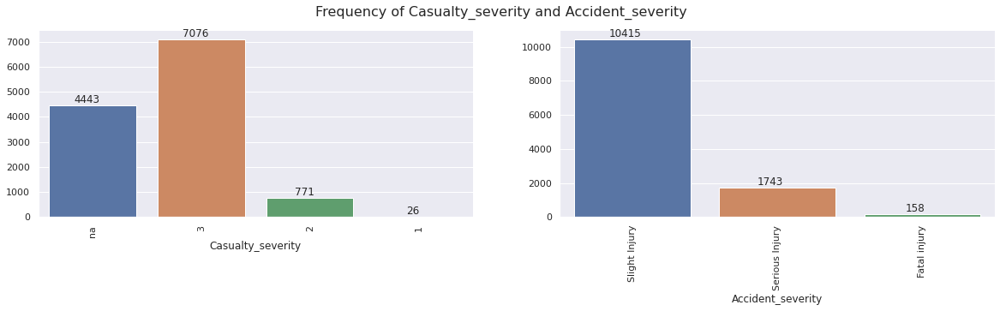


Showing Frequency Comparison of Casualty_severity vs Accident_severity



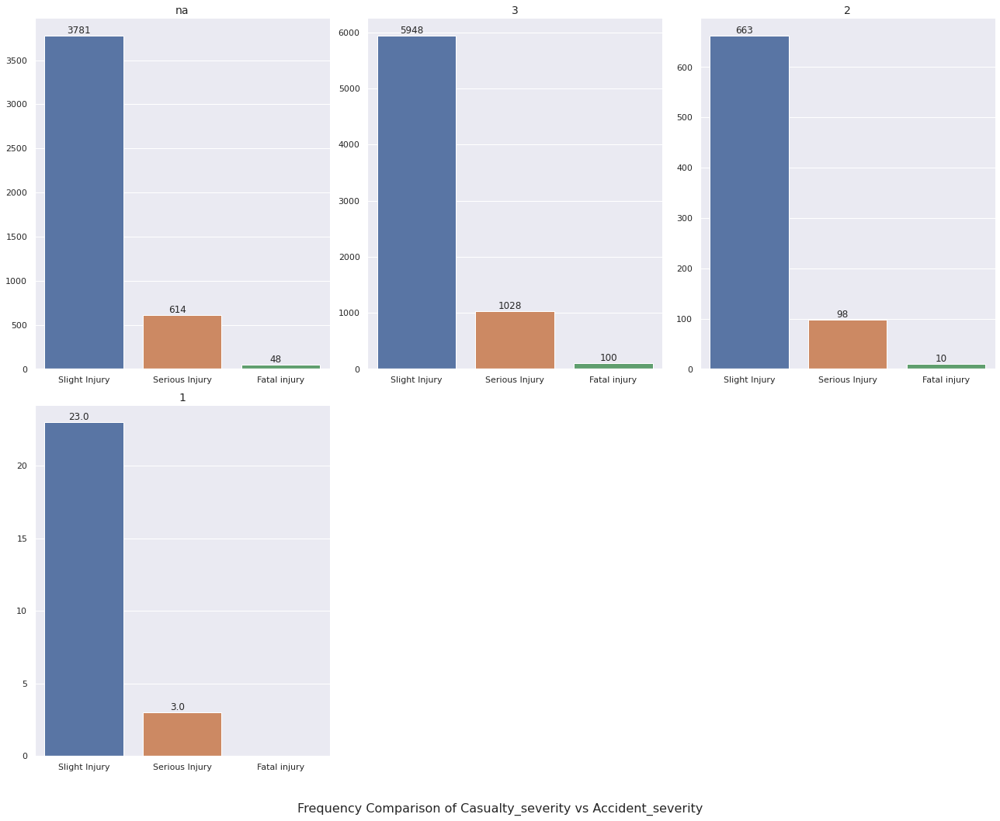




Showing Frequency Plots here for Work_of_casuality:



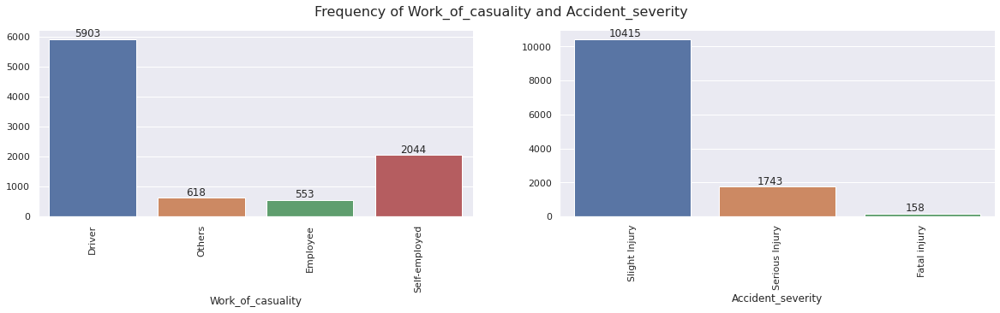


Showing Frequency Comparison of Work_of_casuality vs Accident_severity



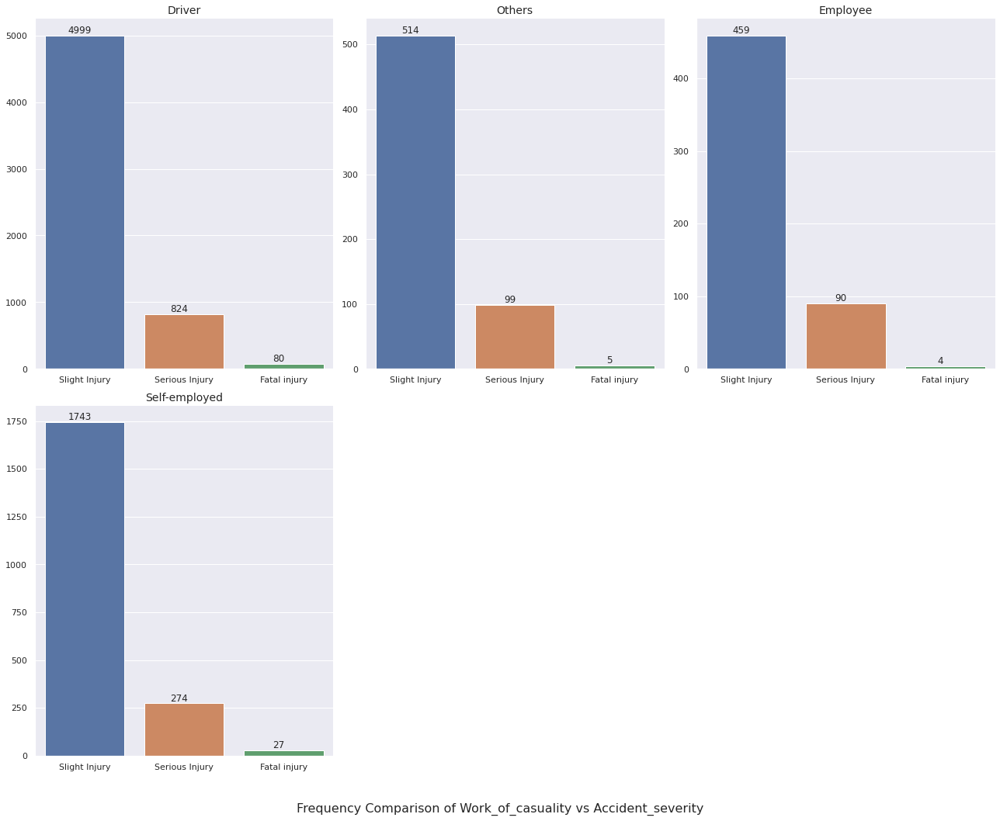




Showing Frequency Plots here for Fitness_of_casuality:



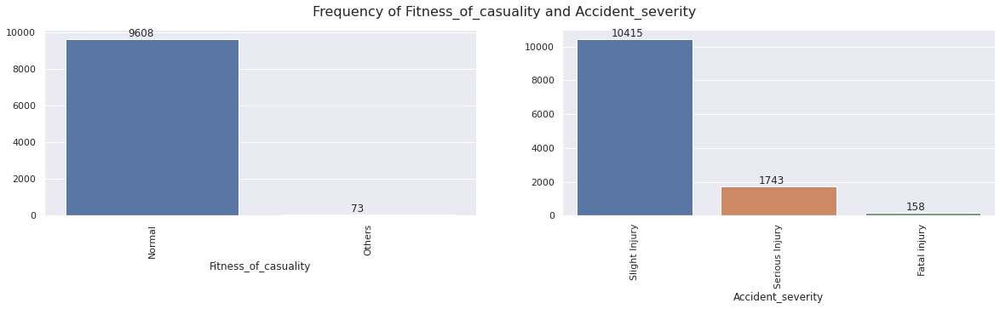


Showing Frequency Comparison of Fitness_of_casuality vs Accident_severity



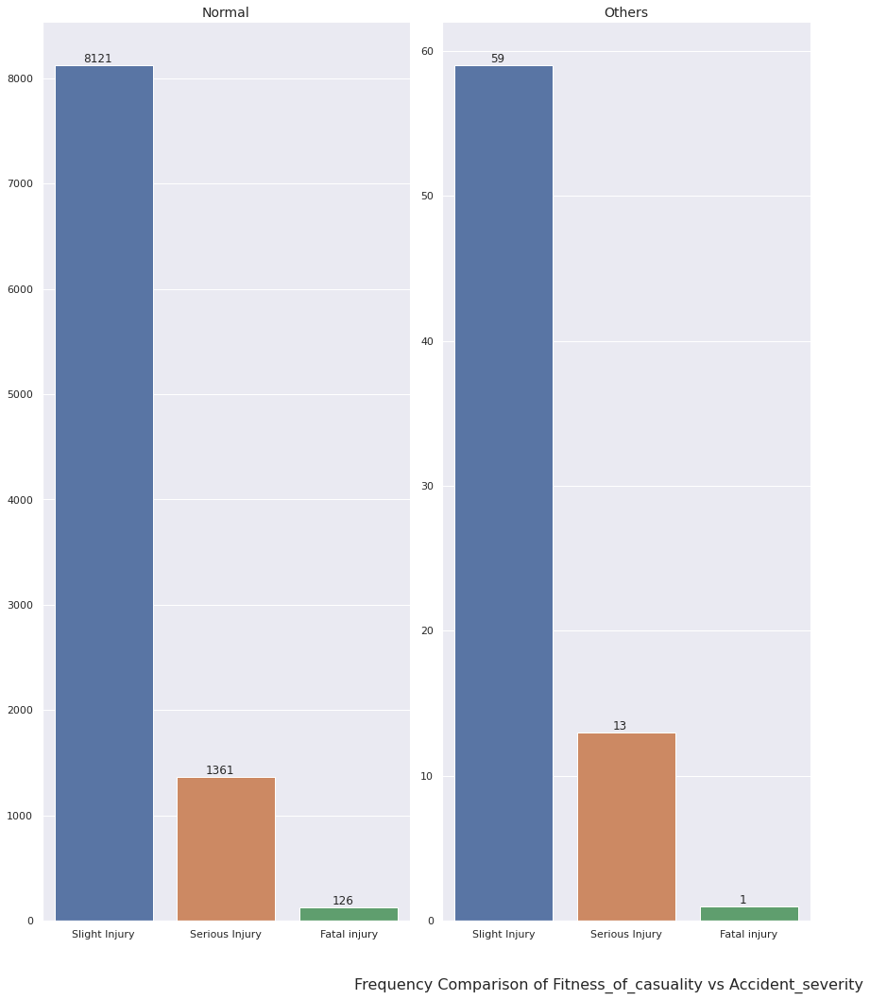




Showing Frequency Plots here for Pedestrian_movement:



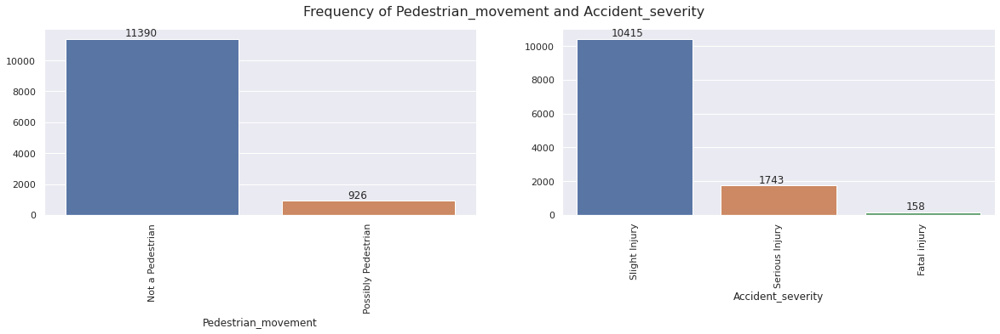


Showing Frequency Comparison of Pedestrian_movement vs Accident_severity



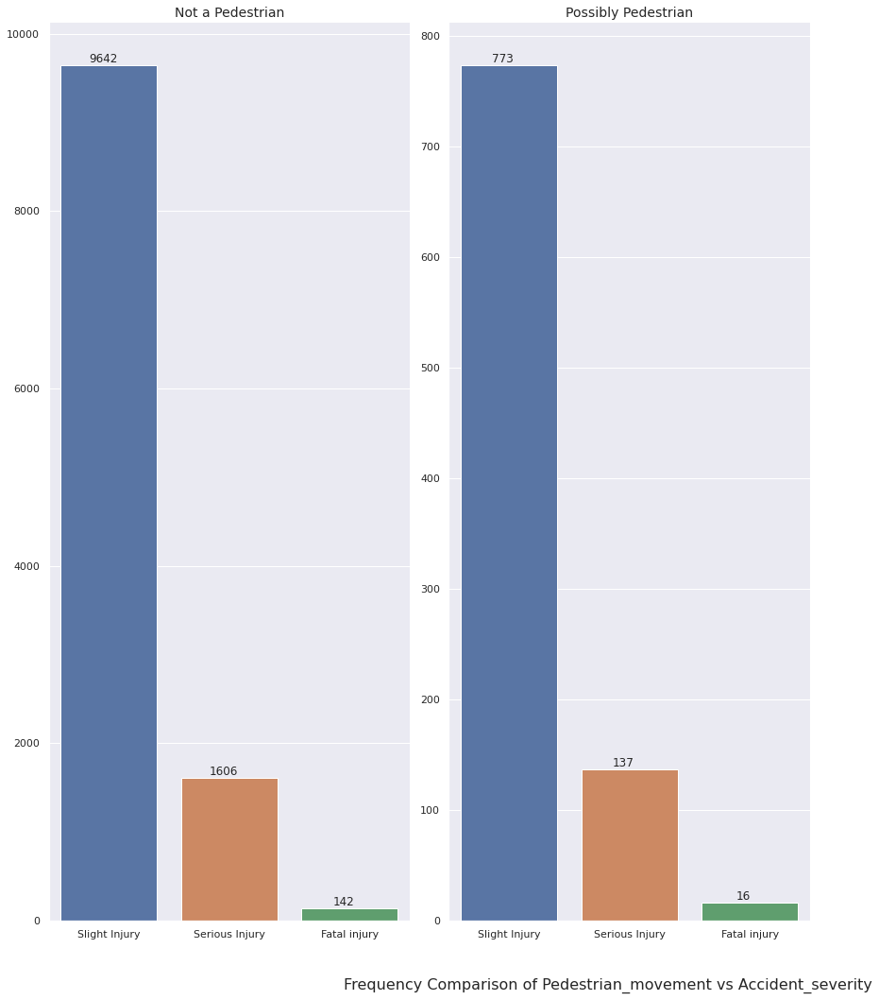




Showing Frequency Plots here for Cause_of_accident:



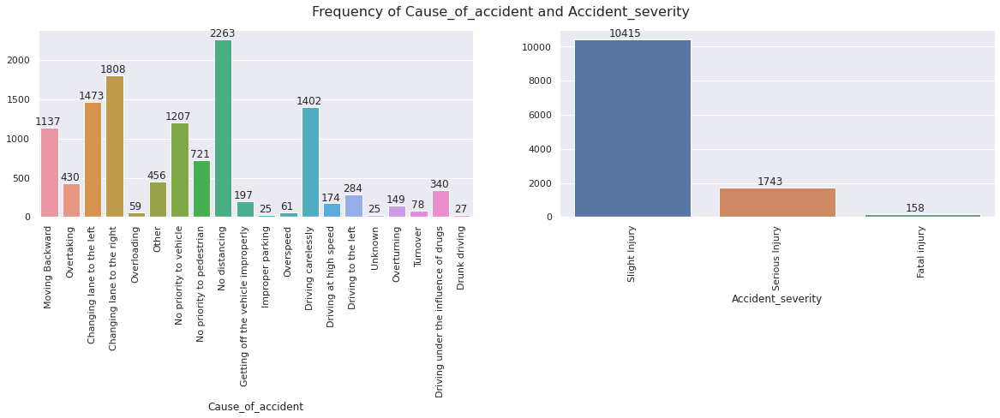


Showing Frequency Comparison of Cause_of_accident vs Accident_severity



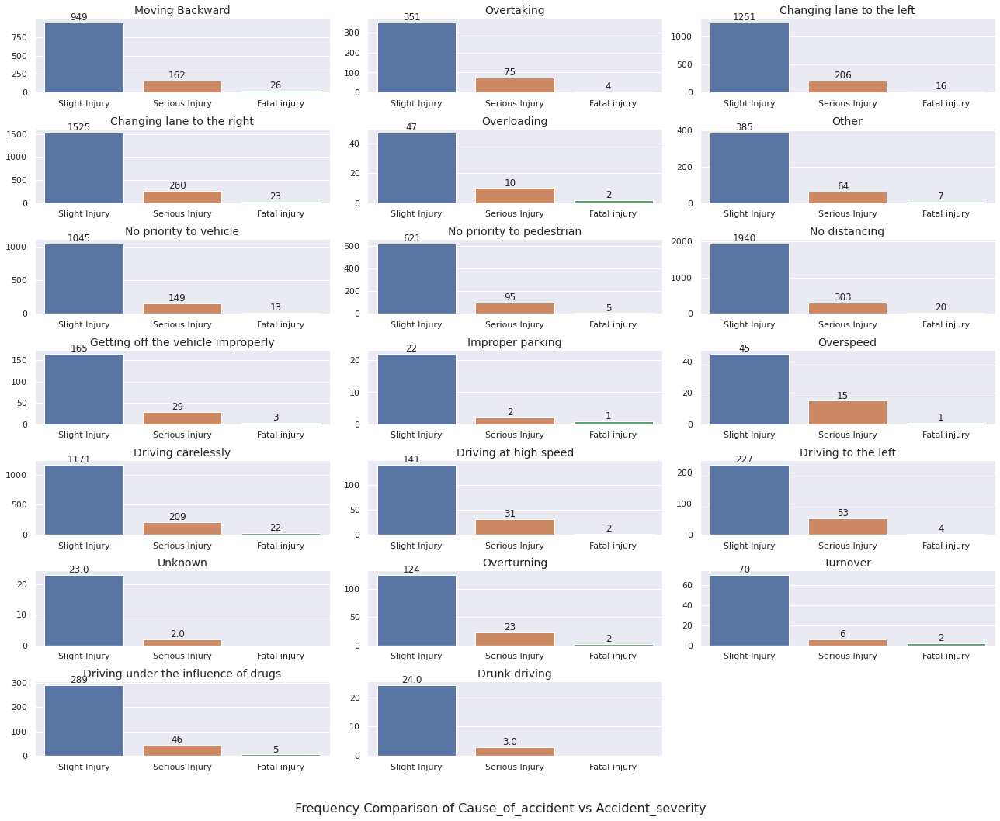




Showing Frequency Plots here for Accident_severity:



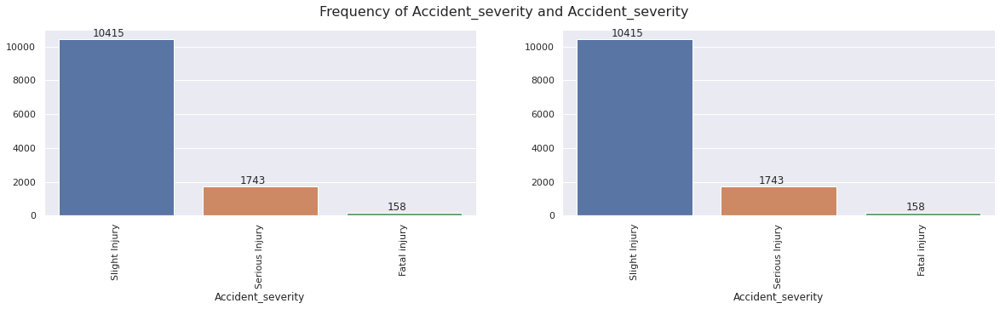


Showing Frequency Comparison of Accident_severity vs Accident_severity



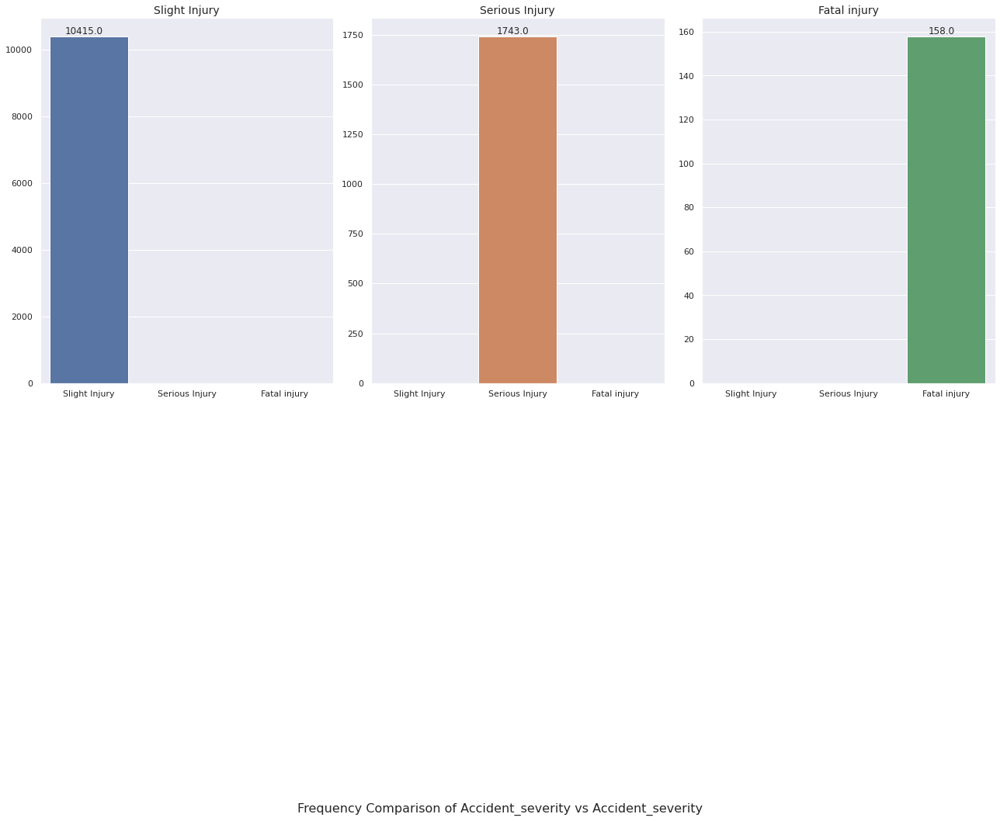

In [ ]:
for col in df_uniques.columns:
    column_barplot(df, col, "Accident_severity")

#### Looking at time column and modification

In [ ]:
# deleting the Time column as it is not required anymore, Inserting Time_of_Day column as first column
df = modify_time_column(df)

In [ ]:
df.Time_of_day.unique()

array(['Afternoon', 'Night', 'Evening', 'Morning'], dtype=object)

Showing Frequency Plots here for Time_of_day:



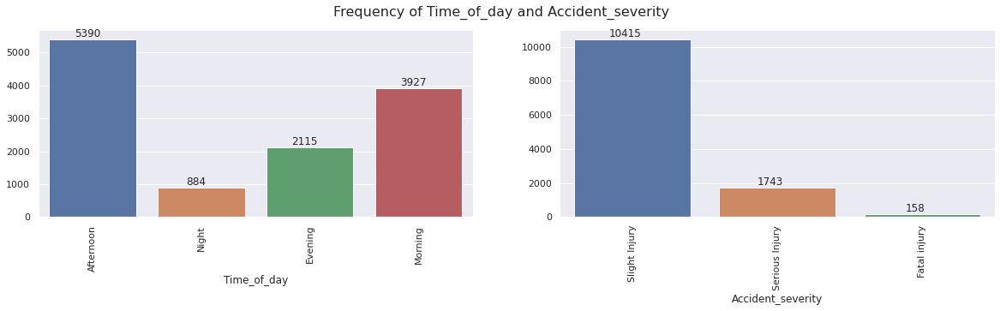


Showing Frequency Comparison of Time_of_day vs Accident_severity



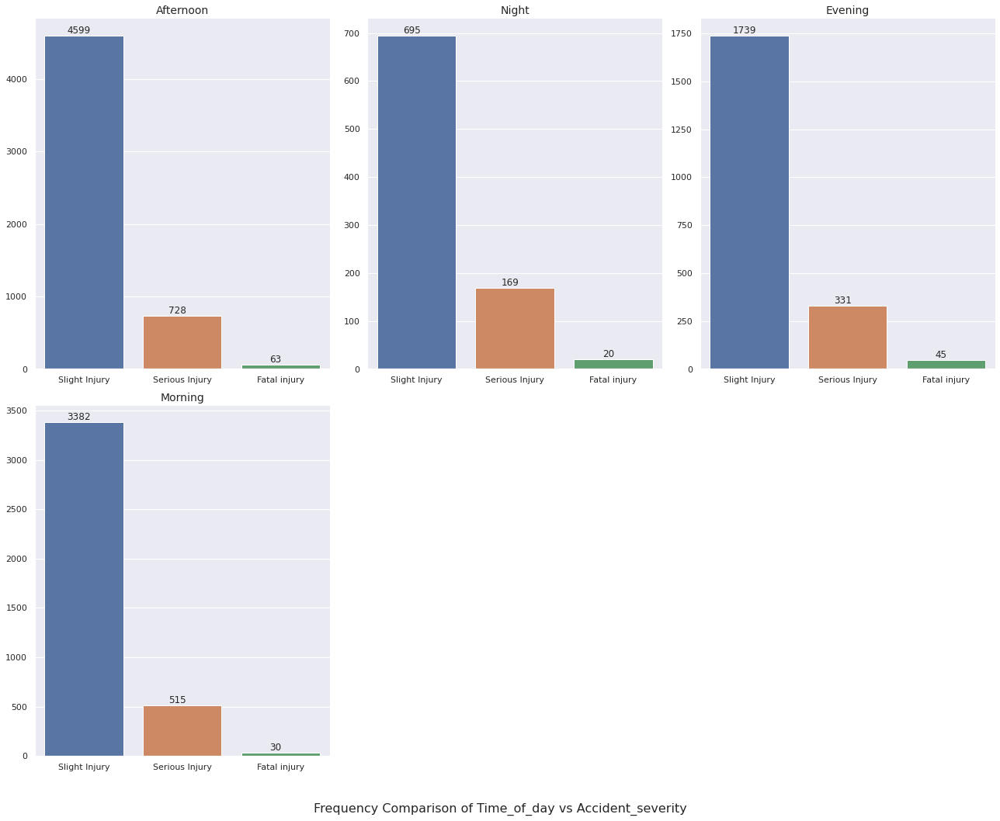

In [ ]:
column_barplot(df, "Time_of_day", "Accident_severity")

* Looking at the plots, we can roughly say that this categorisation might help to predict. We can do further split in next stage if required.

In [ ]:
df.head()

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon,Monday,18-30,Male,Others,Employee,1-2yr,Automobile,Owner,Above 10yr,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Moving Backward,Slight Injury
1,Afternoon,Monday,31-50,Male,Junior high school,Employee,Above 10yr,Public (> 45 seats),Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury
2,Afternoon,Monday,18-30,Male,Junior high school,Employee,1-2yr,Lorry (41?100Q),Owner,NaN,...,Going straight,Driver or rider,Male,31-50,3,Driver,NaN,Not a Pedestrian,Changing lane to the left,Serious Injury
3,Night,Sunday,18-30,Male,Junior high school,Employee,5-10yr,Public (> 45 seats),Others,NaN,...,Going straight,Pedestrian,Female,18-30,3,Driver,Normal,Not a Pedestrian,Changing lane to the right,Slight Injury
4,Night,Sunday,18-30,Male,Junior high school,Employee,2-5yr,NaN,Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury


### Preprocessing of the data

* Finally we have the whole data with all of the column with categories. So the data is now truely categorical. We need to predict the Acccident_severity of a record. This column is extremely bias containing very few fatal injury. The challenge can be to predict that more precisely. For now we will look into baseline model with minimal pre-processing of the data.
* We need to handle undefined values(?) properly now. 
* We need to convert categories into integers. We can do one-hot-encoding. But I will choose to use ... here.

#### Train Test split

* We will do train test split as different test data is not available for this project. We will set seed to 20 and we will take out 20% of main data to create test data.

In [ ]:
# Setting the target column
target_col = "Accident_severity"
# Spliting target column
X, y = predictor_target_split(df, target_col)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=20)

In [ ]:
# Joining X, y for furthers inspection eases
df = pd.concat([X_train, y_train], axis=1)
df_test = pd.concat([X_test, y_test], axis=1)

#### Handling missing values
* Note that there are some categories which implies that the value is missed like "unknown" or "na". We need to examine those properly before imputation of missing values.

In [ ]:
na_count_table(df)

,column,na_count,ratio (in persentage)
4,Educational_level,617,6.26
5,Vehicle_driver_relation,478,4.85
6,Driving_experience,691,7.01
7,Type_of_vehicle,760,7.71
8,Owner_of_vehicle,387,3.93
9,Service_year_of_vehicle,3067,31.13
10,Defect_of_vehicle,3535,35.88
11,Area_accident_occured,192,1.95
12,Lanes_or_Medians,294,2.98
13,Road_allignment,116,1.18


* Note that column Service_year_of_vehicle, Defect_of_vehicle contains, Work_of_casuality, Fitness_of_casuality more than 20% data missing.

Showing Frequency Plots here for Service_year_of_vehicle:



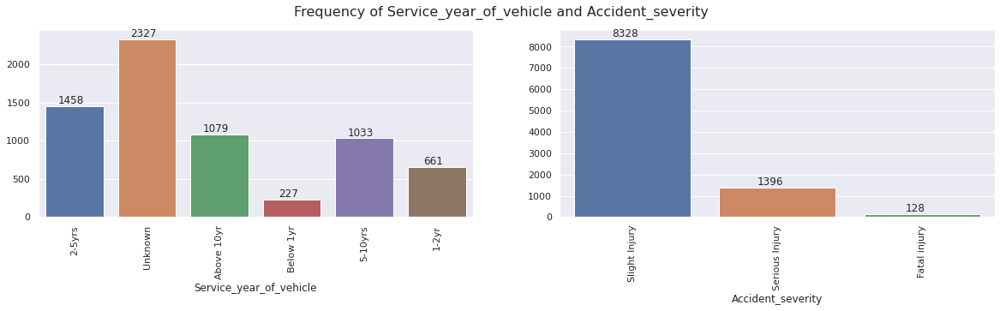


Showing Frequency Comparison of Service_year_of_vehicle vs Accident_severity



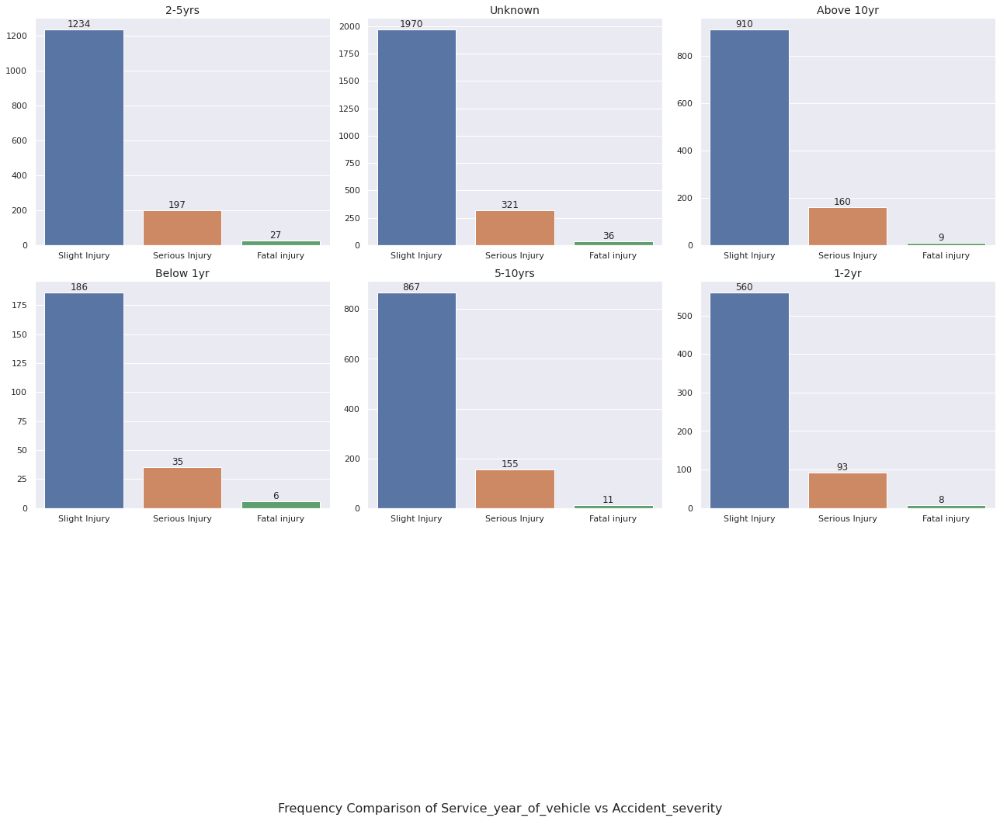

In [ ]:
# Checking column Service_year_of_vehicle
column_barplot(df, "Service_year_of_vehicle", target_col)

* It's looks like column Service_year_of_vehicle will not effect the analysis that much. In stage 1 we are removing the column for simplicity.

In [ ]:
df.drop("Service_year_of_vehicle", axis=1, inplace=True)

Showing Frequency Plots here for Defect_of_vehicle:



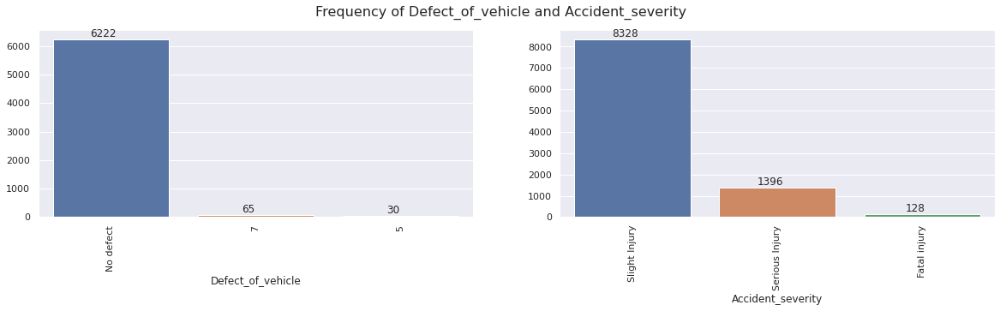


Showing Frequency Comparison of Defect_of_vehicle vs Accident_severity



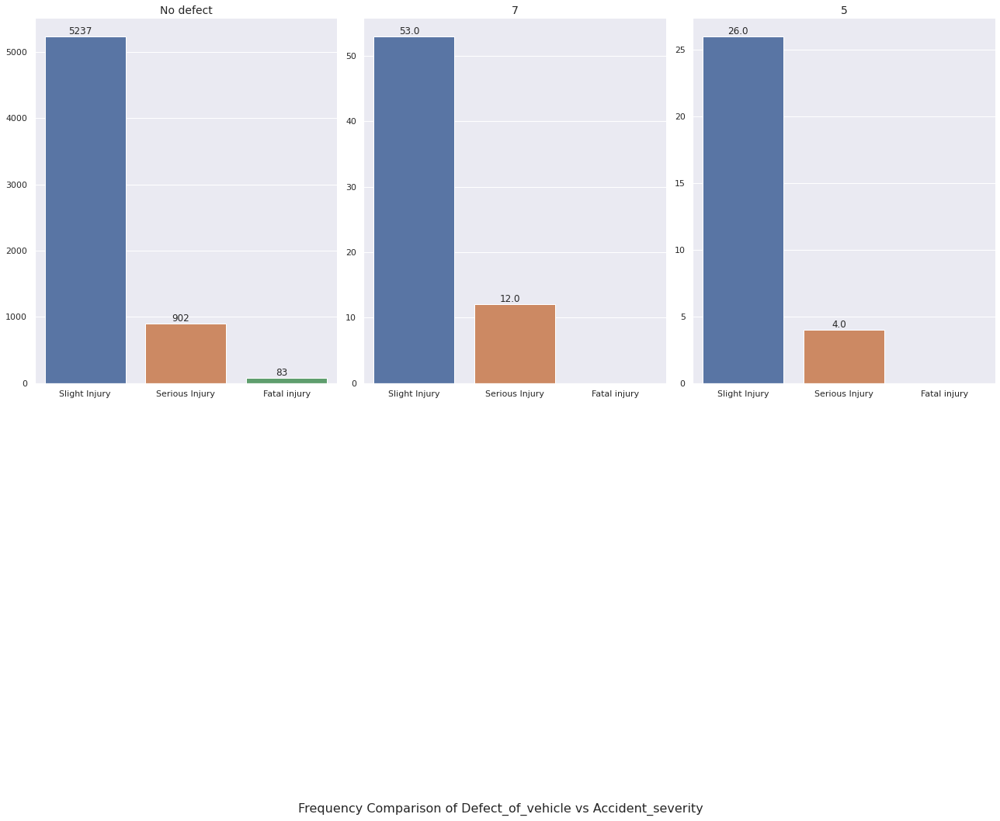

In [ ]:
# Checking column Defect_of_vehicle
column_barplot(df, "Defect_of_vehicle", target_col)

* Note that most of the values of this column is either "Unknown" or NaN. We can simply delete this column since the two insignificant columns do not even contains any fatal injury records for target column.

In [ ]:
df.drop("Defect_of_vehicle", axis=1, inplace=True)

Showing Frequency Plots here for Fitness_of_casuality:



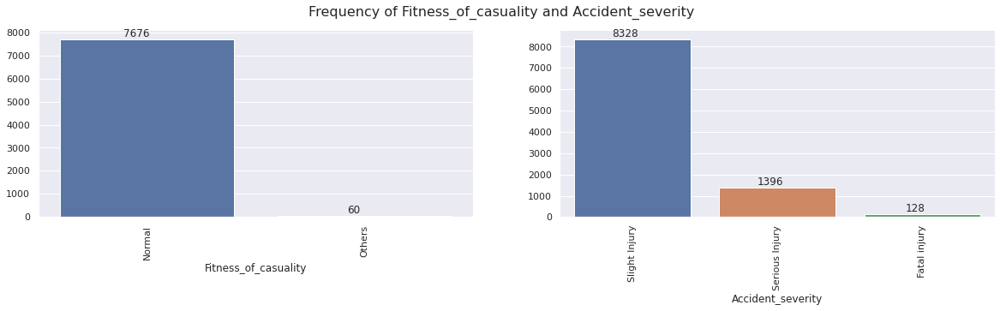


Showing Frequency Comparison of Fitness_of_casuality vs Accident_severity



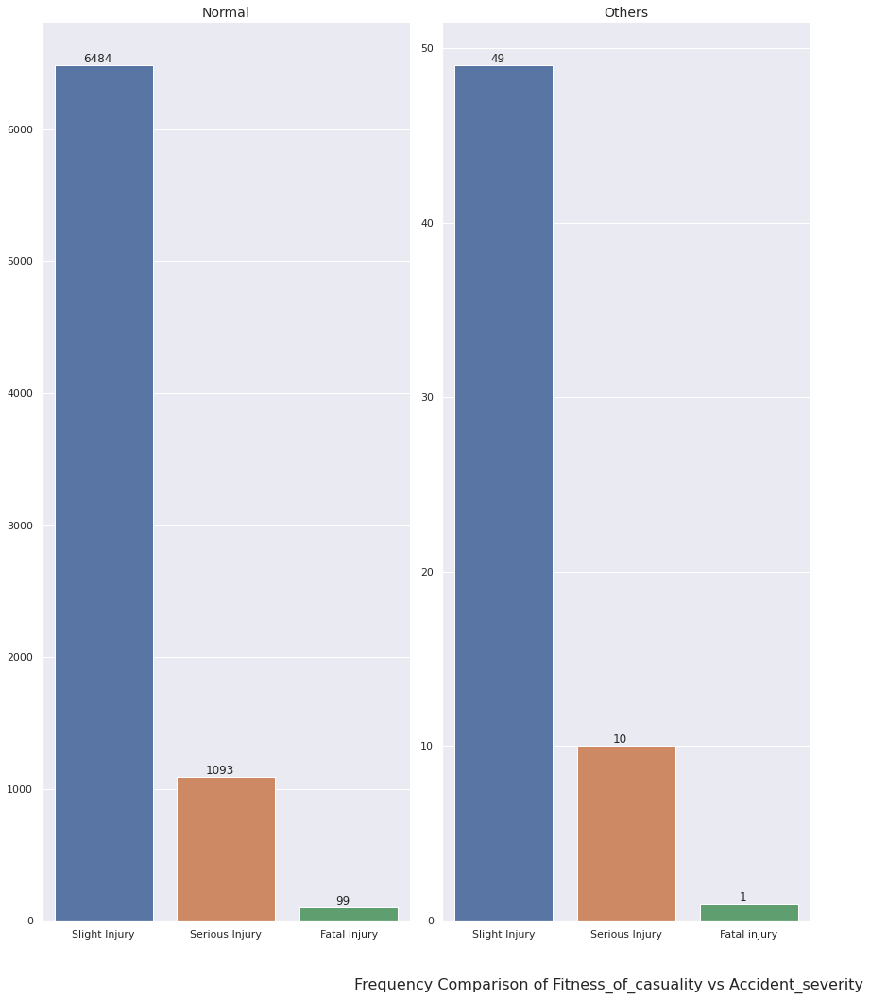

In [ ]:
# Checking column Fitness_of_casuality
column_barplot(df, "Fitness_of_casuality", target_col)

* Similar to column Service_year_of_vehicle, we can drop this column too for now.

In [ ]:
df.drop("Fitness_of_casuality", axis=1, inplace=True)

Showing Frequency Plots here for Work_of_casuality:



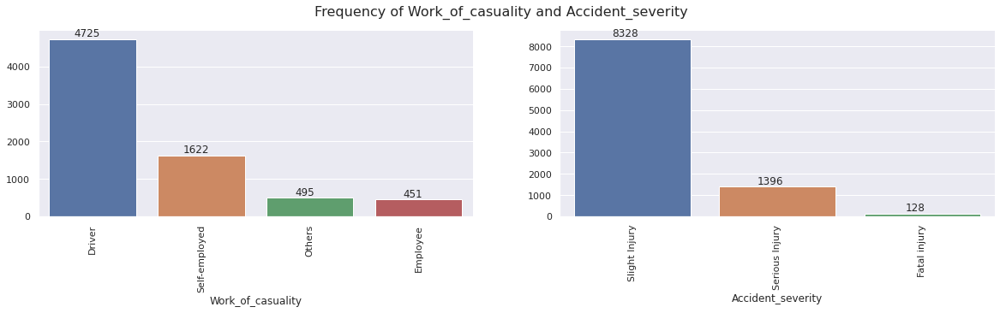


Showing Frequency Comparison of Work_of_casuality vs Accident_severity



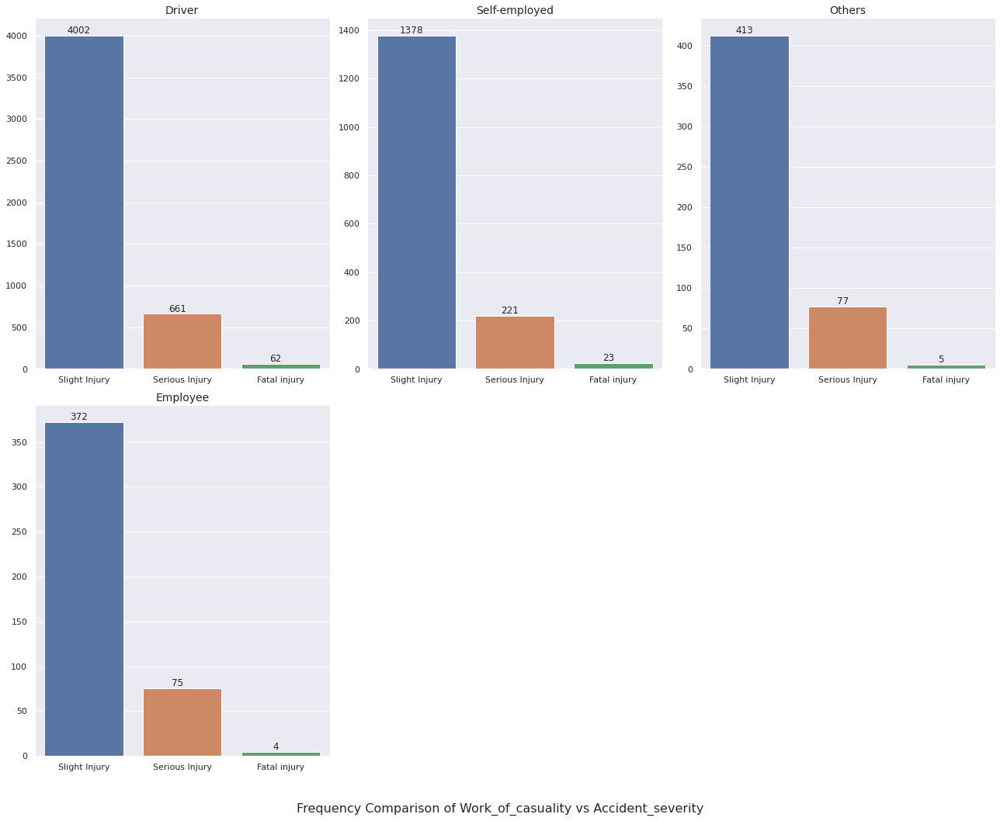

In [ ]:
# Checking column Work_of_casuality
column_barplot(df, "Work_of_casuality", target_col)

Showing Frequency Plots here for Time_of_day:



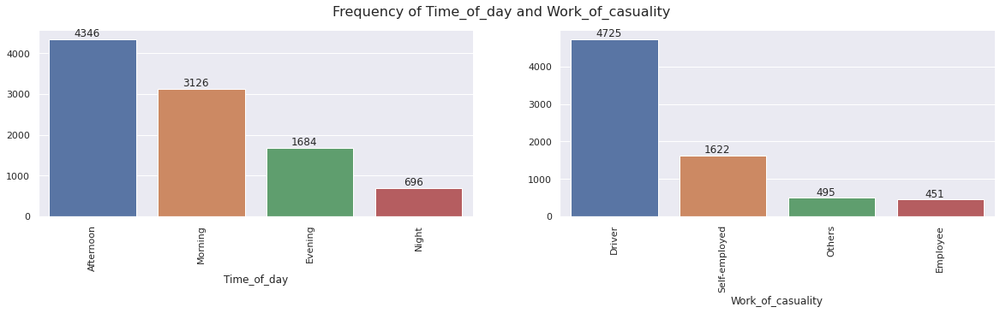


Showing Frequency Comparison of Time_of_day vs Work_of_casuality



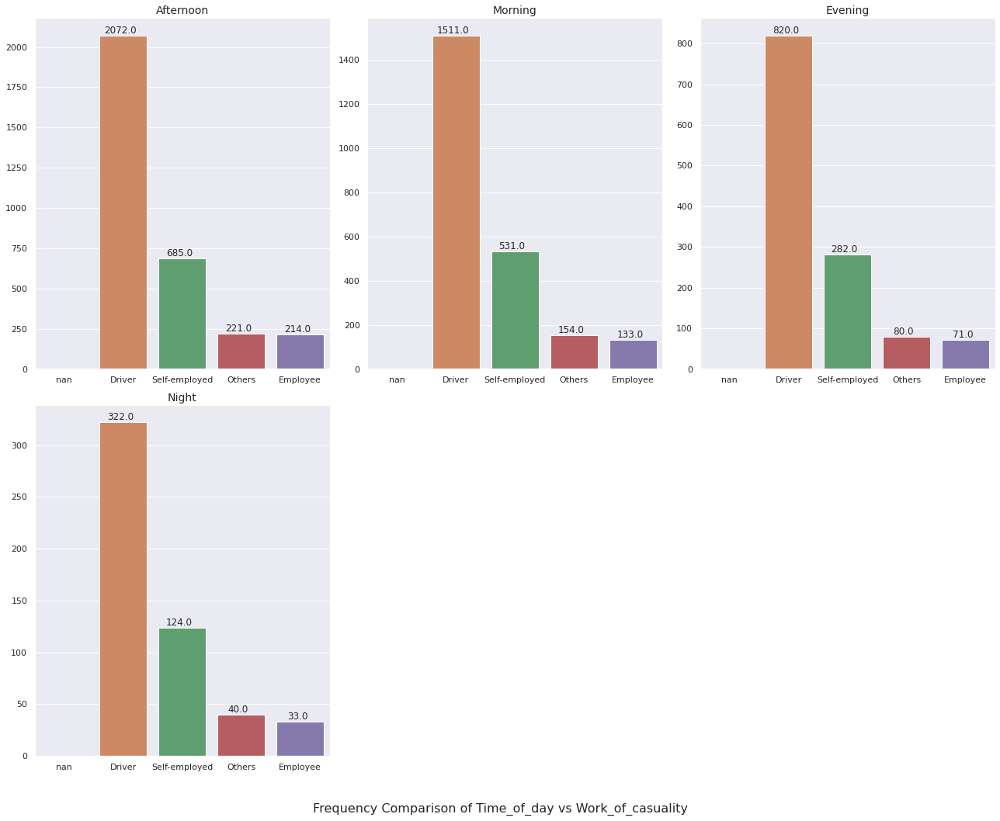




Showing Frequency Plots here for Day_of_week:



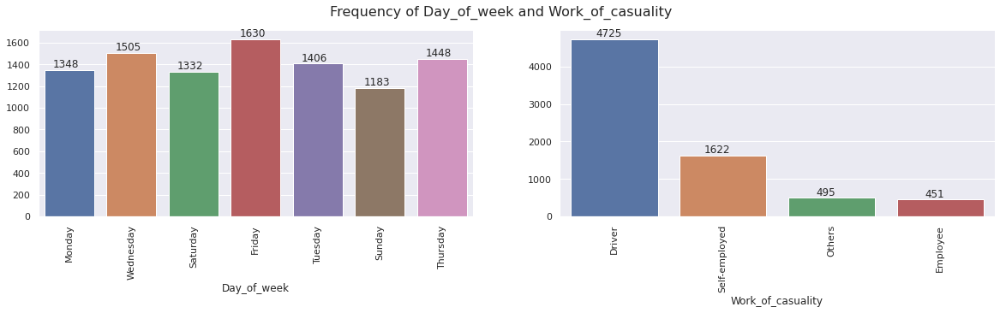


Showing Frequency Comparison of Day_of_week vs Work_of_casuality



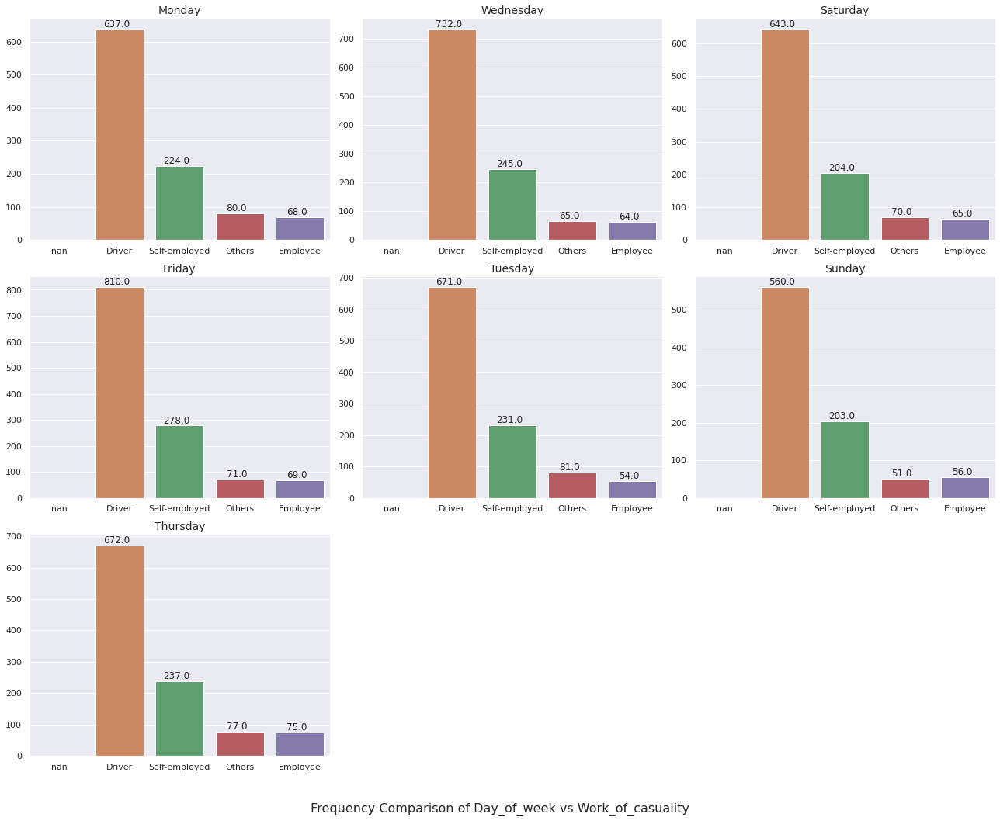




Showing Frequency Plots here for Age_band_of_driver:



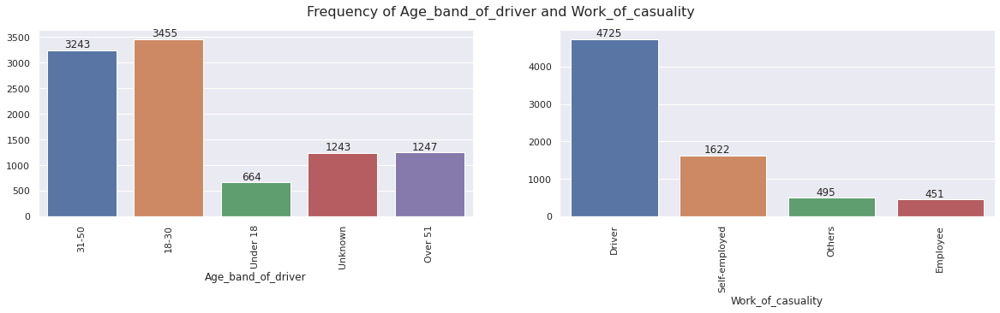


Showing Frequency Comparison of Age_band_of_driver vs Work_of_casuality



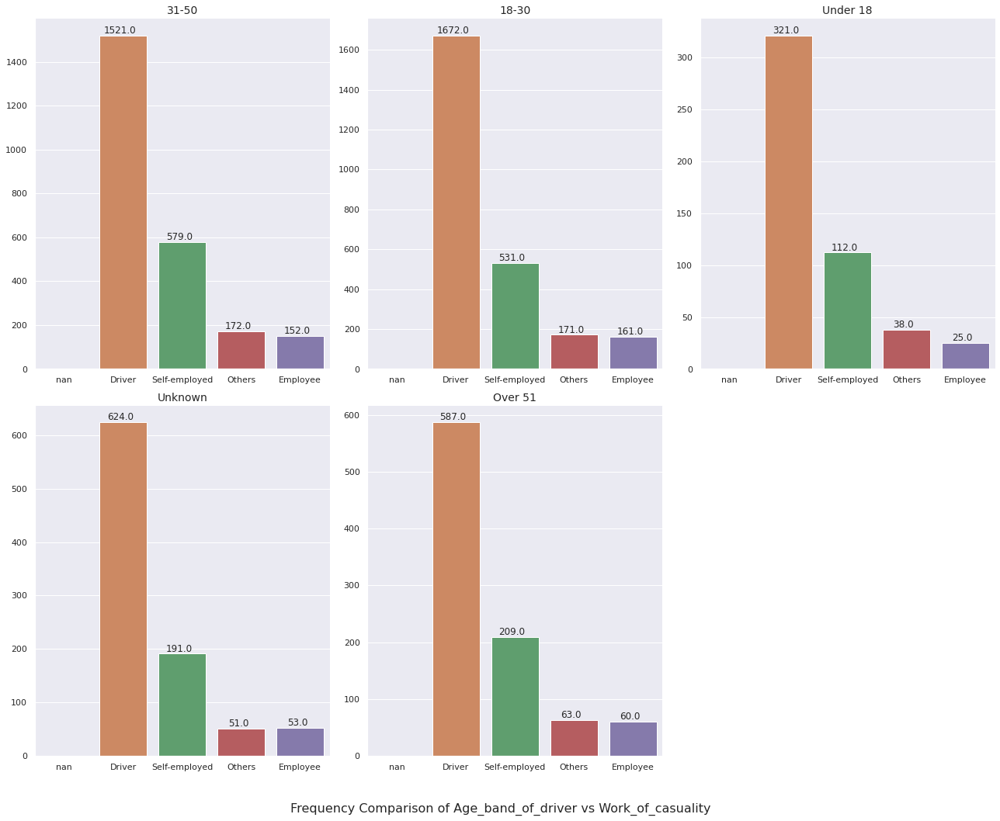




Showing Frequency Plots here for Sex_of_driver:



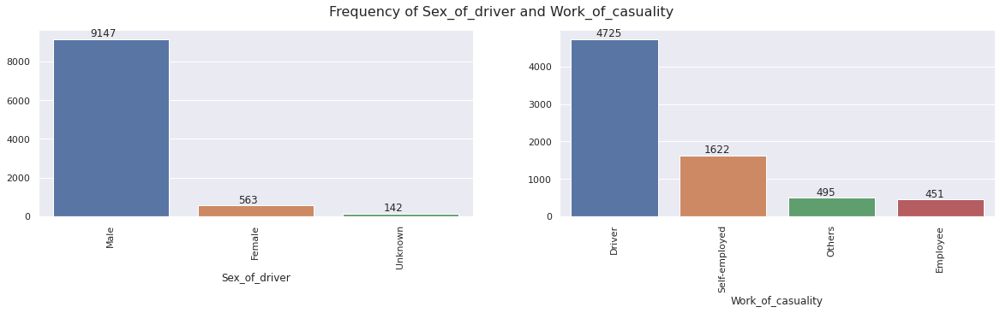


Showing Frequency Comparison of Sex_of_driver vs Work_of_casuality



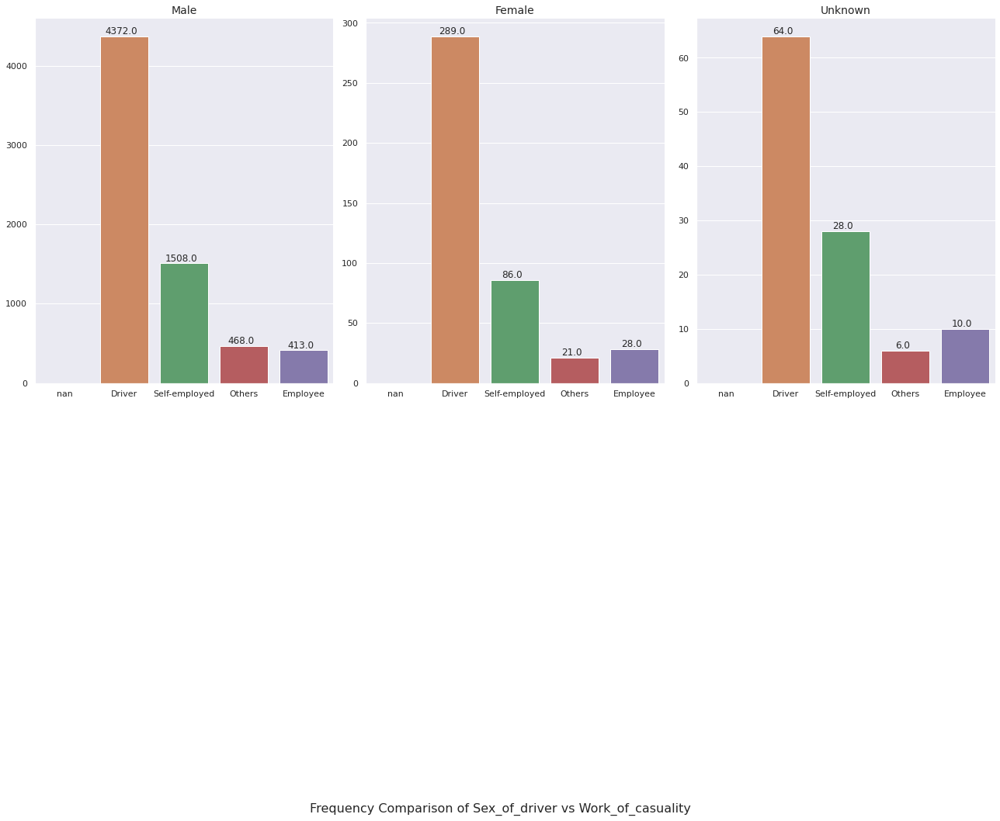




Showing Frequency Plots here for Educational_level:



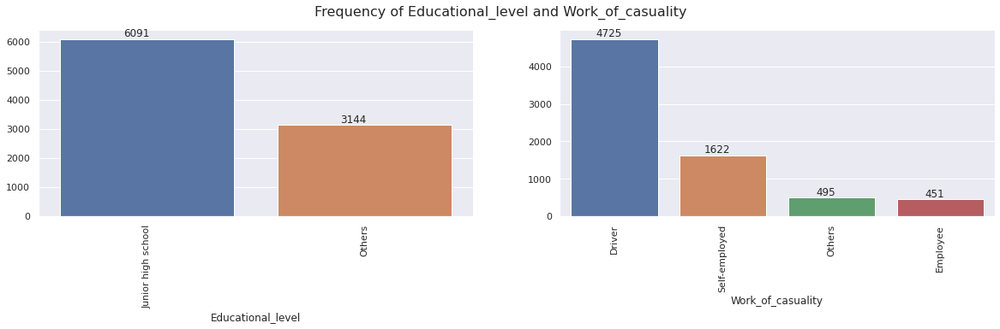


Showing Frequency Comparison of Educational_level vs Work_of_casuality



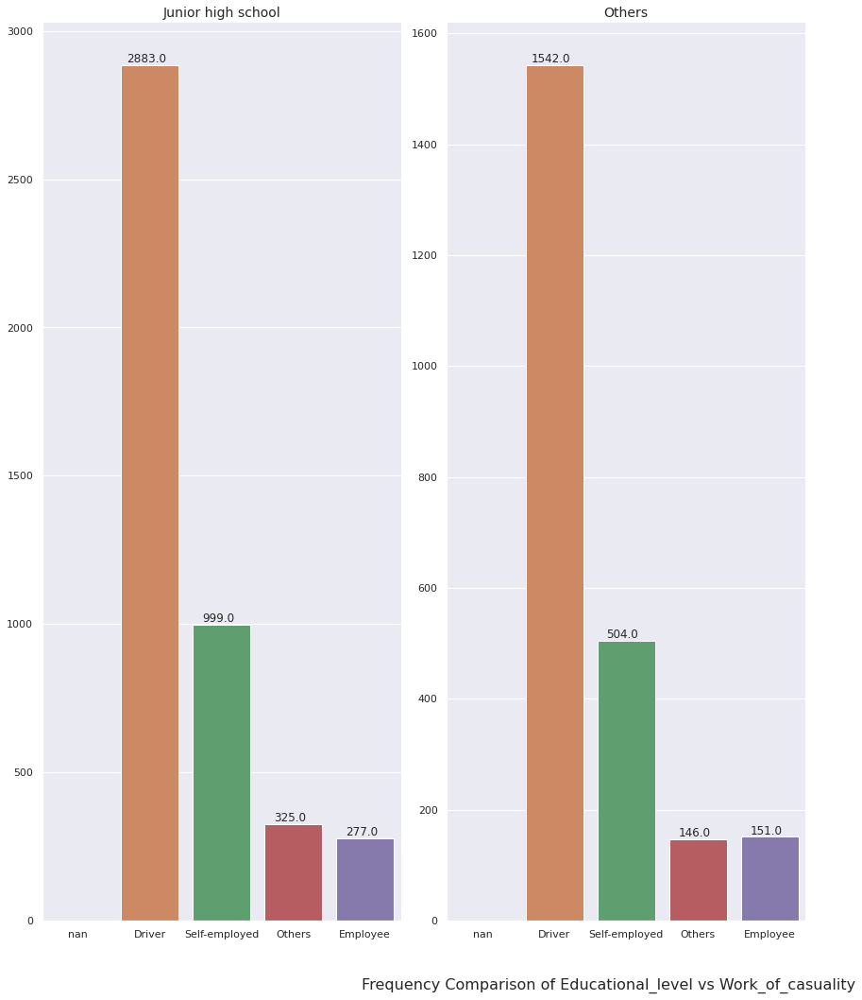




Showing Frequency Plots here for Vehicle_driver_relation:



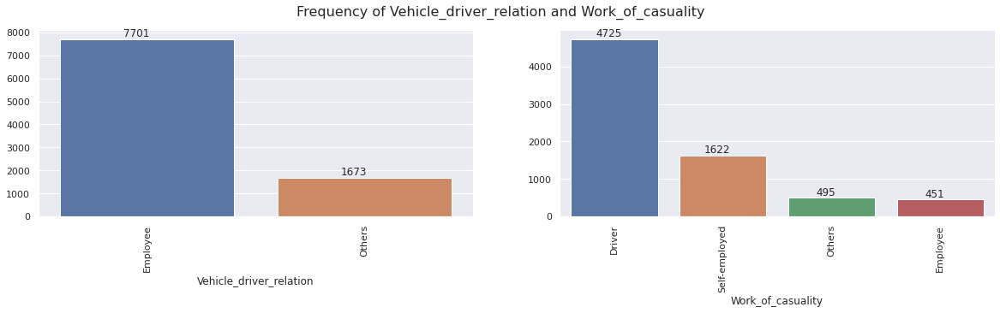


Showing Frequency Comparison of Vehicle_driver_relation vs Work_of_casuality



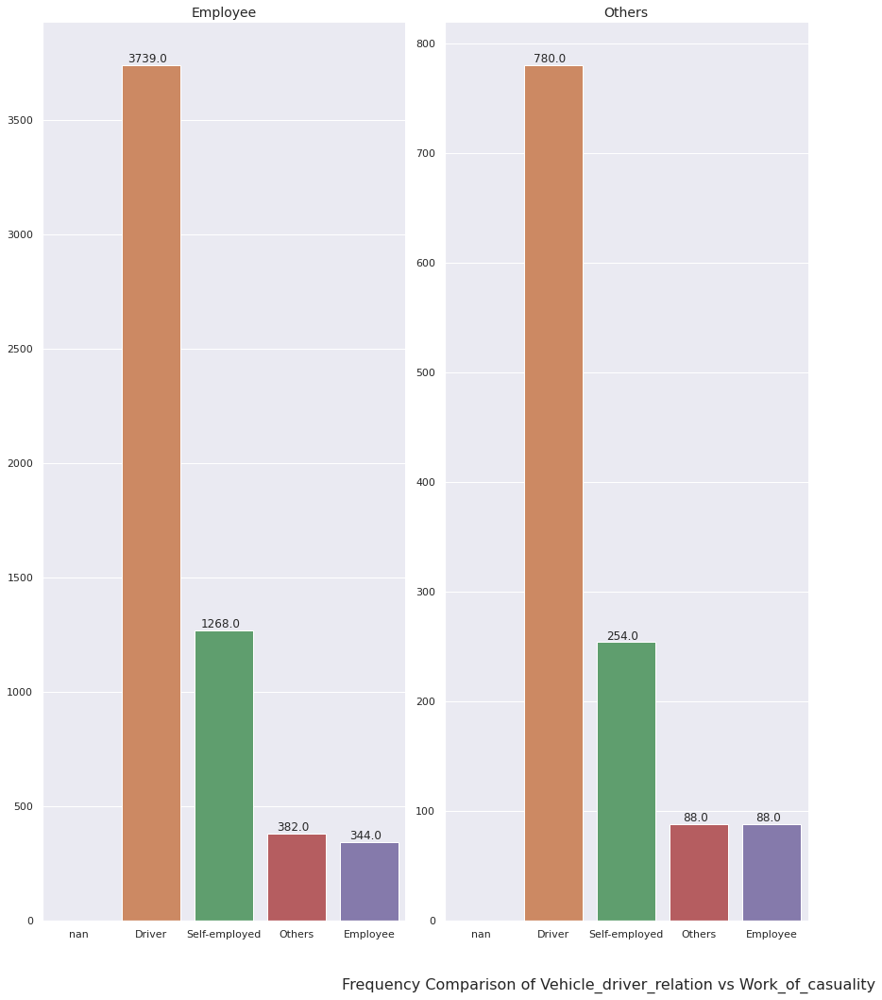




Showing Frequency Plots here for Driving_experience:



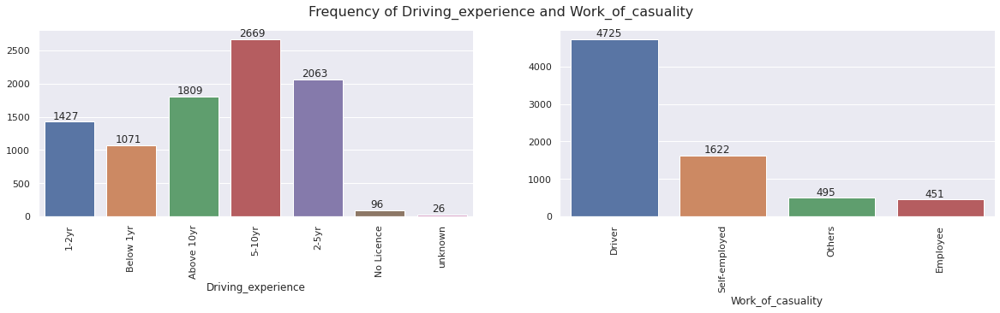


Showing Frequency Comparison of Driving_experience vs Work_of_casuality



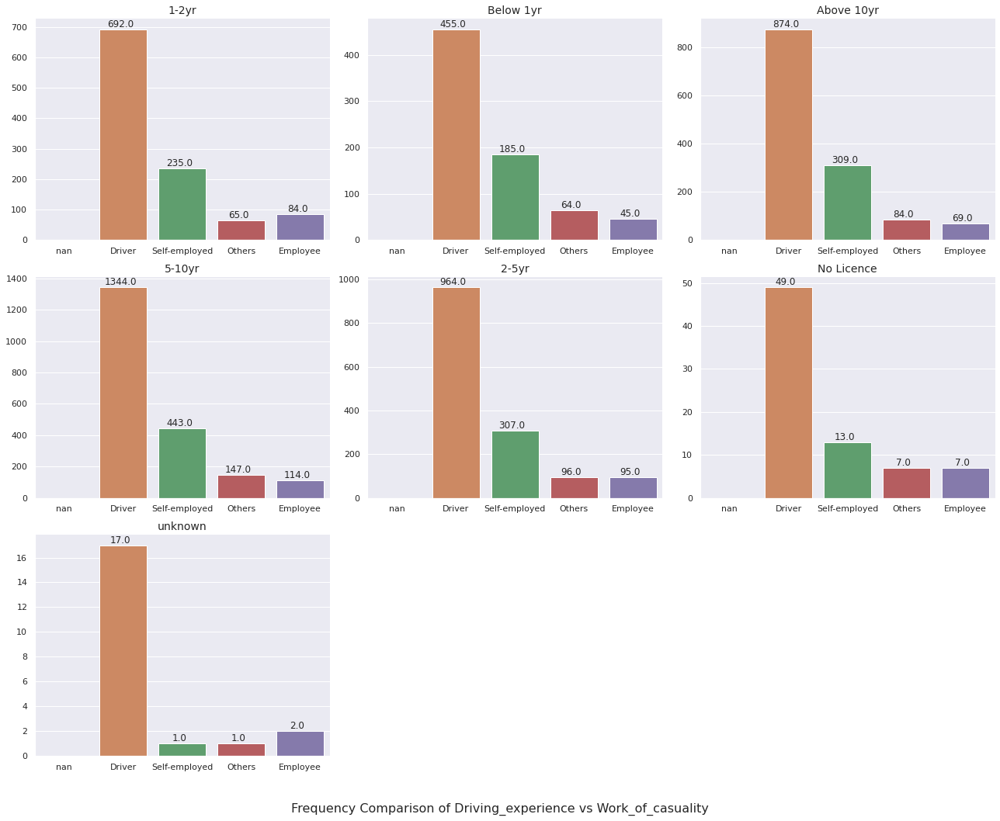




Showing Frequency Plots here for Type_of_vehicle:



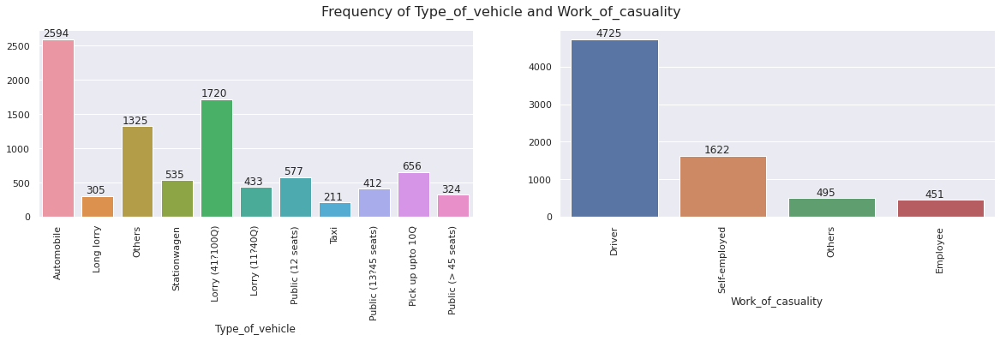


Showing Frequency Comparison of Type_of_vehicle vs Work_of_casuality



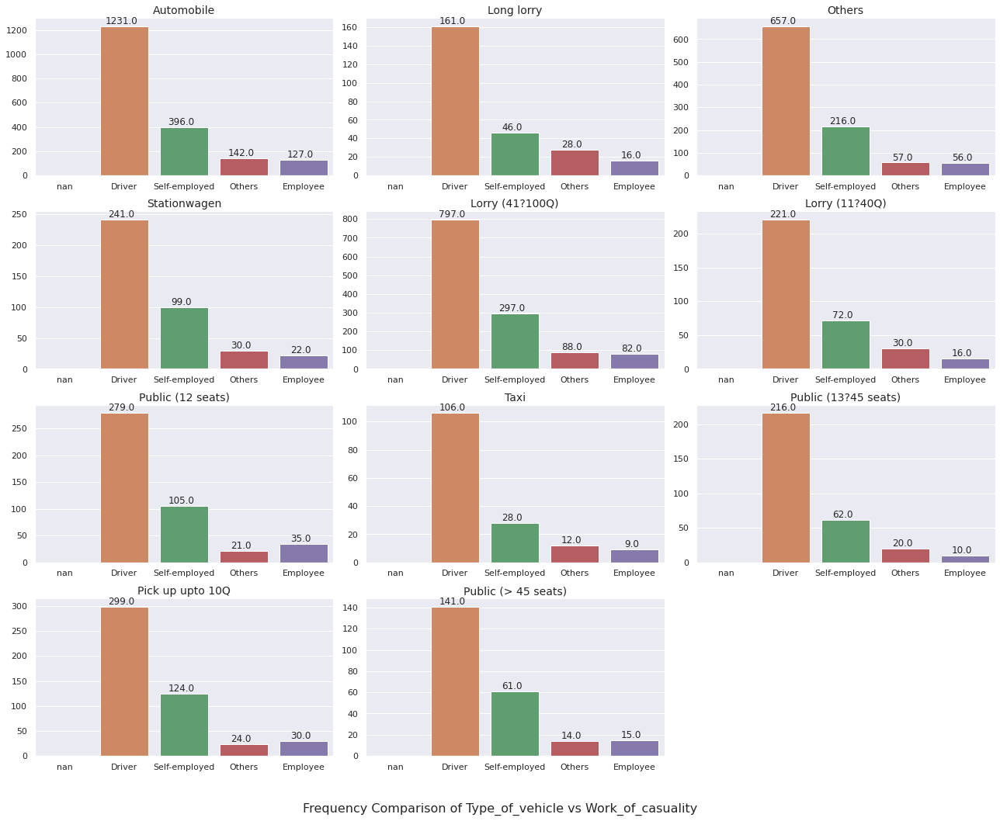




Showing Frequency Plots here for Owner_of_vehicle:



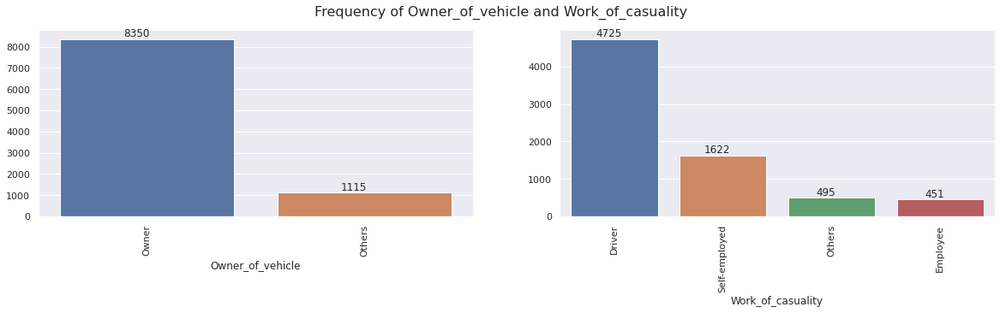


Showing Frequency Comparison of Owner_of_vehicle vs Work_of_casuality



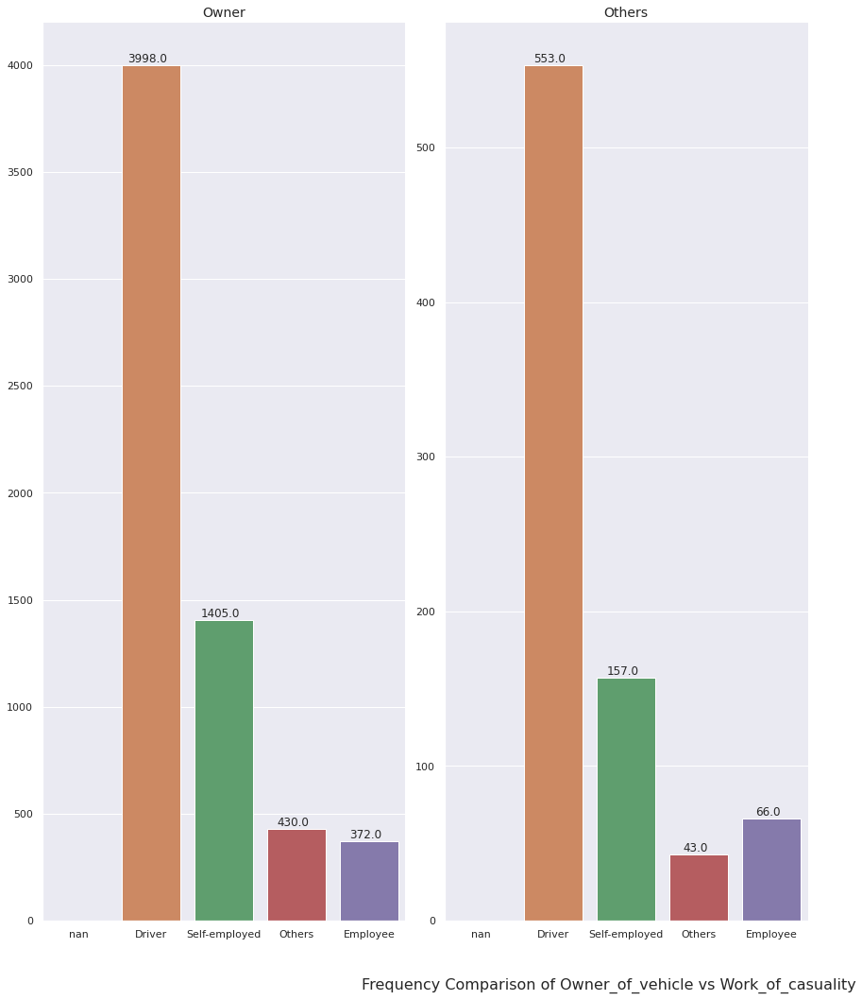




Showing Frequency Plots here for Area_accident_occured:



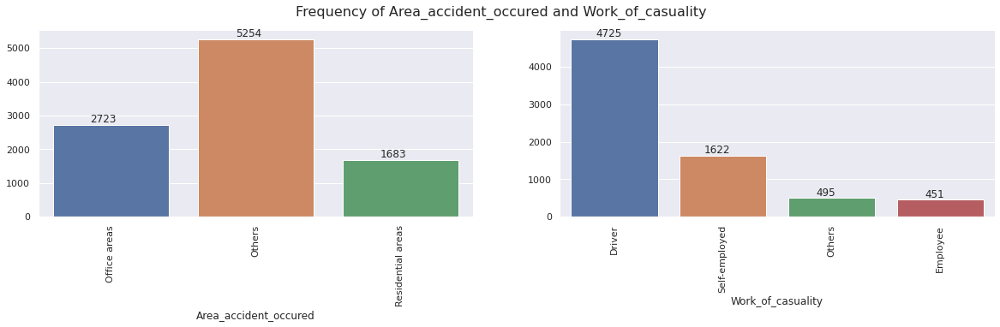


Showing Frequency Comparison of Area_accident_occured vs Work_of_casuality



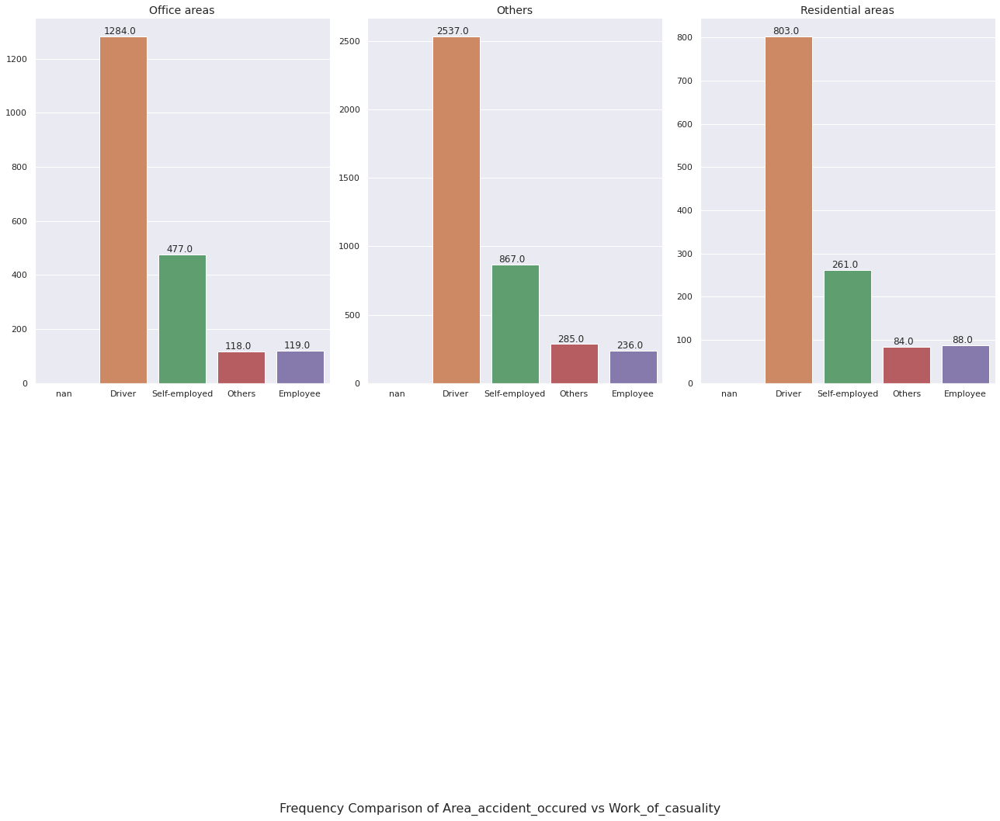




Showing Frequency Plots here for Lanes_or_Medians:



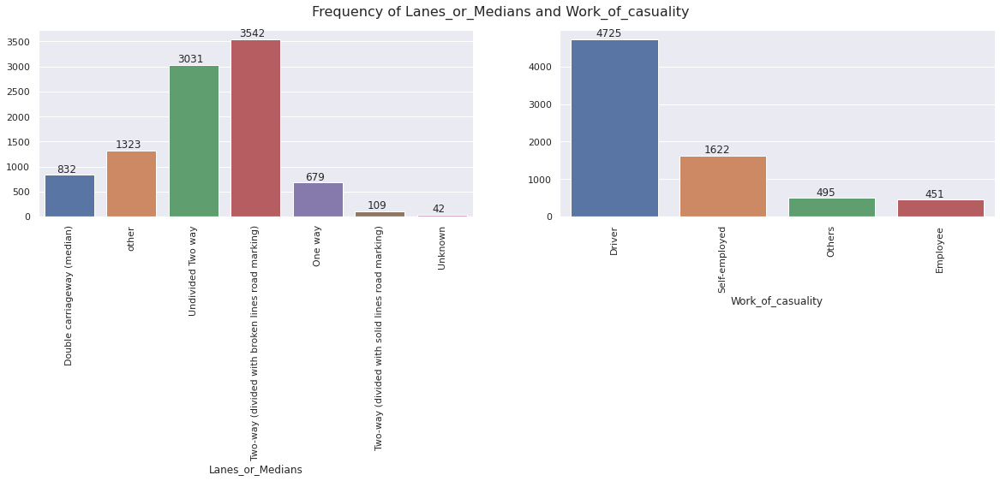


Showing Frequency Comparison of Lanes_or_Medians vs Work_of_casuality



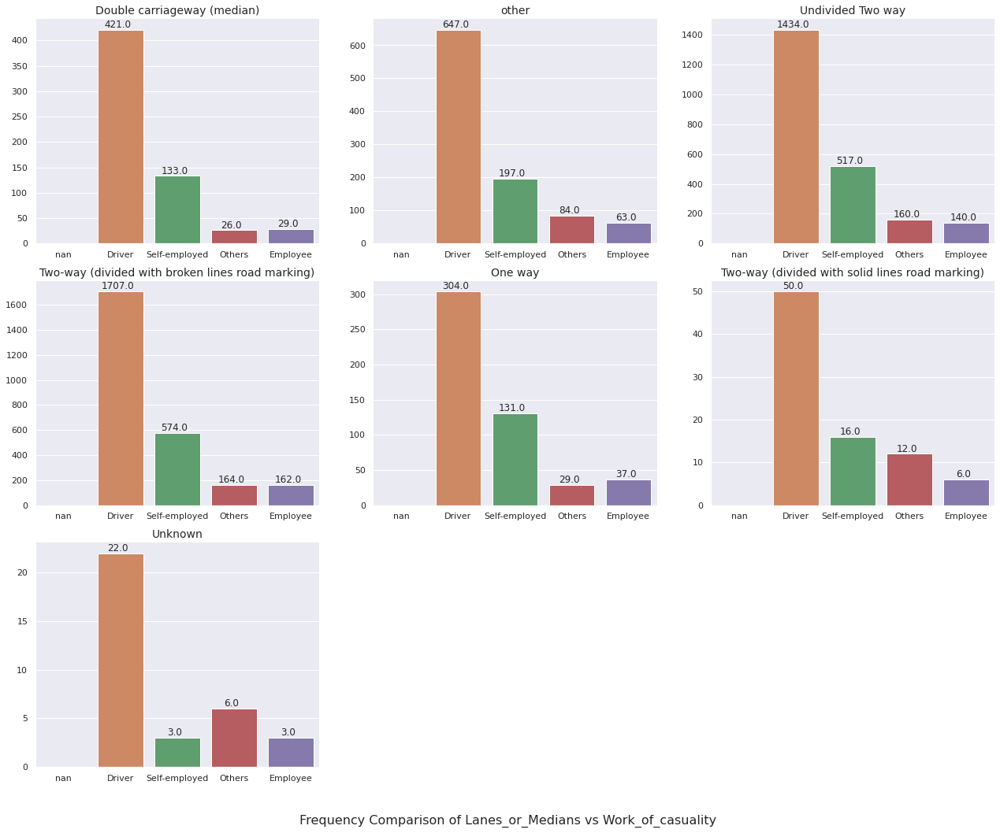




Showing Frequency Plots here for Road_allignment:



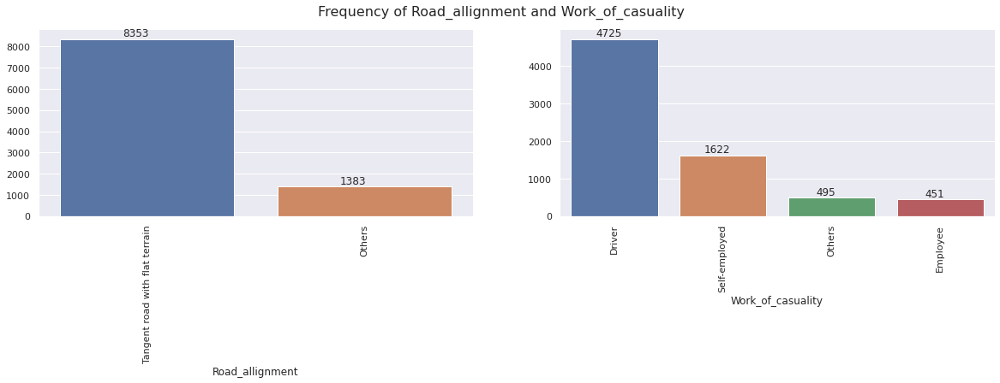


Showing Frequency Comparison of Road_allignment vs Work_of_casuality



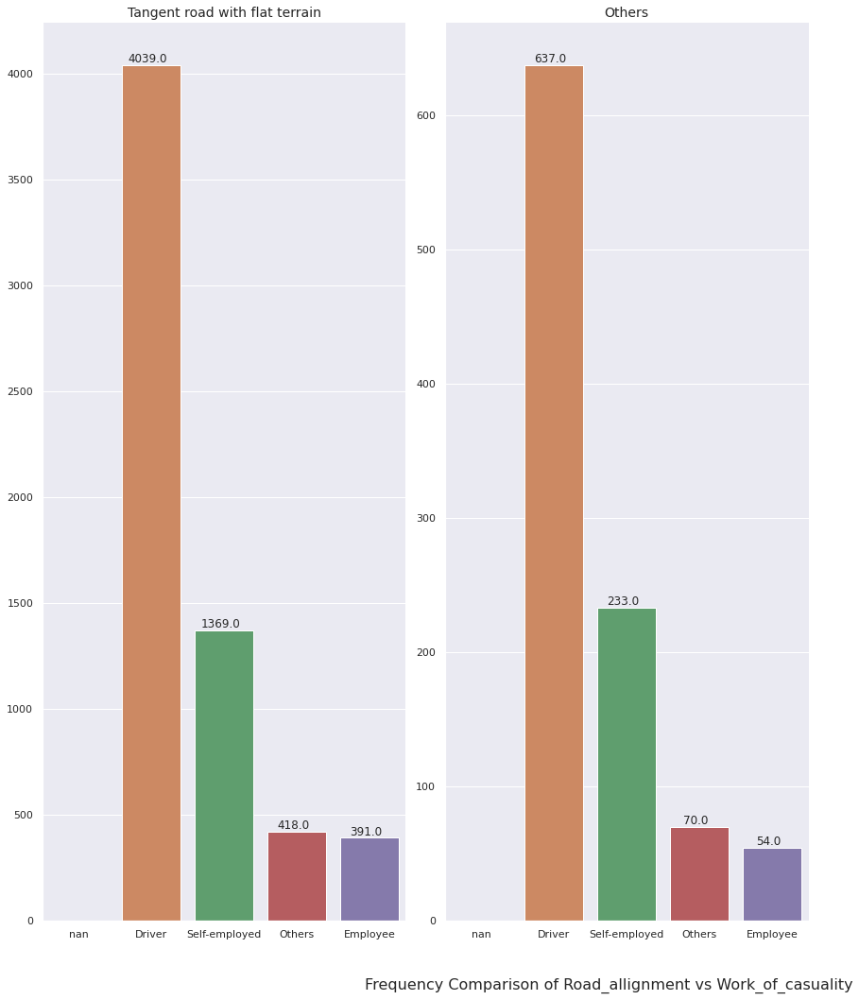




Showing Frequency Plots here for Types_of_Junction:



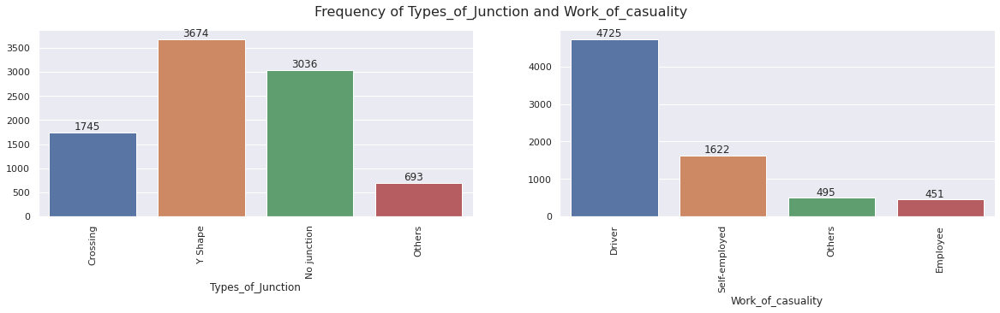


Showing Frequency Comparison of Types_of_Junction vs Work_of_casuality



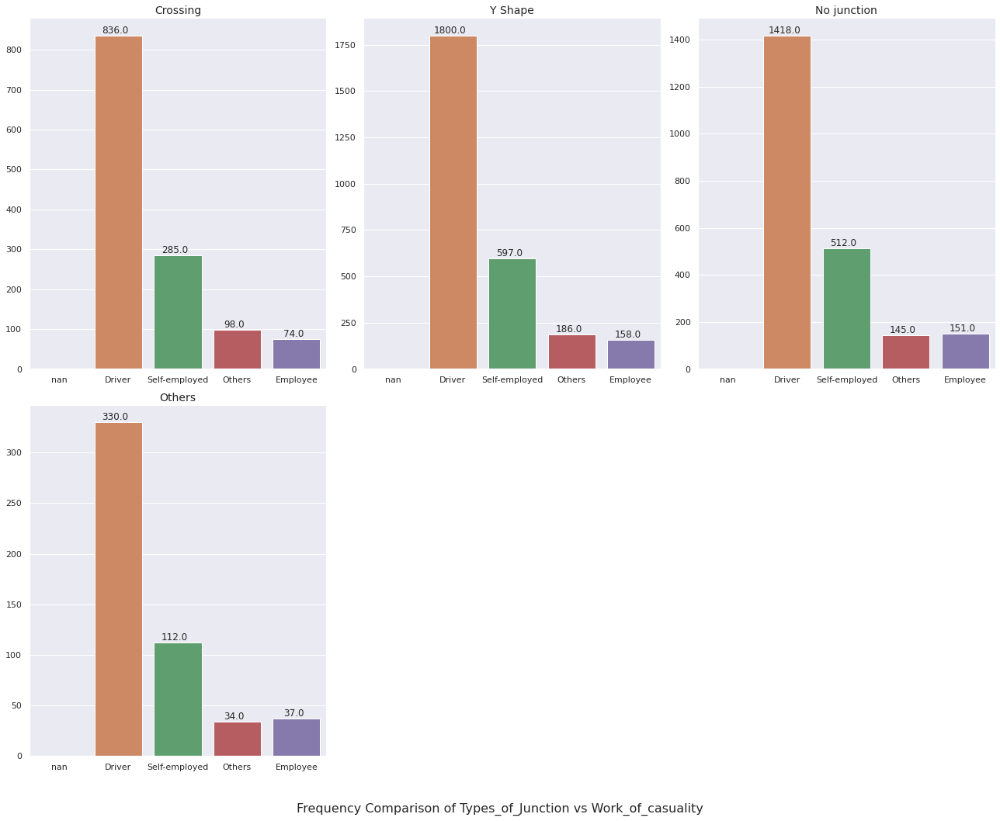




Showing Frequency Plots here for Road_surface_type:



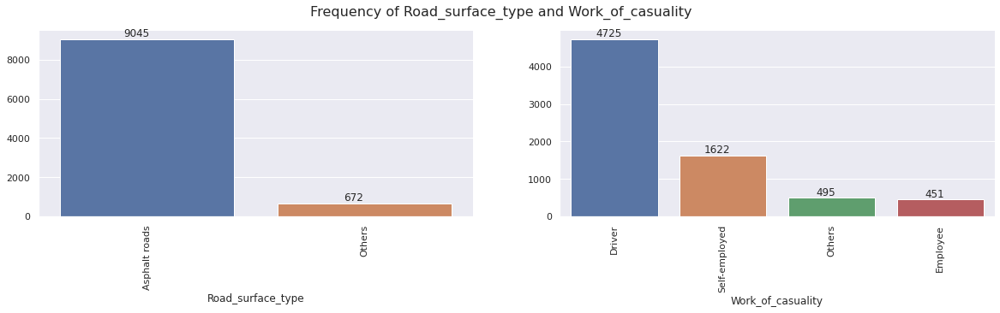


Showing Frequency Comparison of Road_surface_type vs Work_of_casuality



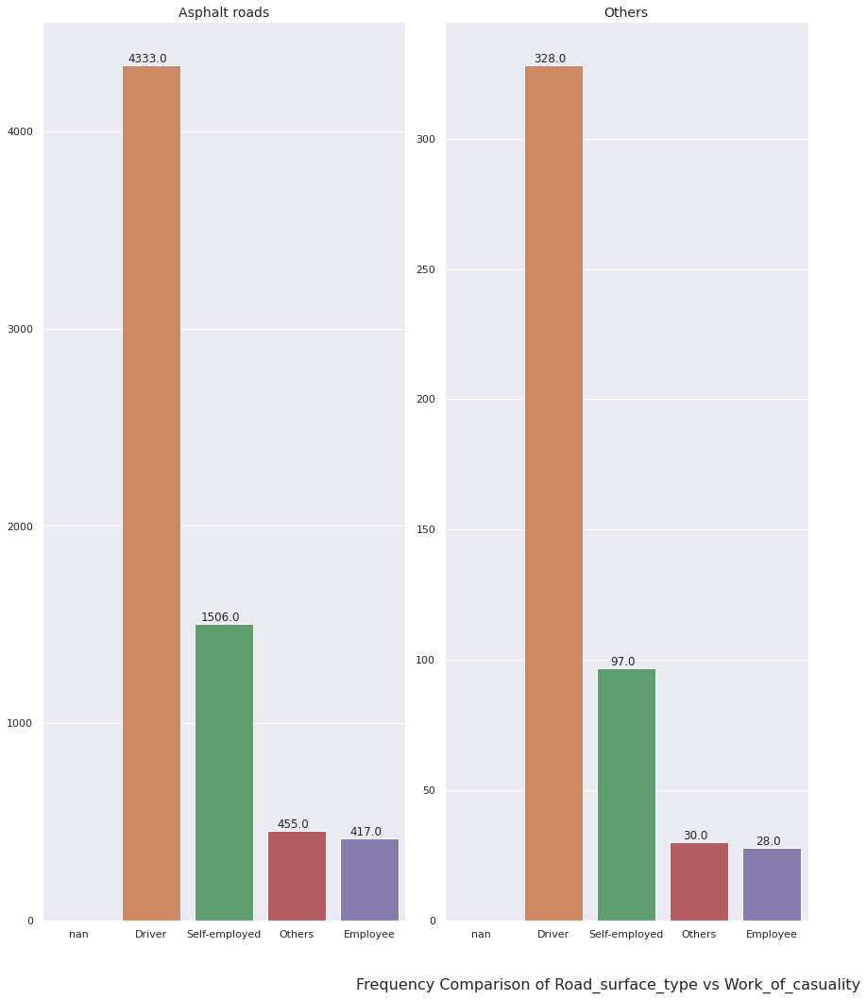




Showing Frequency Plots here for Road_surface_conditions:



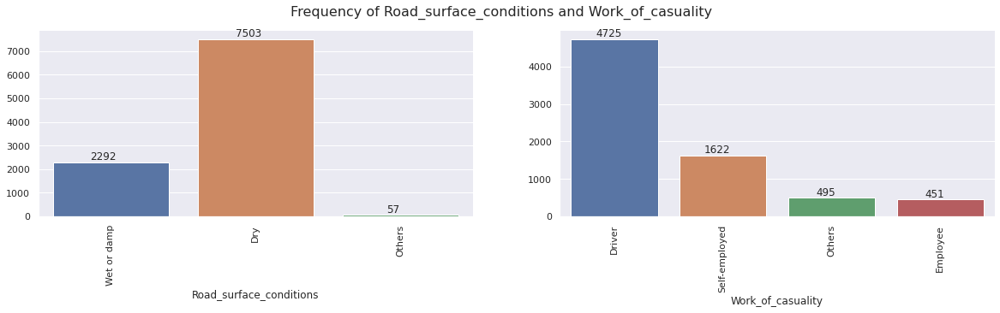


Showing Frequency Comparison of Road_surface_conditions vs Work_of_casuality



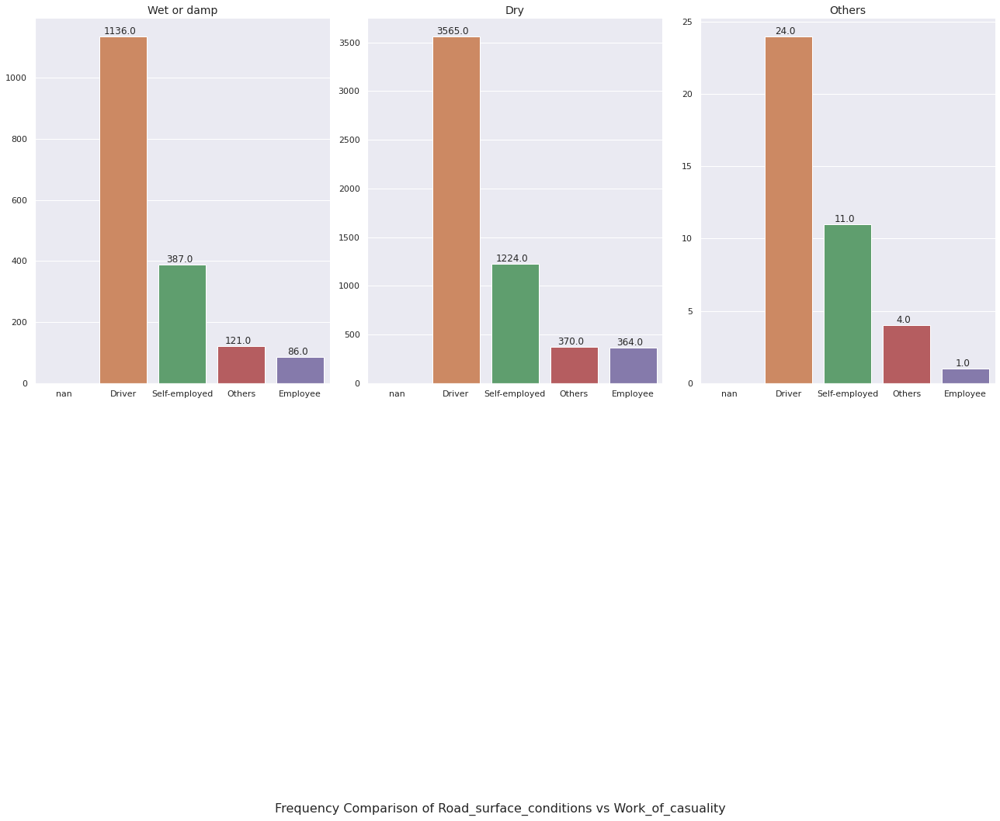




Showing Frequency Plots here for Light_conditions:



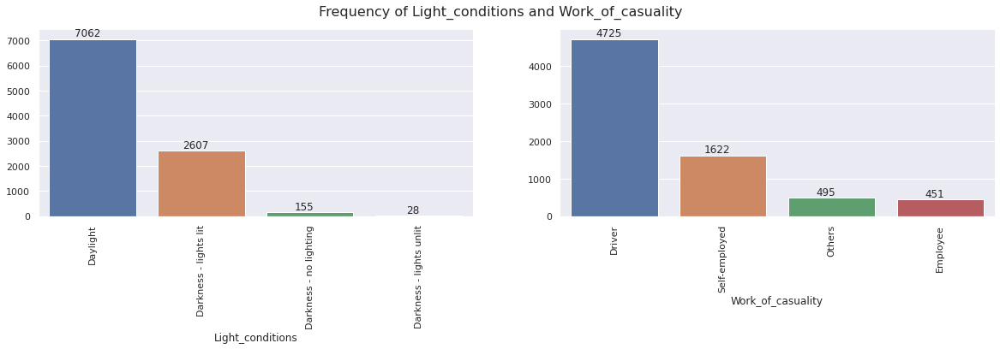


Showing Frequency Comparison of Light_conditions vs Work_of_casuality



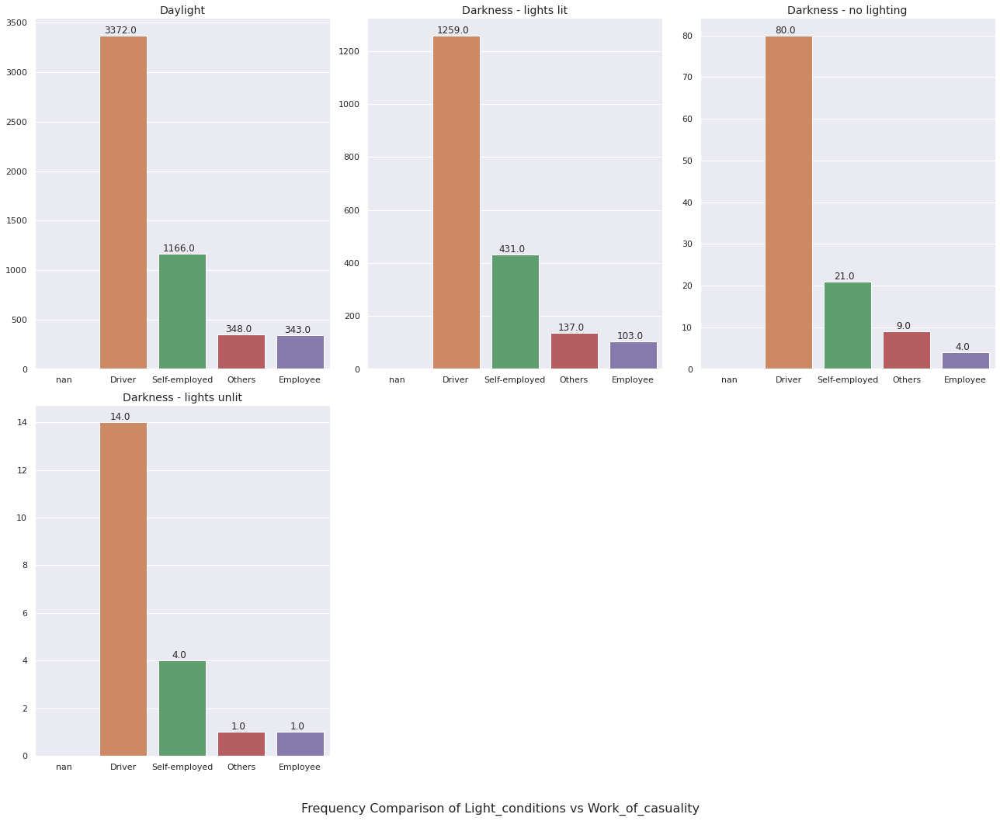




Showing Frequency Plots here for Weather_conditions:



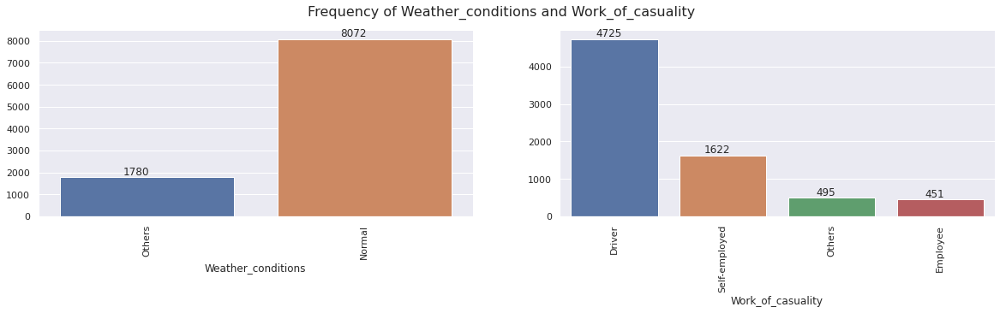


Showing Frequency Comparison of Weather_conditions vs Work_of_casuality



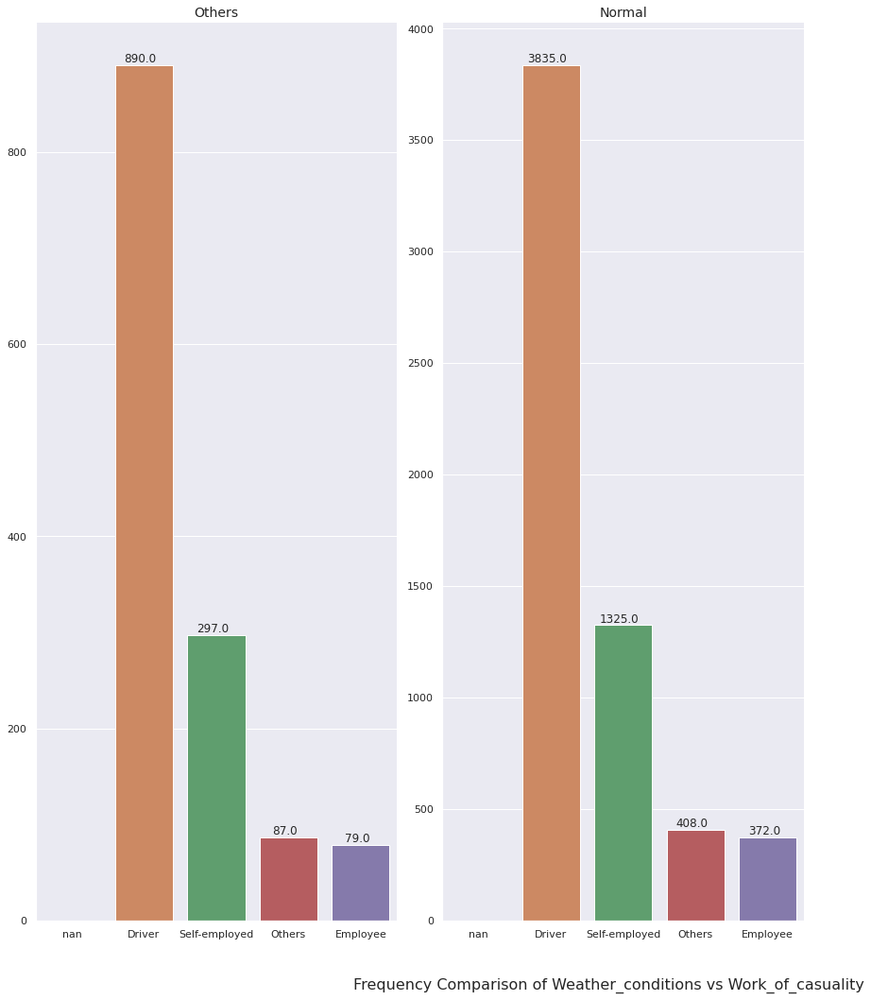




Showing Frequency Plots here for Type_of_collision:



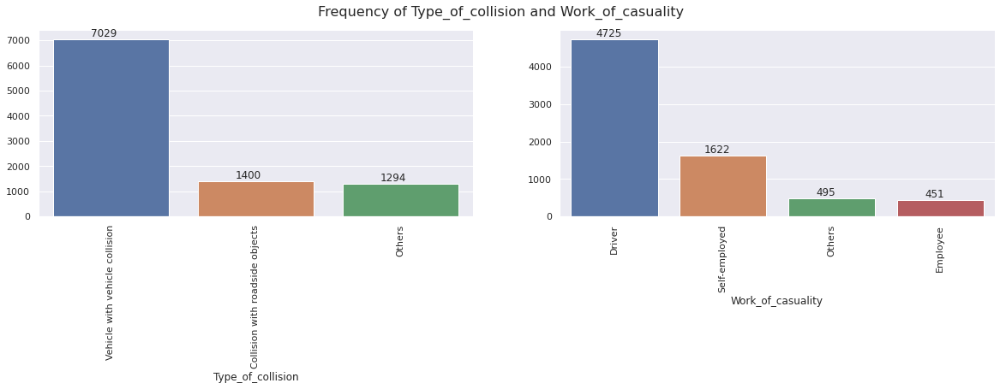


Showing Frequency Comparison of Type_of_collision vs Work_of_casuality



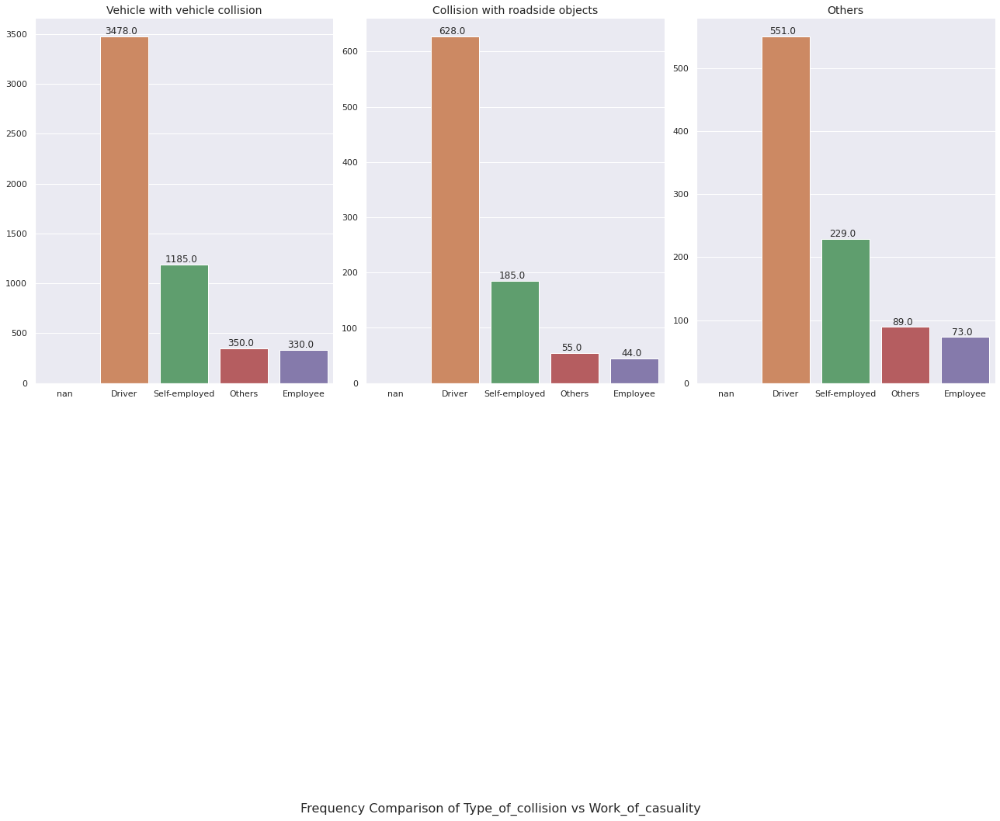




Showing Frequency Plots here for Number_of_vehicles_involved:



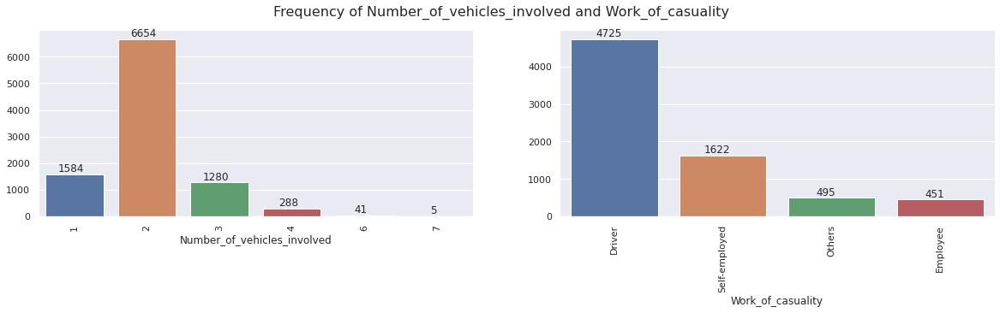


Showing Frequency Comparison of Number_of_vehicles_involved vs Work_of_casuality



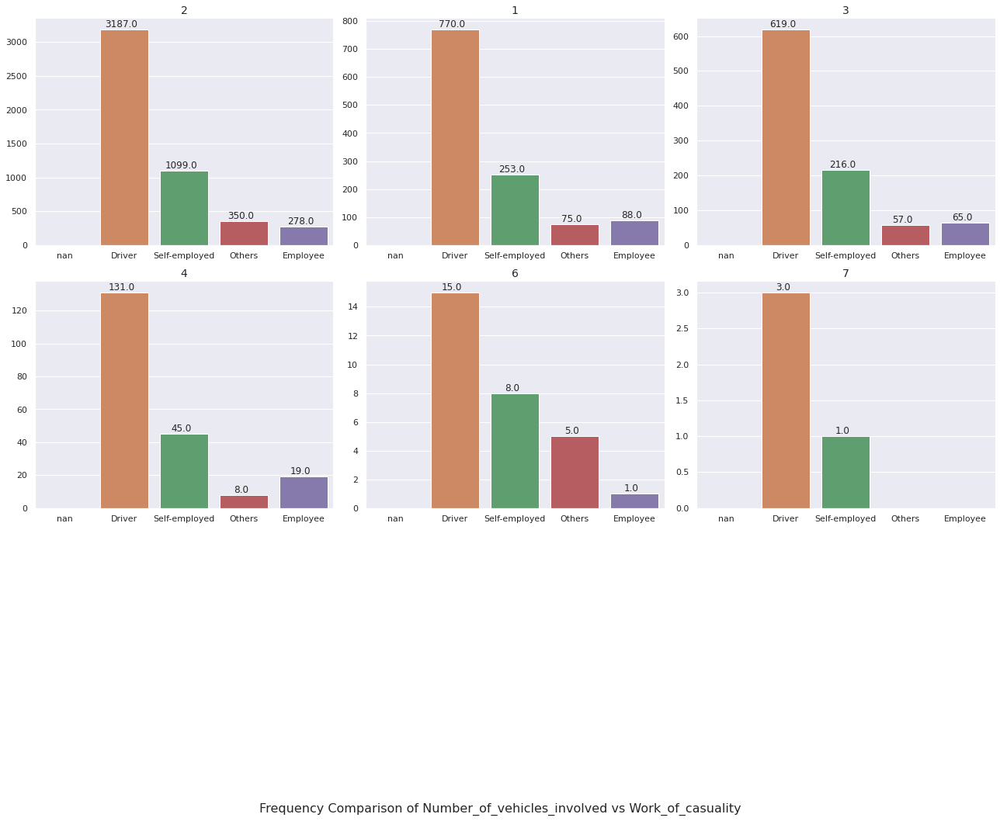




Showing Frequency Plots here for Number_of_casualties:



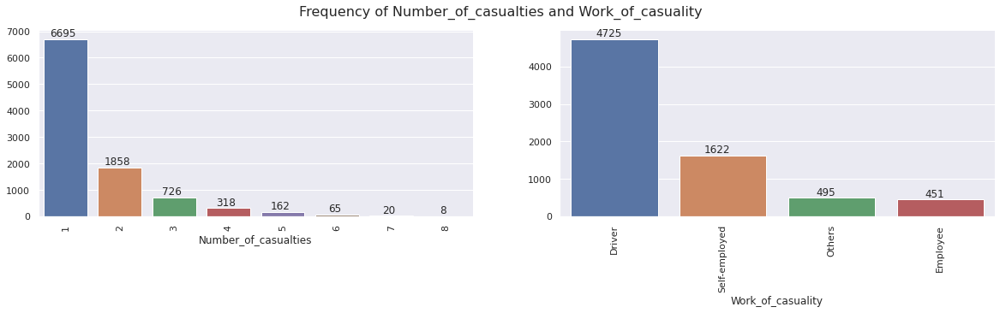


Showing Frequency Comparison of Number_of_casualties vs Work_of_casuality



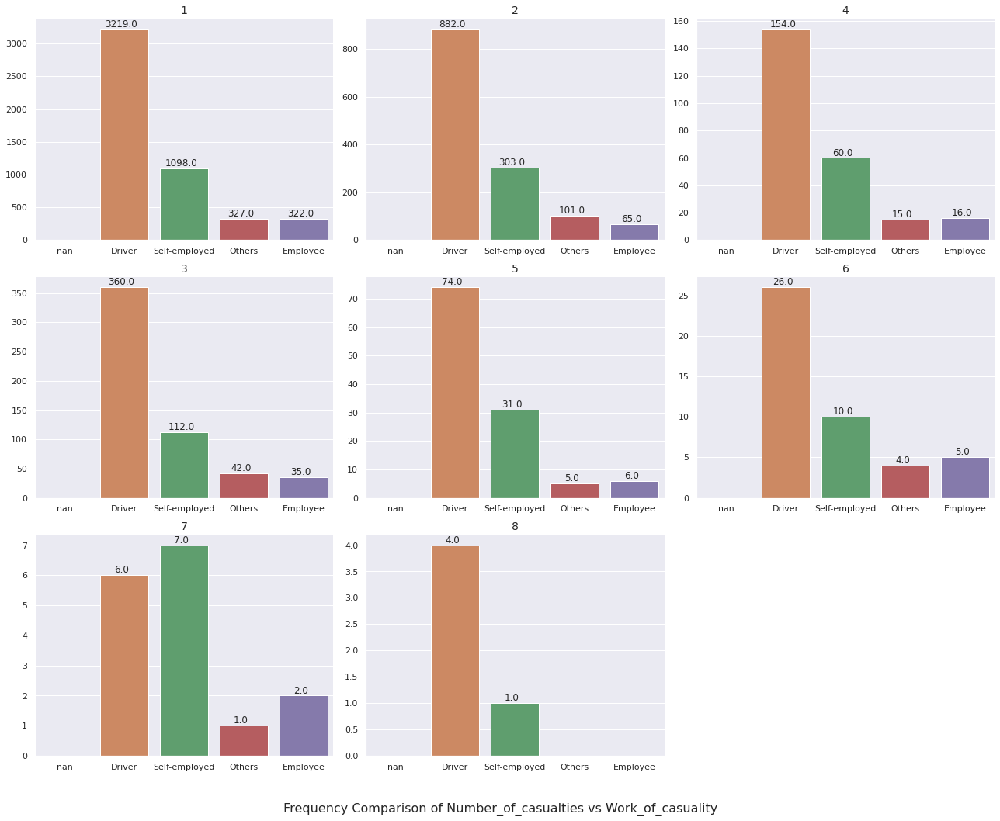




Showing Frequency Plots here for Vehicle_movement:



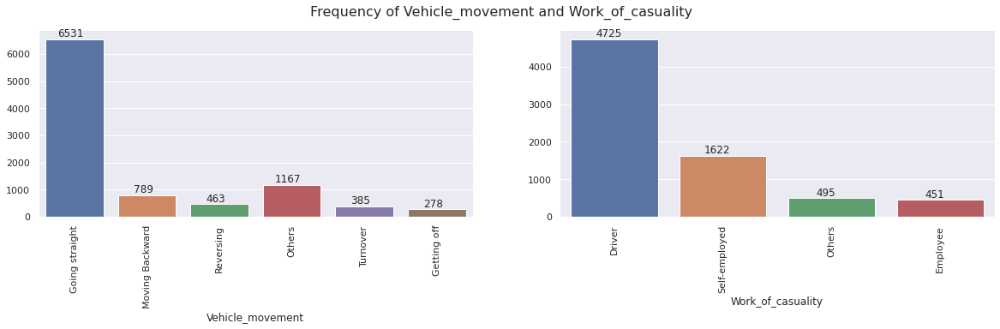


Showing Frequency Comparison of Vehicle_movement vs Work_of_casuality



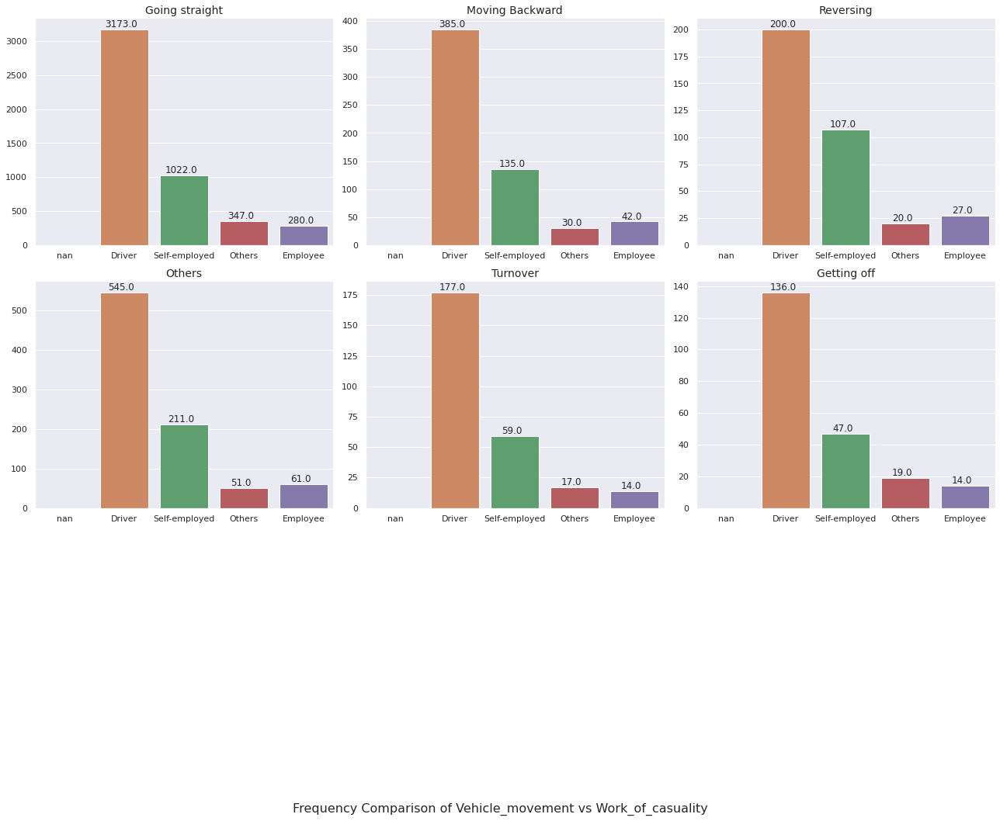




Showing Frequency Plots here for Casualty_class:



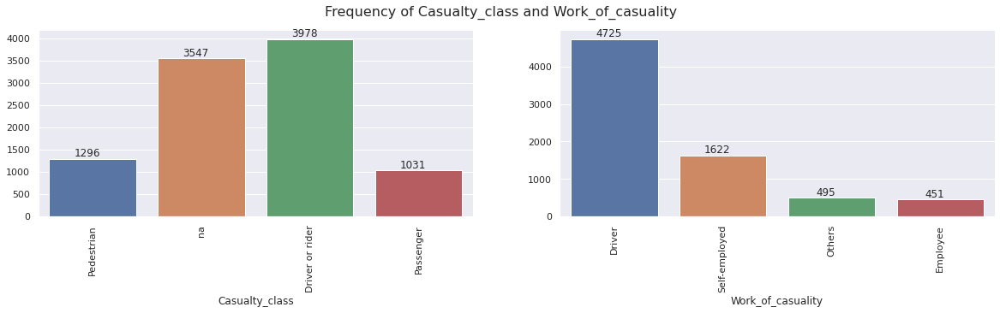


Showing Frequency Comparison of Casualty_class vs Work_of_casuality



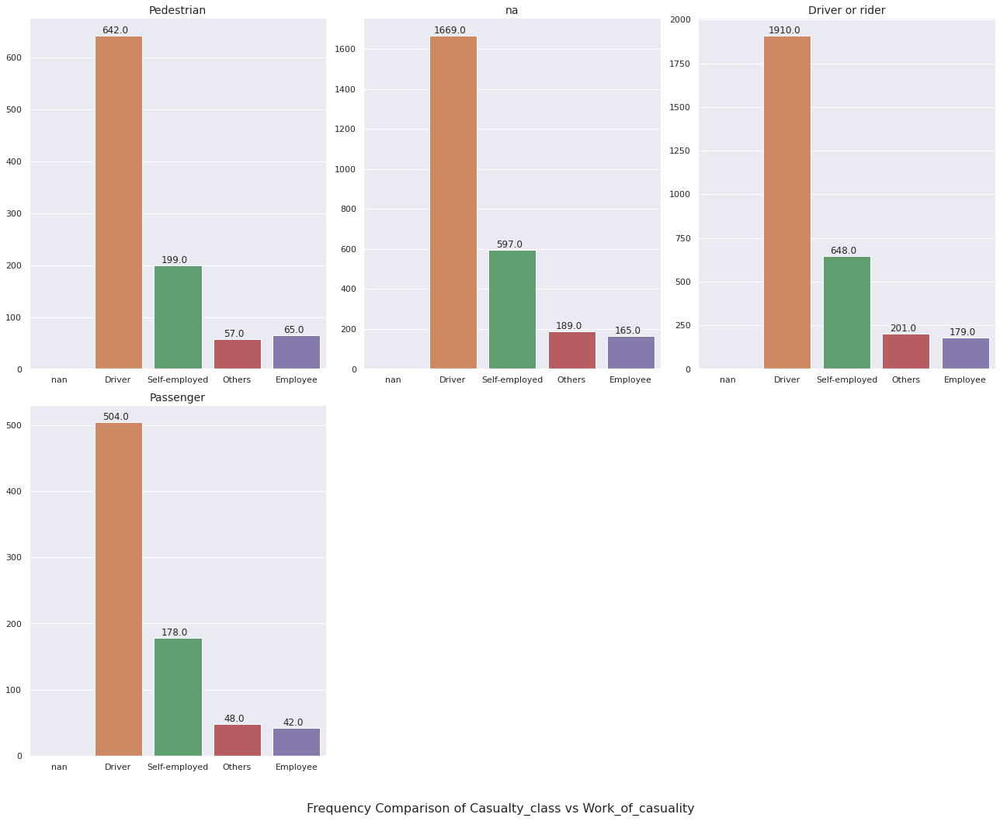




Showing Frequency Plots here for Sex_of_casualty:



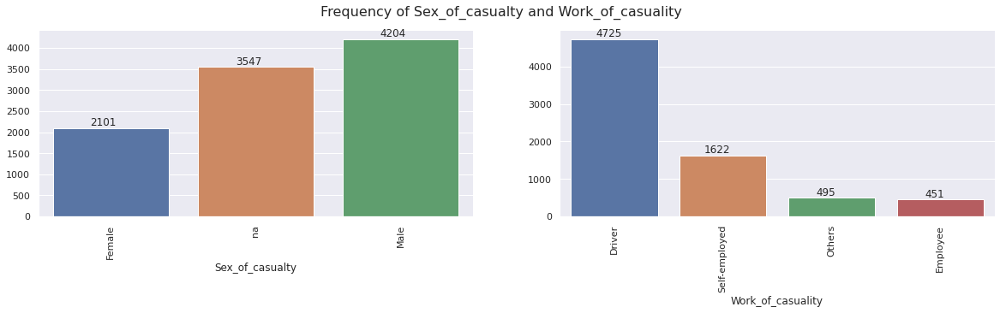


Showing Frequency Comparison of Sex_of_casualty vs Work_of_casuality



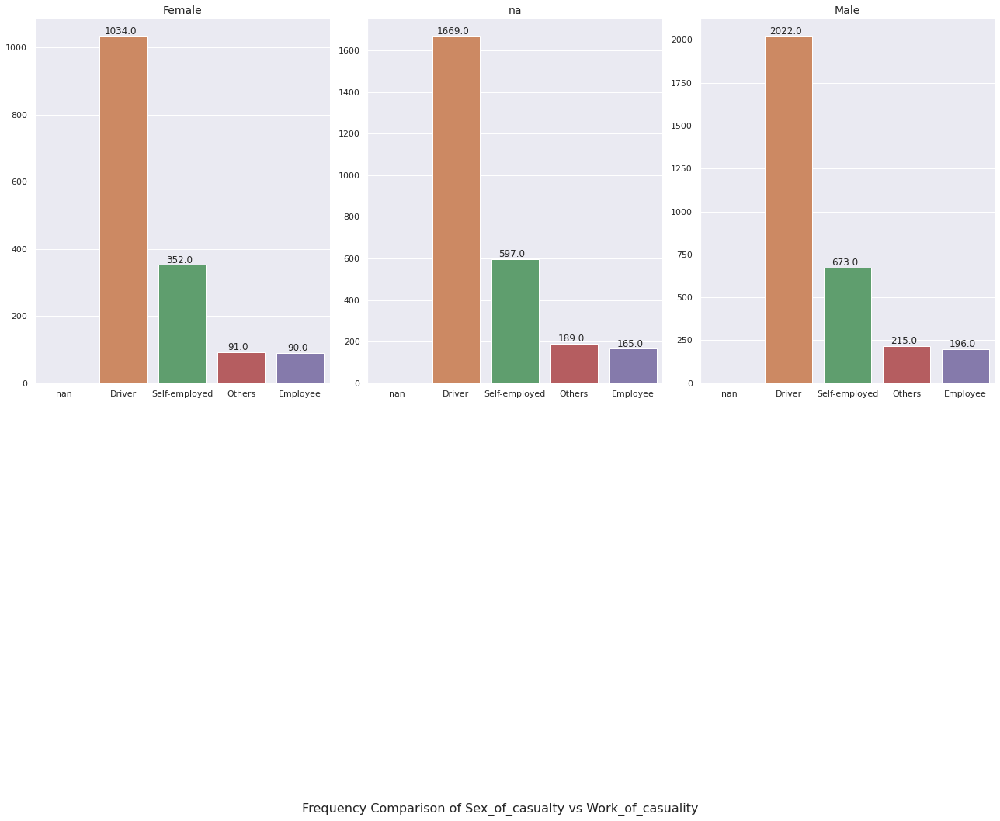




Showing Frequency Plots here for Age_band_of_casualty:



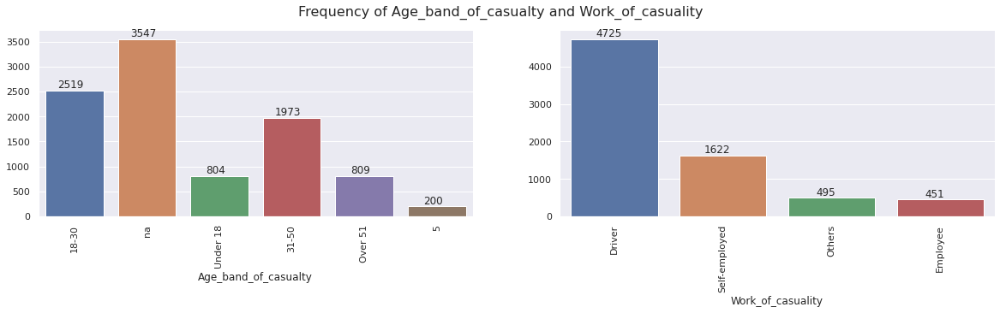


Showing Frequency Comparison of Age_band_of_casualty vs Work_of_casuality



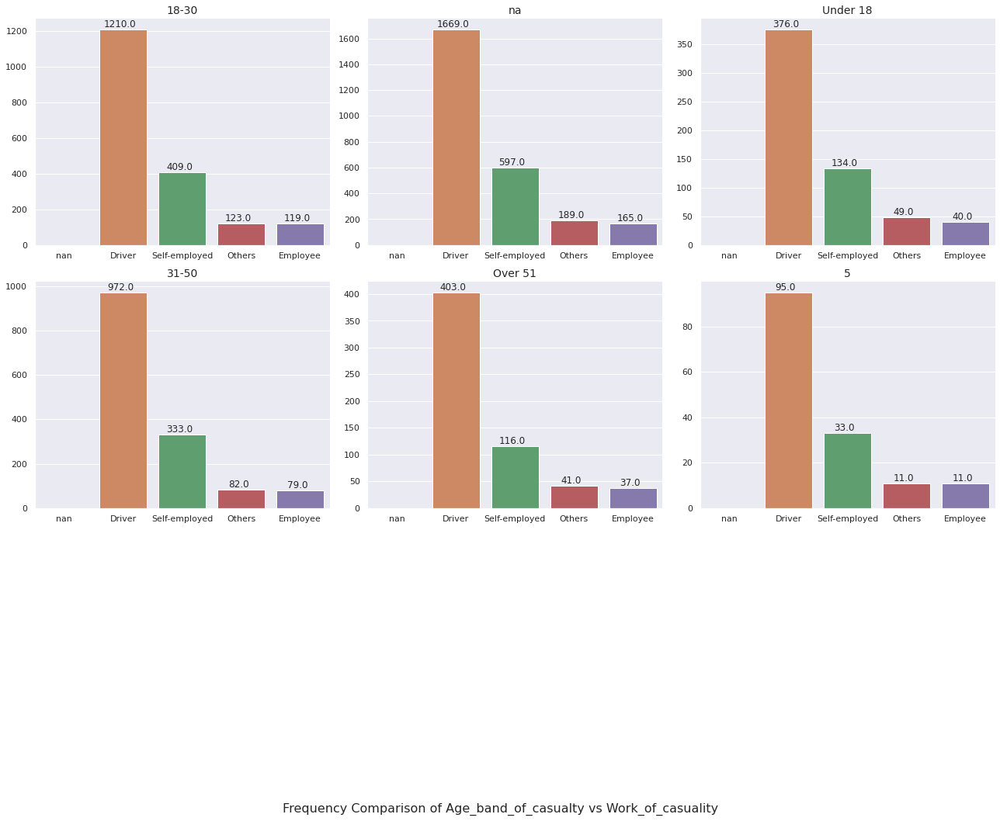




Showing Frequency Plots here for Casualty_severity:



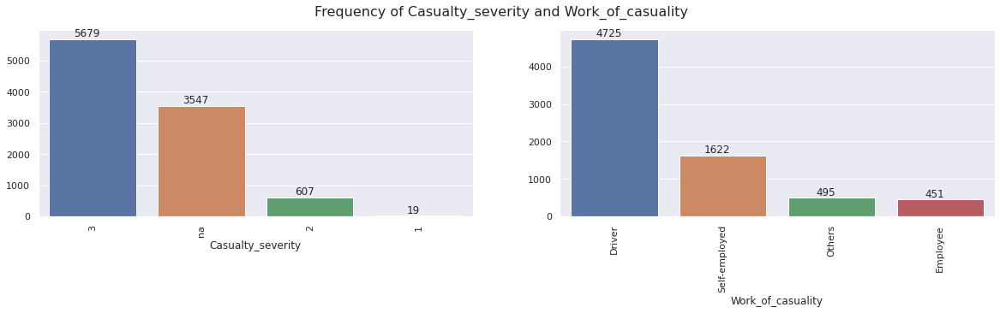


Showing Frequency Comparison of Casualty_severity vs Work_of_casuality



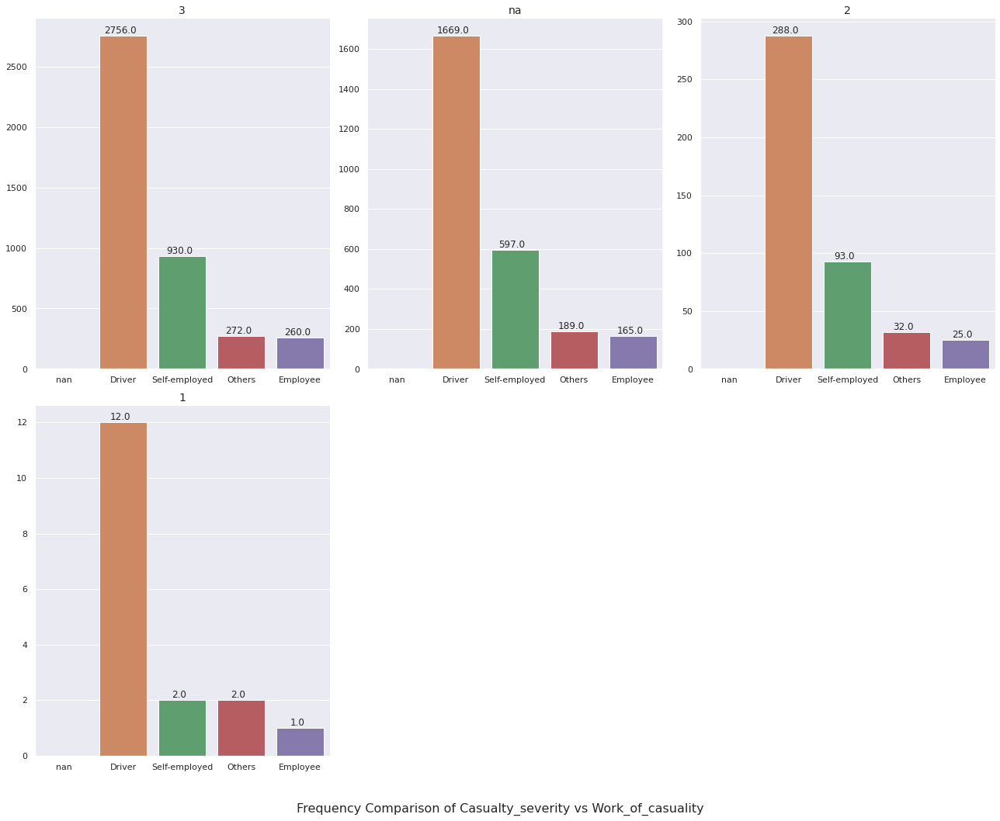




Showing Frequency Plots here for Work_of_casuality:



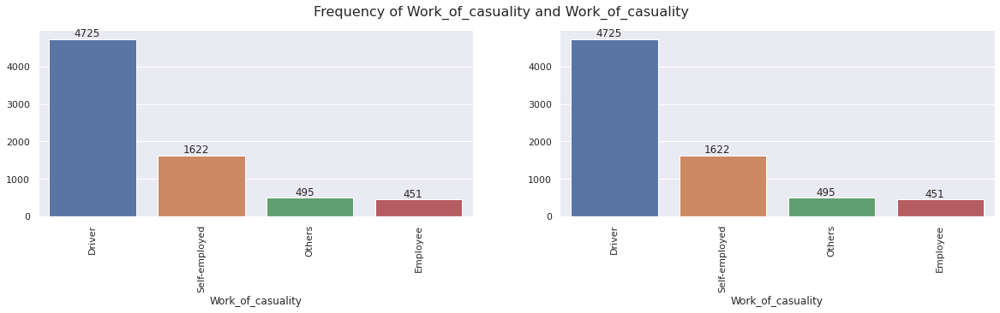


Showing Frequency Comparison of Work_of_casuality vs Work_of_casuality



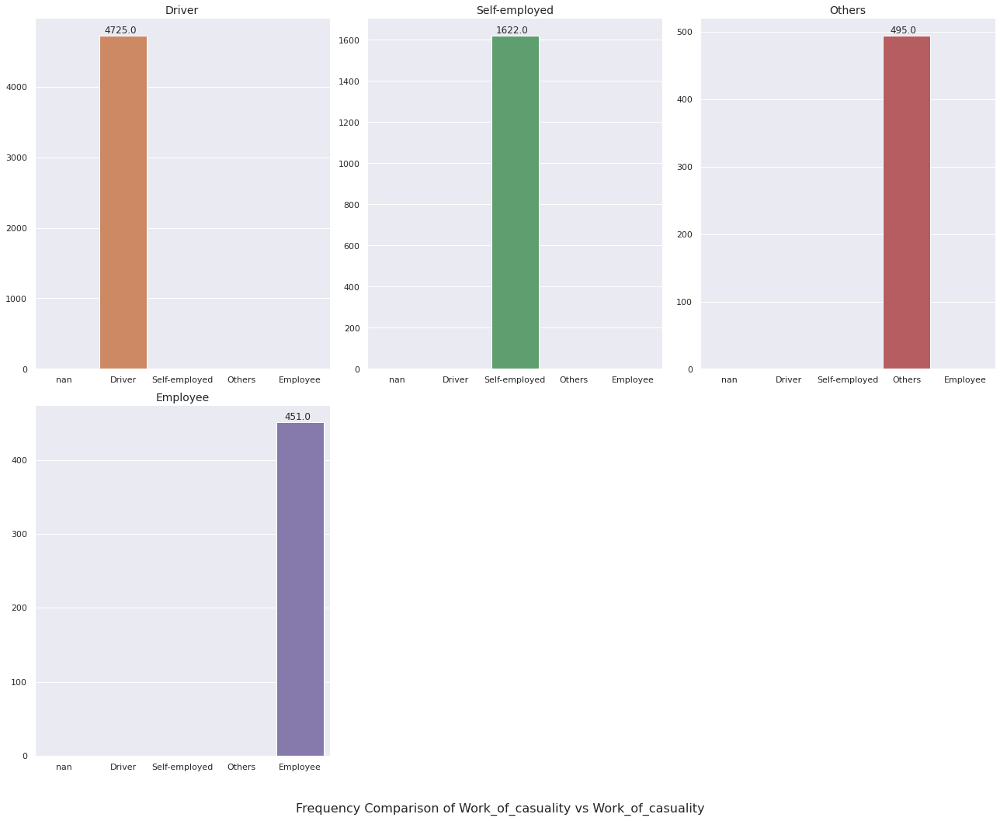




Showing Frequency Plots here for Pedestrian_movement:



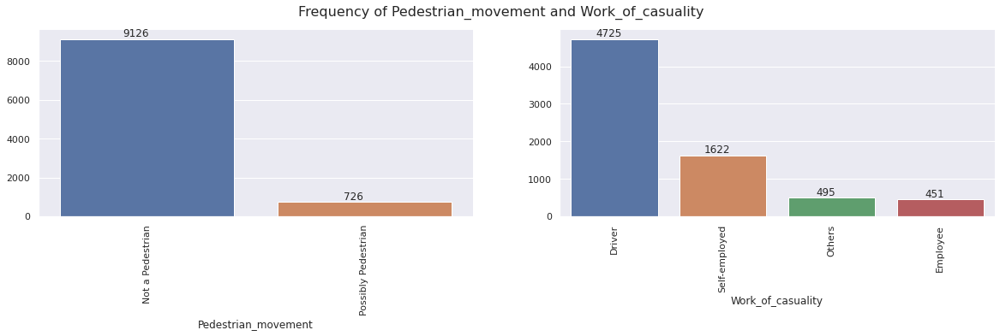


Showing Frequency Comparison of Pedestrian_movement vs Work_of_casuality



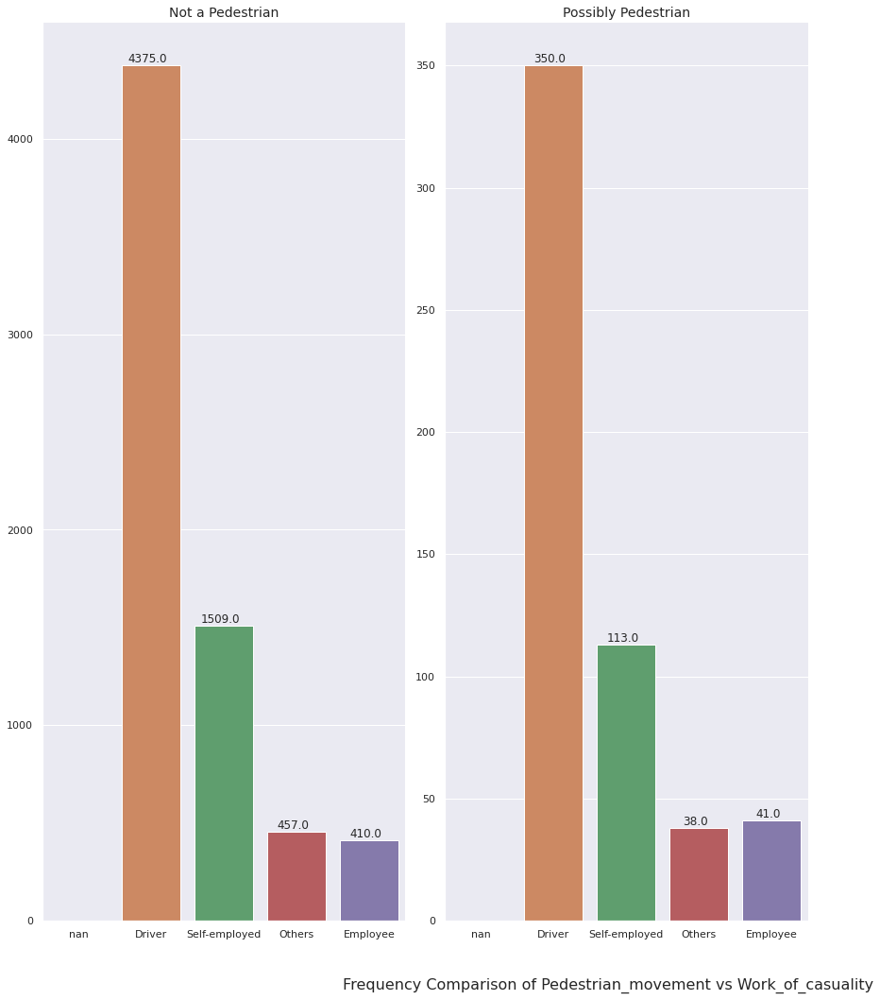




Showing Frequency Plots here for Cause_of_accident:



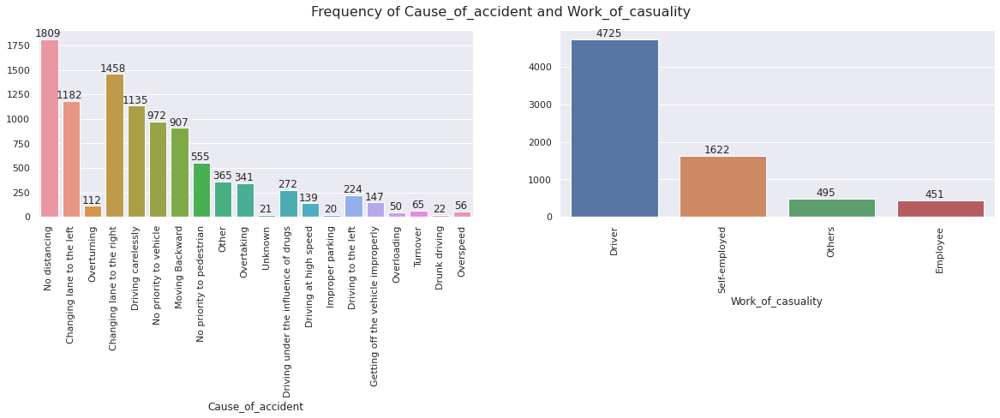


Showing Frequency Comparison of Cause_of_accident vs Work_of_casuality



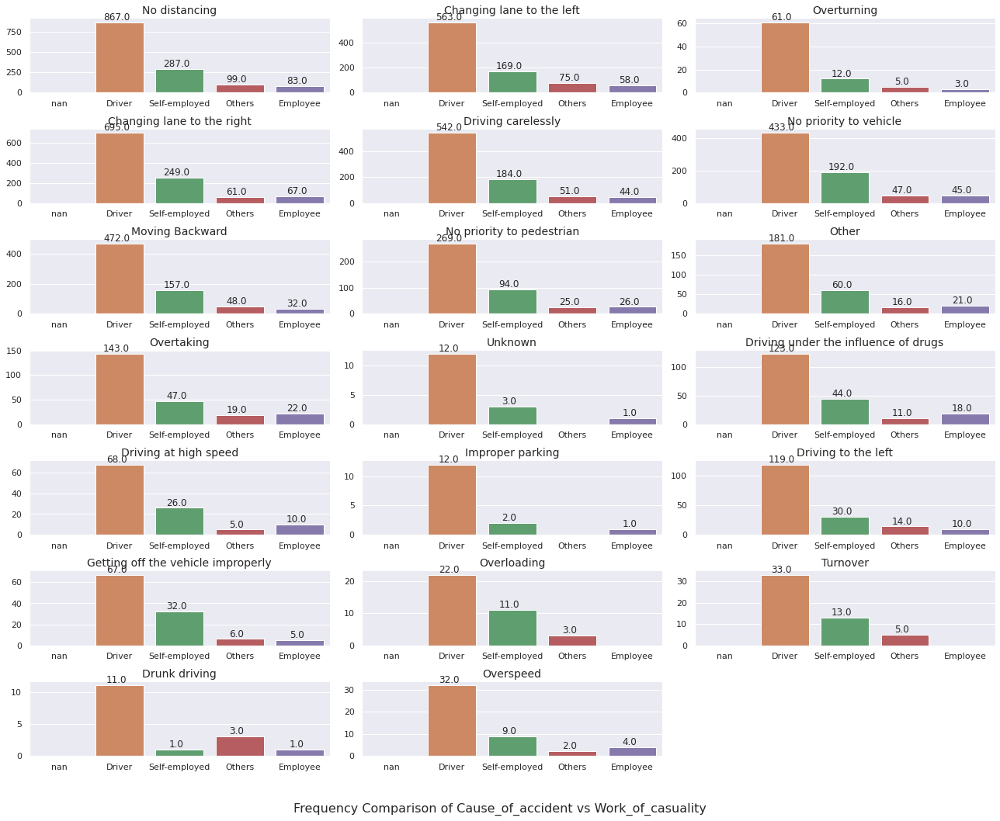




Showing Frequency Plots here for Accident_severity:



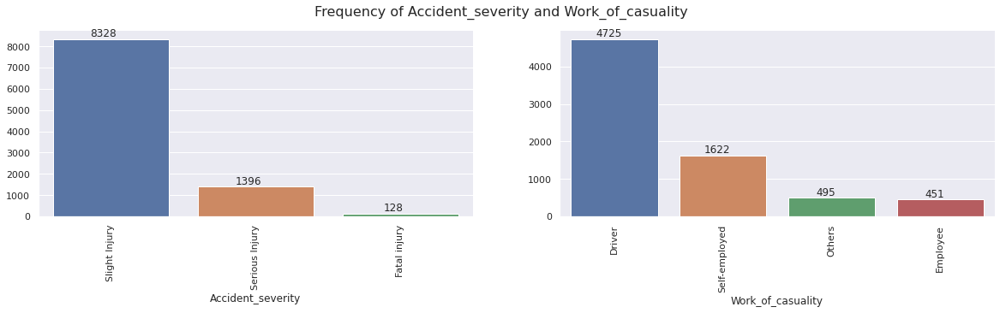


Showing Frequency Comparison of Accident_severity vs Work_of_casuality



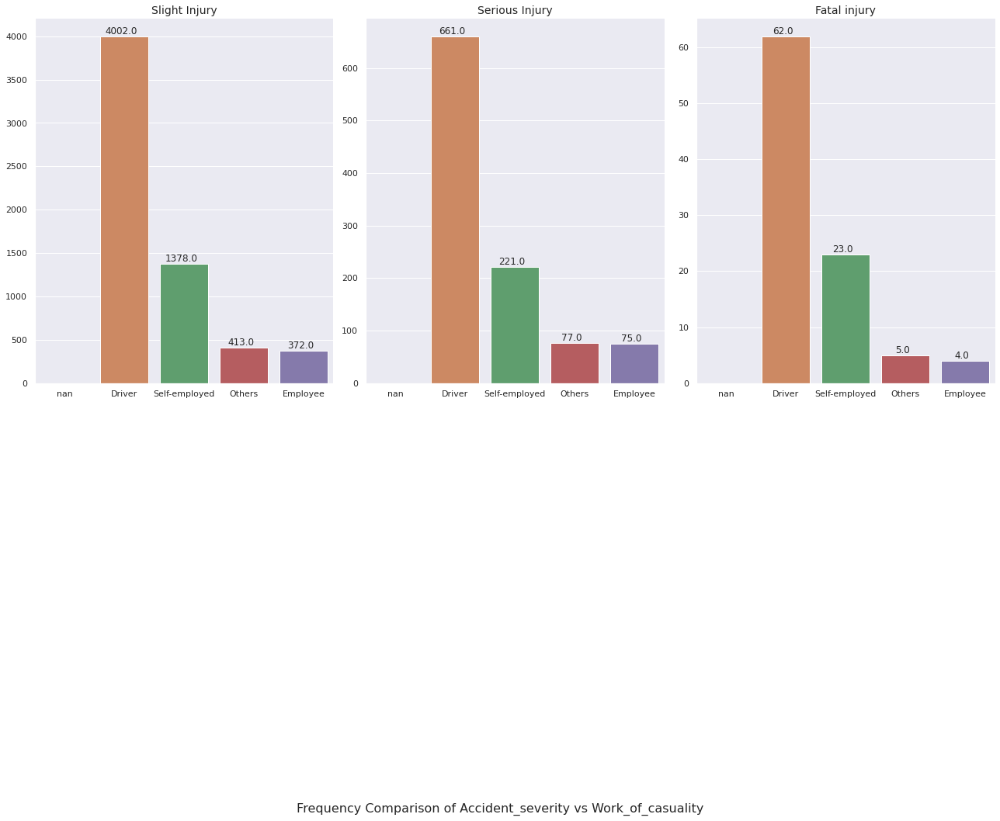

In [ ]:
# Checking relations with other columns
for col in df.columns:
    column_barplot(df, col,  "Work_of_casuality")

* Checking the plot relation between other columns with column Work_of_casuality, we can device a plan to fill up the missing value:
    1. Take the category of each column with max frequency.
    2. Check the ratio of "Driver" and "Self Employed" for those categories. (Note that we are delibarately ignoring other two categories for now)
    3. Take the average of ratios (like int(avg. of Driver value) : int(avg. of Self employed value))
    4. Fill up the values in the column Work_of_casuality with that ratio.

Let's implement this!

In [ ]:
df.Work_of_casuality.unique()

array([nan, 'Driver', 'Self-employed', 'Others', 'Employee'], dtype=object)

In [ ]:
df.Work_of_casuality.value_counts()

Driver           4725
Self-employed    1622
Others            495
Employee          451
Name: Work_of_casuality, dtype: int64

In [ ]:
df = missing_value_fillup_1(df, "Work_of_casuality", ['Driver', 'Self-employed'], "Accident_severity")

In [ ]:
df.Work_of_casuality.value_counts()

Driver           6583
Self-employed    2323
Others            495
Employee          451
Name: Work_of_casuality, dtype: int64

Showing Frequency Plots here for Work_of_casuality:



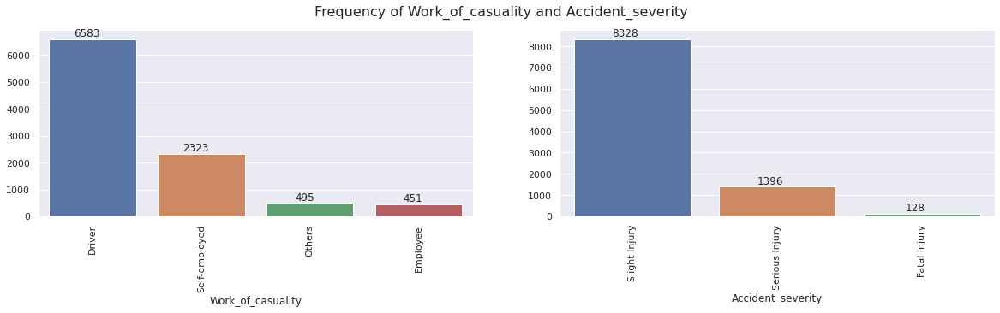


Showing Frequency Comparison of Work_of_casuality vs Accident_severity



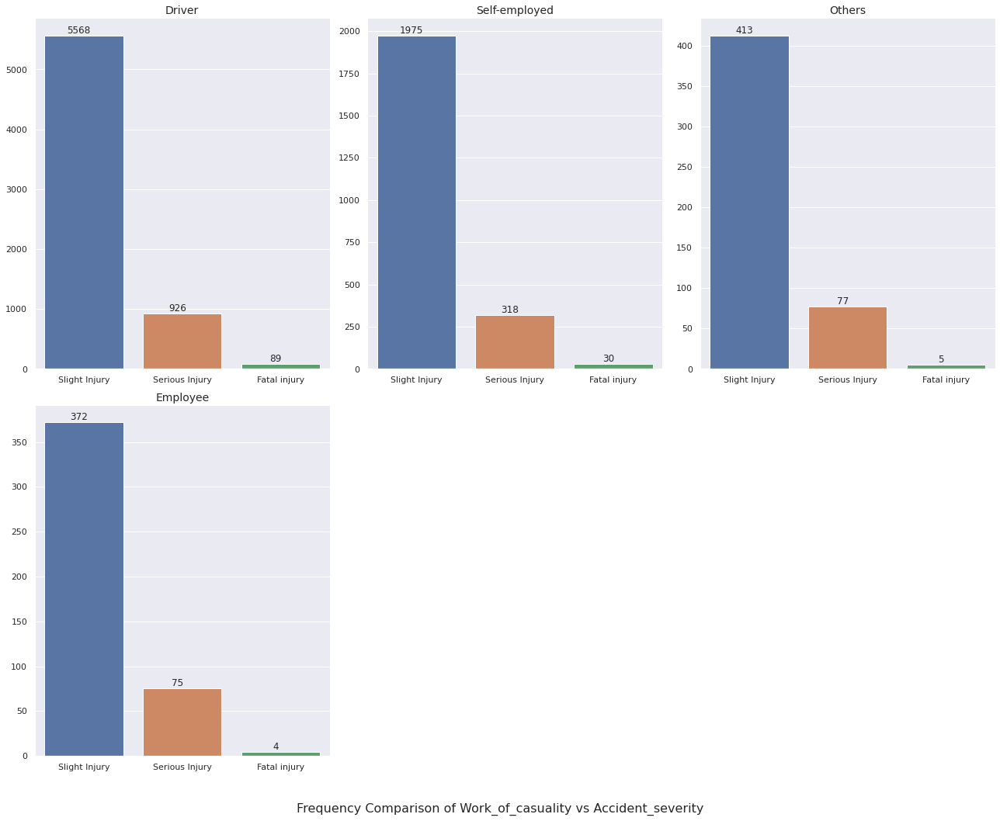

In [ ]:
column_barplot(df, "Work_of_casuality", target_col)

In [ ]:
# Rechecking na counts
na_count_table(df)

,column,na_count,ratio (in persentage)
4,Educational_level,617,6.26
5,Vehicle_driver_relation,478,4.85
6,Driving_experience,691,7.01
7,Type_of_vehicle,760,7.71
8,Owner_of_vehicle,387,3.93
9,Area_accident_occured,192,1.95
10,Lanes_or_Medians,294,2.98
11,Road_allignment,116,1.18
12,Types_of_Junction,704,7.15
13,Road_surface_type,135,1.37


* We can see that the following columns contain less than 5% missing value.
    1. Area_accident_occured
    2. Road_allignment
    3. Road_surface_type
    4. Type_of_collision
    5. Vehicle_movement
    6. Owner_of_vehicle
    7. Lanes_or_Medians
    8. Vehicle_driver_relation

We can replce missing values with Mode for now. We can tweak in later stages.

In [ ]:
df.Area_accident_occured.fillna("Others", inplace=True)

In [ ]:
df.Road_allignment.fillna("Tangent road with flat terrain", inplace=True)

In [ ]:
df.Road_surface_type.fillna("Asphalt roads", inplace=True)

In [ ]:
df.Type_of_collision.fillna("Vehicle with vehicle collision", inplace=True)

In [ ]:
df.Vehicle_movement.fillna("Going straight", inplace=True)

In [ ]:
df.Owner_of_vehicle.fillna("Owner", inplace=True)

Showing Frequency Plots here for Lanes_or_Medians:



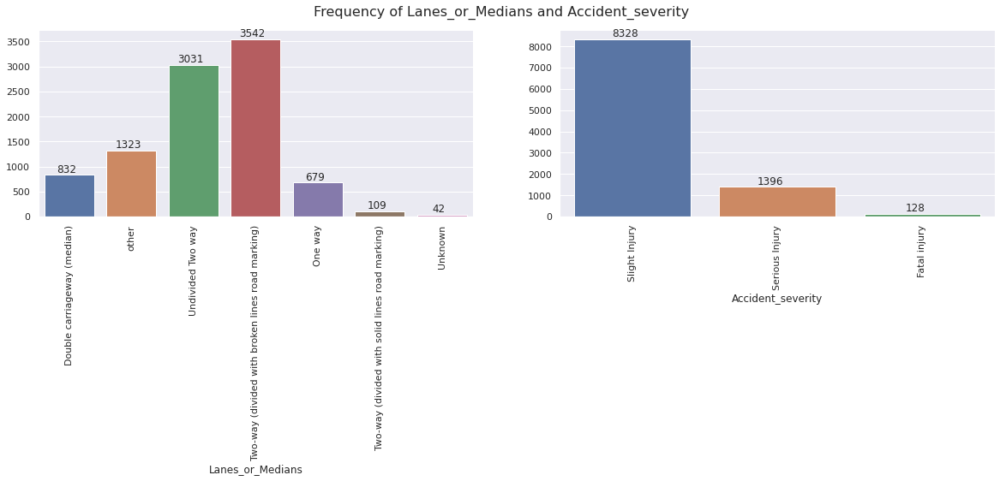


Showing Frequency Comparison of Lanes_or_Medians vs Accident_severity



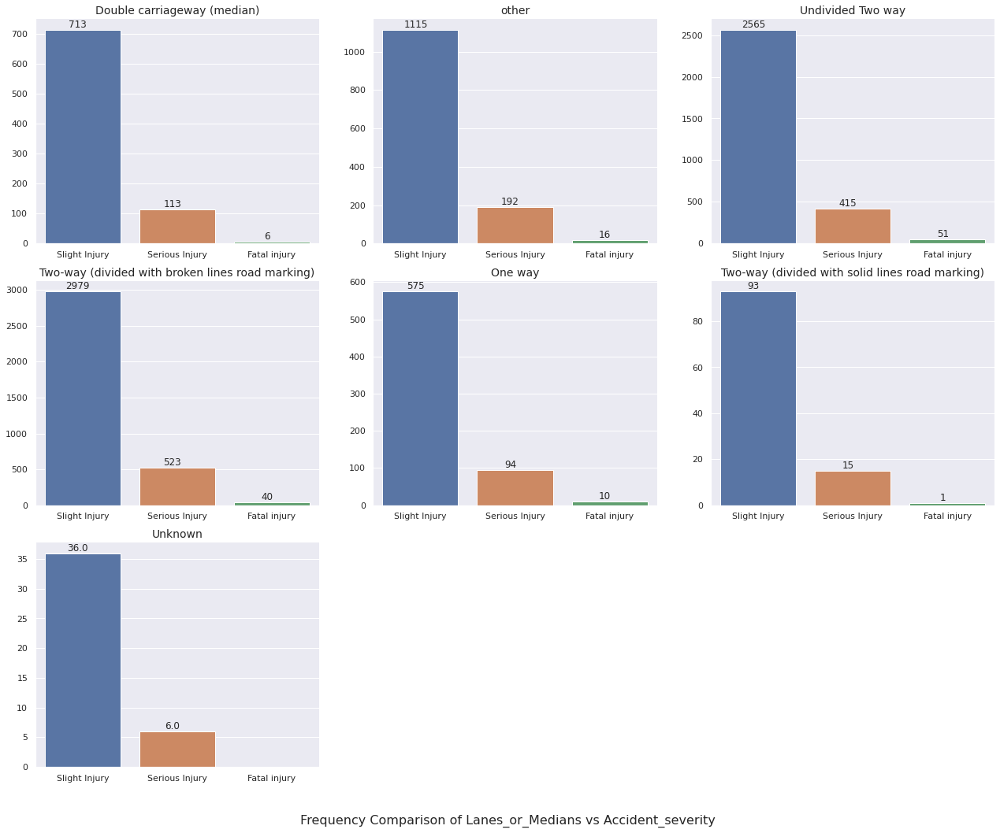

In [ ]:
# Checking count plot for column Lanes_or_Medians
column_barplot(df, "Lanes_or_Medians", target_col, importance=2)

Checking the column Lanes_or_Medians, we can see that the categories "Undivided Two way" and "Two-way (divided with broken lines road marking)" contains a lot of records and we can simply device a plan to populate the NaN values. We can also see that their is also one other category "Unknown" which actually do not effect the fatal injury. We can assume that an "Unkown" to such answer (lane or median) is more likely to be considered as NaN.

In [ ]:
df = convert_to_na(df, "Lanes_or_Medians", ["Unknown"])

Now we can fill up NaN similar way to column work of casualty. We can device new plan in later stage later.

In [ ]:
df = missing_value_fillup_1(df, "Lanes_or_Medians", ['Undivided Two way', 'Two-way (divided with broken lines road marking)'], "Accident_severity")

In [ ]:
df.Vehicle_driver_relation.fillna("Employee", inplace=True)

In [ ]:
# Rechecking na counts
na_count_table(df)

,column,na_count,ratio (in persentage)
4,Educational_level,617,6.26
6,Driving_experience,691,7.01
7,Type_of_vehicle,760,7.71
12,Types_of_Junction,704,7.15


* We can see that we have 4 more columns with NaN values and those have more 5% NaN. In this situation we can either delete the column or replace NaN with mode or even we can device plan to fill up NaN intellegently depending on the situation. The columns are:
    1. Educational_level
    2. Driving_experience
    3. Type_of_vehicle
    4. Type_of Junction

Showing Frequency Plots here for Educational_level:



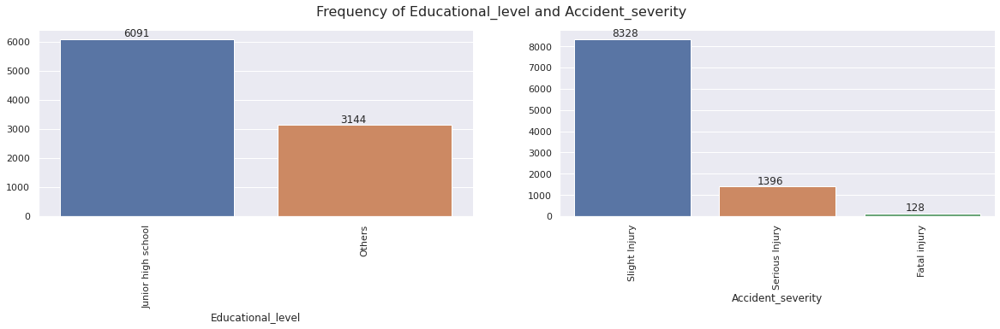

In [ ]:
# Checking count plot of Educational_level
column_barplot(df, "Educational_level", target_col, importance=1)

In [ ]:
df.Educational_level.value_counts()

Junior high school    6091
Others                3144
Name: Educational_level, dtype: int64

We can use similar fashion used previously to fill up NaN values for now.

In [ ]:
df.Educational_level.unique()

array(['Junior high school', 'Others', nan], dtype=object)

In [ ]:
df = missing_value_fillup_1(df, "Educational_level", ['Junior high school', 'Others'], "Accident_severity")

In [ ]:
df.Educational_level.value_counts()

Junior high school    6507
Others                3345
Name: Educational_level, dtype: int64

Showing Frequency Plots here for Driving_experience:



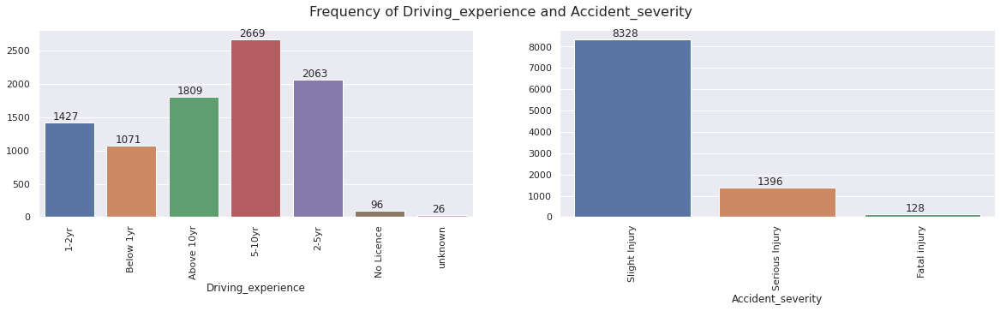

In [ ]:
# Checking count plot of Driving_experience
column_barplot(df, "Driving_experience", target_col, importance=1)

In [ ]:
df.Driving_experience.unique()

array(['1-2yr', 'Below 1yr', 'Above 10yr', '5-10yr', '2-5yr', nan,
       'No Licence', 'unknown'], dtype=object)

We can replace "unknown" with NaN and use similar technique as before

In [ ]:
df.Driving_experience.value_counts()

5-10yr        2669
2-5yr         2063
Above 10yr    1809
1-2yr         1427
Below 1yr     1071
No Licence      96
unknown         26
Name: Driving_experience, dtype: int64

In [ ]:
df = convert_to_na(df, "Driving_experience", ["unknown"])
df = missing_value_fillup_1(df, "Driving_experience", ['1-2yr', 'Above 10yr', '5-10yr', '2-5yr', 'Below 1yr'], "Accident_severity")
df.Driving_experience.value_counts()

5-10yr        2881
2-5yr         2232
Above 10yr    1941
1-2yr         1543
Below 1yr     1159
No Licence      96
Name: Driving_experience, dtype: int64

Showing Frequency Plots here for Type_of_vehicle:



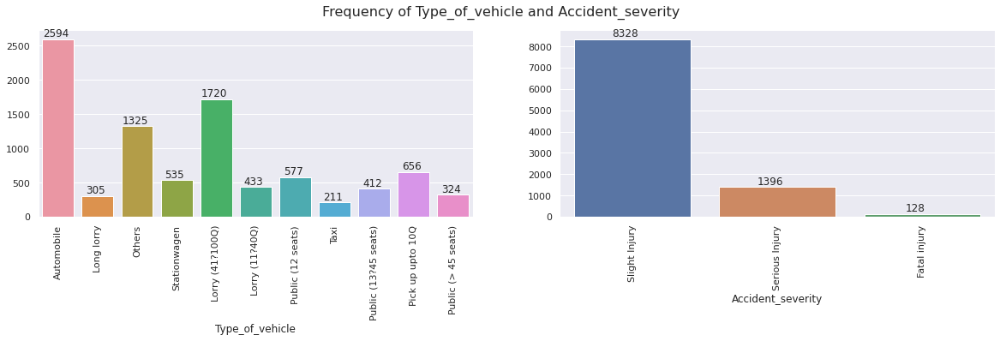


Showing Frequency Comparison of Type_of_vehicle vs Accident_severity



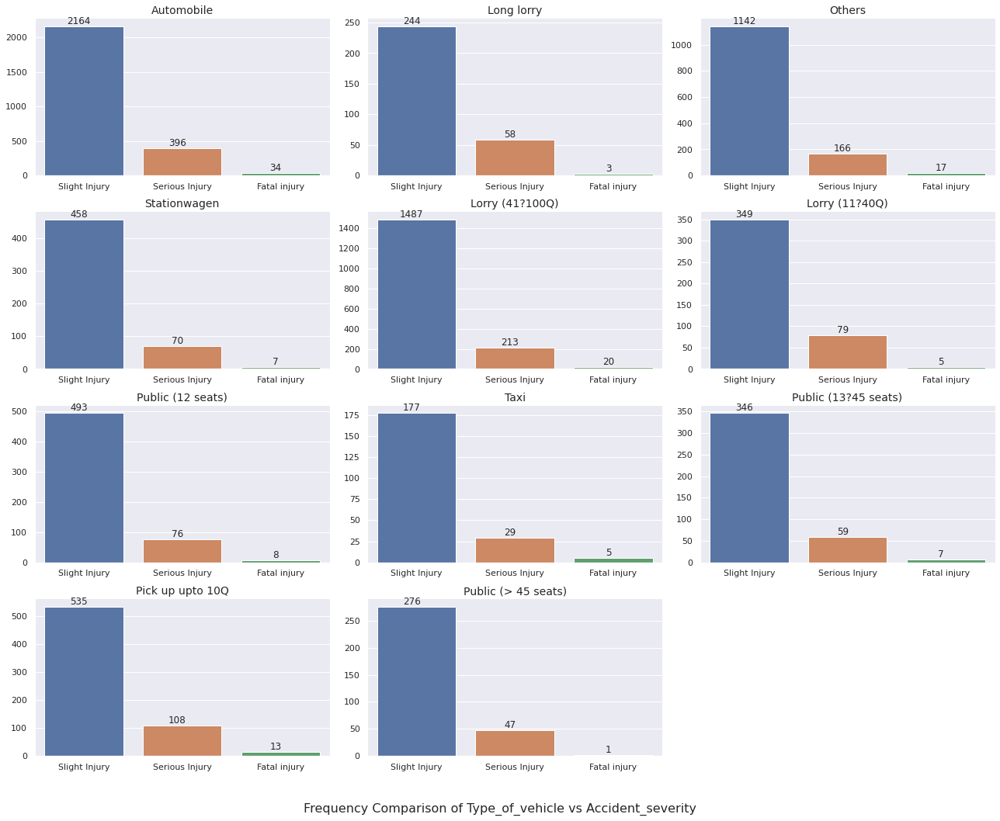

In [ ]:
# Checking count plot of Type_of_vehicle
column_barplot(df, "Type_of_vehicle", target_col, importance=2)

In [ ]:
df.Type_of_vehicle.value_counts()

Automobile              2594
Lorry (41?100Q)         1720
Others                  1325
Pick up upto 10Q         656
Public (12 seats)        577
Stationwagen             535
Lorry (11?40Q)           433
Public (13?45 seats)     412
Public (> 45 seats)      324
Long lorry               305
Taxi                     211
Name: Type_of_vehicle, dtype: int64

In [ ]:
df.Type_of_vehicle.unique()

array(['Automobile', 'Long lorry', 'Others', nan, 'Stationwagen',
       'Lorry (41?100Q)', 'Lorry (11?40Q)', 'Public (12 seats)', 'Taxi',
       'Public (13?45 seats)', 'Pick up upto 10Q', 'Public (> 45 seats)'],
      dtype=object)

In [ ]:
df = missing_value_fillup_1(df, "Type_of_vehicle", ['Automobile', 'Lorry (41?100Q)'], "Accident_severity")

In [ ]:
df.Type_of_vehicle.value_counts()

Automobile              3055
Lorry (41?100Q)         2019
Others                  1325
Pick up upto 10Q         656
Public (12 seats)        577
Stationwagen             535
Lorry (11?40Q)           433
Public (13?45 seats)     412
Public (> 45 seats)      324
Long lorry               305
Taxi                     211
Name: Type_of_vehicle, dtype: int64

Showing Frequency Plots here for Types_of_Junction:



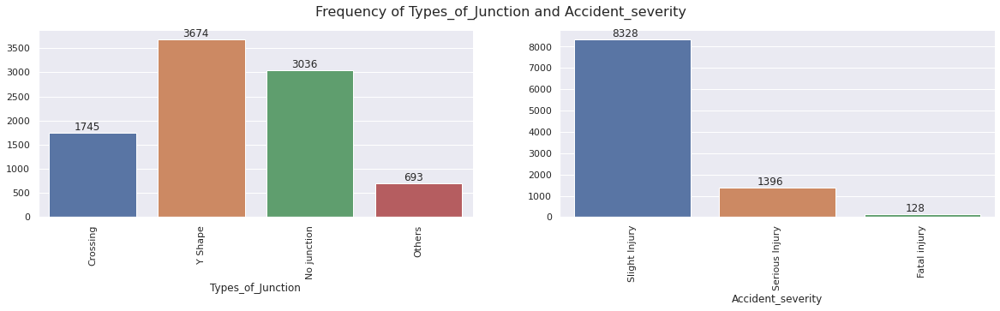


Showing Frequency Comparison of Types_of_Junction vs Accident_severity



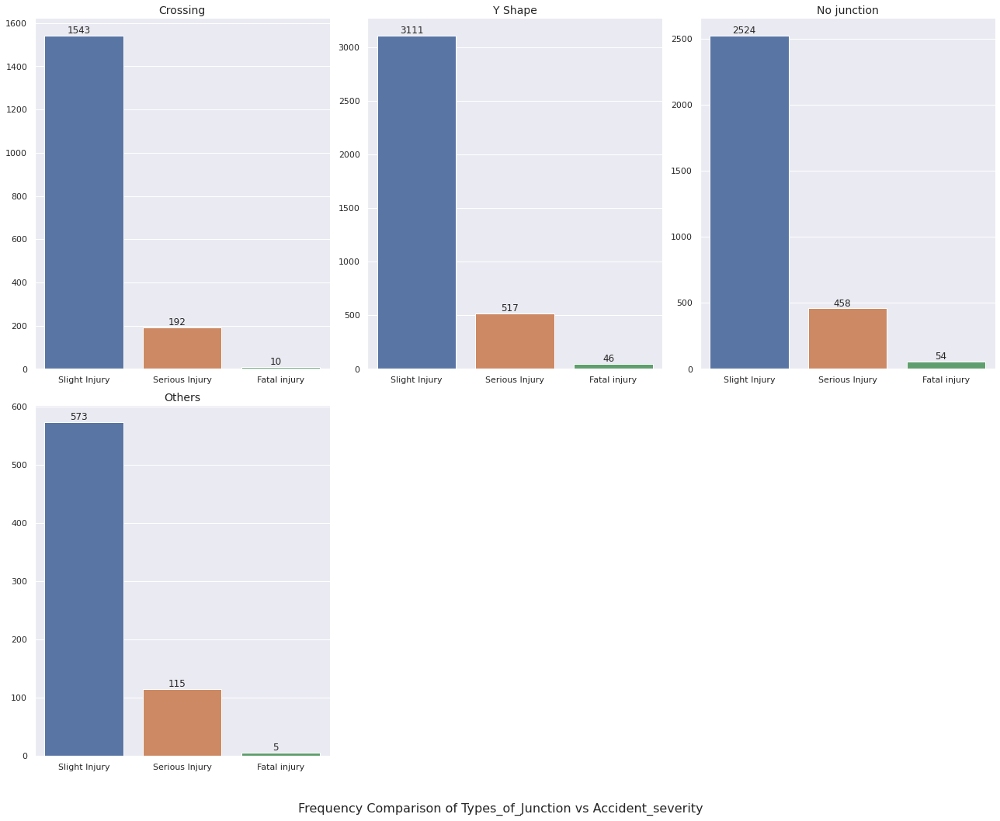

In [ ]:
# Checking count plot of Types_of_Junction
column_barplot(df, "Types_of_Junction", target_col, importance=2)

In [ ]:
df.Types_of_Junction.value_counts()

Y Shape        3674
No junction    3036
Crossing       1745
Others          693
Name: Types_of_Junction, dtype: int64

In [ ]:
df.Types_of_Junction.unique()

array(['Crossing', 'Y Shape', 'No junction', 'Others', nan], dtype=object)

In [ ]:
df = missing_value_fillup_1(df, "Types_of_Junction", ['No junction', 'Y Shape'], "Accident_severity")
df.Types_of_Junction.value_counts()

Y Shape        4054
No junction    3360
Crossing       1745
Others          693
Name: Types_of_Junction, dtype: int64

In [ ]:
# Rechecking na counts
na_count_table(df)

,column,na_count,ratio (in persentage)


Let's check unique values of each column

In [ ]:
uniques(df, 20)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Area_accident_occured,...,Number_of_casualties,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 44.11%,Monday: 13.68%,31-50: 32.92%,Male: 92.84%,Junior high school: 66.05%,Employee: 83.02%,1-2yr: 15.66%,Automobile: 31.01%,Owner: 88.68%,Office areas: 27.64%,...,1: 67.96%,Going straight: 68.72%,Pedestrian: 13.15%,Female: 21.33%,18-30: 25.57%,3: 57.64%,Driver: 66.82%,Not a Pedestrian: 92.63%,No distancing: 18.36%,Slight Injury: 84.53%
1,Morning: 31.73%,Wednesday: 15.28%,18-30: 35.07%,Female: 5.71%,Others: 33.95%,Others: 16.98%,Below 1yr: 11.76%,Long lorry: 3.10%,Others: 11.32%,Others: 55.28%,...,2: 18.86%,Moving Backward: 8.01%,na: 36.00%,na: 36.00%,na: 36.00%,na: 36.00%,Self-employed: 23.58%,Possibly Pedestrian: 7.37%,Changing lane to the left: 12.00%,Serious Injury: 14.17%
2,Evening: 17.09%,Saturday: 13.52%,Under 18: 6.74%,Unknown: 1.44%,NaN,NaN,Above 10yr: 19.70%,Others: 13.45%,NaN,Residential areas: 17.08%,...,4: 3.23%,Reversing: 4.70%,Driver or rider: 40.38%,Male: 42.67%,Under 18: 8.16%,2: 6.16%,Others: 5.02%,NaN,Overturning: 1.14%,Fatal injury: 1.30%
3,Night: 7.06%,Friday: 16.54%,Unknown: 12.62%,NaN,NaN,NaN,5-10yr: 29.24%,Lorry (41?100Q): 20.49%,NaN,NaN,...,3: 7.37%,Others: 11.85%,Passenger: 10.46%,NaN,31-50: 20.03%,1: 0.19%,Employee: 4.58%,NaN,Changing lane to the right: 14.80%,NaN
4,NaN,Tuesday: 14.27%,Over 51: 12.66%,NaN,NaN,NaN,2-5yr: 22.66%,Stationwagen: 5.43%,NaN,NaN,...,5: 1.64%,Turnover: 3.91%,NaN,NaN,Over 51: 8.21%,NaN,NaN,NaN,Driving carelessly: 11.52%,NaN
5,NaN,Sunday: 12.01%,NaN,NaN,NaN,NaN,No Licence: 0.97%,Lorry (11?40Q): 4.40%,NaN,NaN,...,6: 0.66%,Getting off: 2.82%,NaN,NaN,5: 2.03%,NaN,NaN,NaN,No priority to vehicle: 9.87%,NaN
6,NaN,Thursday: 14.70%,NaN,NaN,NaN,NaN,NaN,Public (12 seats): 5.86%,NaN,NaN,...,7: 0.20%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Moving Backward: 9.21%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.14%,NaN,NaN,...,8: 0.08%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to pedestrian: 5.63%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Public (13?45 seats): 4.18%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Other: 3.70%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.66%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Overtaking: 3.46%,NaN


* We can see that there are still some "Unknown" or "na" which do not makes sense the data. Following columns are still effected by this:
    1. Age_band_of_driver contains 12.57% "Unknown"
    2. Sex_of_driver contains 1.45% "Unknown"
    3. Casualty_class contains 36.08% "na"
    4. Sex_of_casualty contains 36.08% "na"
    5. Age_band_of_casualty contains 36.08% "na"
    6. Casualty_severity contains 36.08% "na"
    7. Cause_of_accident contains 0.20% "Unknown"

* Persentages of "na" in 3, 4, 5, 6 is very high. So, for now, we are removing these columns. We can work on these in later stage.

* Since Sex_of_driver and Cause_of_accident contain very low number of "Unknown", we will be replacing be mode for now.

* Finally we need to investigate on column Age_band_of_driver.

In [ ]:
df.drop("Casualty_class", axis=1, inplace=True)

In [ ]:
df.drop("Sex_of_casualty", axis=1, inplace=True)

In [ ]:
df.drop("Age_band_of_casualty", axis=1, inplace=True)

In [ ]:
df.drop("Casualty_severity", axis=1, inplace=True)

Showing Frequency Plots here for Sex_of_driver:



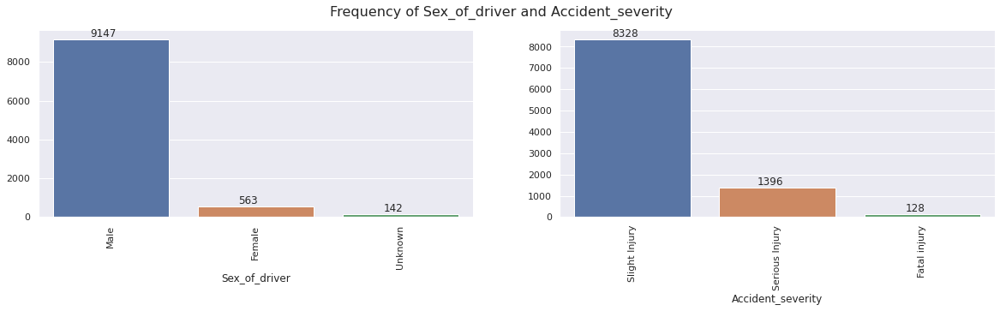

In [ ]:
column_barplot(df, "Sex_of_driver", target_col, importance=1)

In [ ]:
df.Sex_of_driver.unique()

array(['Male', 'Female', 'Unknown'], dtype=object)

In [ ]:
# replacing "Unknown" with "Male"
df = convert_to_na(df, "Sex_of_driver", ["Unknown"])
df.Sex_of_driver.fillna("Male", inplace=True)

Showing Frequency Plots here for Cause_of_accident:



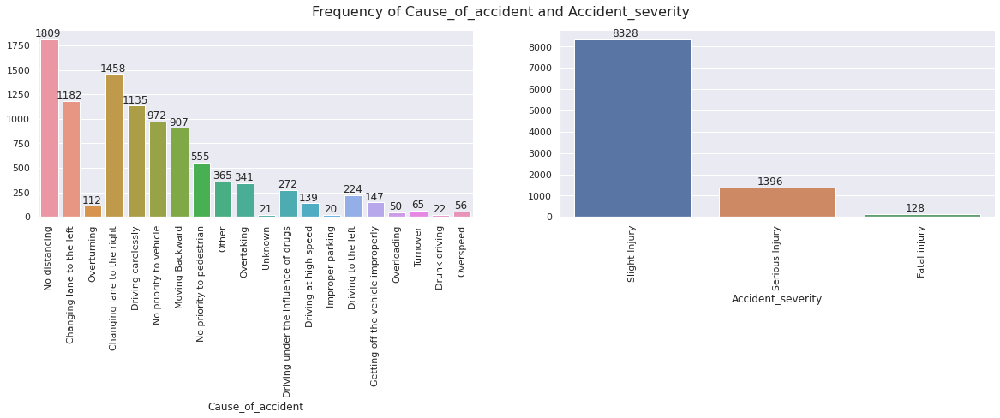

In [ ]:
column_barplot(df, "Cause_of_accident", target_col, importance=1)

In [ ]:
df.Cause_of_accident.unique()

array(['No distancing', 'Changing lane to the left', 'Overturning',
       'Changing lane to the right', 'Driving carelessly',
       'No priority to vehicle', 'Moving Backward',
       'No priority to pedestrian', 'Other', 'Overtaking', 'Unknown',
       'Driving under the influence of drugs', 'Driving at high speed',
       'Improper parking', 'Driving to the left',
       'Getting off the vehicle improperly', 'Overloading', 'Turnover',
       'Drunk driving', 'Overspeed'], dtype=object)

In [ ]:
# replacing "Unknown" with "No distancing"
df = convert_to_na(df, "Cause_of_accident", ["Unknown"])
df.Cause_of_accident.fillna("No distancing", inplace=True)

Showing Frequency Plots here for Age_band_of_driver:



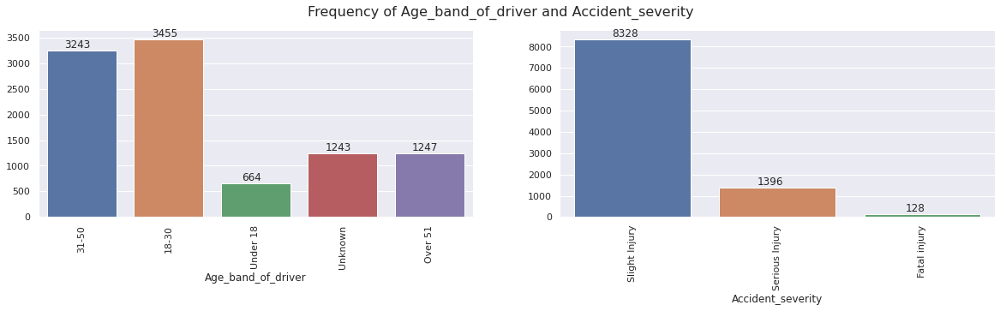

In [ ]:
column_barplot(df, "Age_band_of_driver", target_col, importance=1)

In [ ]:
df.Age_band_of_driver.unique()

array(['31-50', '18-30', 'Under 18', 'Unknown', 'Over 51'], dtype=object)

In [ ]:
df.Age_band_of_driver.value_counts()

18-30       3455
31-50       3243
Over 51     1247
Unknown     1243
Under 18     664
Name: Age_band_of_driver, dtype: int64

In [ ]:
# Distributing "Unknown" with "18-30", "31-50"
df = convert_to_na(df, "Age_band_of_driver", ["Unknown"])
df = missing_value_fillup_1(df, "Age_band_of_driver", ['18-30', '31-50'], "Accident_severity")
df.Age_band_of_driver.value_counts()

18-30       4114
31-50       3827
Over 51     1247
Under 18     664
Name: Age_band_of_driver, dtype: int64

In [ ]:
# checking the modified unique values
uniques(df, 20)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Area_accident_occured,...,Light_conditions,Weather_conditions,Type_of_collision,Number_of_vehicles_involved,Number_of_casualties,Vehicle_movement,Work_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 44.11%,Monday: 13.68%,31-50: 38.84%,Male: 94.29%,Junior high school: 66.05%,Employee: 83.02%,1-2yr: 15.66%,Automobile: 31.01%,Owner: 88.68%,Office areas: 27.64%,...,Daylight: 71.68%,Others: 18.07%,Vehicle with vehicle collision: 72.66%,2: 67.54%,1: 67.96%,Going straight: 68.72%,Driver: 66.82%,Not a Pedestrian: 92.63%,No distancing: 18.57%,Slight Injury: 84.53%
1,Morning: 31.73%,Wednesday: 15.28%,18-30: 41.76%,Female: 5.71%,Others: 33.95%,Others: 16.98%,Below 1yr: 11.76%,Long lorry: 3.10%,Others: 11.32%,Others: 55.28%,...,Darkness - lights lit: 26.46%,Normal: 81.93%,Collision with roadside objects: 14.21%,1: 16.08%,2: 18.86%,Moving Backward: 8.01%,Self-employed: 23.58%,Possibly Pedestrian: 7.37%,Changing lane to the left: 12.00%,Serious Injury: 14.17%
2,Evening: 17.09%,Saturday: 13.52%,Under 18: 6.74%,NaN,NaN,NaN,Above 10yr: 19.70%,Others: 13.45%,NaN,Residential areas: 17.08%,...,Darkness - no lighting: 1.57%,NaN,Others: 13.13%,3: 12.99%,4: 3.23%,Reversing: 4.70%,Others: 5.02%,NaN,Overturning: 1.14%,Fatal injury: 1.30%
3,Night: 7.06%,Friday: 16.54%,Over 51: 12.66%,NaN,NaN,NaN,5-10yr: 29.24%,Lorry (41?100Q): 20.49%,NaN,NaN,...,Darkness - lights unlit: 0.28%,NaN,NaN,4: 2.92%,3: 7.37%,Others: 11.85%,Employee: 4.58%,NaN,Changing lane to the right: 14.80%,NaN
4,NaN,Tuesday: 14.27%,NaN,NaN,NaN,NaN,2-5yr: 22.66%,Stationwagen: 5.43%,NaN,NaN,...,NaN,NaN,NaN,6: 0.42%,5: 1.64%,Turnover: 3.91%,NaN,NaN,Driving carelessly: 11.52%,NaN
5,NaN,Sunday: 12.01%,NaN,NaN,NaN,NaN,No Licence: 0.97%,Lorry (11?40Q): 4.40%,NaN,NaN,...,NaN,NaN,NaN,7: 0.05%,6: 0.66%,Getting off: 2.82%,NaN,NaN,No priority to vehicle: 9.87%,NaN
6,NaN,Thursday: 14.70%,NaN,NaN,NaN,NaN,NaN,Public (12 seats): 5.86%,NaN,NaN,...,NaN,NaN,NaN,NaN,7: 0.20%,NaN,NaN,NaN,Moving Backward: 9.21%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.14%,NaN,NaN,...,NaN,NaN,NaN,NaN,8: 0.08%,NaN,NaN,NaN,No priority to pedestrian: 5.63%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Public (13?45 seats): 4.18%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Other: 3.70%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.66%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Overtaking: 3.46%,NaN


In [ ]:
df_test = missing_value_imputation(df_test)

* Finally we have cleared the pain of NaN values and we can now move on to Categorical Data Encoding

#### Categorical Data Encoding

* Since all of the columns are categorical, we need to encode the catgorical data

In [ ]:
df.columns

Index(['Time_of_day', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Area_accident_occured',
       'Lanes_or_Medians', 'Road_allignment', 'Types_of_Junction',
       'Road_surface_type', 'Road_surface_conditions', 'Light_conditions',
       'Weather_conditions', 'Type_of_collision',
       'Number_of_vehicles_involved', 'Number_of_casualties',
       'Vehicle_movement', 'Work_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

In [ ]:
uniques(df, 20)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Area_accident_occured,...,Light_conditions,Weather_conditions,Type_of_collision,Number_of_vehicles_involved,Number_of_casualties,Vehicle_movement,Work_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 44.11%,Monday: 13.68%,31-50: 38.84%,Male: 94.29%,Junior high school: 66.05%,Employee: 83.02%,1-2yr: 15.66%,Automobile: 31.01%,Owner: 88.68%,Office areas: 27.64%,...,Daylight: 71.68%,Others: 18.07%,Vehicle with vehicle collision: 72.66%,2: 67.54%,1: 67.96%,Going straight: 68.72%,Driver: 66.82%,Not a Pedestrian: 92.63%,No distancing: 18.57%,Slight Injury: 84.53%
1,Morning: 31.73%,Wednesday: 15.28%,18-30: 41.76%,Female: 5.71%,Others: 33.95%,Others: 16.98%,Below 1yr: 11.76%,Long lorry: 3.10%,Others: 11.32%,Others: 55.28%,...,Darkness - lights lit: 26.46%,Normal: 81.93%,Collision with roadside objects: 14.21%,1: 16.08%,2: 18.86%,Moving Backward: 8.01%,Self-employed: 23.58%,Possibly Pedestrian: 7.37%,Changing lane to the left: 12.00%,Serious Injury: 14.17%
2,Evening: 17.09%,Saturday: 13.52%,Under 18: 6.74%,NaN,NaN,NaN,Above 10yr: 19.70%,Others: 13.45%,NaN,Residential areas: 17.08%,...,Darkness - no lighting: 1.57%,NaN,Others: 13.13%,3: 12.99%,4: 3.23%,Reversing: 4.70%,Others: 5.02%,NaN,Overturning: 1.14%,Fatal injury: 1.30%
3,Night: 7.06%,Friday: 16.54%,Over 51: 12.66%,NaN,NaN,NaN,5-10yr: 29.24%,Lorry (41?100Q): 20.49%,NaN,NaN,...,Darkness - lights unlit: 0.28%,NaN,NaN,4: 2.92%,3: 7.37%,Others: 11.85%,Employee: 4.58%,NaN,Changing lane to the right: 14.80%,NaN
4,NaN,Tuesday: 14.27%,NaN,NaN,NaN,NaN,2-5yr: 22.66%,Stationwagen: 5.43%,NaN,NaN,...,NaN,NaN,NaN,6: 0.42%,5: 1.64%,Turnover: 3.91%,NaN,NaN,Driving carelessly: 11.52%,NaN
5,NaN,Sunday: 12.01%,NaN,NaN,NaN,NaN,No Licence: 0.97%,Lorry (11?40Q): 4.40%,NaN,NaN,...,NaN,NaN,NaN,7: 0.05%,6: 0.66%,Getting off: 2.82%,NaN,NaN,No priority to vehicle: 9.87%,NaN
6,NaN,Thursday: 14.70%,NaN,NaN,NaN,NaN,NaN,Public (12 seats): 5.86%,NaN,NaN,...,NaN,NaN,NaN,NaN,7: 0.20%,NaN,NaN,NaN,Moving Backward: 9.21%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.14%,NaN,NaN,...,NaN,NaN,NaN,NaN,8: 0.08%,NaN,NaN,NaN,No priority to pedestrian: 5.63%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Public (13?45 seats): 4.18%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Other: 3.70%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.66%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Overtaking: 3.46%,NaN


* We will be doing label-encoding on following columns:
    + Age_band_of_driver, Educational_level, Driving_experience, Light_conditions, Weather_conditions, Accident_severity.
* We will be doing one-hot-encoding on following columns:
    + Time_of_day, Day_of_week, Sex_of_driver, Vehicle_driver_relation, Type_of_vehicle, Owner_of_vehicle, Area_accident_occured, Lanes_or_Medians, Road_allignment, Types_of_Junction, Road_surface_type, Road_surface_conditions, Type_of_collision, Vehicle_movement, Work_of_casuality, Pedestrian_movement, Cause_of_accident.

In [ ]:
ohe = ["Time_of_day", "Day_of_week", "Sex_of_driver", "Vehicle_driver_relation", "Type_of_vehicle", "Owner_of_vehicle", \
       "Area_accident_occured", "Lanes_or_Medians", "Road_allignment", "Types_of_Junction", "Road_surface_type", \
       "Road_surface_conditions", "Type_of_collision", "Vehicle_movement", "Work_of_casuality", "Pedestrian_movement", "Cause_of_accident"]
le = ["Age_band_of_driver", "Educational_level", "Driving_experience", "Light_conditions", "Weather_conditions", "Accident_severity"]
abod = ["Under 18", "18-30", "31-50", "Over 51"]
edl = ["Junior high school", "Others"]
dre = ["No Licence", "Below 1yr", "1-2yr", "2-5yr", "5-10yr", "Above 10yr"]
lc = ["Daylight", "Darkness - lights lit", "Darkness - lights unlit", "Darkness - no lighting"]
wc = ["Normal", "Others"]
accs = ["Slight Injury", "Serious Injury", "Fatal injury"]
le_order = [abod, edl, dre, lc, wc, accs]
df_cat = cat_data_encoding(df, target_col, ohe=ohe, le=le, le_order=le_order)

In [ ]:
df_cat.head()

,Age_band_of_driver,Educational_level,Driving_experience,Light_conditions,Weather_conditions,Number_of_vehicles_involved,Number_of_casualties,Time_of_day_Afternoon,Time_of_day_Morning,Time_of_day_Evening,...,Cause_of_accident_Overtaking,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Improper_parking,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overloading,Cause_of_accident_Drunk_driving,Cause_of_accident_Overspeed,Accident_severity
8389,3.0,1.0,3.0,1.0,2.0,2,1,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1973,3.0,1.0,2.0,1.0,1.0,2,1,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
9859,2.0,1.0,6.0,2.0,2.0,2,2,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
11850,3.0,2.0,6.0,1.0,1.0,1,2,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
7481,1.0,2.0,5.0,1.0,2.0,3,4,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
df.shape, df_cat.shape

((9852, 25), (9852, 73))

In [ ]:
df_cat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9852 entries, 8389 to 10714
Data columns (total 73 columns):
 #   Column                                                             Non-Null Count  Dtype  
---  ------                                                             --------------  -----  
 0   Age_band_of_driver                                                 9852 non-null   float64
 1   Educational_level                                                  9852 non-null   float64
 2   Driving_experience                                                 9852 non-null   float64
 3   Light_conditions                                                   9852 non-null   float64
 4   Weather_conditions                                                 9852 non-null   float64
 5   Number_of_vehicles_involved                                        9852 non-null   int64  
 6   Number_of_casualties                                               9852 non-null   int64  
 7   Time_of_day_Afternoo

In [ ]:
df_test_cat = categorical_encoding_df(df_test)

In [ ]:
df_test.shape, df_test_cat.shape

((2464, 25), (2464, 73))

#### Heatmap

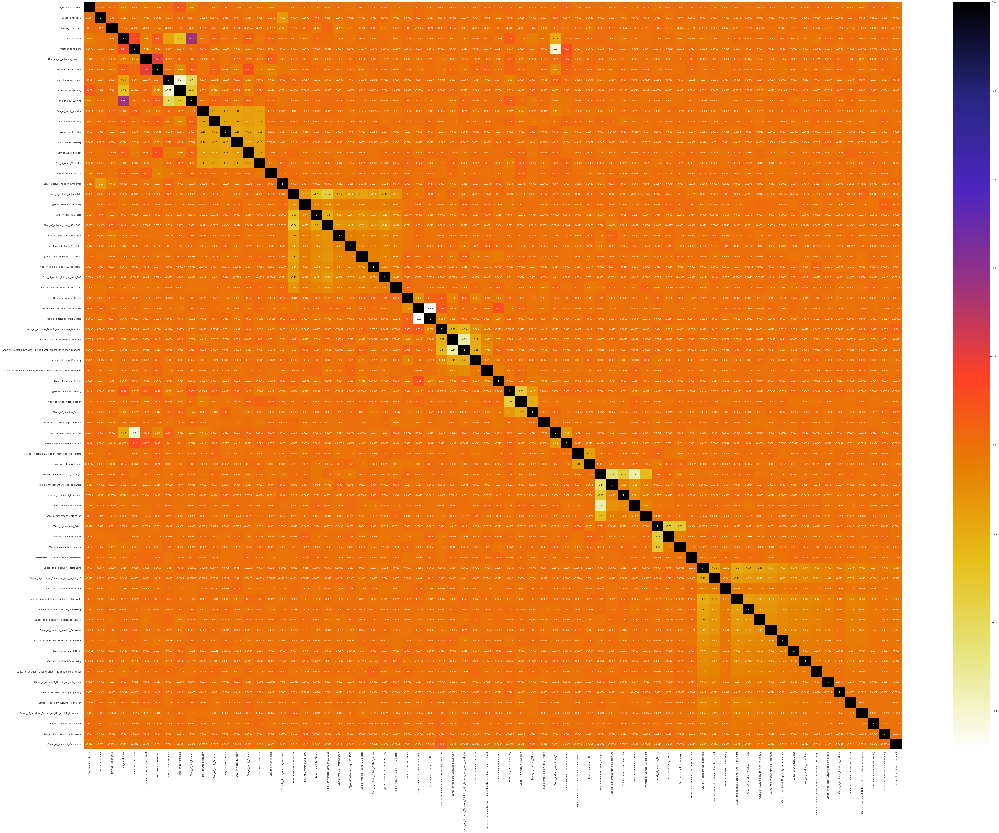

In [ ]:
# Heatmap
data_heat = df_cat.drop('Accident_severity', axis = 1)
heatmap(data_heat, (90, 90*0.75))

* Observations from Heatmap:
    1. Light_conditions vs Time_of_day_Evening (0.36), Time_of_day_Morning (-0.28), Time_of_day_Afternoon (-0.17): It seems plausible that light condition should correlated with time of day.
    2. Number_of_caualties vs Number_of_vehicles_involved (0.21): Correlation is a bit high but we will keep as it is.
    3. Light_conditions vs Weather_conditions (0.13): Correlation is a bit high but we will keep as it is.
    4. Number_of_caualties vs Day_of_week_Sunday (0.11): Correlation is a bit high but we will keep as it is.
    5. Road_allignment_Others vs Area_accident_occured_Office_areas (0.1): Correlation is a bit high but we will keep as it is.
    6. Road_surface_conditions_Dry vs Light_conditions (-0.19): Correlation is a bit high but we will keep as it is.
    7. Road_surface_conditions_Dry vs Weather_conditions (-0.61): It seems plausible that dry road surface condition should correlated with weather conditions.
    8. Road_surface_conditions_Snow vs Weather_conditions (0.12): Correlation is a bit high but we will keep as it is.
    9. Area_accident_occured_Office_areas vs Area_accident_occured_Others (-0.69): It's seems reasonable but we can look into that in more detail in next stage.

Nonetheless, since the correlations are not that much high, we are not toughing the data (or no modifications). We can fairly say that the data is ready for analysis.


## Analysis

### Initiation

In [ ]:
X_train, y_train = predictor_target_split(df_cat, target_col)
X_test, y_test = predictor_target_split(df_test_cat, target_col)
X_test = X_test.loc[:,X_train.columns]

In [ ]:
X_train.head()

,Age_band_of_driver,Educational_level,Driving_experience,Light_conditions,Weather_conditions,Number_of_vehicles_involved,Number_of_casualties,Time_of_day_Afternoon,Time_of_day_Morning,Time_of_day_Evening,...,Cause_of_accident_Other,Cause_of_accident_Overtaking,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Improper_parking,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overloading,Cause_of_accident_Drunk_driving,Cause_of_accident_Overspeed
8389,3.0,1.0,3.0,1.0,2.0,2,1,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1973,3.0,1.0,2.0,1.0,1.0,2,1,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9859,2.0,1.0,6.0,2.0,2.0,2,2,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11850,3.0,2.0,6.0,1.0,1.0,1,2,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7481,1.0,2.0,5.0,1.0,2.0,3,4,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
uniques(X_train, 8)

,Age_band_of_driver,Educational_level,Driving_experience,Light_conditions,Weather_conditions,Number_of_vehicles_involved,Number_of_casualties,Time_of_day_Afternoon,Time_of_day_Morning,Time_of_day_Evening,...,Cause_of_accident_Other,Cause_of_accident_Overtaking,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Improper_parking,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overloading,Cause_of_accident_Drunk_driving,Cause_of_accident_Overspeed
0,3.0: 38.84%,1.0: 66.05%,3.0: 15.66%,1.0: 71.68%,2.0: 18.07%,2: 67.54%,1: 67.96%,1.0: 44.11%,0.0: 68.27%,0.0: 82.91%,...,0.0: 96.30%,0.0: 96.54%,0.0: 97.24%,0.0: 98.59%,0.0: 99.80%,0.0: 97.73%,0.0: 98.51%,0.0: 99.49%,0.0: 99.78%,0.0: 99.43%
1,2.0: 41.76%,2.0: 33.95%,2.0: 11.76%,2.0: 26.46%,1.0: 81.93%,1: 16.08%,2: 18.86%,0.0: 55.89%,1.0: 31.73%,1.0: 17.09%,...,1.0: 3.70%,1.0: 3.46%,1.0: 2.76%,1.0: 1.41%,1.0: 0.20%,1.0: 2.27%,1.0: 1.49%,1.0: 0.51%,1.0: 0.22%,1.0: 0.57%
2,1.0: 6.74%,NaN,6.0: 19.70%,4.0: 1.57%,NaN,3: 12.99%,4: 3.23%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4.0: 12.66%,NaN,5.0: 29.24%,3.0: 0.28%,NaN,4: 2.92%,3: 7.37%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,4.0: 22.66%,NaN,NaN,6: 0.42%,5: 1.64%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,1.0: 0.97%,NaN,NaN,7: 0.05%,6: 0.66%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,7: 0.20%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,8: 0.08%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### General function

In [ ]:
# Computation of confusion matrix
def conf_mat(y_pred, y_test):
    class_names = ['Slight', 'Serious', 'Fatal']
    tick_marks_y = [0.5, 1.5, 2.5]
    tick_marks_x = [0.5, 1.5, 2.5]
    confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
    confusion_matrix_df = pd.DataFrame(confusion_matrix, range(3), range(3))
    plt.figure(figsize = (6, 4.75))
    sns.set(font_scale = 1.4) # label size
    plt.title("Confusion Matrix")
    sns.heatmap(confusion_matrix_df, annot = True, annot_kws = {"size": 16}, fmt = 'd') # font size
    plt.yticks(tick_marks_y, class_names, rotation = 'vertical')
    plt.xticks(tick_marks_x, class_names, rotation = 'horizontal')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.grid(False)
    plt.show()

#### Baseline Model

In [ ]:
# Summary dictionary initialization
f1_dict = {}

1. Decision Tree:-

Weighted F1-score on the test set: 0.7604183925535868


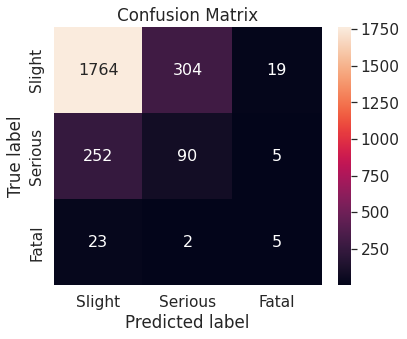

In [ ]:
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
score = f1_score(y_test, y_pred, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict['Decision Tree'] = score
conf_mat(y_pred, y_test)

2. Random Forest:-

Weighted F1-score on the test set: 0.7930884475384008


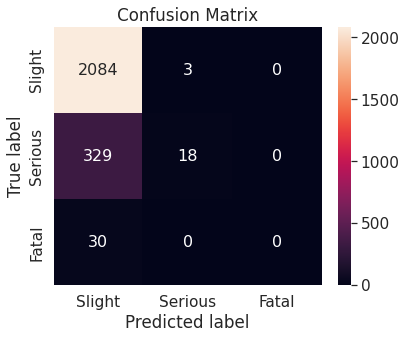

In [ ]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
score = f1_score(y_test, y_pred, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict['Random Forest'] = score
conf_mat(y_pred, y_test)

3. XGBoost Classifier:-

Weighted F1-score on the test set: 0.7931192908321378


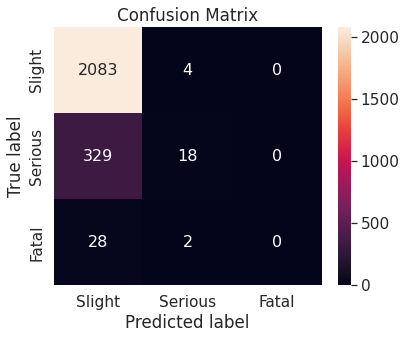

In [ ]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)
y_pred = xgb.predict(X_test)
score = f1_score(y_test, y_pred, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict['XGBoost'] = score
conf_mat(y_pred, y_test)

ExtraTress Classifier:-

Weighted F1-score on the test set: 0.7876176250863833


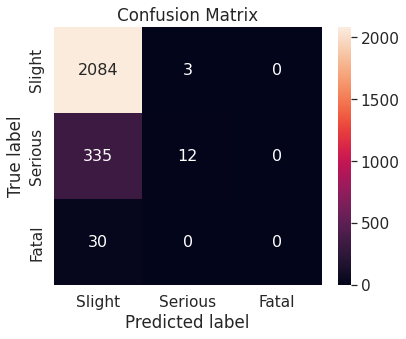

In [ ]:
extree = ExtraTreesClassifier()
extree.fit(X_train, y_train)
y_pred = extree.predict(X_test)
score = f1_score(y_test, y_pred, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict['ExtraTrees'] = score
conf_mat(y_pred, y_test)

In [ ]:
# Summary dataframe
f1_df = pd.DataFrame(f1_dict.items(), columns = ['Classifier', 'F1-score'])
f1_df.sort_values(by = ['F1-score'], ascending = False)

,Classifier,F1-score
2,XGBoost,0.793119
1,Random Forest,0.793088
3,ExtraTrees,0.787618
0,Decision Tree,0.760418


#### Hyperparameter Tuning

In [ ]:
# Summary dictionary initialization
f1_dict_ht = {}

Random Forest:-

Fitting 5 folds for each of 96 candidates, totalling 480 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'n_estimators': 100, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7708496432499867


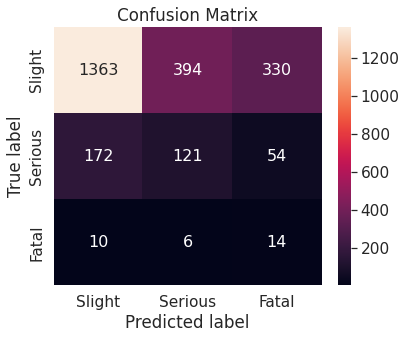

CPU times: user 6.28 s, sys: 504 ms, total: 6.79 s
Wall time: 2min 58s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [100, 200],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'class_weight': ['balanced', None],
          'random_state': [20],
          'bootstrap': [True, False]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 192 candidates, totalling 960 fits
Best parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'max_leaf_nodes': 2, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 20, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7530096251245154


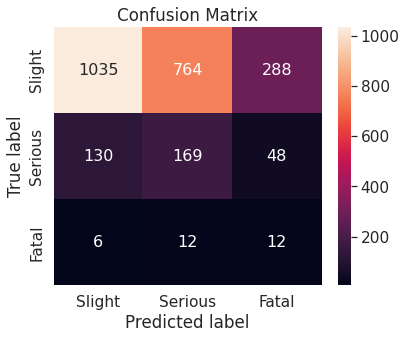

CPU times: user 5.92 s, sys: 336 ms, total: 6.26 s
Wall time: 1min 14s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [20, 40],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'max_leaf_nodes': [2, 4],
          'min_weight_fraction_leaf': [0.0],
          'min_samples_split': [2, 4],
          'class_weight': ['balanced', None],
          'ccp_alpha': [0.0],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_1'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
Best parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'max_leaf_nodes': 2, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 5, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.6637853755976901


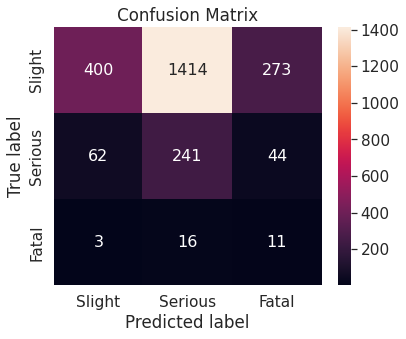

CPU times: user 5.66 s, sys: 374 ms, total: 6.03 s
Wall time: 53.5 s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [5, 10, 20],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'max_leaf_nodes': [2, 4],
          'min_weight_fraction_leaf': [0.0],
          'min_samples_split': [2, 4],
          'class_weight': ['balanced', None],
          'ccp_alpha': [0.0],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_2'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 96 candidates, totalling 480 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 200, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7716460643880136


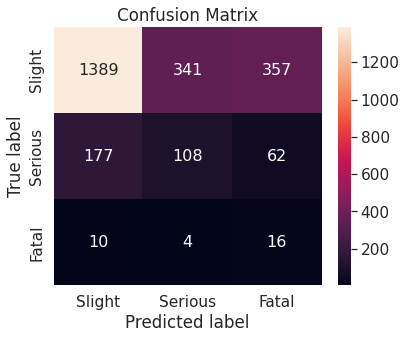

CPU times: user 8.57 s, sys: 607 ms, total: 9.17 s
Wall time: 7min 45s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [200, 400],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'class_weight': ['balanced', 'balanced_subsample'],
          'min_samples_split': [2, 4],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_3'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 400, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.773059012643275


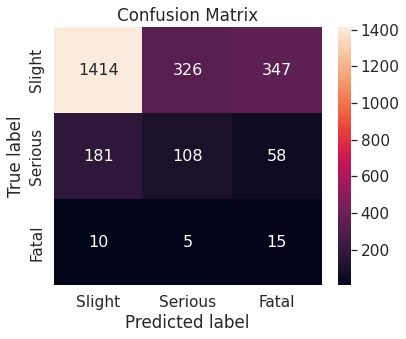

CPU times: user 7.49 s, sys: 458 ms, total: 7.94 s
Wall time: 5min 13s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [400],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'class_weight': ['balanced', 'balanced_subsample'],
          'min_samples_split': [2, 4],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_4'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 800, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.771139684613584


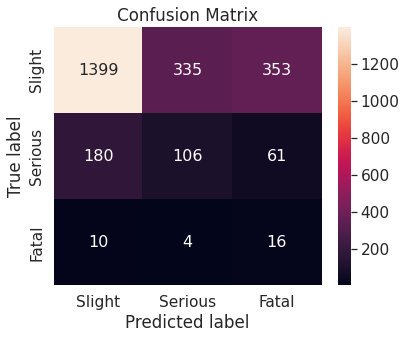

CPU times: user 11.1 s, sys: 586 ms, total: 11.7 s
Wall time: 10min 15s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [800],
          'criterion': ['gini', 'entropy'],
          'max_depth': [2, 4],
          'max_features': ['auto', 'sqrt', 'log2'],
          'class_weight': ['balanced', 'balanced_subsample'],
          'min_samples_split': [2, 4],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_5'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 80, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7644477631791786


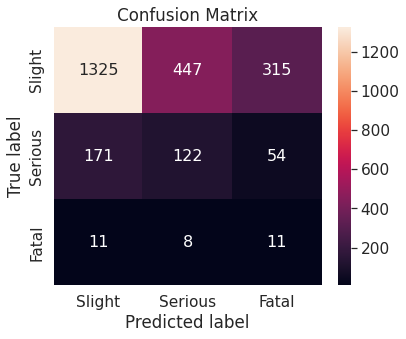

CPU times: user 1.04 s, sys: 133 ms, total: 1.17 s
Wall time: 5.16 s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [80],
          'criterion': ['gini'],
          'max_depth': [2, 4],
          'max_features': ['auto'],
          'class_weight': ['balanced'],
          'min_samples_split': [2, 4],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_6'] = score
conf_mat(y_pred_rf, y_test)

Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best parameters: {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 40, 'random_state': 20}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7616558670570919


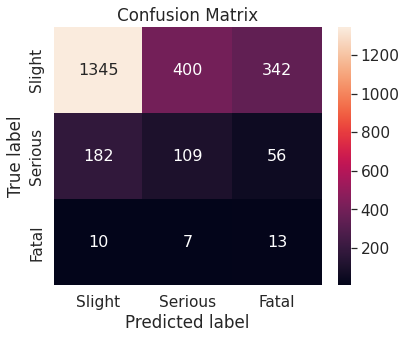

CPU times: user 776 ms, sys: 117 ms, total: 893 ms
Wall time: 3.01 s


In [ ]:
# Hyperparameter tuning for Random Forest
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
rf = RandomForestClassifier()
params_rf = {'n_estimators': [40],
          'criterion': ['gini'],
          'max_depth': [2, 4],
          'max_features': ['auto'],
          'class_weight': ['balanced'],
          'min_samples_split': [2, 4],
          'random_state': [20],
          'bootstrap': [True]
          }
gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_rf.best_params_))
print("Best weighted F1-score: {}".format(gsearch_rf.best_score_))
print(" ")

# Random Forest model evaluation on the test set
rf_best = gsearch_rf.best_estimator_
rf_best.fit(X_train, y_train)
y_pred_rf = rf_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['Random Forest_7'] = score
conf_mat(y_pred_rf, y_test)

In [ ]:
x = rf_best.predict(X_train)
x = metrics.fbeta_score(y_train, x, beta=0.2, average = 'weighted')
print(x)

0.7672126470874164


ExtraTrees Classifier:-

Fitting 3 folds for each of 24 candidates, totalling 72 fits
Best parameters: {'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'min_samples_split': 2}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7366419449622873


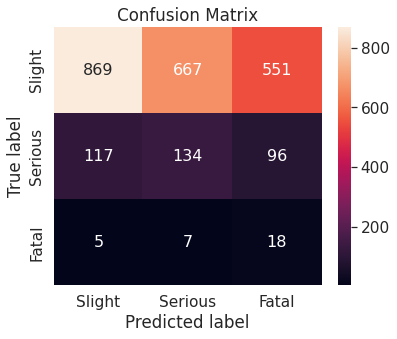

In [ ]:
# Hyperparameter tuning for ExtraTrees
cv = KFold(n_splits = 3, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
extree = ExtraTreesClassifier()
params_extree = {'criterion': ['gini', 'entropy'],
              'max_depth': [2, 4],
              'min_samples_split': [2, 4, 6],
              'ccp_alpha': [0.0, 0.5],
              'class_weight': ['balanced']
              }
gsearch_extree = GridSearchCV(estimator = extree, param_grid = params_extree, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 3)
gsearch_extree_fit = gsearch_extree.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_extree.best_params_))
print("Best weighted F1-score: {}".format(gsearch_extree.best_score_))
print(" ")

# ExtraTress model evaluation on the test set
extree_best = gsearch_extree.best_estimator_
extree_best.fit(X_train, y_train)
y_pred_extree = extree_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_extree, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['ExtraTrees'] = score
conf_mat(y_pred_extree, y_test)

Fitting 5 folds for each of 192 candidates, totalling 960 fits
Best parameters: {'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'min_samples_split': 2, 'n_estimators': 100}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7376185359785704


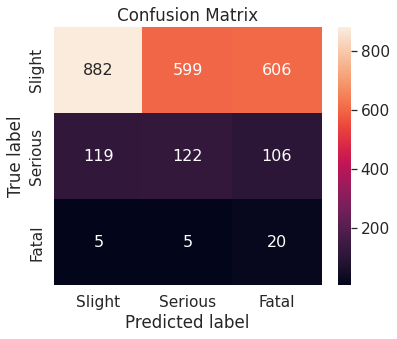

CPU times: user 12.2 s, sys: 784 ms, total: 12.9 s
Wall time: 8min 3s


In [ ]:
# Hyperparameter tuning for ExtraTrees
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
extree = ExtraTreesClassifier()
params_extree = {'n_estimators': [100, 200],
                 'criterion': ['gini', 'entropy'],
              'max_depth': [2, 4, 6, 8],
              'min_samples_split': [2, 4, 6],
              'ccp_alpha': [0.0, 0.5],
              'class_weight': ['balanced', 'balanced_subsample']
              }
gsearch_extree = GridSearchCV(estimator = extree, param_grid = params_extree, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 3)
gsearch_extree_fit = gsearch_extree.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_extree.best_params_))
print("Best weighted F1-score: {}".format(gsearch_extree.best_score_))
print(" ")

# ExtraTress model evaluation on the test set
extree_best = gsearch_extree.best_estimator_
extree_best.fit(X_train, y_train)
y_pred_extree = extree_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_extree, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['ExtraTrees_1'] = score
conf_mat(y_pred_extree, y_test)

Fitting 5 folds for each of 144 candidates, totalling 720 fits
Best parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 50}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7491392549833216


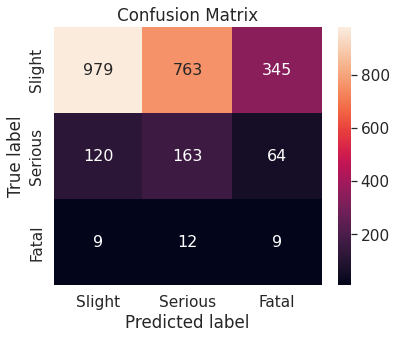

CPU times: user 7.79 s, sys: 517 ms, total: 8.31 s
Wall time: 2min 14s


In [ ]:
# Hyperparameter tuning for ExtraTrees
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
extree = ExtraTreesClassifier()
params_extree = {'n_estimators': [50, 70, 100],
                 'criterion': ['gini', 'entropy'],
              'max_depth': [2, 4],
              'min_samples_split': [2, 4],
              'ccp_alpha': [0.0],
              'max_features': ['auto', 'sqrt', 'log2'],
              'class_weight': ['balanced'],
              'bootstrap': [True, False]
              }
gsearch_extree = GridSearchCV(estimator = extree, param_grid = params_extree, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 3)
gsearch_extree_fit = gsearch_extree.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_extree.best_params_))
print("Best weighted F1-score: {}".format(gsearch_extree.best_score_))
print(" ")

# ExtraTress model evaluation on the test set
extree_best = gsearch_extree.best_estimator_
extree_best.fit(X_train, y_train)
y_pred_extree = extree_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_extree, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['ExtraTrees_2'] = score
conf_mat(y_pred_extree, y_test)

Fitting 5 folds for each of 36 candidates, totalling 180 fits
Best parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced', 'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto', 'min_samples_split': 2, 'n_estimators': 2}
Best weighted F1-score: nan
 
Weighted F1-score on the test set: 0.7374996278668318


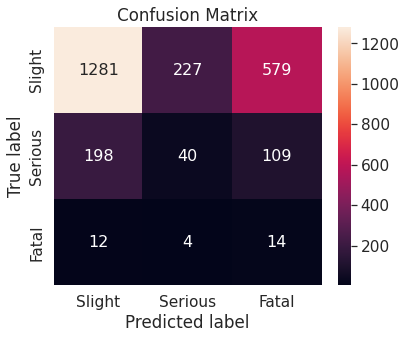

CPU times: user 1.01 s, sys: 139 ms, total: 1.14 s
Wall time: 3.95 s


In [ ]:
# Hyperparameter tuning for ExtraTrees
%%time
cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
extree = ExtraTreesClassifier()
params_extree = {'n_estimators': [2, 3, 4],
                 'criterion': ['gini'],
              'max_depth': [2, 4],
              'min_samples_split': [2, 4],
              'ccp_alpha': [0.0,0.1, 0.2],
              'max_features': ['auto'],
              'class_weight': ['balanced'],
              'bootstrap': [True]
              }
gsearch_extree = GridSearchCV(estimator = extree, param_grid = params_extree, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 3)
gsearch_extree_fit = gsearch_extree.fit(X = X_train, y = y_train)
print("Best parameters: {}".format(gsearch_extree.best_params_))
print("Best weighted F1-score: {}".format(gsearch_extree.best_score_))
print(" ")

# ExtraTress model evaluation on the test set
extree_best = gsearch_extree.best_estimator_
extree_best.fit(X_train, y_train)
y_pred_extree = extree_best.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred_extree, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
f1_dict_ht['ExtraTrees_3'] = score
conf_mat(y_pred_extree, y_test)

In [ ]:
x = extree_best.predict(X_train)
x = metrics.fbeta_score(y_train, x, beta=0.2, average = 'weighted')
print(x)

0.733439232914955


In [ ]:
# Summary dataframe
f1_df_ht = pd.DataFrame(f1_dict_ht.items(), columns = ['Classifier', 'F1-score'])
f1_df_ht.sort_values(by = ['F1-score'], ascending = False)

,Classifier,F1-score
4,Random Forest_4,0.773059
3,Random Forest_3,0.771646
5,Random Forest_5,0.771140
0,Random Forest,0.770850
6,Random Forest_6,0.764448
7,Random Forest_7,0.761656
1,Random Forest_1,0.753010
10,ExtraTrees_2,0.749139
9,ExtraTrees_1,0.737619
11,ExtraTrees_3,0.737500


* We can see that Random Forest is working better than Extra Trees. In this hyper parametric tuning some simple things to note:
    1. The best model of each grid search is taking the lowest value of n_estimator but it actually underestimating the Slight category.
    2. Also the F value is getting lower althogh the model parameters are same except the n_estimator.

We can play with the n_estimator a little bit!

In [ ]:
d = {"n_estimator": [], "F-beta-score": []}
for i in range(20):
    cv = KFold(n_splits = 5, shuffle = True, random_state = 20).split(X = X_train, y = y_train)
    rf = RandomForestClassifier()
    params_rf = {'n_estimators': [5 * (i + 1)],
            'criterion': ['gini'],
            'max_depth': [2, 4],
            'max_features': ['auto'],
            'class_weight': ['balanced', 'balanced_subsample'],
            'min_samples_split': [2, 4],
            'random_state': [20],
            'bootstrap': [True]
          }
    gsearch_rf = GridSearchCV(estimator = rf, param_grid = params_rf, scoring = metrics.fbeta_score, n_jobs = -1, cv = cv, verbose = 10)
    gsearch_rf_fit = gsearch_rf.fit(X = X_train, y = y_train)

    rf_best = gsearch_rf.best_estimator_
    rf_best.fit(X_train, y_train)
    y_pred_rf = rf_best.predict(X_test)
    score = metrics.fbeta_score(y_test, y_pred_rf, beta=0.2, average = 'weighted')
    
    d["n_estimator"].append(5 * (i + 1))
    d["F-beta-score"].append(score)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates

In [ ]:
rn_fst_20 = pd.DataFrame(d)

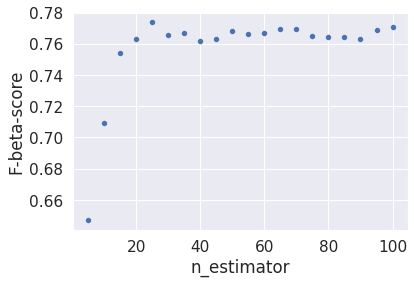

In [ ]:
sns.scatterplot(x=rn_fst_20["n_estimator"], y=rn_fst_20["F-beta-score"])

In [ ]:
rn_fst_20.iloc[:6]

,n_estimator,F-beta-score
0,5,0.647051
1,10,0.709097
2,15,0.753932
3,20,0.763186
4,25,0.773681
5,30,0.765695


We can see that 25 numbers of trees giving optimal F-beta score. So for analysis onwards, we will stick to 20 to 30 as n_estimator.

### Decisions

After the analysis, we can reach up to roughly 77% accuracy score. In next stage, we can improve it more. We have not used many classifiers here. e can start using those in next stage.

## Final Thoughts

Following things we can inprove in next stage:
* We can reduce the number of categories of Type_of_vehicle, Cause_of_accident using correlation matrix.
* We can change Number_of_vehicle_involved, Number_of_casualties to float.
* Filling NaN in Cause_of_accident can be improved.
* We can change every column to one-hot-encoding to see if that improve the analysis.
* We can see that Categories of Area_accident_occured are very correlated. We can increase the categories moving from "Others".
* In this stage we have not reduce number of columns. We can implement that by using multicolinearity etc.
* We can use custom F-score to optimize the grid search.
* We can use more advansed classifiers to see if Random Forest is giving benchmark.

********************************************************************************************

# Stage 2

In this stage we will apply the drawbacks and improvements we mentioned before:

* We can reduce the number of categories of Type_of_vehicle, Cause_of_accident using correlation matrix.
* We can change Number_of_vehicle_involved, Number_of_casualties to float.
* Filling NaN in Cause_of_accident can be improved.
* We can change every column to one-hot-encoding to see if that improve the analysis.
* We can see that Categories of Area_accident_occured are very correlated. We can increase the categories moving from "Others".
* In this stage we have not reduce number of columns. We can implement that by using chi square etc.
* We can use custom F-score to optimize the grid search.
* We can use more advansed classifiers to see if Random Forest is giving benchmark.

## Let's start!

#### Paramters

In [3]:
chi_alpha = 0.05

## General Functions

### All purpose use

In [4]:
def format_float(x):
    return "{:.2f}".format(x)

def uniques(df, max_unique_values=20):
    '''
    This function returns a dataframe with unique value of each
    categorical column along with persentages of each categories.
    Input: Pandas DataFrame, max number of unique values should contain
           so that the the column quilifies as categorical data
    Output: Columns with unique values with ratio (in persentage)
    packages required: pandas, numpy
    '''
    column_list = df.columns
    df_len = len(df)
    req_col_list = []
    for column in column_list:
        x = len(df[column].unique())
        if x <= max_unique_values:
            req_col_list.append(column)
    df = df[req_col_list]
    d = {}
    for col in req_col_list:
        d[col] = []
        l = list(df[col].unique())
        if np.nan in l:
            l.remove(np.nan)
        col_value_counts = ((df[col].value_counts())/df_len) * 100
        for x in l:
            d[col].append(str(x) + ": " + str(format_float(col_value_counts[x])) + "%")
        if len(d[col]) < max_unique_values:
            d[col].extend([np.nan] * (max_unique_values - len(d[col])))

    df_uniques = pd.DataFrame(d)
    return df_uniques

def add_annotations(ax):
    '''
    Assign annotation to bar plot
    '''
    for p in ax.patches:
        frequency = p.get_height()
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_y() + p.get_height()
        ax.annotate(f'{frequency}', (x, y), size = 12, ha = 'center', va = 'bottom')

def column_barplot(df, column, target_col, top_fig_size=(20, 4), importance=2):
    '''
    This function give barplots for a cloumn along with th target column.
    In addition to that, it shows the relation between the column and the target column with barplot.
    Input: DataFrame, column with which you want to compare the target column, target column,
           figure size of main (first two) plots, importance which specifies if you want
           only top plot(1) or every plot.
    Output: Plots (no return)
    '''
    print("Showing Frequency Plots here for {}:\n".format(column))
    plt.figure(figsize = top_fig_size)
    ax_col = plt.subplot(1, 2, 1)
    count = sns.countplot(x = df[column])
    ax_col.set_xticklabels(labels = ax_col.get_xticklabels(), rotation = 90)
    ax_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_col)
    ax_target_col = plt.subplot(1, 2, 2)
    count = sns.countplot(x = df[target_col])
    ax_target_col.set_xticklabels(labels = ax_target_col.get_xticklabels(), rotation = 90)
    ax_target_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_target_col)
    plt.suptitle("Frequency of {} and {}".format(column, target_col), fontsize = 16)
    if importance == 1:
        plt.show()
    else:
        plt.show()

        print("\nShowing Frequency Comparison of {} vs {}\n".format(column, target_col))
        plt.figure(figsize = (18, 14))
        elements = list(df[column].unique())
        target_els = list(df[target_col].unique())
        if np.nan in elements:
            elements.remove(np.nan)
        l = len(elements)
        d = int(l / 3) + 1

        for i in range(l):
            ax = plt.subplot(d, 3, i+1)
            sub_df = df[df[column] == elements[i]]
            count = sns.countplot(x = sub_df[target_col], order=target_els)
            ax.set_title(str(elements[i]), fontsize=14)
            ax.set_xlabel('')
            ax.set_ylabel('')
            sns.despine(top = True, right = True)
            add_annotations(ax)
        plt.tight_layout()
        plt.suptitle("Frequency Comparison of {} vs {}".format(column, target_col), y=-0.03, fontsize = 16)
        plt.show()
    print("\n\n")

def na_count_table(df, show_missing_only=True):
    d = {"column": [], "na_count": [], "ratio (in persentage)": [], "is_missing": []}
    l = len(df)
    for col in df.columns:
        d["column"].append(col)
        d["na_count"].append(df[col].isna().sum())
        d["is_missing"].append(True if df[col].isna().sum() > 0 else False)
        d["ratio (in persentage)"].append(float(format_float((df[col].isna().sum() * 100) / l)))
    df_ = pd.DataFrame(d)
    if show_missing_only:
        return df_[df_.is_missing == True].drop("is_missing", axis=1)
    else:
        return df_.drop("is_missing", axis=1)

def missing_value_fillup_1(df, missed_col, fill_cats, target_col):
    df_ = df.copy()
    l = []
    for cat in fill_cats:
        df__ = df_[df_[missed_col] == cat]
        df__.drop(missed_col, axis=1, inplace=True)
        l.append(df__)
    final_values = []
    for df__ in l:
        x = []
        cols = [col for col in df__.columns if col is not target_col]
        for col in cols:
            x.append(max(df__[col].value_counts().to_dict().values()))
        final_values.append(int(sum(x) / len(x)))
    del df__
    missed_values = [x / sum(final_values) for x in final_values]
    df_["temp_col"] = df_[missed_col].apply(lambda x: True if x is np.nan else False)
    df_[missed_col] = df_.apply(lambda x: np.random.choice(fill_cats, p=missed_values) if x["temp_col"] else x[missed_col], axis=1)
    df_.drop("temp_col", axis=1, inplace=True)
    return df_

def convert_to_na(df, col, cats):
    df_ = df.copy()
    for cat in cats:
        assert cat in df_[col].unique(), f"Category {cat} is not in column {col}"
        df_[col] = df_[col].apply(lambda x: np.nan if x == cat else x)
    return df_

def cat_data_encoding(df, target_col, ohe=None, le=None, le_order=None):
    '''
    This function encode all column provided in the function arguments.
    The takes dataframe, target column, to be one-hot-encoded columns as 
    list, to be label-encoded columns as list and a list of lists which 
    contain the order of categories in  to be label-encoded columns.
    Note that the order should contain very categories of a column to
    be label-encoded. It also moves the target column to last. You 
    need to have each category as strings. Returns the modified
    dataframe.
    '''
    df_ = df.copy()
    assert target_col not in ohe, "Target column should not be label encoded"
    # one-hot-encoding
    if ohe is not None:
        for col in ohe:
            cats = list(df_[col].unique())
            assert np.nan not in cats, f"Remove NaN from column {col}"
            for cat in cats:
                df_[col + "_" + "_".join(cat.split(" "))] = df_[col].apply(lambda x: 1.0 if x == cat else 0)
            df_.drop(col, axis=1, inplace=True)
            df_.drop(sorted([col + "_" + "_".join(f.split(" ")) for f in cats])[-1], axis=1, inplace=True)
    # label-encoding
    if le is not None:
        assert len(le) == len(le_order), "Length of label encoding column and label encoding column order is not same."
        for i in range(len(le)):
            cats = list(df_[le[i]].unique())
            assert np.nan not in cats, f"Remove NaN from column {le[i]}"
            assert sorted(le_order[i]) == sorted(cats), f"The category order of column {le[i]} missing something..."
            d = {}
            idx = 1.0
            for cat in le_order[i]:
                d[cat] = idx
                idx += 1.0
            df_[le[i]] = df_[le[i]].map(d)
    # putting target column at the end of dataframe
    x = df_.pop(target_col)
    df_.insert(len(df_.columns), target_col, x)
    return df_

def heatmap(data, fig_size=(36, 27)):
    '''
    Generates Heatmap
    '''
    plt.figure(figsize = fig_size)
    sns.heatmap(data.corr(), annot = True, cmap = plt.cm.CMRmap_r)

def predictor_target_split(data, target):
    '''
    Splits target from main dataframe
    '''
    y = data[target] # target variable
    X = data.drop(target, axis = 1) # independent variables
    return X, y

def chi2_features_selction(df, target_col, alpha=0.05):
    X_train = df.drop(target_col, axis=1)
    y_train = df[target_col]
    values = chi2(X_train, y_train)
    d = {"stat_value": values[0], "p_value": values[1]}
    p_df = pd.DataFrame(d, index=X_train.columns).sort_values("p_value")
    p_df["Test_result"] = p_df["p_value"].apply(lambda x: "Rejected" if x < alpha else "Fails to reject")
    return p_df

### Dataframe related functions and pipeline

In [5]:
def data_cat_reduction(df):
    '''
    This function reduces the number of categories.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df = df.copy()
    d = {}
    l = [f for f in df.Educational_level.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Junior high school" else val
    df["Educational_level"] = df["Educational_level"].map(d)

    d = {}
    l = [f for f in df.Vehicle_driver_relation.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Employee" else val
    df["Vehicle_driver_relation"] = df["Vehicle_driver_relation"].map(d)

    d = {}
    l = [f for f in df.Type_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Ridden horse', 'Other', 'Bajaj', 'Turbo', 'Motorcycle', 'Special vehicle', 'Bicycle'] else val
    df["Type_of_vehicle"] = df["Type_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Owner_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val != "Owner" else val
    df["Owner_of_vehicle"] = df["Owner_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Area_accident_occured.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['  Recreational areas', ' Industrial areas', 'Other', ' Church areas', '  Market areas', 'Unknown', 'Rural village areas', ' Outside rural areas', ' Hospital areas', 'School areas', 'Rural village areasOffice areas', 'Recreational areas'] else val
    df["Area_accident_occured"] = df["Area_accident_occured"].map(d)

    d = {}
    l = [f for f in df.Road_allignment.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Tangent road with mild grade and flat terrain', 'Escarpments', 'Tangent road with rolling terrain', 'Gentle horizontal curve', 'Tangent road with mountainous terrain and', 'Steep grade downward with mountainous terrain', 'Sharp reverse curve', 'Steep grade upward with mountainous terrain'] else val
    df["Road_allignment"] = df["Road_allignment"].map(d)

    d = {}
    l = [f for f in df.Types_of_Junction.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['O Shape', 'Other', 'Unknown', 'T Shape', 'X Shape'] else val
    df["Types_of_Junction"] = df["Types_of_Junction"].map(d)

    d = {}
    l = [f for f in df.Road_surface_type.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Earth roads', 'Asphalt roads with some distress', 'Gravel roads', 'Other'] else val
    df["Road_surface_type"] = df["Road_surface_type"].map(d)

    d = {}
    l = [f for f in df.Road_surface_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Snow', 'Flood over 3cm. deep'] else val
    df["Road_surface_conditions"] = df["Road_surface_conditions"].map(d)

    d = {}
    l = [f for f in df.Weather_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Raining', 'Raining and Windy', 'Cloudy', 'Other', 'Windy', 'Snow', 'Unknown', 'Fog or mist'] else val
    df["Weather_conditions"] = df["Weather_conditions"].map(d)

    d = {}
    l = [f for f in df.Type_of_collision.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Collision with roadside-parked vehicles', 'Collision with animals', 'Other', 'Rollover', 'Fall from vehicles', 'Collision with pedestrians', 'With Train', 'Unknown'] else val
    df["Type_of_collision"] = df["Type_of_collision"].map(d)

    d = {}
    l = [f for f in df.Vehicle_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['U-Turn', 'Waiting to go', 'Unknown', 'Parked', 'Stopping', 'Overtaking', 'Other', 'Entering a junction'] else val
    df["Vehicle_movement"] = df["Vehicle_movement"].map(d)

    d = {}
    l = [f for f in df.Work_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Other', 'Unemployed', 'Student', 'Unknown'] else val
    df["Work_of_casuality"] = df["Work_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Fitness_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Deaf', 'Other', 'Blind', 'NormalNormal'] else val
    df["Fitness_of_casuality"] = df["Fitness_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Pedestrian_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Possibly Pedestrian" if val in ["Crossing from driver's nearside", 'Crossing from nearside - masked by parked or statioNot a Pedestrianry vehicle', 'Unknown or other', 'Crossing from offside - masked by  parked or statioNot a Pedestrianry vehicle', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing)', 'Walking along in carriageway, back to traffic', 'Walking along in carriageway, facing traffic', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing) - masked by parked or statioNot a Pedestrianry vehicle'] else val
    df["Pedestrian_movement"] = df["Pedestrian_movement"].map(d)
    return df

def modify_time_column(df):
    '''
    This function modifies the Time column and converts it
    to categorical column.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df_ = df.copy()
    df_['Time_of_Day'] = df_.Time.apply(lambda x: int(x.split(":")[0]))
    df_.Time_of_Day = df_.Time_of_Day.apply(lambda x: "Morning" if 6 <= x <= 12 else ("Afternoon" if 12 < x <= 18 else ("Evening" if 18 < x <= 22 else "Night")))
    del df_["Time"]
    t = df_.pop("Time_of_Day")
    df_.insert(0, "Time_of_day", t)
    return df_

def cat_reduction_before_preprocess(df):
    ## Educational_level
    d = {}
    l = [f for f in df.Educational_level.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Writing & reading', 'Illiterate'] else val
    df["Educational_level"] = df["Educational_level"].map(d)
    ## Type_of_vehicle
    d = {}
    l = [f for f in df.Type_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Special vehicle', 'Ridden horse', 'Turbo', 'Bajaj', 'Bicycle'] else val
    df["Type_of_vehicle"] = df["Type_of_vehicle"].map(d)
    ## Owner_of_vehicle
    df = convert_to_na(df, "Owner_of_vehicle", ["Other"])
    ## Area_accident_occured
    d = {}
    l = [f for f in df.Area_accident_occured.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['  Market areas', 'Rural village areasOffice areas', 'Rural village areas', 'Recreational areas'] else val
    df["Area_accident_occured"] = df["Area_accident_occured"].map(d)
    ## Road_allignment
    d = {}
    l = [f for f in df.Road_allignment.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Sharp reverse curve', 'Tangent road with rolling terrain', 'Steep grade upward with mountainous terrain'] else val
    df["Road_allignment"] = df["Road_allignment"].map(d)
    ## Types_of_Junction
    d = {}
    l = [f for f in df.Types_of_Junction.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['T Shape', 'X Shape'] else val
    df["Types_of_Junction"] = df["Types_of_Junction"].map(d)
    ## Road_surface_conditions
    d = {}
    l = [f for f in df.Road_surface_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Snow', 'Flood over 3cm. deep'] else val
    df["Road_surface_conditions"] = df["Road_surface_conditions"].map(d)
    ## Light_conditions
    d = {}
    l = [f for f in df.Light_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Darkness - no lighting', 'Darkness - lights unlit'] else val
    df["Light_conditions"] = df["Light_conditions"].map(d)
    ## Weather_conditions
    d = {}
    l = [f for f in df.Weather_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Snow', 'Raining and Windy', 'Fog or mist'] else val
    df["Weather_conditions"] = df["Weather_conditions"].map(d)
    ## Type_of_collision
    d = {}
    l = [f for f in df.Type_of_collision.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Collision with roadside-parked vehicles', 'Fall from vehicles', 'Other', 'With Train'] else val
    df["Type_of_collision"] = df["Type_of_collision"].map(d)
    ## Number_of_vehicles_involved
    df["Number_of_vehicles_involved"] = df["Number_of_vehicles_involved"].astype(str)
    d = {}
    l = [f for f in df.Number_of_vehicles_involved.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['6', '7'] else val
    df["Number_of_vehicles_involved"] = df["Number_of_vehicles_involved"].map(d)
    ## Number_of_casualties
    df["Number_of_casualties"] = df["Number_of_casualties"].astype(str)
    d = {}
    l = [f for f in df.Number_of_casualties.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['6', '7', '8'] else val
    df["Number_of_casualties"] = df["Number_of_casualties"].map(d)
    ## Work_of_casuality
    d = {}
    l = [f for f in df.Work_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Student', 'Unemployed'] else val
    df["Work_of_casuality"] = df["Work_of_casuality"].map(d)
    ## Fitness_of_casuality
    d = {}
    l = [f for f in df.Fitness_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Deaf', 'Other', 'Blind', 'NormalNormal'] else val
    df["Fitness_of_casuality"] = df["Fitness_of_casuality"].map(d)
    ## Pedestrian_movement
    d = {}
    l = [f for f in df.Pedestrian_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Crossing from offside - masked by  parked or statioNot a Pedestrianry vehicle',\
                                                   'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing)',\
                                                   'Walking along in carriageway, back to traffic',\
                                                   'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing) - masked by parked or statioNot a Pedestrianry vehicle',\
                                                   'Walking along in carriageway, facing traffic'] else val
    df["Pedestrian_movement"] = df["Pedestrian_movement"].map(d)
    ## Cause_of_accident
    d = {}
    l = [f for f in df.Cause_of_accident.unique() if f is not np.nan]
    for val in l:
        d[val] = "Joined_small_samples" if val in ['Overloading', 'Overspeed', 'Improper parking', 'Drunk driving'] else val
    df["Cause_of_accident"] = df["Cause_of_accident"].map(d)

    return df


def missing_value_imputation_v2(df):
    # missing more than 20%
    ## Service_year_of_vehicle
    df.drop("Service_year_of_vehicle", axis=1, inplace=True)
    ## Defect_of_vehicle
    df.drop("Defect_of_vehicle", axis=1, inplace=True)
    ## Fitness_of_casuality
    df.drop("Fitness_of_casuality", axis=1, inplace=True)
    ## Work_of_casuality
    df.drop("Work_of_casuality", axis=1, inplace=True)

    # missing less than 5%
    ## Area_accident_occured
    df = convert_to_na(df, "Area_accident_occured", ["Unknown"])
    df = missing_value_fillup_1(df, "Area_accident_occured", ['Other', 'Office areas', 'Residential areas'], "Accident_severity")
    ## Road_allignment
    df.Road_allignment.fillna("Tangent road with flat terrain", inplace=True)
    ## Road_surface_type
    df.Road_surface_type.fillna("Asphalt roads", inplace=True)
    ## Type_of_collision
    df = convert_to_na(df, "Type_of_collision", ["Unknown"])
    df.Type_of_collision.fillna("Vehicle with vehicle collision", inplace=True)
    ## Vehicle_movement
    df = convert_to_na(df, "Vehicle_movement", ["Unknown"])
    df.Vehicle_movement.fillna("Going straight", inplace=True)
    ## Owner_of_vehicle
    df.Owner_of_vehicle.fillna("Owner", inplace=True)
    ## Lanes_or_Medians
    df = convert_to_na(df, "Lanes_or_Medians", ["Unknown"])
    df = missing_value_fillup_1(df, "Lanes_or_Medians", ['Undivided Two way', 'Two-way (divided with broken lines road marking)', 'other', 'Double carriageway (median)', 'One way'], "Accident_severity")
    ## Vehicle_driver_relation
    df = convert_to_na(df, "Vehicle_driver_relation", ["Unknown"])
    df.Vehicle_driver_relation.fillna("Employee", inplace=True)

    # missing more than 5%
    ## Education_level
    df = convert_to_na(df, "Educational_level", ["Unknown"])
    df.Educational_level.fillna("Junior high school", inplace=True)
    ## Driving_experience
    df = convert_to_na(df, "Driving_experience", ["unknown"])
    df = missing_value_fillup_1(df, "Driving_experience", ['1-2yr', 'Above 10yr', '5-10yr', '2-5yr', 'Below 1yr'], "Accident_severity")
    ## Type_of_vehicle
    df = missing_value_fillup_1(df, "Type_of_vehicle", ['Automobile', 'Lorry (41?100Q)'], "Accident_severity")
    ## Types_of_Junction
    df = convert_to_na(df, "Types_of_Junction", ["Unknown"])
    df = missing_value_fillup_1(df, "Types_of_Junction", ['No junction', 'Y Shape', 'Crossing'], "Accident_severity")

    # Remaining missings
    ## Casualty_class
    df.drop("Casualty_class", axis=1, inplace=True)
    ## Sex_of_casualty
    df.drop("Sex_of_casualty", axis=1, inplace=True)
    ## Age_band_of_casualty
    df.drop("Age_band_of_casualty", axis=1, inplace=True)
    ## Casualty_severity
    df.drop("Casualty_severity", axis=1, inplace=True)
    ## Sex_of_driver
    df = convert_to_na(df, "Sex_of_driver", ["Unknown"])
    df.Sex_of_driver.fillna("Male", inplace=True)
    ## Cause_of_accident
    df = convert_to_na(df, "Cause_of_accident", ["Unknown"])
    df.Cause_of_accident.fillna("No distancing", inplace=True)
    ## Age_band_of_driver
    df = convert_to_na(df, "Age_band_of_driver", ["Unknown"])
    df = missing_value_fillup_1(df, "Age_band_of_driver", ['18-30', '31-50'], "Accident_severity")
    return df

def categorical_encoding_df(df):
    df_ = df.copy()
    ohe = ["Time_of_day", "Day_of_week", "Sex_of_driver", "Vehicle_driver_relation", "Type_of_vehicle", "Owner_of_vehicle", \
       "Area_accident_occured", "Lanes_or_Medians", "Road_allignment", "Types_of_Junction", "Road_surface_type", \
       "Road_surface_conditions", "Type_of_collision", "Vehicle_movement", "Work_of_casuality", "Pedestrian_movement", "Cause_of_accident"]
    le = ["Age_band_of_driver", "Educational_level", "Driving_experience", "Light_conditions", "Weather_conditions", "Accident_severity"]
    abod = ["Under 18", "18-30", "31-50", "Over 51"]
    edl = ["Junior high school", "Others"]
    dre = ["No Licence", "Below 1yr", "1-2yr", "2-5yr", "5-10yr", "Above 10yr"]
    lc = ["Daylight", "Darkness - lights lit", "Darkness - lights unlit", "Darkness - no lighting"]
    wc = ["Normal", "Others"]
    accs = ["Slight Injury", "Serious Injury", "Fatal injury"]
    le_order = [abod, edl, dre, lc, wc, accs]
    df_cat = cat_data_encoding(df_, target_col, ohe=ohe, le=le, le_order=le_order)
    return df_cat

## Understanding The Data

### Re-looking at data

In [6]:
data.head()

,Time,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,17:02:00,Monday,18-30,Male,Above high school,Employee,1-2yr,Automobile,Owner,Above 10yr,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Moving Backward,Slight Injury
1,17:02:00,Monday,31-50,Male,Junior high school,Employee,Above 10yr,Public (> 45 seats),Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury
2,17:02:00,Monday,18-30,Male,Junior high school,Employee,1-2yr,Lorry (41?100Q),Owner,NaN,...,Going straight,Driver or rider,Male,31-50,3,Driver,NaN,Not a Pedestrian,Changing lane to the left,Serious Injury
3,1:06:00,Sunday,18-30,Male,Junior high school,Employee,5-10yr,Public (> 45 seats),Governmental,NaN,...,Going straight,Pedestrian,Female,18-30,3,Driver,Normal,Not a Pedestrian,Changing lane to the right,Slight Injury
4,1:06:00,Sunday,18-30,Male,Junior high school,Employee,2-5yr,NaN,Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury


In [7]:
data.columns

Index(['Time', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Service_year_of_vehicle',
       'Defect_of_vehicle', 'Area_accident_occured', 'Lanes_or_Medians',
       'Road_allignment', 'Types_of_Junction', 'Road_surface_type',
       'Road_surface_conditions', 'Light_conditions', 'Weather_conditions',
       'Type_of_collision', 'Number_of_vehicles_involved',
       'Number_of_casualties', 'Vehicle_movement', 'Casualty_class',
       'Sex_of_casualty', 'Age_band_of_casualty', 'Casualty_severity',
       'Work_of_casuality', 'Fitness_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

#### Categorization of Time column

In [8]:
# Categorizating time column, deleting it, insert categorised column as first column
df = modify_time_column(data)

In [9]:
# New columns
df.columns

Index(['Time_of_day', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Service_year_of_vehicle',
       'Defect_of_vehicle', 'Area_accident_occured', 'Lanes_or_Medians',
       'Road_allignment', 'Types_of_Junction', 'Road_surface_type',
       'Road_surface_conditions', 'Light_conditions', 'Weather_conditions',
       'Type_of_collision', 'Number_of_vehicles_involved',
       'Number_of_casualties', 'Vehicle_movement', 'Casualty_class',
       'Sex_of_casualty', 'Age_band_of_casualty', 'Casualty_severity',
       'Work_of_casuality', 'Fitness_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

#### Reducing categories which contains very less amount of data

We can see in some columns, in some categories there are very less amount of data, which causes problem with train test split i.e. one category might contain only 10 datapoint (for example) and it might be possible that train data might contain all of those datapoints which results absennce of that category in test data.

We can deal with this in following ways:
* We can up-sample for those categories a little bit
* We can join some of those categories and create a separate category.

For this stage we will be focusing on the later and give that specific category as "Joined_small_samples" for each categories.

***Note That*** we are computing this before preproccesing as imo it is still about seeing the data and taking action on it. Although you can move it in preprocessing section.

In [10]:
uniques(df)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 43.76%,Monday: 13.65%,18-30: 34.68%,Male: 92.86%,Above high school: 2.94%,Employee: 78.17%,1-2yr: 14.26%,Automobile: 26.02%,Owner: 84.92%,Above 10yr: 10.75%,...,Going straight: 66.24%,na: 36.08%,na: 36.08%,na: 36.08%,na: 36.08%,Driver: 47.93%,Normal: 78.01%,Not a Pedestrian: 92.48%,Moving Backward: 9.23%,Slight Injury: 84.56%
1,Night: 7.18%,Sunday: 11.91%,31-50: 33.18%,Female: 5.69%,Junior high school: 61.86%,Unknown: 0.11%,Above 10yr: 18.37%,Public (> 45 seats): 3.28%,Governmental: 8.45%,5-10yrs: 10.39%,...,U-Turn: 0.41%,Driver or rider: 40.14%,Male: 42.65%,31-50: 19.93%,3: 57.45%,Other: 3.76%,Deaf: 0.15%,Crossing from driver's nearside: 1.14%,Overtaking: 3.49%,Serious Injury: 14.15%
2,Evening: 17.17%,Friday: 16.57%,Under 18: 6.70%,Unknown: 1.45%,Elementary school: 17.56%,Owner: 16.02%,5-10yr: 27.31%,Lorry (41?100Q): 17.75%,Organization: 2.53%,1-2yr: 6.71%,...,Moving Backward: 8.00%,Pedestrian: 13.39%,Female: 21.27%,18-30: 25.54%,2: 6.26%,Unemployed: 0.27%,Other: 0.15%,Crossing from nearside - masked by parked or s...,Changing lane to the left: 11.96%,Fatal injury: 1.28%
3,Morning: 31.89%,Wednesday: 14.94%,Over 51: 12.87%,NaN,High school: 9.01%,Other: 1.00%,2-5yr: 21.22%,Public (13?45 seats): 4.32%,Other: 0.18%,2-5yrs: 14.55%,...,Turnover: 3.97%,Passenger: 10.39%,NaN,Under 18: 8.40%,1: 0.21%,Employee: 4.49%,Blind: 0.15%,Unknown or other: 2.38%,Changing lane to the right: 14.68%,NaN
4,NaN,Saturday: 13.53%,Unknown: 12.57%,NaN,Unknown: 0.81%,NaN,No Licence: 0.96%,Lorry (11?40Q): 4.39%,NaN,Unknown: 23.41%,...,Waiting to go: 0.32%,NaN,NaN,Over 51: 8.07%,NaN,Self-employed: 16.60%,NormalNormal: 0.15%,Crossing from offside - masked by parked or s...,Overloading: 0.48%,NaN
5,NaN,Thursday: 15.03%,NaN,NaN,Illiterate: 0.37%,NaN,Below 1yr: 10.90%,Long lorry: 3.11%,NaN,Below 1yr: 2.29%,...,Getting off: 2.75%,NaN,NaN,5: 1.98%,NaN,Student: 0.84%,NaN,"In carriageway, statioNot a Pedestrianry - not...",Other: 3.70%,NaN
6,NaN,Tuesday: 14.37%,NaN,NaN,Writing & reading: 1.43%,NaN,unknown: 0.27%,Public (12 seats): 5.77%,NaN,NaN,...,Reversing: 4.57%,NaN,NaN,NaN,NaN,Unknown: 0.15%,NaN,"Walking along in carriageway, back to traffic:...",No priority to vehicle: 9.80%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.15%,NaN,NaN,...,Unknown: 0.71%,NaN,NaN,NaN,NaN,NaN,NaN,"Walking along in carriageway, facing traffic: ...",No priority to pedestrian: 5.85%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.58%,NaN,NaN,...,Parked: 0.08%,NaN,NaN,NaN,NaN,NaN,NaN,"In carriageway, statioNot a Pedestrianry - not...",No distancing: 18.37%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.58%,NaN,NaN,...,Stopping: 0.50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Getting off the vehicle improperly: 1.60%,NaN


***Note that*** in Fitness of casuality column there is on category "NormalNormal". We are sure what it means. If it means the those are normal people we can join them with "Normal" category, but for now we will not be considering this. We will do it on next stage.

In [11]:
df.Educational_level.value_counts()

Junior high school    7619
Elementary school     2163
High school           1110
Above high school      362
Writing & reading      176
Unknown                100
Illiterate              45
Name: Educational_level, dtype: int64

In [12]:
df.Driving_experience.value_counts()

5-10yr        3363
2-5yr         2613
Above 10yr    2262
1-2yr         1756
Below 1yr     1342
No Licence     118
unknown         33
Name: Driving_experience, dtype: int64

In [13]:
df.Type_of_vehicle.value_counts()

Automobile              3205
Lorry (41?100Q)         2186
Other                   1208
Pick up upto 10Q         811
Public (12 seats)        711
Stationwagen             687
Lorry (11?40Q)           541
Public (13?45 seats)     532
Public (> 45 seats)      404
Long lorry               383
Taxi                     265
Motorcycle               177
Special vehicle           84
Ridden horse              76
Turbo                     46
Bajaj                     29
Bicycle                   21
Name: Type_of_vehicle, dtype: int64

In [14]:
df.Owner_of_vehicle.value_counts()

Owner           10459
Governmental     1041
Organization      312
Other              22
Name: Owner_of_vehicle, dtype: int64

In [15]:
df.Area_accident_occured.value_counts()

Other                              3819
Office areas                       3451
Residential areas                  2060
 Church areas                      1060
 Industrial areas                   456
School areas                        415
  Recreational areas                327
 Outside rural areas                218
 Hospital areas                     121
  Market areas                       63
Rural village areas                  44
Unknown                              22
Rural village areasOffice areas      20
Recreational areas                    1
Name: Area_accident_occured, dtype: int64

In [16]:
df.Road_allignment.value_counts()

Tangent road with flat terrain                   10459
Tangent road with mild grade and flat terrain      501
Steep grade downward with mountainous terrain      429
Tangent road with mountainous terrain and          396
Gentle horizontal curve                            163
Escarpments                                        113
Sharp reverse curve                                 57
Tangent road with rolling terrain                   37
Steep grade upward with mountainous terrain         19
Name: Road_allignment, dtype: int64

In [17]:
df.Types_of_Junction.value_counts()

Y Shape        4543
No junction    3837
Crossing       2177
Other           445
Unknown         191
O Shape         164
T Shape          60
X Shape          12
Name: Types_of_Junction, dtype: int64

In [18]:
df.Road_surface_type.value_counts()

Asphalt roads                       11296
Earth roads                           358
Gravel roads                          242
Other                                 167
Asphalt roads with some distress       81
Name: Road_surface_type, dtype: int64

In [19]:
df.Road_surface_conditions.value_counts()

Dry                     9340
Wet or damp             2904
Snow                      70
Flood over 3cm. deep       2
Name: Road_surface_conditions, dtype: int64

In [20]:
df.Light_conditions.value_counts()

Daylight                   8798
Darkness - lights lit      3286
Darkness - no lighting      192
Darkness - lights unlit      40
Name: Light_conditions, dtype: int64

In [21]:
df.Weather_conditions.value_counts()

Normal               10063
Raining               1331
Other                  296
Unknown                292
Cloudy                 125
Windy                   98
Snow                    61
Raining and Windy       40
Fog or mist             10
Name: Weather_conditions, dtype: int64

In [22]:
df.Type_of_collision.value_counts()

Vehicle with vehicle collision             8774
Collision with roadside objects            1786
Collision with pedestrians                  896
Rollover                                    397
Collision with animals                      171
Collision with roadside-parked vehicles      54
Fall from vehicles                           34
Other                                        26
Unknown                                      14
With Train                                    9
Name: Type_of_collision, dtype: int64

In [23]:
df.Number_of_vehicles_involved.value_counts()

2    8340
1    1996
3    1568
4     363
6      42
7       7
Name: Number_of_vehicles_involved, dtype: int64

In [24]:
df.Number_of_casualties.value_counts()

1    8397
2    2290
3     909
4     394
5     207
6      89
7      22
8       8
Name: Number_of_casualties, dtype: int64

In [25]:
df.Work_of_casuality.value_counts()

Driver           5903
Self-employed    2044
Employee          553
Other             463
Student           103
Unemployed         33
Unknown            19
Name: Work_of_casuality, dtype: int64

In [26]:
df.Fitness_of_casuality.value_counts()

Normal          9608
NormalNormal      19
Deaf              18
Other             18
Blind             18
Name: Fitness_of_casuality, dtype: int64

In [27]:
df.Pedestrian_movement.value_counts()

Not a Pedestrian                                                                                                                         11390
Crossing from nearside - masked by parked or statioNot a Pedestrianry vehicle                                                              337
Unknown or other                                                                                                                           293
Crossing from driver's nearside                                                                                                            140
Crossing from offside - masked by  parked or statioNot a Pedestrianry vehicle                                                               72
In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing)                                                              46
Walking along in carriageway, back to traffic                                                                                               18

In [28]:
df.Cause_of_accident.value_counts()

No distancing                           2263
Changing lane to the right              1808
Changing lane to the left               1473
Driving carelessly                      1402
No priority to vehicle                  1207
Moving Backward                         1137
No priority to pedestrian                721
Other                                    456
Overtaking                               430
Driving under the influence of drugs     340
Driving to the left                      284
Getting off the vehicle improperly       197
Driving at high speed                    174
Overturning                              149
Turnover                                  78
Overspeed                                 61
Overloading                               59
Drunk driving                             27
Unknown                                   25
Improper parking                          25
Name: Cause_of_accident, dtype: int64

* After investigating the columns we will be creating a new category in each column which are required to do what mentioned above, also we are changing dtype of "Number_of_vehicles_involved" and "Number_of_casualties" to string for better analysis.

In [29]:
df = cat_reduction_before_preprocess(df)

In [30]:
uniques(df)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 43.76%,Monday: 13.65%,18-30: 34.68%,Male: 92.86%,Above high school: 2.94%,Employee: 78.17%,1-2yr: 14.26%,Automobile: 26.02%,Owner: 84.92%,Above 10yr: 10.75%,...,Going straight: 66.24%,na: 36.08%,na: 36.08%,na: 36.08%,na: 36.08%,Driver: 47.93%,Normal: 78.01%,Not a Pedestrian: 92.48%,Moving Backward: 9.23%,Slight Injury: 84.56%
1,Night: 7.18%,Sunday: 11.91%,31-50: 33.18%,Female: 5.69%,Junior high school: 61.86%,Unknown: 0.11%,Above 10yr: 18.37%,Public (> 45 seats): 3.28%,Governmental: 8.45%,5-10yrs: 10.39%,...,U-Turn: 0.41%,Driver or rider: 40.14%,Male: 42.65%,31-50: 19.93%,3: 57.45%,Other: 3.76%,Joined_small_samples: 0.59%,Crossing from driver's nearside: 1.14%,Overtaking: 3.49%,Serious Injury: 14.15%
2,Evening: 17.17%,Friday: 16.57%,Under 18: 6.70%,Unknown: 1.45%,Elementary school: 17.56%,Owner: 16.02%,5-10yr: 27.31%,Lorry (41?100Q): 17.75%,Organization: 2.53%,1-2yr: 6.71%,...,Moving Backward: 8.00%,Pedestrian: 13.39%,Female: 21.27%,18-30: 25.54%,2: 6.26%,Joined_small_samples: 1.10%,NaN,Crossing from nearside - masked by parked or s...,Changing lane to the left: 11.96%,Fatal injury: 1.28%
3,Morning: 31.89%,Wednesday: 14.94%,Over 51: 12.87%,NaN,High school: 9.01%,Other: 1.00%,2-5yr: 21.22%,Public (13?45 seats): 4.32%,NaN,2-5yrs: 14.55%,...,Turnover: 3.97%,Passenger: 10.39%,NaN,Under 18: 8.40%,1: 0.21%,Employee: 4.49%,NaN,Unknown or other: 2.38%,Changing lane to the right: 14.68%,NaN
4,NaN,Saturday: 13.53%,Unknown: 12.57%,NaN,Unknown: 0.81%,NaN,No Licence: 0.96%,Lorry (11?40Q): 4.39%,NaN,Unknown: 23.41%,...,Waiting to go: 0.32%,NaN,NaN,Over 51: 8.07%,NaN,Self-employed: 16.60%,NaN,Joined_small_samples: 1.27%,Joined_small_samples: 1.40%,NaN
5,NaN,Thursday: 15.03%,NaN,NaN,Joined_small_samples: 1.79%,NaN,Below 1yr: 10.90%,Long lorry: 3.11%,NaN,Below 1yr: 2.29%,...,Getting off: 2.75%,NaN,NaN,5: 1.98%,NaN,Unknown: 0.15%,NaN,NaN,Other: 3.70%,NaN
6,NaN,Tuesday: 14.37%,NaN,NaN,NaN,NaN,unknown: 0.27%,Public (12 seats): 5.77%,NaN,NaN,...,Reversing: 4.57%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to vehicle: 9.80%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.15%,NaN,NaN,...,Unknown: 0.71%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to pedestrian: 5.85%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.58%,NaN,NaN,...,Parked: 0.08%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No distancing: 18.37%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.58%,NaN,NaN,...,Stopping: 0.50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Getting off the vehicle improperly: 1.60%,NaN


### Preprocessing of the data

#### Train Test Split

In [31]:
# Setting the target column
target_col = "Accident_severity"
# Spliting target column
X, y = predictor_target_split(df, target_col)

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=42)

In [33]:
# Joining X, y for furthers inspection eases
df = pd.concat([X_train, y_train], axis=1)
df_test = pd.concat([X_test, y_test], axis=1)

#### Missing value imputation
We will be using same as before to impute missing values including "na" or "Unknown" etc. Although we have not reduced number of categories yet, the parameters will be a little different. Let's work on that.

In [34]:
na_count_table(df)

,column,na_count,ratio (in persentage)
4,Educational_level,517,6.00
5,Vehicle_driver_relation,405,4.70
6,Driving_experience,572,6.63
7,Type_of_vehicle,652,7.56
8,Owner_of_vehicle,351,4.07
9,Service_year_of_vehicle,2736,31.74
10,Defect_of_vehicle,3127,36.27
11,Area_accident_occured,175,2.03
12,Lanes_or_Medians,270,3.13
13,Road_allignment,98,1.14


Showing Frequency Plots here for Educational_level:



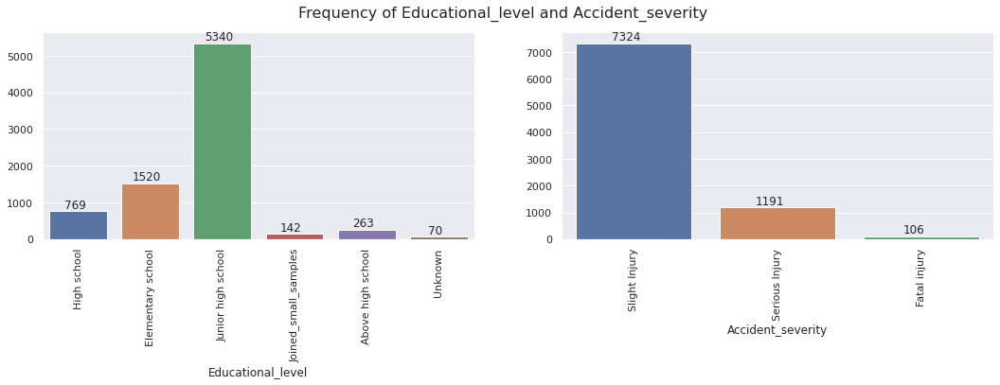




Showing Frequency Plots here for Vehicle_driver_relation:



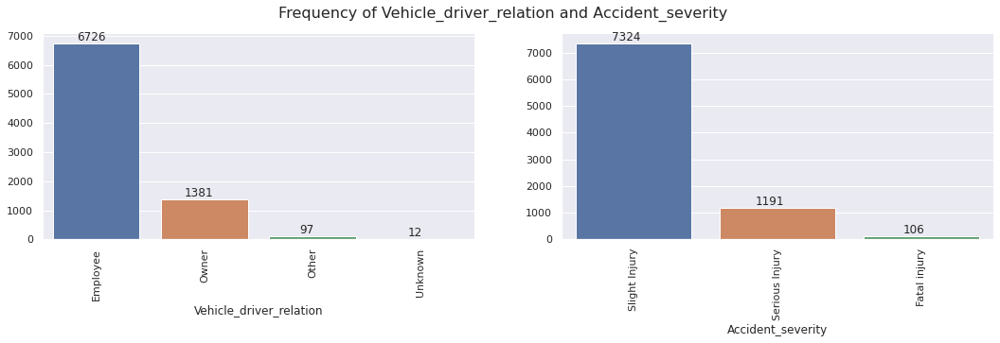




Showing Frequency Plots here for Driving_experience:



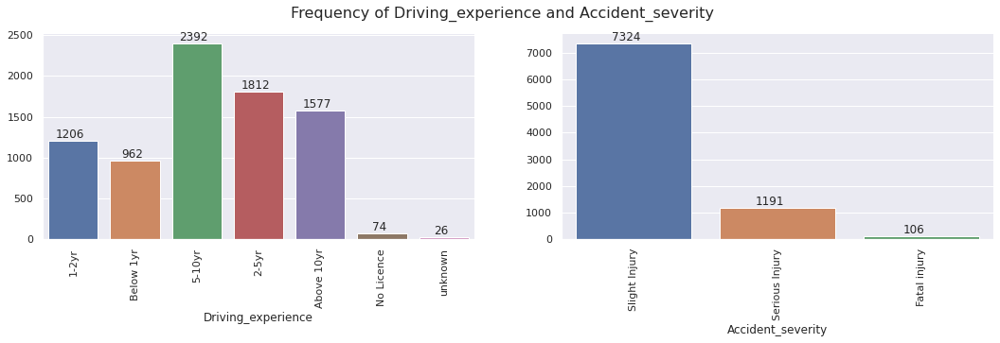




Showing Frequency Plots here for Type_of_vehicle:



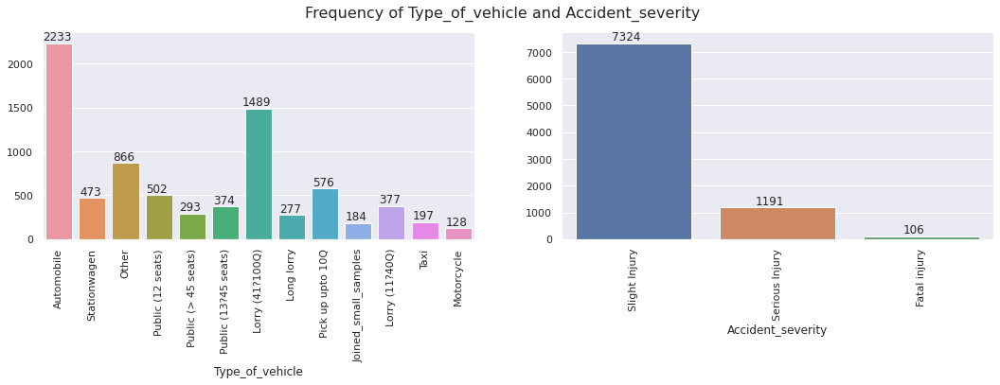




Showing Frequency Plots here for Owner_of_vehicle:



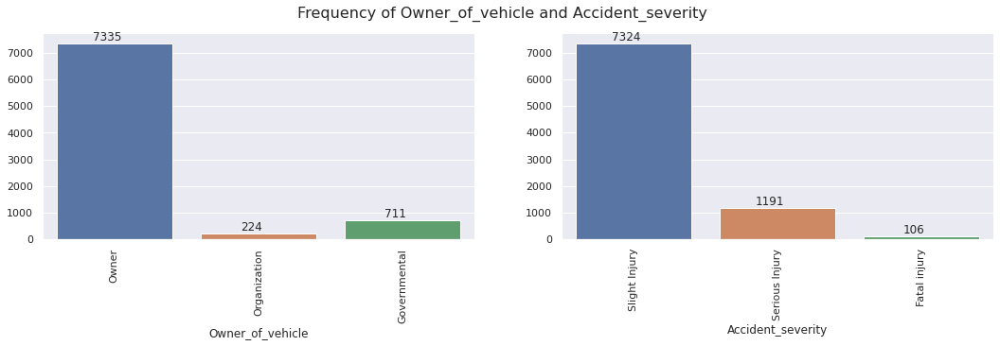




Showing Frequency Plots here for Service_year_of_vehicle:



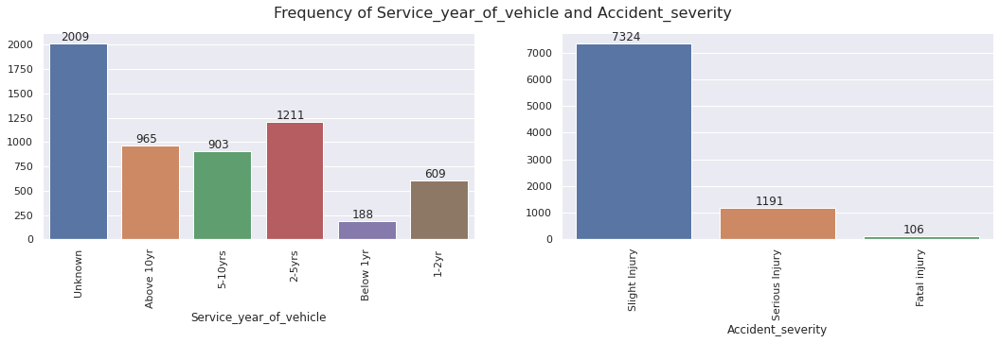




Showing Frequency Plots here for Defect_of_vehicle:



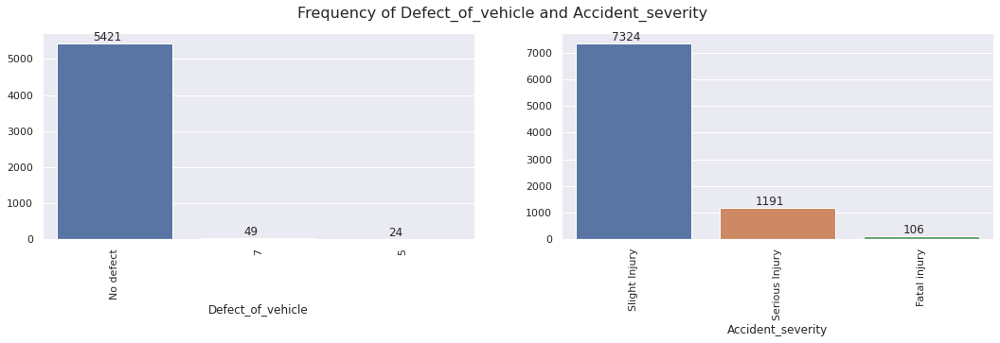




Showing Frequency Plots here for Area_accident_occured:



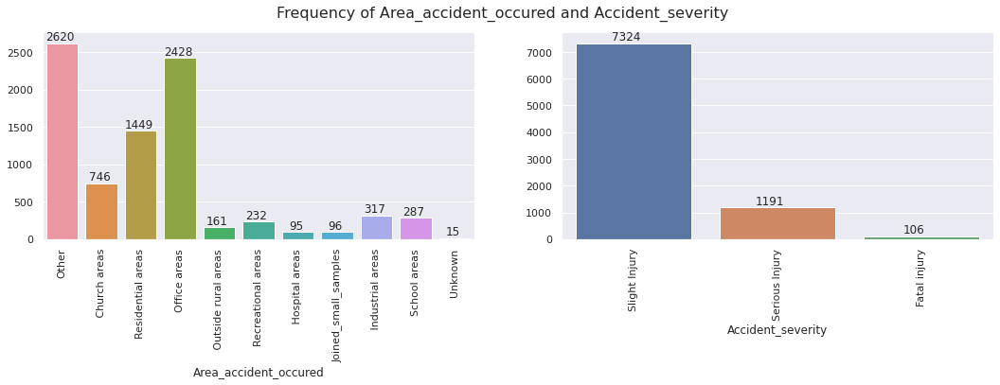




Showing Frequency Plots here for Lanes_or_Medians:



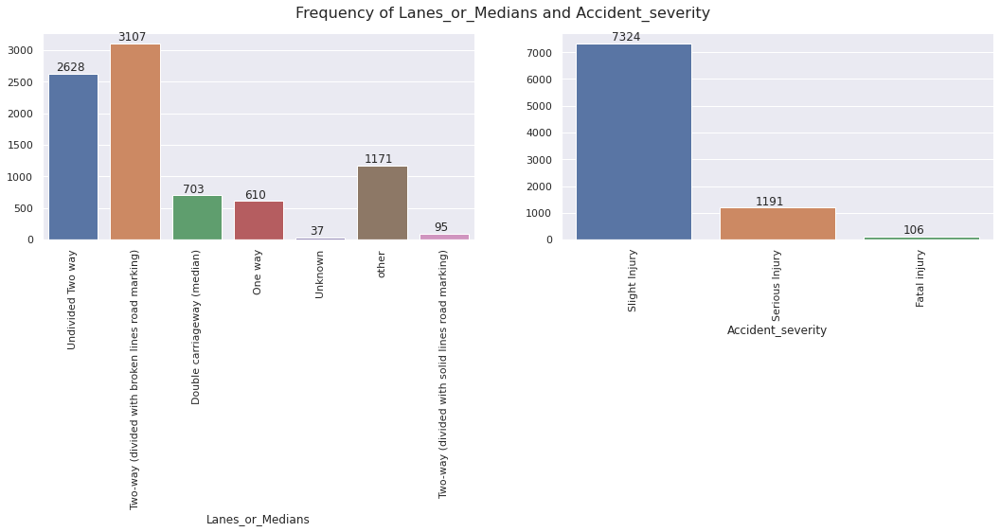




Showing Frequency Plots here for Road_allignment:



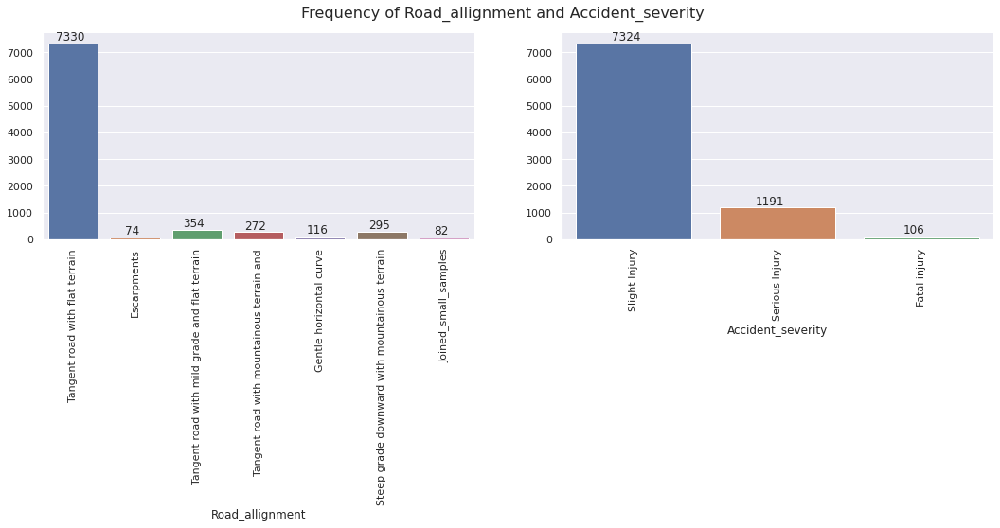




Showing Frequency Plots here for Types_of_Junction:



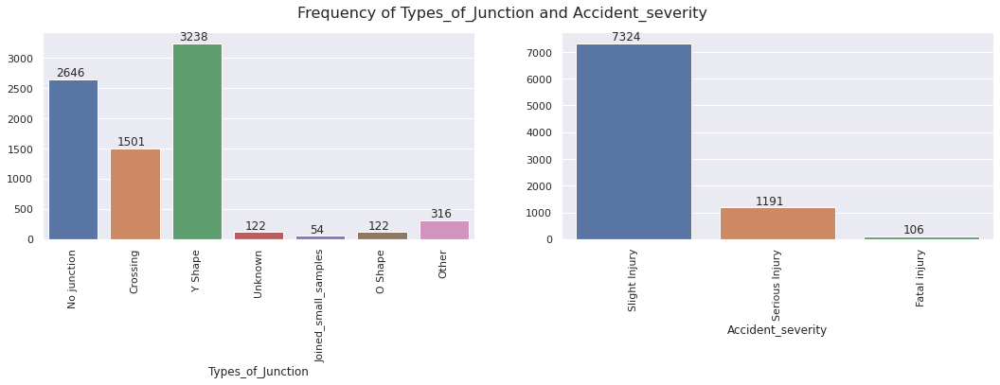




Showing Frequency Plots here for Road_surface_type:



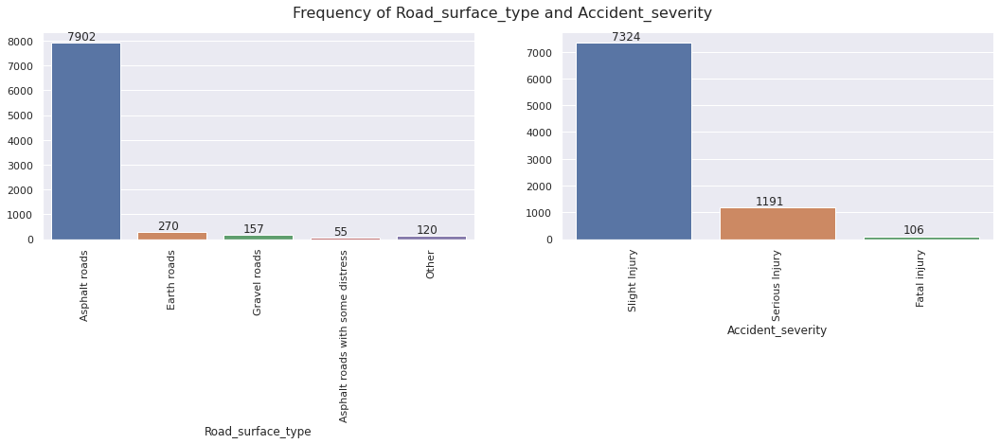




Showing Frequency Plots here for Type_of_collision:



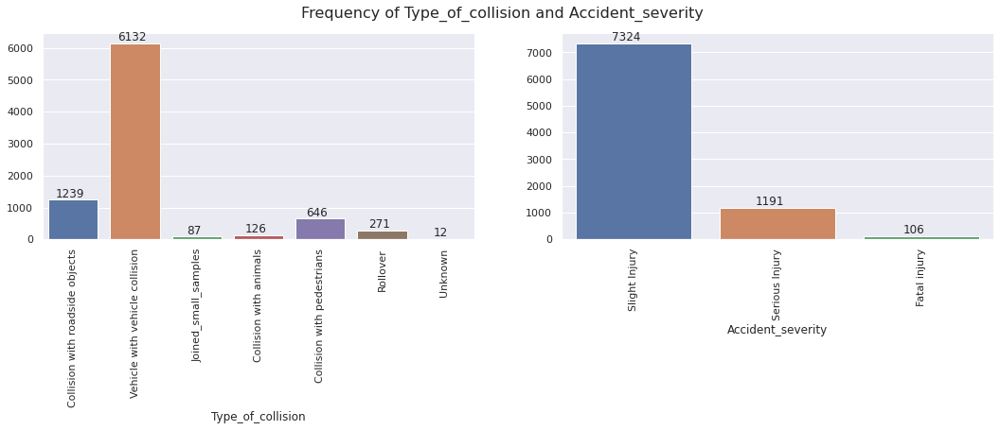




Showing Frequency Plots here for Vehicle_movement:



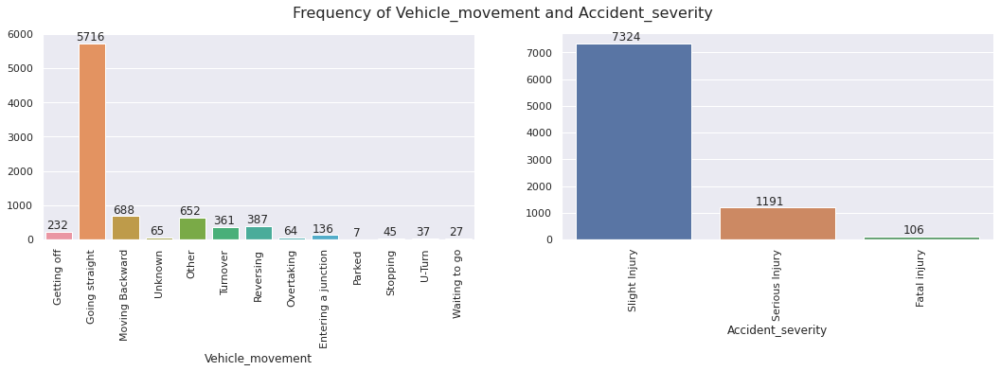




Showing Frequency Plots here for Work_of_casuality:



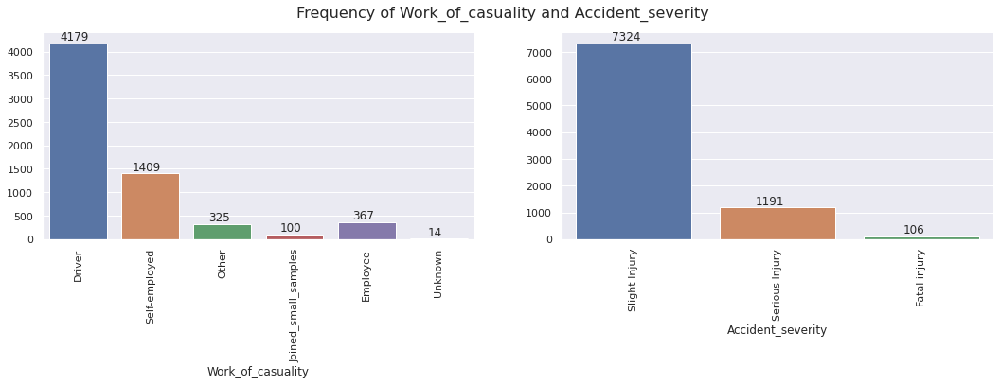




Showing Frequency Plots here for Fitness_of_casuality:



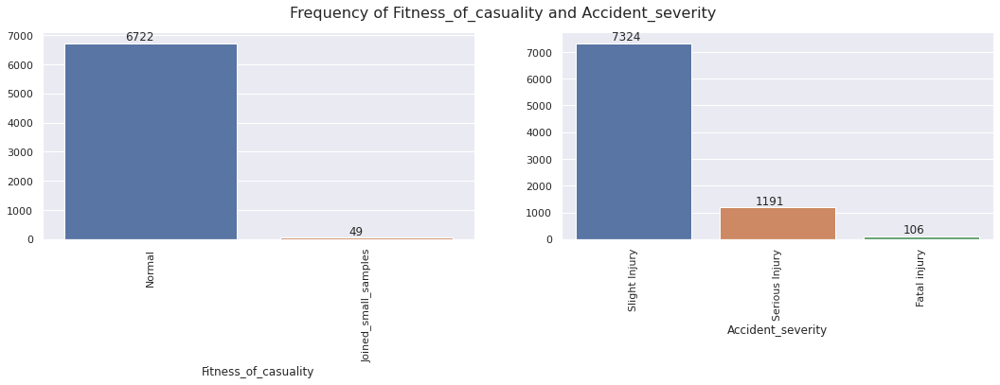

In [35]:
for col in na_count_table(df)["column"]:
    column_barplot(df, col, "Accident_severity", (18, 4), importance=1)

In [36]:
df = missing_value_imputation_v2(df)

In [37]:
na_count_table(df)

,column,na_count,ratio (in persentage)


Finally No NaN remains. We need to implement this on test data too.

In [38]:
df_test = missing_value_imputation_v2(df_test)

In [39]:
na_count_table(df_test)

,column,na_count,ratio (in persentage)


In [40]:
uniques(df_test)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Area_accident_occured,...,Road_surface_conditions,Light_conditions,Weather_conditions,Type_of_collision,Number_of_vehicles_involved,Number_of_casualties,Vehicle_movement,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 43.82%,Friday: 17.02%,Over 51: 12.18%,Male: 94.18%,Junior high school: 68.55%,Employee: 83.27%,Above 10yr: 19.89%,Automobile: 31.04%,Owner: 88.69%,Other: 33.26%,...,Dry: 75.67%,Daylight: 70.42%,Normal: 80.95%,Vehicle with vehicle collision: 72.83%,2: 67.47%,2: 18.35%,U-Turn: 0.35%,Not a Pedestrian: 92.77%,Changing lane to the left: 12.37%,Slight Injury: 83.65%
1,Morning: 31.83%,Sunday: 12.69%,Under 18: 7.01%,Female: 5.82%,High school: 9.23%,Owner: 16.02%,Below 1yr: 11.01%,Public (12 seats): 5.66%,Governmental: 8.93%,Residential areas: 16.86%,...,Wet or damp: 23.92%,Darkness - lights lit: 27.85%,Unknown: 2.54%,Collision with roadside objects: 14.80%,1: 16.73%,1: 67.63%,Other: 7.71%,Crossing from driver's nearside: 1.19%,Driving carelessly: 11.07%,Serious Injury: 14.94%
2,Night: 7.77%,Wednesday: 15.16%,18-30: 40.65%,NaN,Elementary school: 17.40%,Other: 0.70%,No Licence: 1.19%,Public (> 45 seats): 3.00%,Organization: 2.38%,Office areas: 28.47%,...,Joined_small_samples: 0.41%,Joined_small_samples: 1.73%,Raining: 10.99%,Collision with pedestrians: 6.77%,3: 12.29%,3: 7.39%,Getting off: 2.90%,Joined_small_samples: 1.19%,No distancing: 19.03%,Fatal injury: 1.41%
3,Evening: 16.59%,Tuesday: 13.42%,31-50: 40.16%,NaN,Above high school: 2.68%,NaN,1-2yr: 15.94%,Lorry (11?40Q): 4.44%,NaN,Church areas: 8.50%,...,NaN,NaN,Other: 2.52%,Rollover: 3.41%,4: 3.22%,4: 3.71%,Going straight: 69.53%,Unknown or other: 2.33%,Moving Backward: 9.39%,NaN
4,NaN,Saturday: 12.69%,NaN,NaN,Joined_small_samples: 2.14%,NaN,5-10yr: 28.58%,Pick up upto 10Q: 6.36%,NaN,Industrial areas: 3.76%,...,NaN,NaN,Cloudy: 1.11%,Collision with animals: 1.22%,Joined_small_samples: 0.30%,5: 1.87%,Moving Backward: 8.04%,Crossing from nearside - masked by parked or s...,Driving to the left: 2.41%,NaN
5,NaN,Monday: 13.64%,NaN,NaN,NaN,NaN,2-5yr: 23.38%,Lorry (41?100Q): 22.19%,NaN,School areas: 3.46%,...,NaN,NaN,Windy: 1.03%,Joined_small_samples: 0.97%,NaN,Joined_small_samples: 1.06%,Waiting to go: 0.32%,NaN,Getting off the vehicle improperly: 1.84%,NaN
6,NaN,Thursday: 15.37%,NaN,NaN,NaN,NaN,NaN,Public (13?45 seats): 4.28%,NaN,Joined_small_samples: 0.87%,...,NaN,NaN,Joined_small_samples: 0.87%,NaN,NaN,NaN,Reversing: 4.76%,NaN,No priority to vehicle: 9.93%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.79%,NaN,Recreational areas: 2.57%,...,NaN,NaN,NaN,NaN,NaN,NaN,Turnover: 3.46%,NaN,Changing lane to the right: 14.29%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 1.84%,NaN,Outside rural areas: 1.54%,...,NaN,NaN,NaN,NaN,NaN,NaN,Overtaking: 0.87%,NaN,Other: 3.57%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Other: 9.26%,NaN,Hospital areas: 0.70%,...,NaN,NaN,NaN,NaN,NaN,NaN,Entering a junction: 1.54%,NaN,Driving under the influence of drugs: 2.68%,NaN


##### Checking unique values in test and train data

In [41]:
for col in df.columns:
    s1 = set(df[col].unique())
    s2 = set(df_test[col].unique())
    s3 = s1.intersection(s2)
    if len(s3) == len(s1):
        print(f"column {col} is fine")
    else:
        print(f"column {col} is not fine")

column Time_of_day is fine
column Day_of_week is fine
column Age_band_of_driver is fine
column Sex_of_driver is fine
column Educational_level is fine
column Vehicle_driver_relation is fine
column Driving_experience is fine
column Type_of_vehicle is fine
column Owner_of_vehicle is fine
column Area_accident_occured is fine
column Lanes_or_Medians is fine
column Road_allignment is fine
column Types_of_Junction is fine
column Road_surface_type is fine
column Road_surface_conditions is fine
column Light_conditions is fine
column Weather_conditions is fine
column Type_of_collision is fine
column Number_of_vehicles_involved is fine
column Number_of_casualties is fine
column Vehicle_movement is fine
column Pedestrian_movement is fine
column Cause_of_accident is fine
column Accident_severity is fine


From previous code snippet, we can confirm that the unique values of each columns are matching for tset and train data. The data ready for next steps of preprocessing.

#### Data Column (aka Categories) reduction and Future Selection

We will be removing unimportants columns if required and this will reduce number of categories.

##### One-hot-encoding

In [42]:
df_cat = cat_data_encoding(df, target_col, ohe=[f for f in df.columns if f != target_col], le=[target_col], le_order=[['Slight Injury', 'Serious Injury', 'Fatal injury']])

In [43]:
df_cat.head()

,Time_of_day_Morning,Time_of_day_Afternoon,Time_of_day_Evening,Day_of_week_Sunday,Day_of_week_Saturday,Day_of_week_Tuesday,Day_of_week_Monday,Day_of_week_Thursday,Day_of_week_Friday,Age_band_of_driver_31-50,...,Cause_of_accident_No_distancing,Cause_of_accident_No_priority_to_pedestrian,Cause_of_accident_Moving_Backward,Cause_of_accident_Other,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overturning,Accident_severity
4759,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5676,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
353,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
6223,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
456,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0


In [44]:
print(np.array(df_cat.columns))

['Time_of_day_Morning' 'Time_of_day_Afternoon' 'Time_of_day_Evening'
 'Day_of_week_Sunday' 'Day_of_week_Saturday' 'Day_of_week_Tuesday'
 'Day_of_week_Monday' 'Day_of_week_Thursday' 'Day_of_week_Friday'
 'Age_band_of_driver_31-50' 'Age_band_of_driver_18-30'
 'Age_band_of_driver_Over_51' 'Sex_of_driver_Female'
 'Educational_level_High_school' 'Educational_level_Elementary_school'
 'Educational_level_Joined_small_samples'
 'Educational_level_Above_high_school' 'Vehicle_driver_relation_Employee'
 'Vehicle_driver_relation_Other' 'Driving_experience_1-2yr'
 'Driving_experience_Below_1yr' 'Driving_experience_5-10yr'
 'Driving_experience_2-5yr' 'Driving_experience_Above_10yr'
 'Type_of_vehicle_Automobile' 'Type_of_vehicle_Stationwagen'
 'Type_of_vehicle_Other' 'Type_of_vehicle_Public_(12_seats)'
 'Type_of_vehicle_Public_(>_45_seats)'
 'Type_of_vehicle_Public_(13?45_seats)' 'Type_of_vehicle_Lorry_(41?100Q)'
 'Type_of_vehicle_Long_lorry' 'Type_of_vehicle_Pick_up_upto_10Q'
 'Type_of_vehicle_Joine

In [45]:
# categorization of test data
df_test_cat = cat_data_encoding(df_test, target_col, ohe=[f for f in df_test.columns if f != target_col], le=[target_col], le_order=[['Slight Injury', 'Serious Injury', 'Fatal injury']])

In [46]:
df_test_cat.head()

,Time_of_day_Afternoon,Time_of_day_Morning,Time_of_day_Evening,Day_of_week_Friday,Day_of_week_Sunday,Day_of_week_Tuesday,Day_of_week_Saturday,Day_of_week_Monday,Day_of_week_Thursday,Age_band_of_driver_Over_51,...,Cause_of_accident_No_priority_to_vehicle,Cause_of_accident_Changing_lane_to_the_right,Cause_of_accident_Other,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Overtaking,Cause_of_accident_Joined_small_samples,Cause_of_accident_No_priority_to_pedestrian,Cause_of_accident_Overturning,Cause_of_accident_Driving_at_high_speed,Accident_severity
4281,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4010,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1022,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
8775,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
10000,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


##### Heatmap

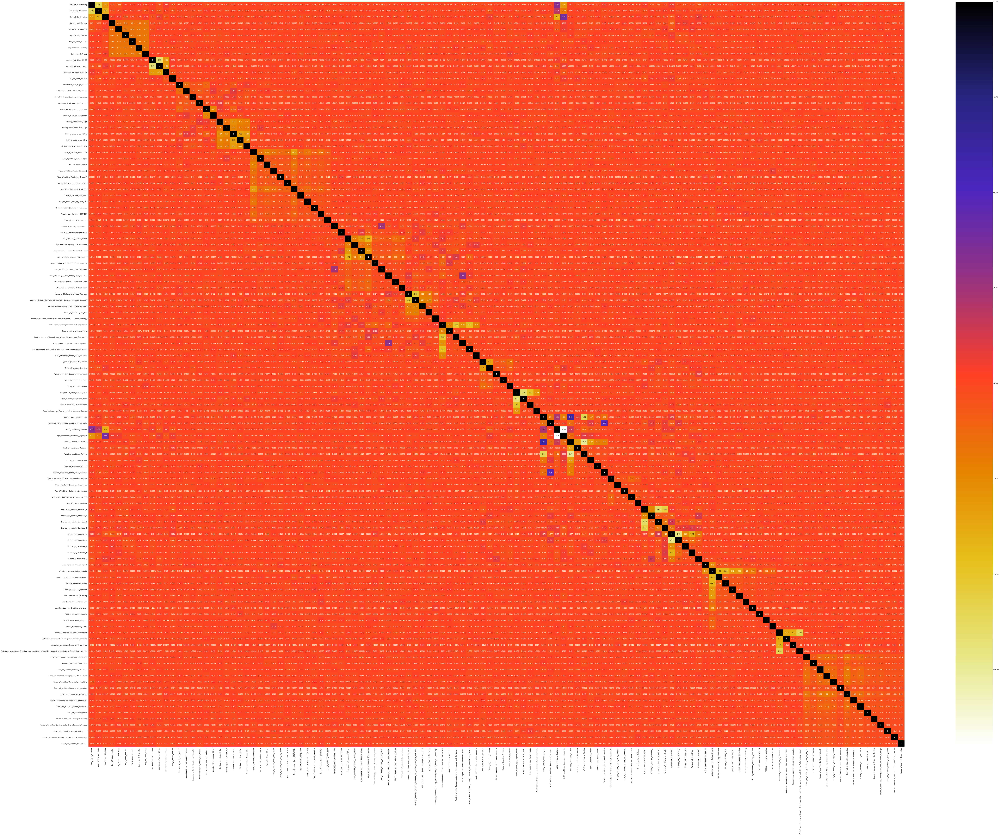

In [47]:
# Heatmap
data_heat = df_cat.drop(target_col, axis = 1)
fig_len = 125
heatmap(data_heat, (fig_len, fig_len*0.75))

***Observation***

* Time of day and Light_conditions are mostly positively correlated but correlation is not high.

![picture1](https://drive.google.com/uc?export=view&id=1rWtI0ynegS5FdMkviMU6JcbzeGx1m1pt)
* Area_accident_occured_Hostital_areas and Owner_of_vehicle_Organization are positively correlated (0.24)

* Area_accidnt_occured_Joined_small_samples and Road_allignment_Gentle_horizontal_curve are positively correlated (0.3)

* Road_surface_condition_Dry is correlated with Light_conditions, Weather_conditions.

![picture2](https://drive.google.com/uc?export=view&id=184xdkStXp9hC-ry9jEv0cwTlYb9TPlOL)
* Weather_conditions_Joined_small_samples and Road_surface_conditions_Joined_small_samples are positively correlated (0.42)

* The one-hot-encode for each column is somewhat correlated.

We need to deal with these.

##### Chi-Squared Feature Selection


In [48]:
chi2_p_vals = chi2_features_selction(df_cat, target_col, alpha=chi_alpha)

In [49]:
chi2_p_vals

,stat_value,p_value,Test_result
Number_of_casualties_4,199.806942,4.097073e-44,Rejected
Number_of_vehicles_involved_1,185.351724,5.641368e-41,Rejected
Number_of_vehicles_involved_2,35.092182,2.397892e-08,Rejected
Types_of_Junction_Crossing,15.981114,3.386454e-04,Rejected
Day_of_week_Saturday,14.341199,7.688617e-04,Rejected
...,...,...,...
Driving_experience_5-10yr,0.067156,9.669795e-01,Fails to reject
Area_accident_occured__Industrial_areas,0.042260,9.790916e-01,Fails to reject
Road_surface_type_Asphalt_roads,0.036681,9.818265e-01,Fails to reject
Road_surface_conditions_Dry,0.008861,9.955791e-01,Fails to reject


In [50]:
# significant columns
selected_cols = chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index, len(chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index)
selected_cols

(Index(['Number_of_casualties_4', 'Number_of_vehicles_involved_1',
        'Number_of_vehicles_involved_2', 'Types_of_Junction_Crossing',
        'Day_of_week_Saturday', 'Time_of_day_Morning',
        'Vehicle_movement_Overtaking', 'Time_of_day_Evening',
        'Cause_of_accident_Moving_Backward', 'Day_of_week_Monday',
        'Day_of_week_Friday', 'Type_of_collision_Collision_with_pedestrians',
        'Types_of_Junction_No_junction', 'Number_of_casualties_1',
        'Weather_conditions_Cloudy', 'Type_of_vehicle_Pick_up_upto_10Q',
        'Weather_conditions_Unknown', 'Light_conditions_Darkness_-_lights_lit',
        'Types_of_Junction_Other', 'Area_accident_occured_Joined_small_samples',
        'Cause_of_accident_Overtaking', 'Weather_conditions_Other',
        'Cause_of_accident_No_priority_to_vehicle'],
       dtype='object'), 23)

Showing Frequency Plots here for Number_of_casualties_4:



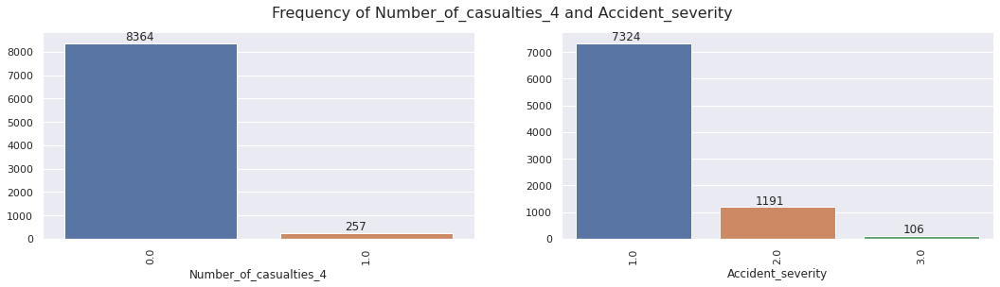


Showing Frequency Comparison of Number_of_casualties_4 vs Accident_severity



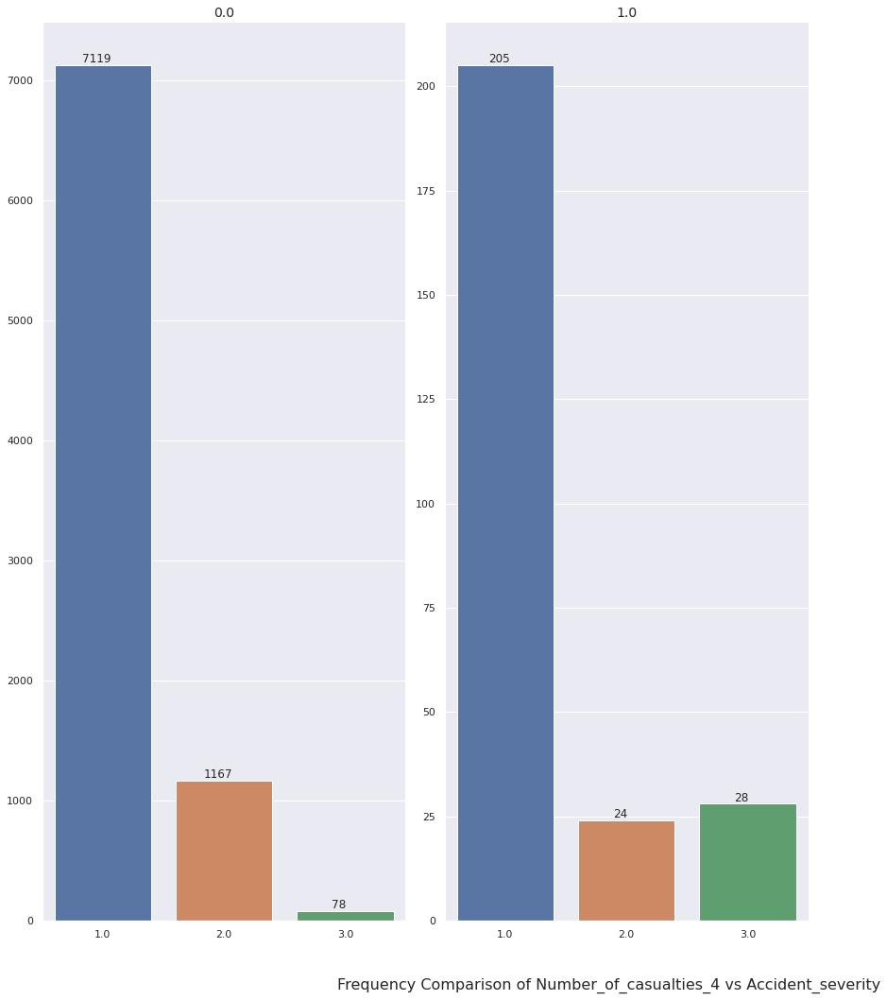




Showing Frequency Plots here for Number_of_vehicles_involved_1:



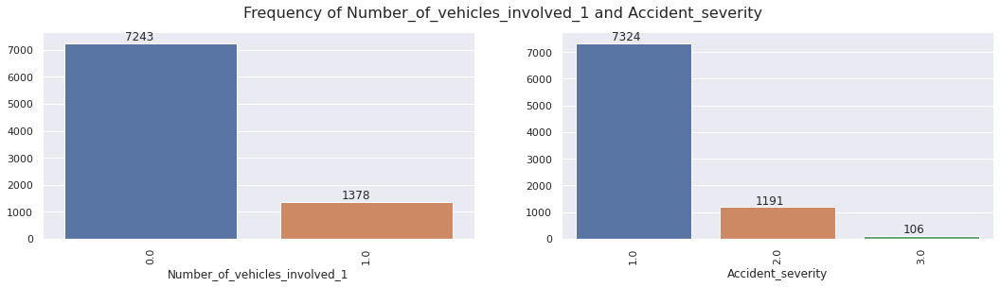


Showing Frequency Comparison of Number_of_vehicles_involved_1 vs Accident_severity



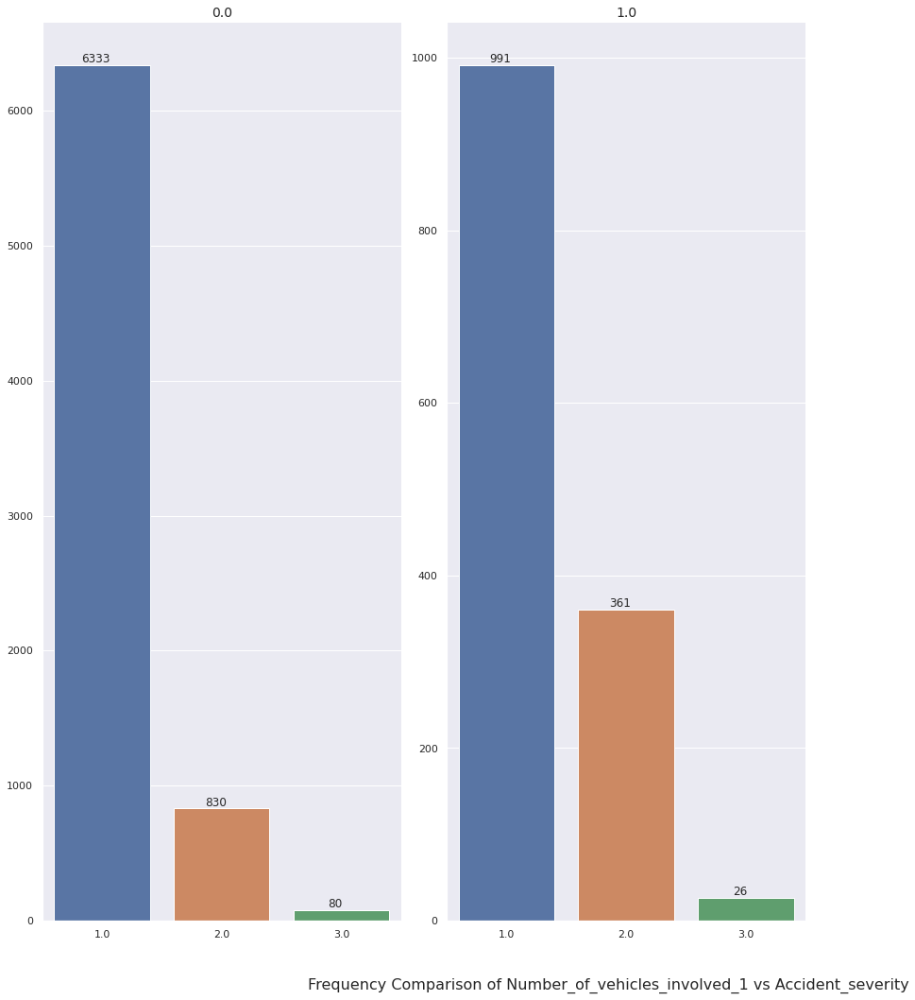




Showing Frequency Plots here for Number_of_vehicles_involved_2:



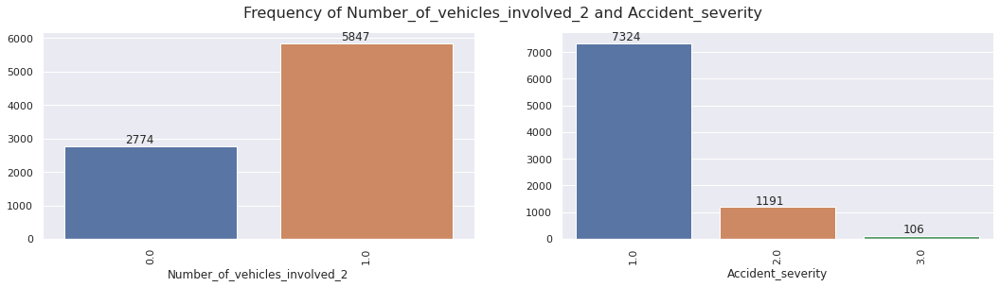


Showing Frequency Comparison of Number_of_vehicles_involved_2 vs Accident_severity



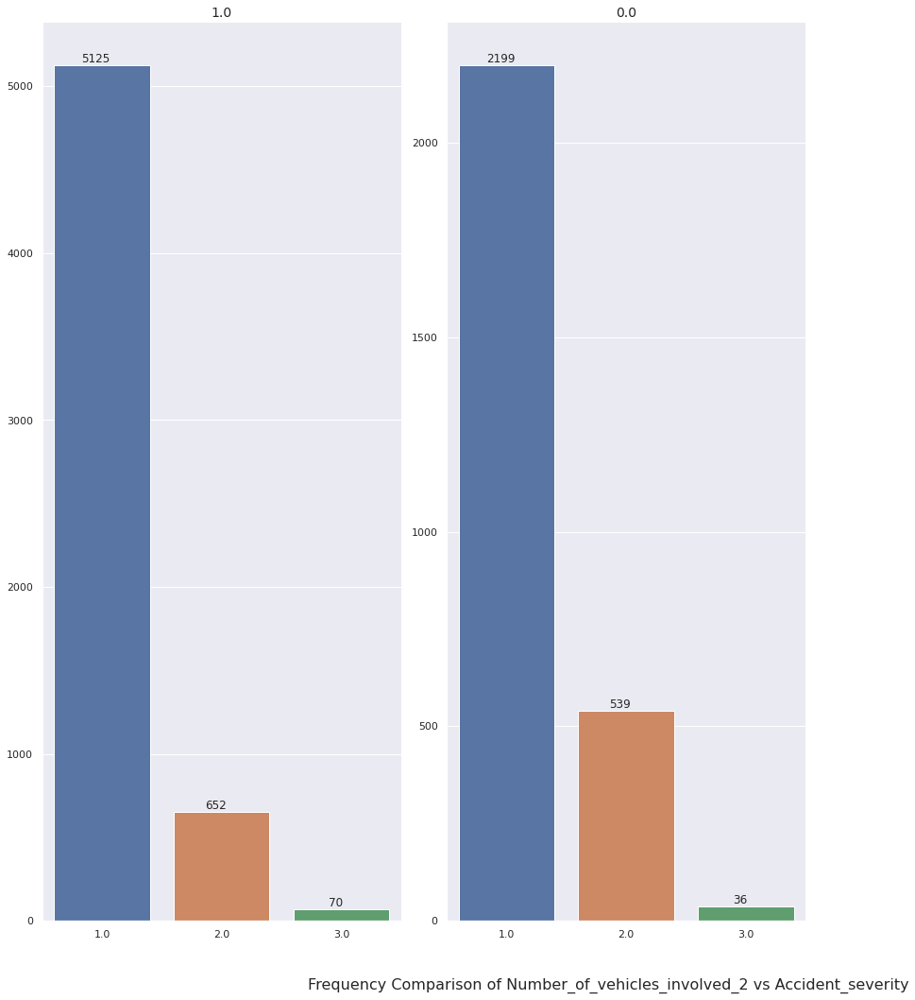




Showing Frequency Plots here for Types_of_Junction_Crossing:



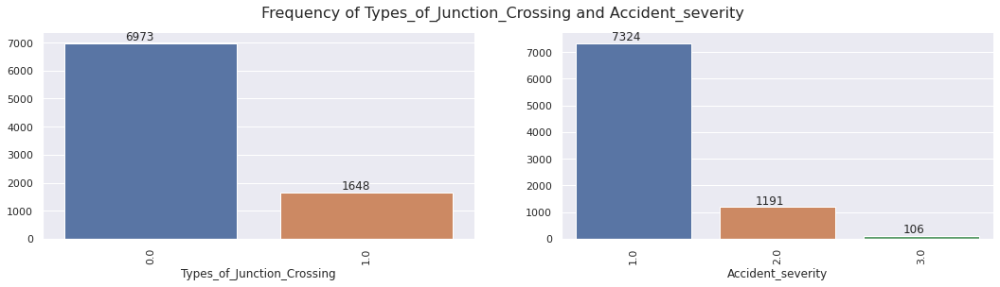


Showing Frequency Comparison of Types_of_Junction_Crossing vs Accident_severity



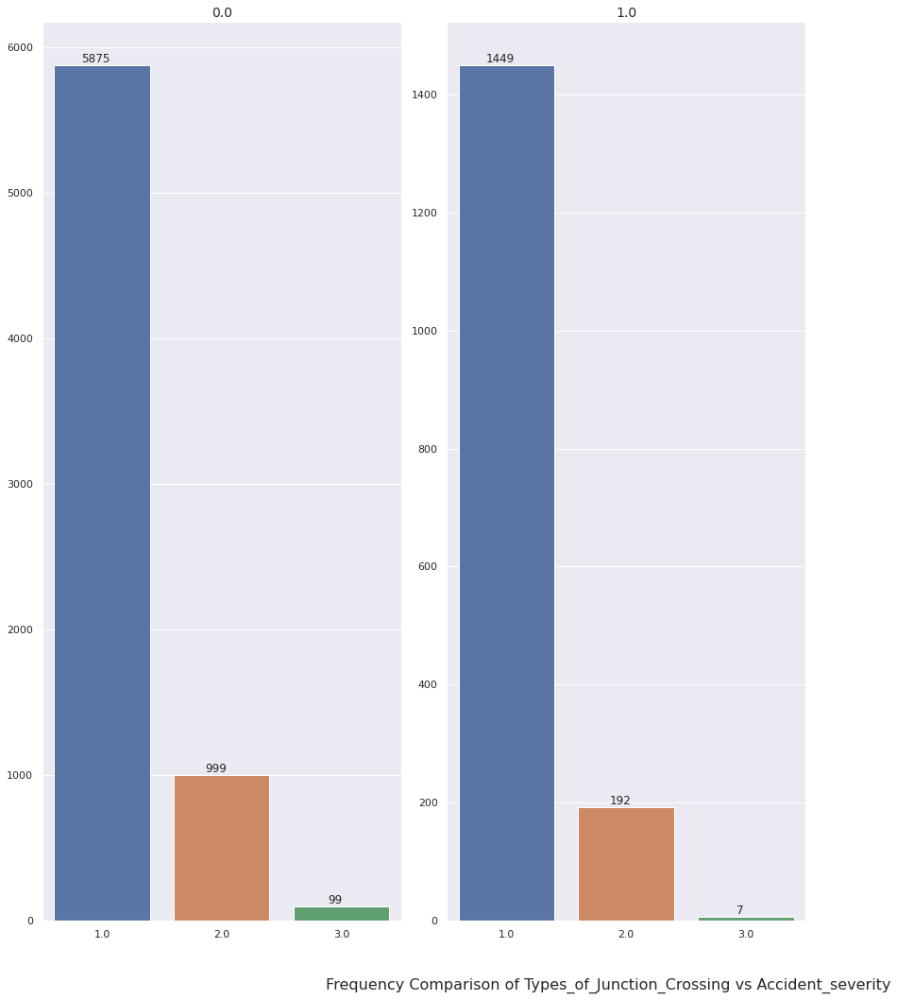




Showing Frequency Plots here for Day_of_week_Saturday:



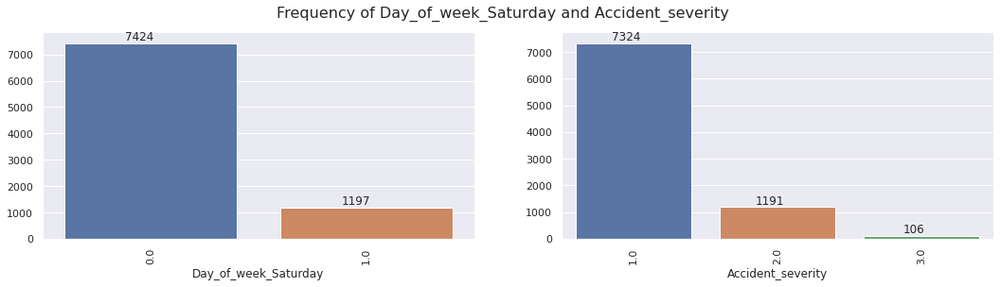


Showing Frequency Comparison of Day_of_week_Saturday vs Accident_severity



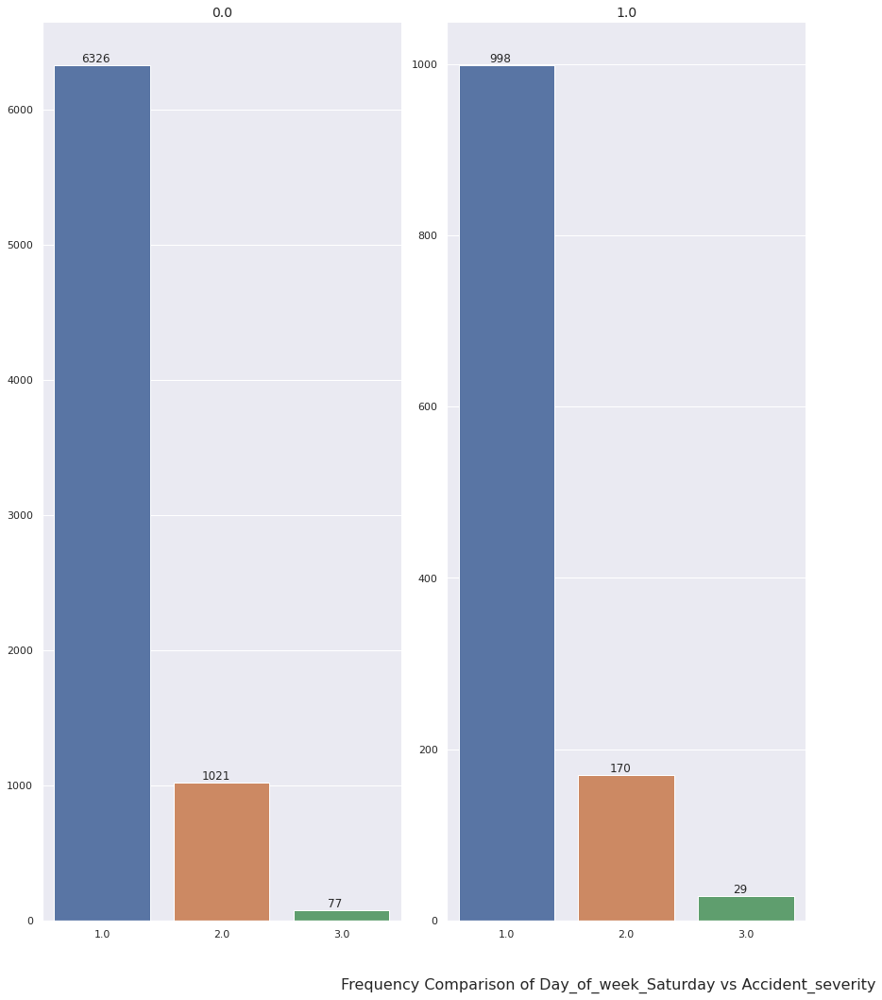




Showing Frequency Plots here for Time_of_day_Morning:



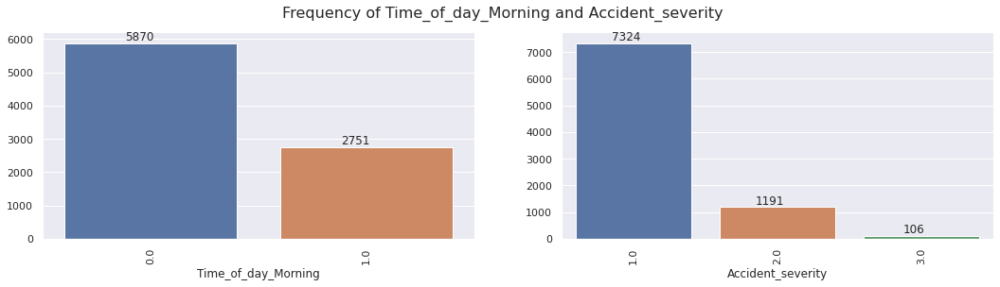


Showing Frequency Comparison of Time_of_day_Morning vs Accident_severity



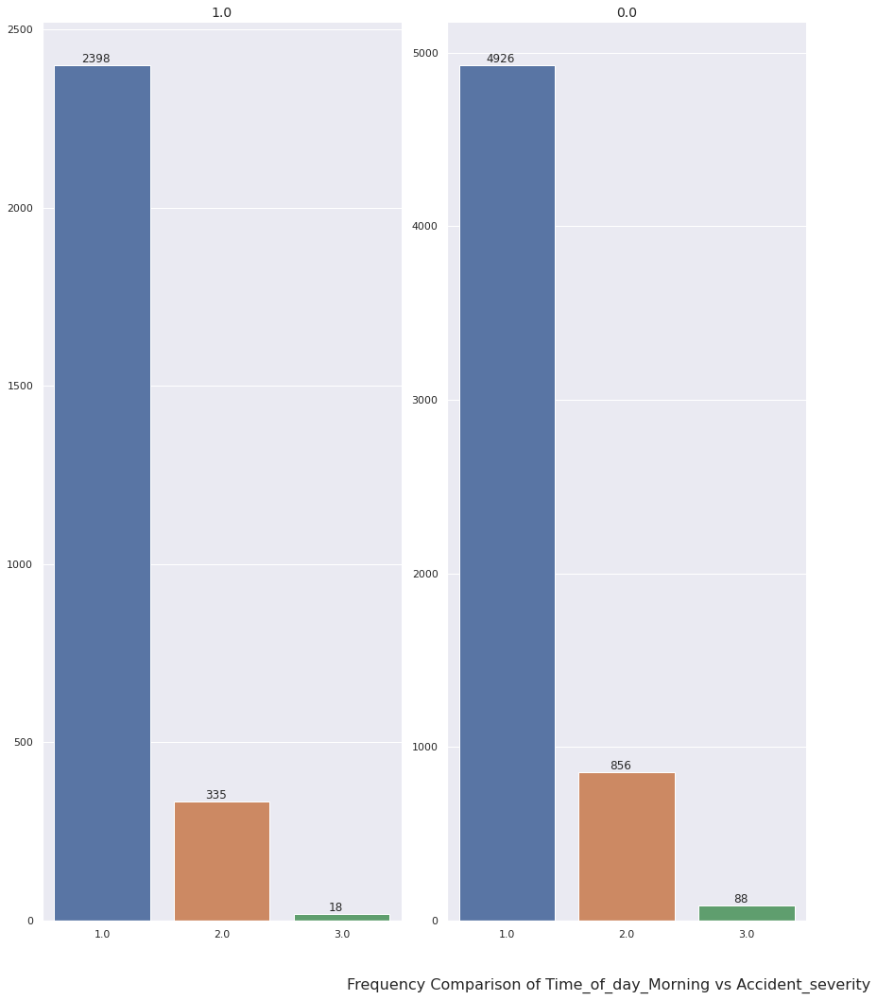




Showing Frequency Plots here for Vehicle_movement_Overtaking:



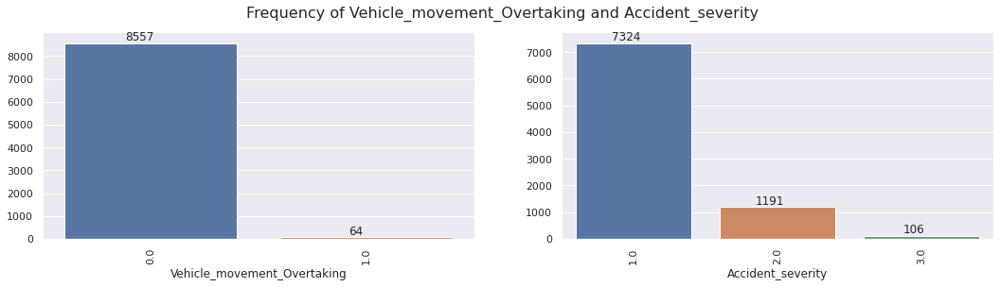


Showing Frequency Comparison of Vehicle_movement_Overtaking vs Accident_severity



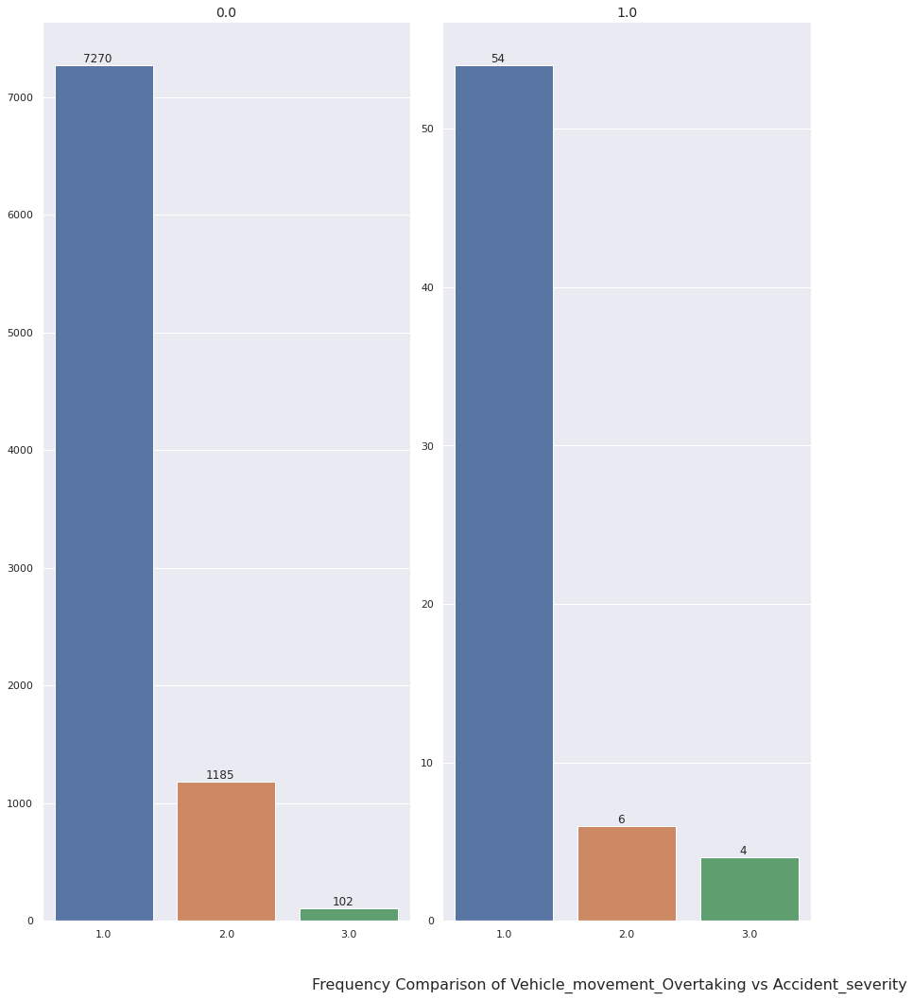




Showing Frequency Plots here for Time_of_day_Evening:



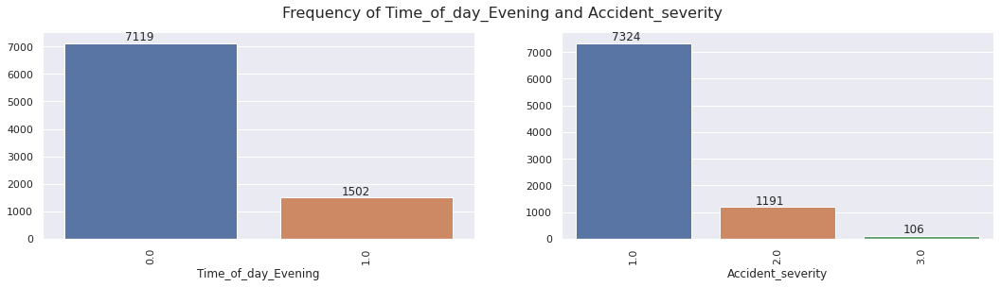


Showing Frequency Comparison of Time_of_day_Evening vs Accident_severity



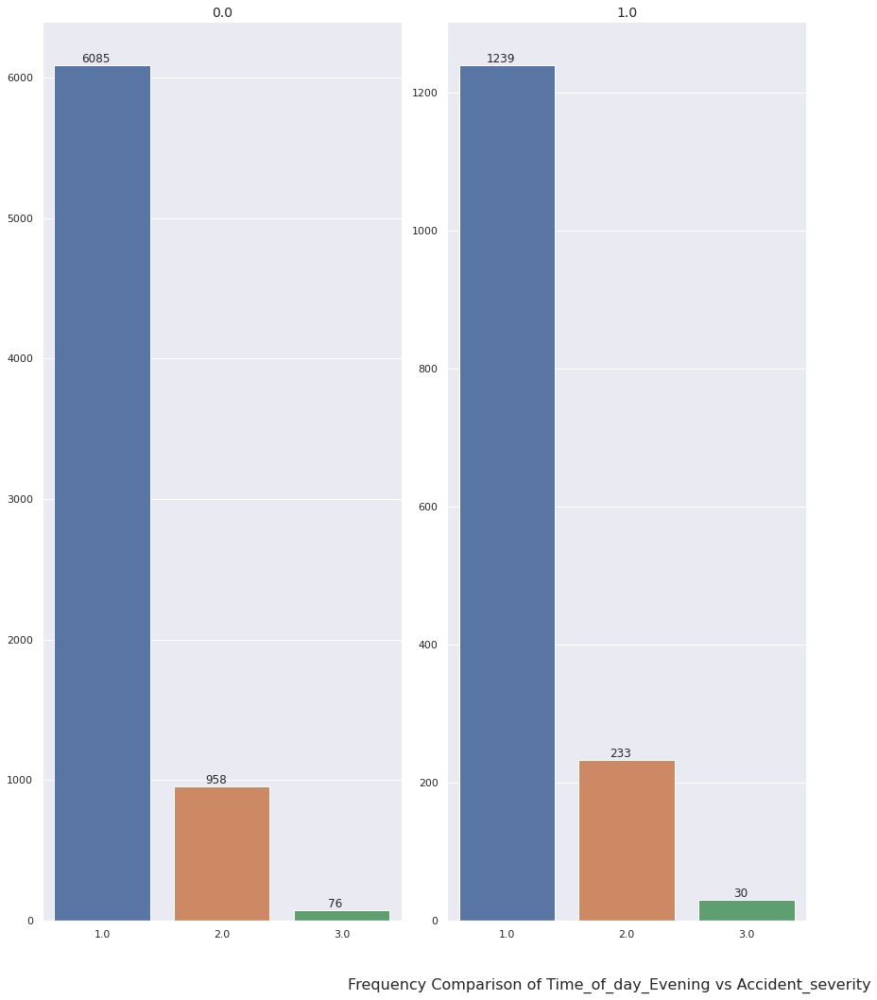




Showing Frequency Plots here for Cause_of_accident_Moving_Backward:



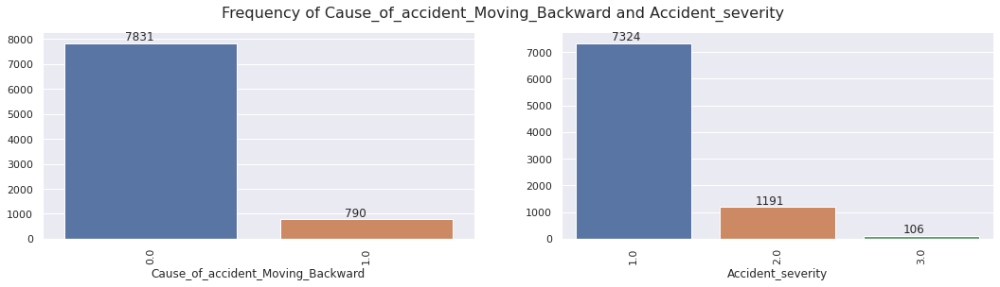


Showing Frequency Comparison of Cause_of_accident_Moving_Backward vs Accident_severity



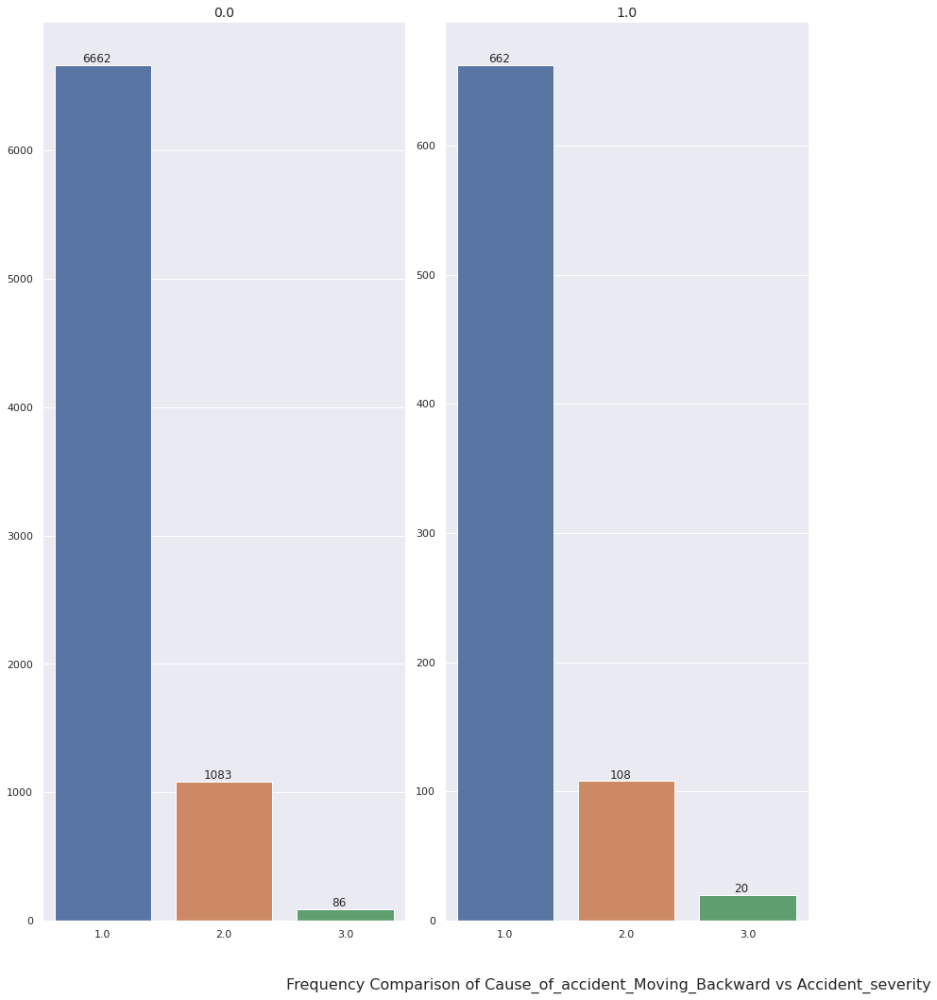




Showing Frequency Plots here for Day_of_week_Monday:



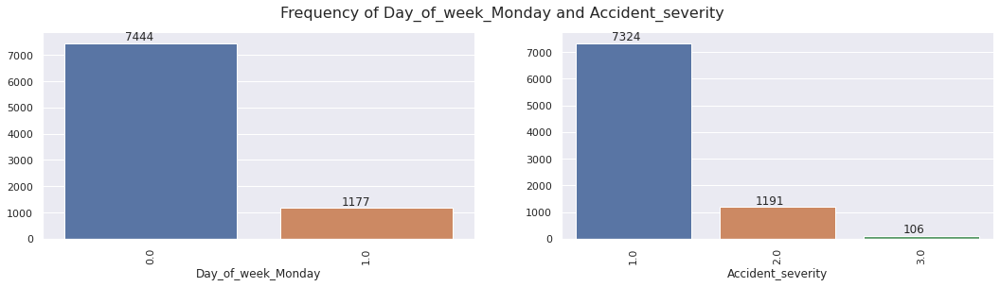


Showing Frequency Comparison of Day_of_week_Monday vs Accident_severity



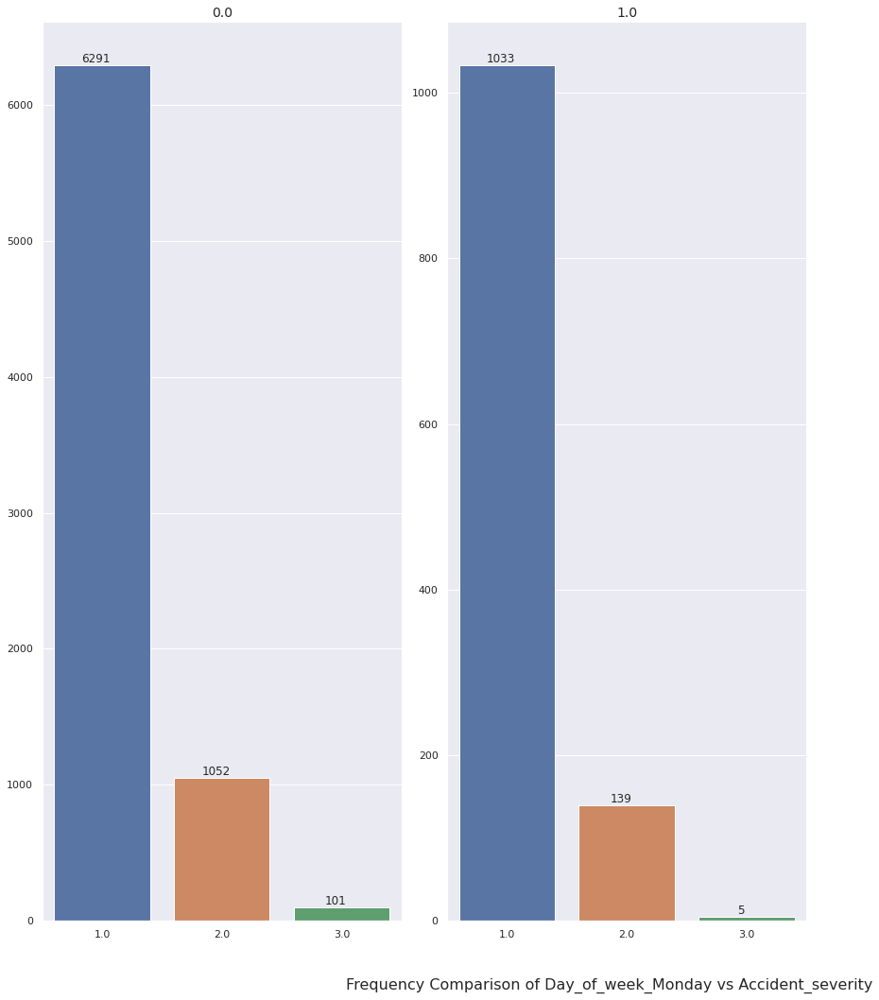




Showing Frequency Plots here for Day_of_week_Friday:



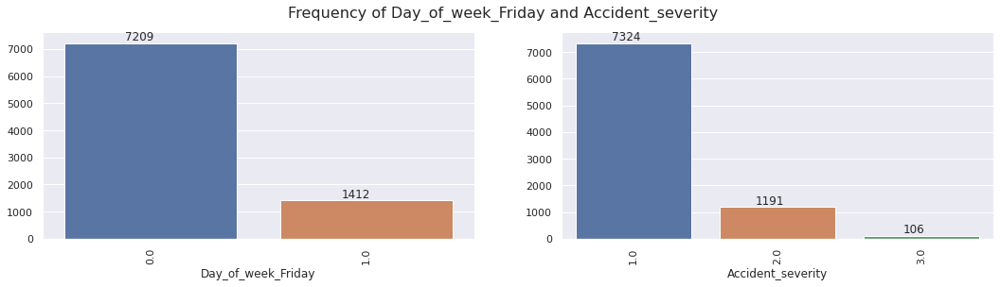


Showing Frequency Comparison of Day_of_week_Friday vs Accident_severity



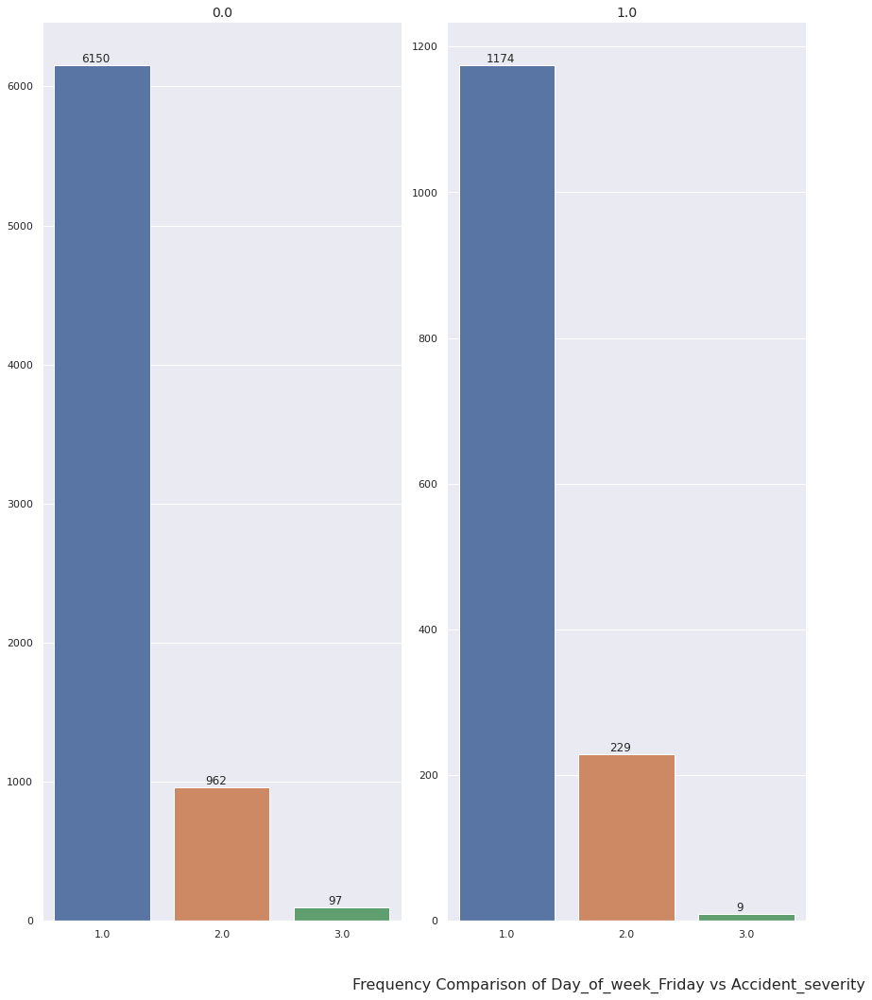




Showing Frequency Plots here for Type_of_collision_Collision_with_pedestrians:



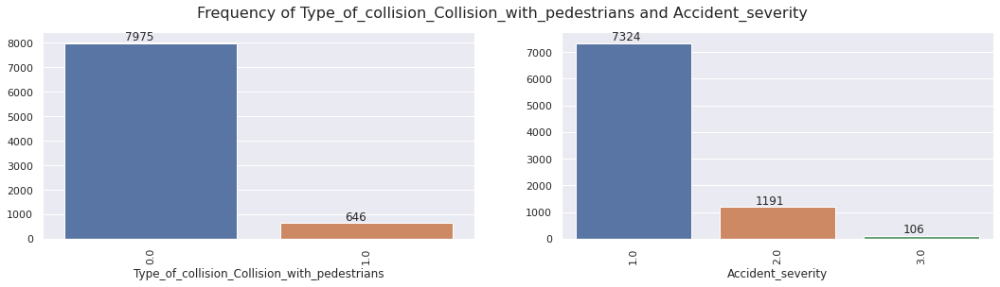


Showing Frequency Comparison of Type_of_collision_Collision_with_pedestrians vs Accident_severity



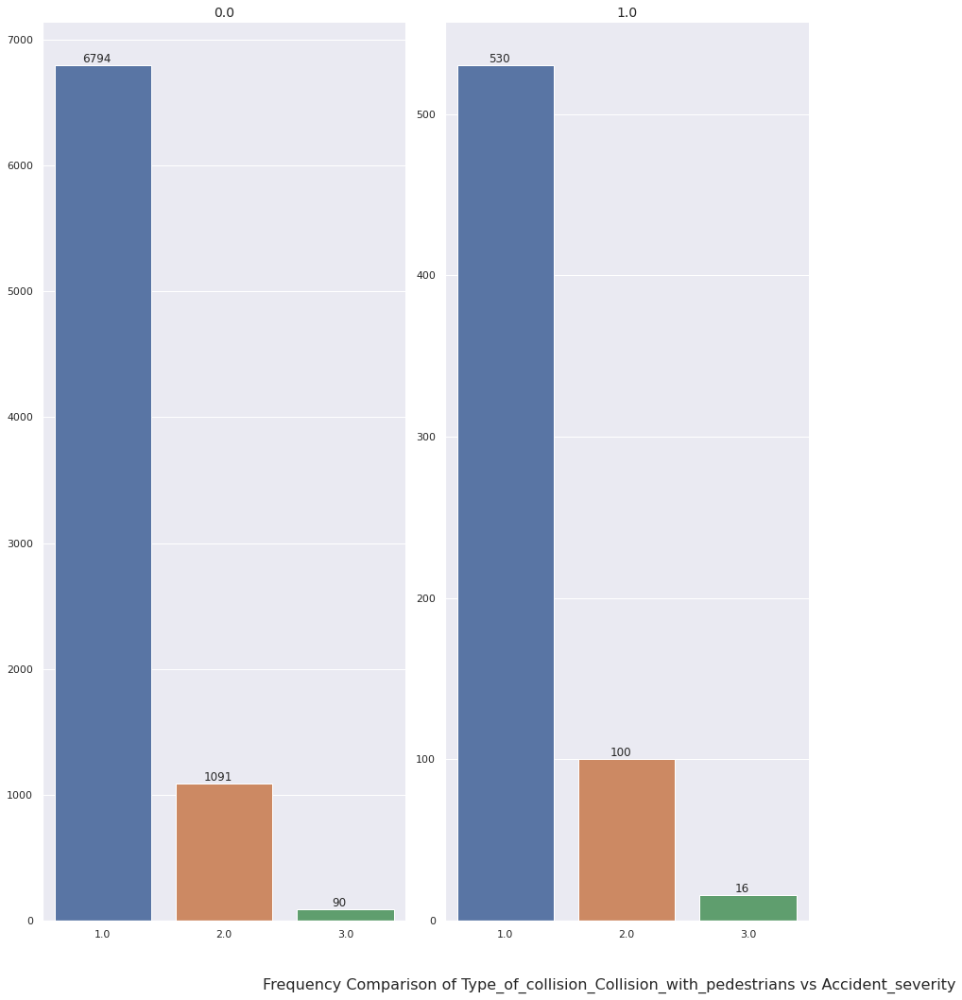




Showing Frequency Plots here for Types_of_Junction_No_junction:



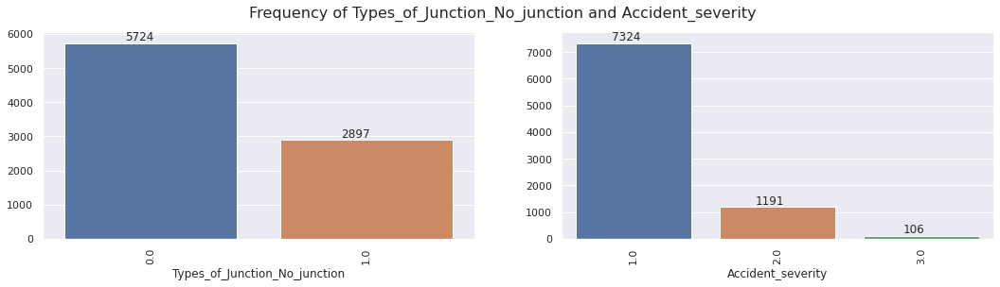


Showing Frequency Comparison of Types_of_Junction_No_junction vs Accident_severity



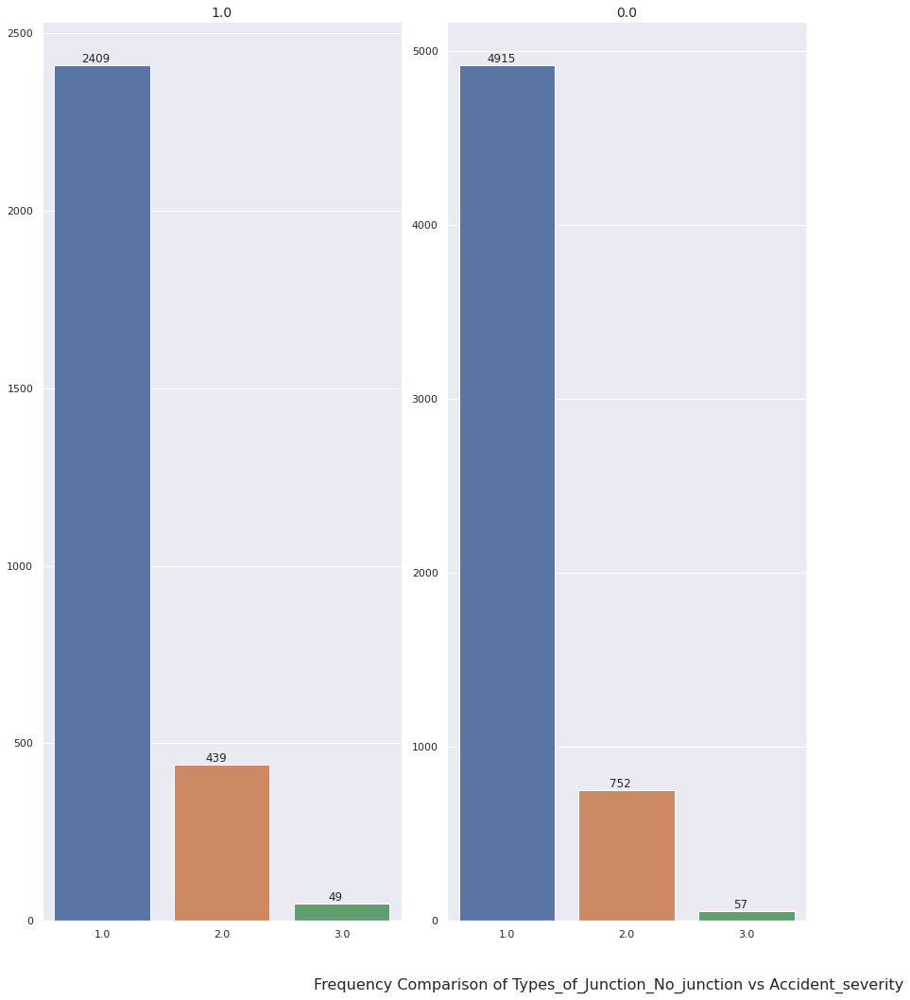




Showing Frequency Plots here for Number_of_casualties_1:



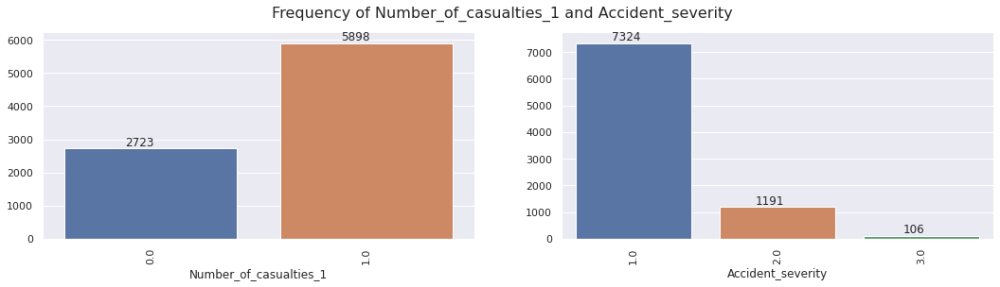


Showing Frequency Comparison of Number_of_casualties_1 vs Accident_severity



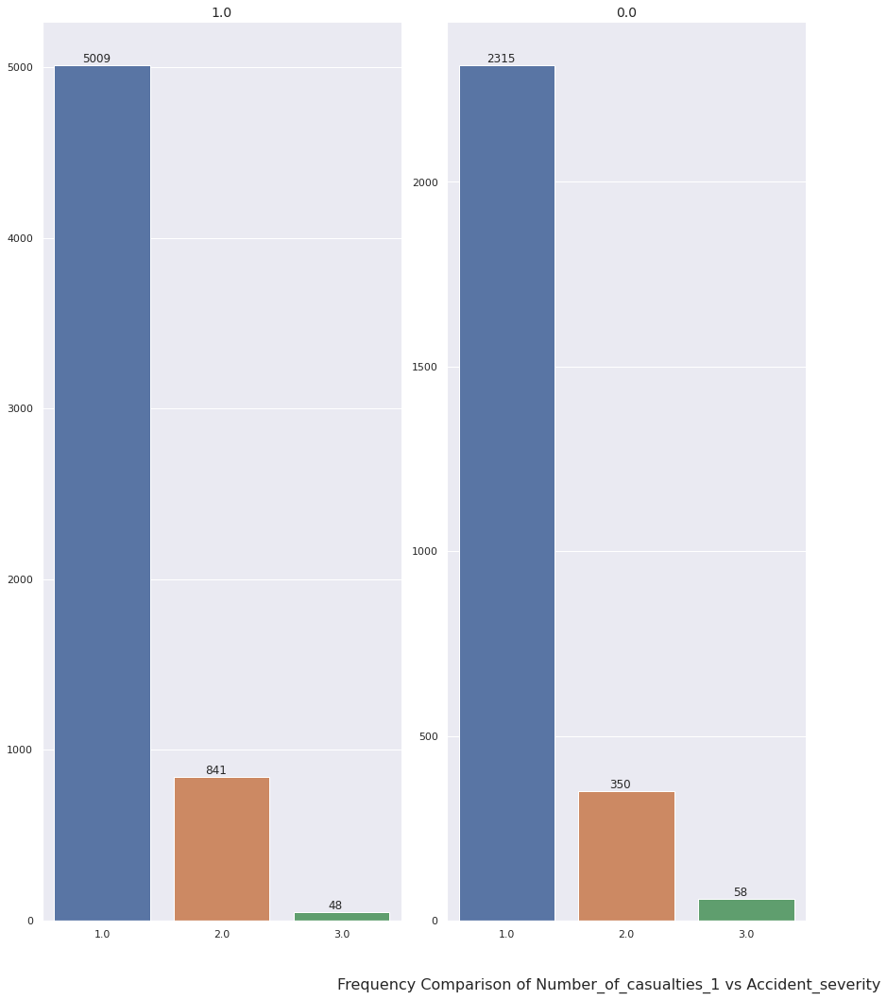




Showing Frequency Plots here for Weather_conditions_Cloudy:



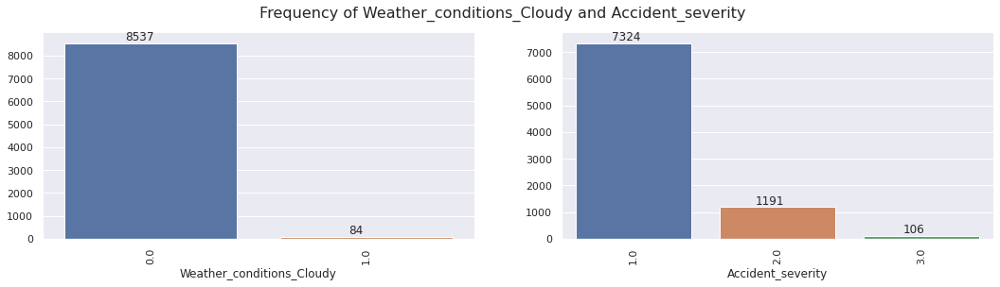


Showing Frequency Comparison of Weather_conditions_Cloudy vs Accident_severity



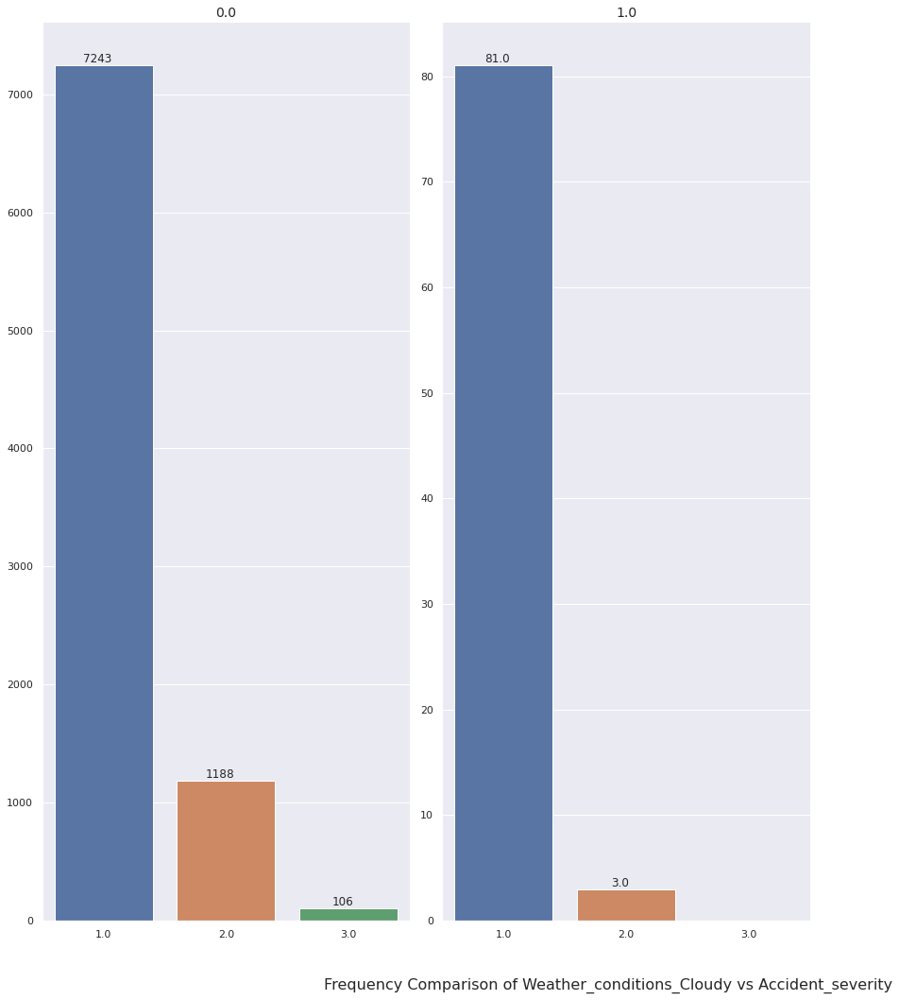




Showing Frequency Plots here for Type_of_vehicle_Pick_up_upto_10Q:



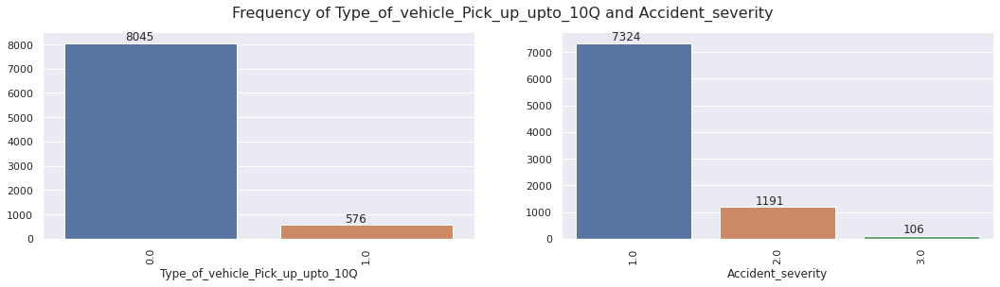


Showing Frequency Comparison of Type_of_vehicle_Pick_up_upto_10Q vs Accident_severity



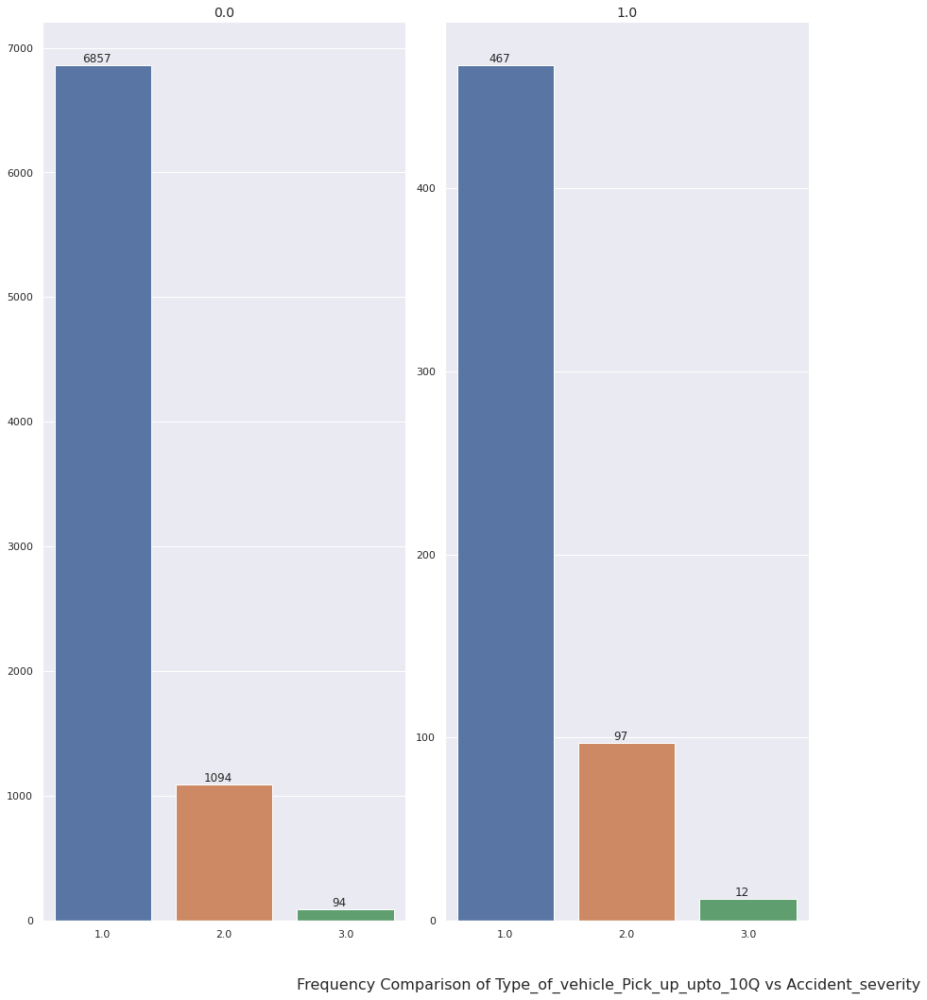




Showing Frequency Plots here for Weather_conditions_Unknown:



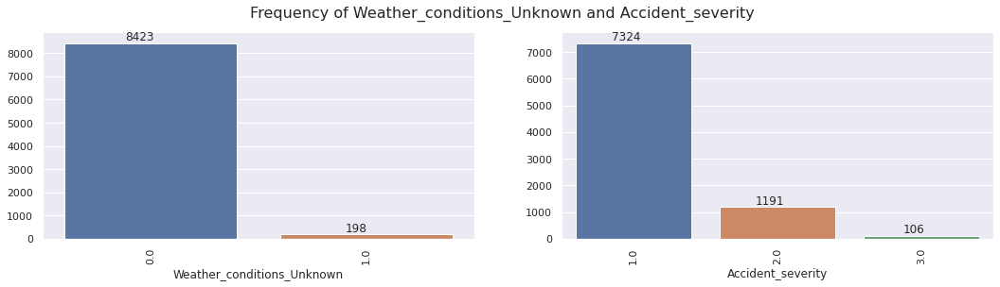


Showing Frequency Comparison of Weather_conditions_Unknown vs Accident_severity



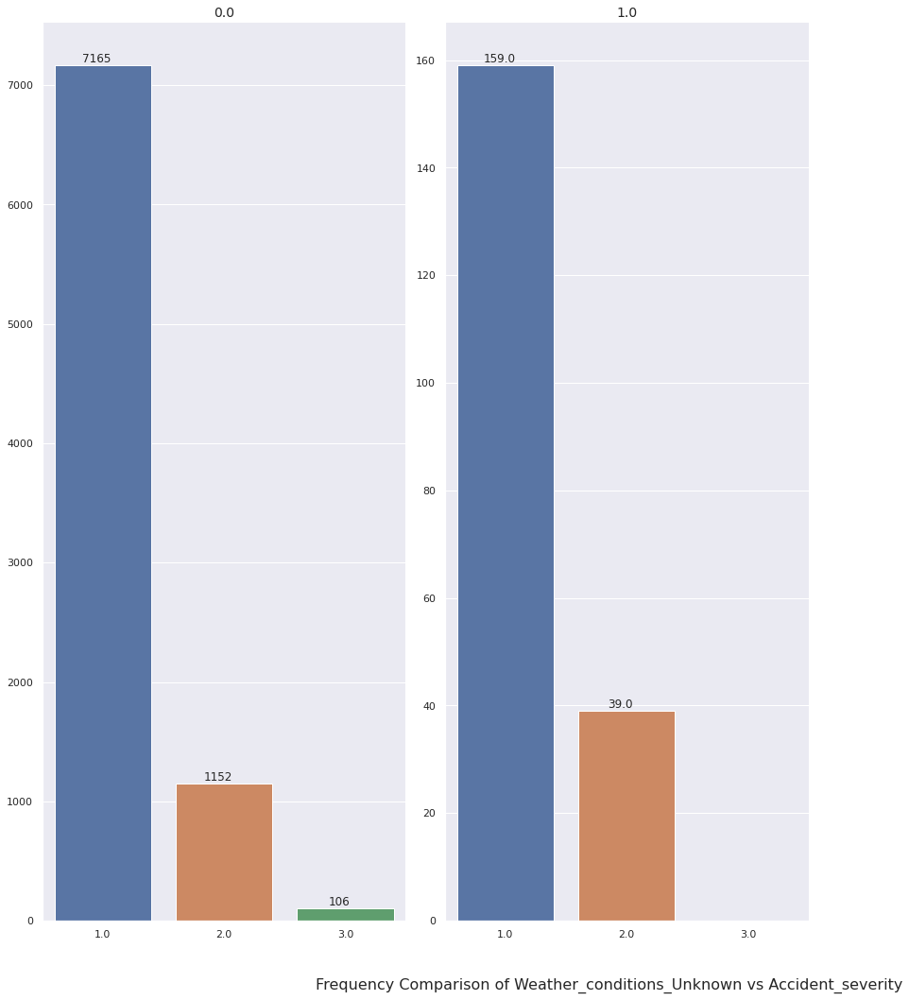




Showing Frequency Plots here for Light_conditions_Darkness_-_lights_lit:



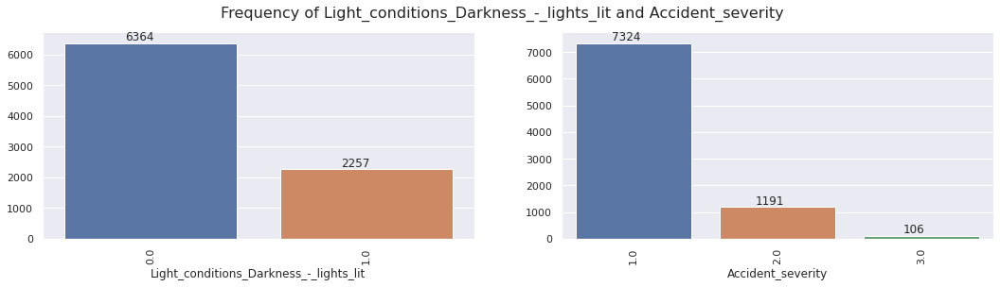


Showing Frequency Comparison of Light_conditions_Darkness_-_lights_lit vs Accident_severity



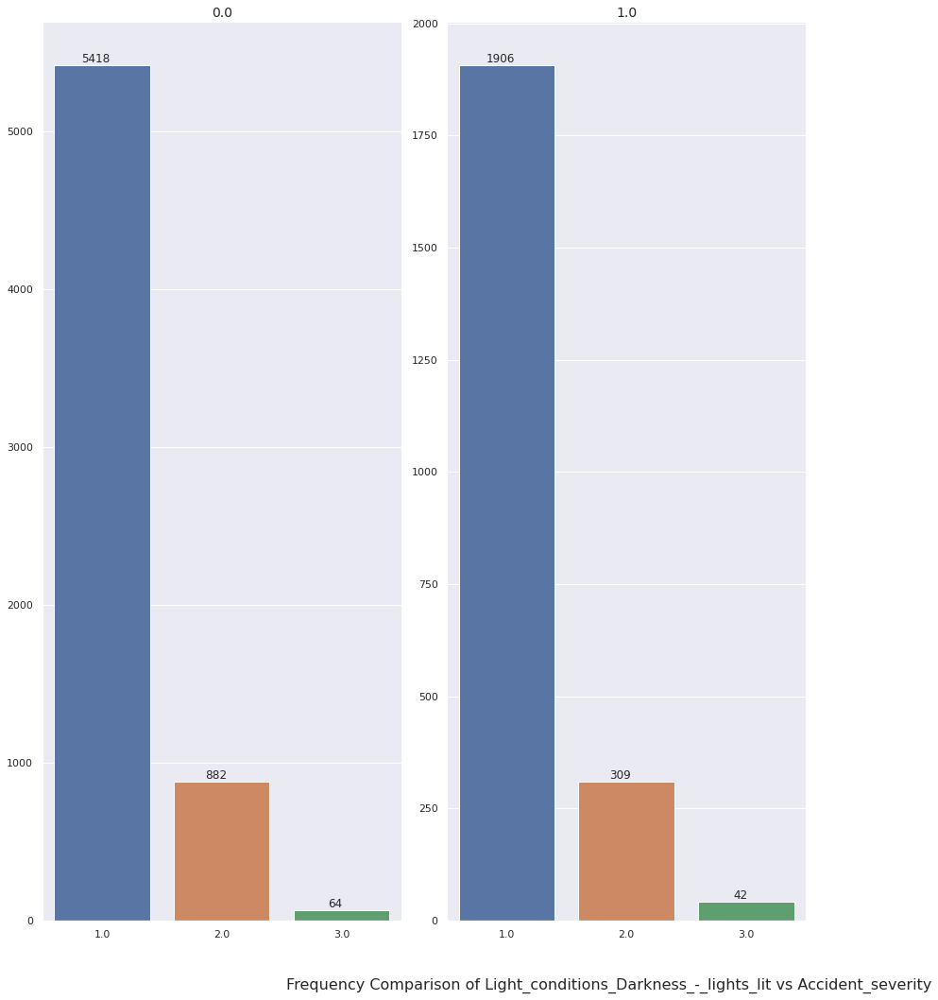




Showing Frequency Plots here for Types_of_Junction_Other:



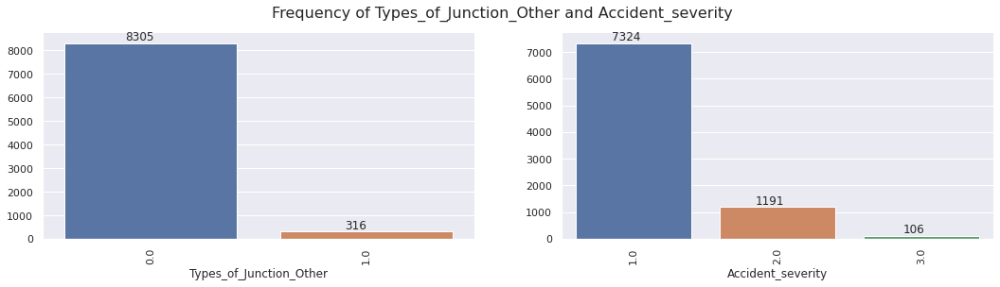


Showing Frequency Comparison of Types_of_Junction_Other vs Accident_severity



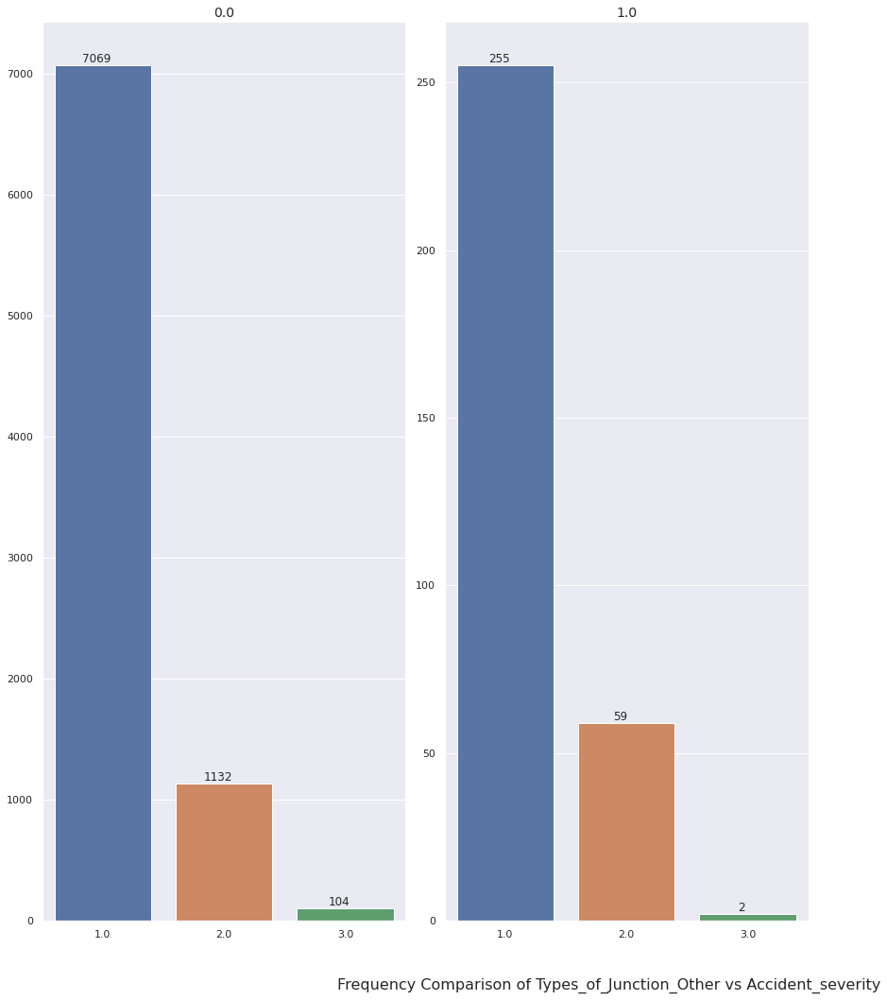




Showing Frequency Plots here for Area_accident_occured_Joined_small_samples:



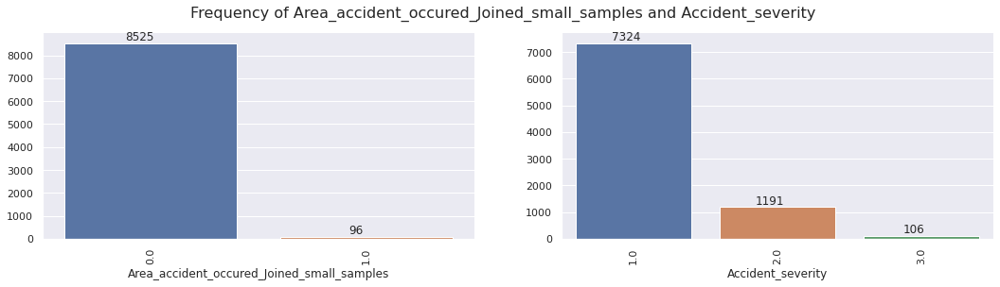


Showing Frequency Comparison of Area_accident_occured_Joined_small_samples vs Accident_severity



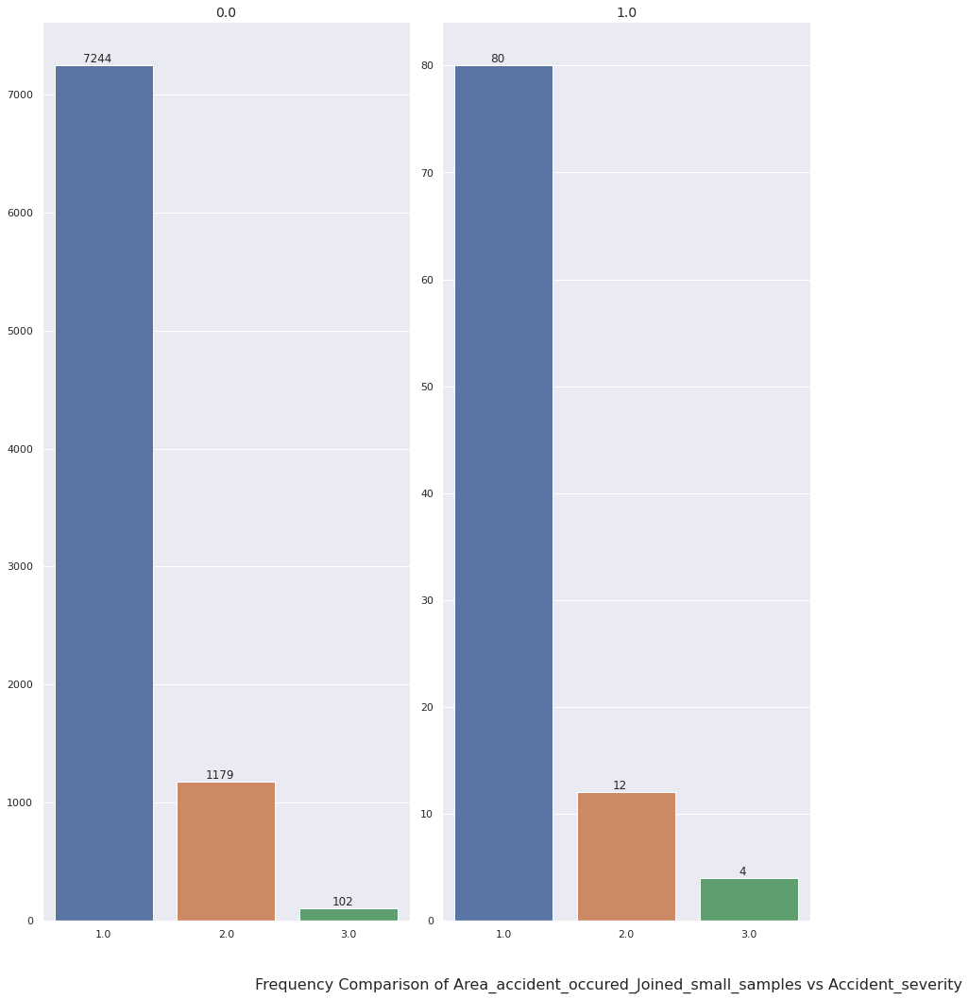




Showing Frequency Plots here for Cause_of_accident_Overtaking:



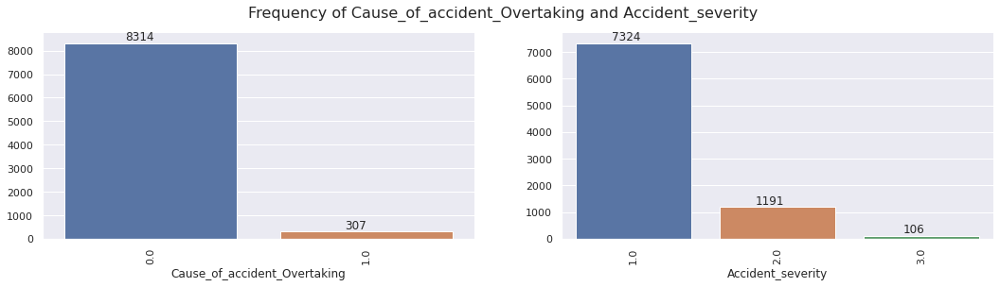


Showing Frequency Comparison of Cause_of_accident_Overtaking vs Accident_severity



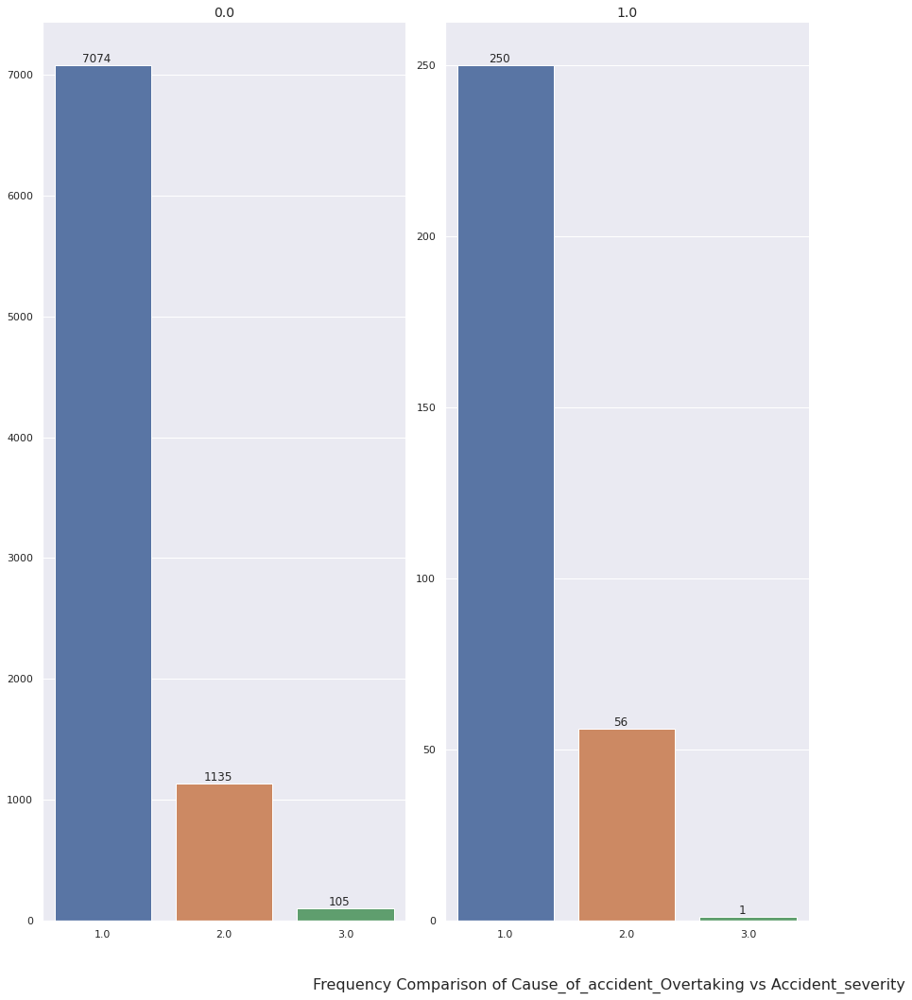




Showing Frequency Plots here for Weather_conditions_Other:



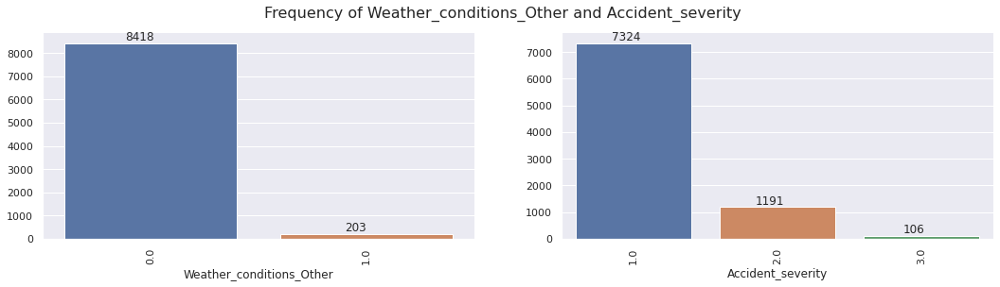


Showing Frequency Comparison of Weather_conditions_Other vs Accident_severity



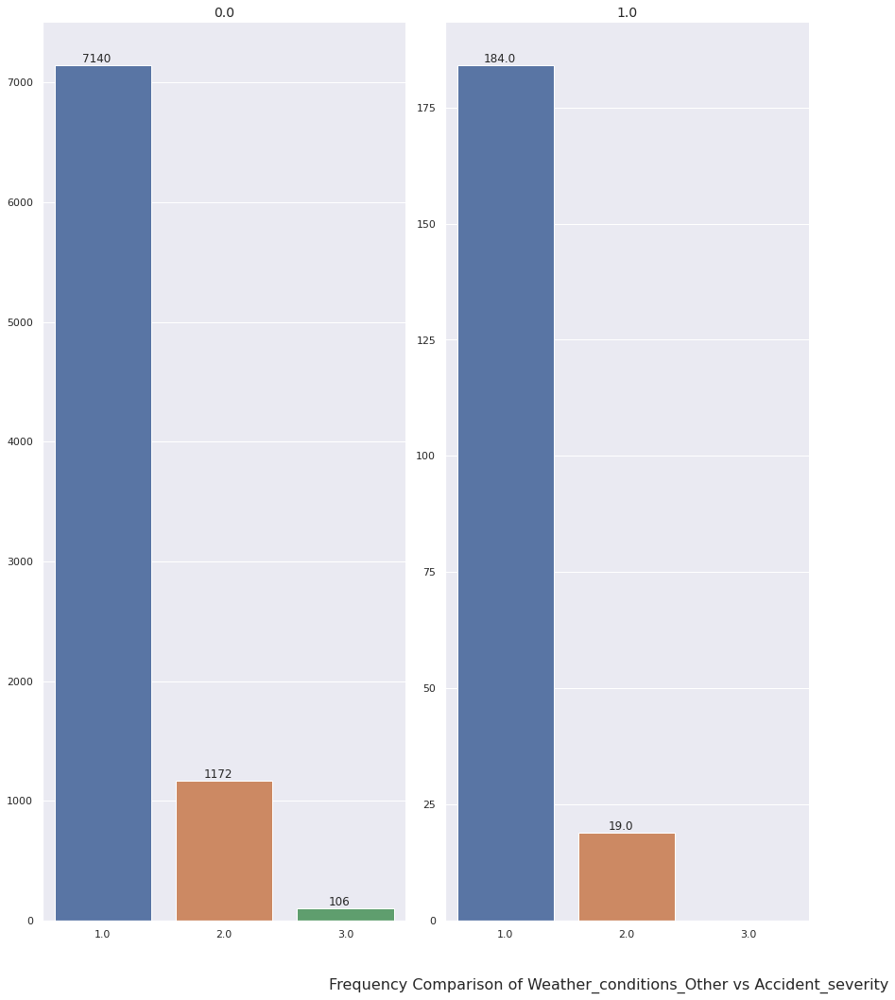




Showing Frequency Plots here for Cause_of_accident_No_priority_to_vehicle:



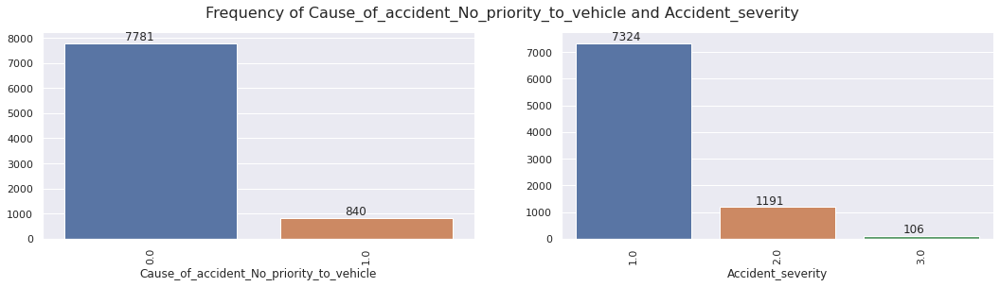


Showing Frequency Comparison of Cause_of_accident_No_priority_to_vehicle vs Accident_severity



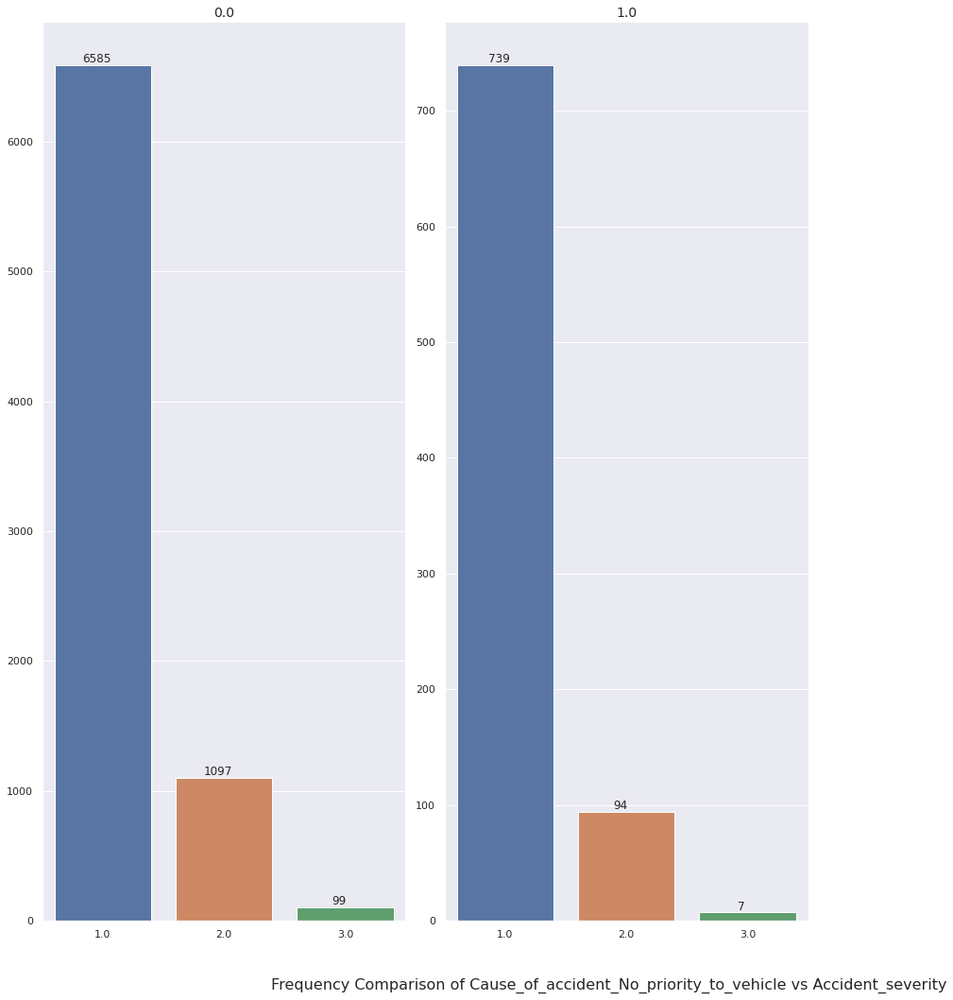

In [51]:
for col in chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index:
    column_barplot(df_cat, col, "Accident_severity", (18, 4))

In [52]:
df_cat.head()

,Time_of_day_Morning,Time_of_day_Afternoon,Time_of_day_Evening,Day_of_week_Sunday,Day_of_week_Saturday,Day_of_week_Tuesday,Day_of_week_Monday,Day_of_week_Thursday,Day_of_week_Friday,Age_band_of_driver_31-50,...,Cause_of_accident_No_distancing,Cause_of_accident_No_priority_to_pedestrian,Cause_of_accident_Moving_Backward,Cause_of_accident_Other,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overturning,Accident_severity
4759,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5676,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
353,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
6223,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
456,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0


In [53]:
df_chi = df_cat[list(selected_cols[0]) + [target_col]]

In [54]:
df_test_chi = df_test_cat[list(selected_cols[0]) + [target_col]]

In [55]:
# Checking the columns of train and test data are equal
assert list(df_test_chi.columns) == list(df_chi.columns)

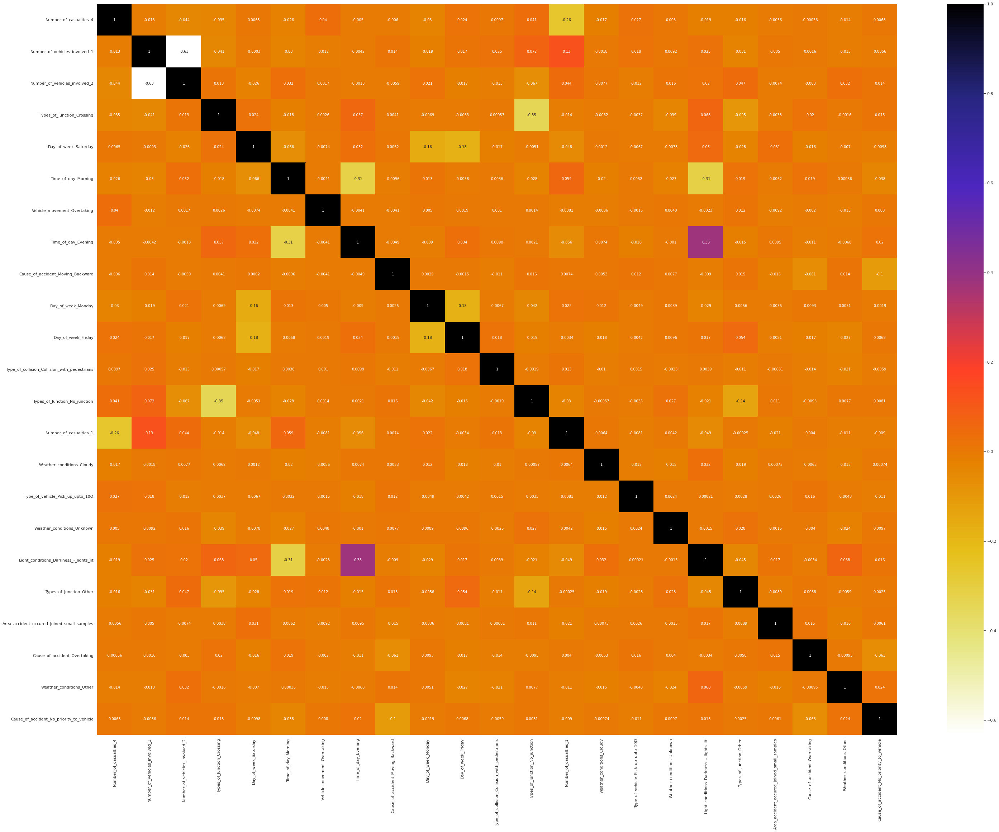

In [56]:
# Checking the modified Heatmap
data_heat = df_chi.drop(target_col, axis = 1)
fig_len = 50
heatmap(data_heat, (fig_len, fig_len*0.75))

## Analysis

#### Train Test split for analysis

In [57]:
X_train, y_train = predictor_target_split(df_chi, target_col)
X_test, y_test = predictor_target_split(df_test_chi, target_col)

#### General function

In [58]:
# Computation of confusion matrix
def conf_mat(y_pred, y_test):
    class_names = ['Slight', 'Serious', 'Fatal']
    tick_marks_y = [0.5, 1.5, 2.5]
    tick_marks_x = [0.5, 1.5, 2.5]
    confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
    confusion_matrix_df = pd.DataFrame(confusion_matrix, range(3), range(3))
    plt.figure(figsize = (6, 4.75))
    sns.set(font_scale = 1.4) # label size
    plt.title("Confusion Matrix")
    sns.heatmap(confusion_matrix_df, annot = True, annot_kws = {"size": 16}, fmt = 'd') # font size
    plt.yticks(tick_marks_y, class_names, rotation = 'vertical')
    plt.xticks(tick_marks_x, class_names, rotation = 'horizontal')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.grid(False)
    plt.show()

# Objective function
def objective_func(trial, mdl, model_type, data = X_train, target = y_train, bta = 0.2):
    if model_type == "rf":
        param = {
            "n_estimators": trial.suggest_int("n_estimators", 20, 200),
            "max_depth": trial.suggest_int("max_depth", 2, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "max_features": trial.suggest_float("max_features", 0.01, 0.95),
            # "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 2, 20),
            # "min_weight_fraction_leaf": trial.suggest_float("min_weight_fraction_leaf", 0.0, 0.4)
        }
    if model_type == "dt":
        param = {
            "max_depth": trial.suggest_int("max_depth", 2, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "max_features": trial.suggest_float("max_features", 0.01, 0.95),
            "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 2, 20)
        }
    if model_type == "gnb":
        param = {
            "var_smoothing": trial.suggest_float("var_smoothing", 1e-9, 0.5)
        }

    model = mdl(**param)
    fbeta_scorer = metrics.make_scorer(metrics.fbeta_score, beta=bta, average="weighted")
    kfolds = KFold(n_splits = 6, shuffle = True, random_state = 445)
    scores = cross_val_score(model, data, target, cv = kfolds, scoring = fbeta_scorer)
    return scores.mean()

# Tuning function
def tuner(objective, n = 20, direction = 'maximize'):

    # Create Study object
    study = optuna.create_study(direction = direction)

    # Optimize the study
    study.optimize(objective, n_trials = n)
    display(optuna.visualization.plot_optimization_history(study))

    # Print the result
    best_params = study.best_params
    best_score = study.best_value
    print(f"Best Fbeta score: {best_score}")
    print(f"Optimized parameters: {best_params}\n")
    print("-------- Tuning complete --------")
    
    # Return best parameters for the model
    plt.show()
    return best_params, best_score

#### Baseline Model

In [59]:
# Summary dictionary initialization
f1_dict = {}

Decicion Tree:-

Weighted F1-score on the test set: 0.7773204576389567


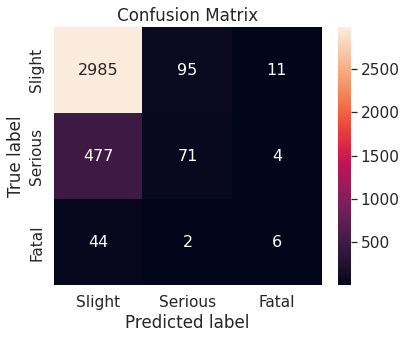

In [60]:
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [61]:
t_score = metrics.fbeta_score(y_train, dt.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Decision Tree'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.8808430325850568


Random Forest:-

Weighted F1-score on the test set: 0.7800724508058965


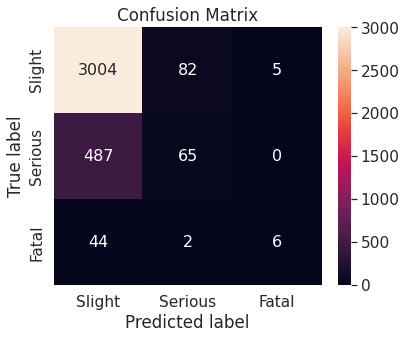

In [62]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [63]:
t_score = metrics.fbeta_score(y_train, rf.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Random Forest'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.8779533936918154


XGBoost:-

Weighted F1-score on the test set: 0.7577744667478398


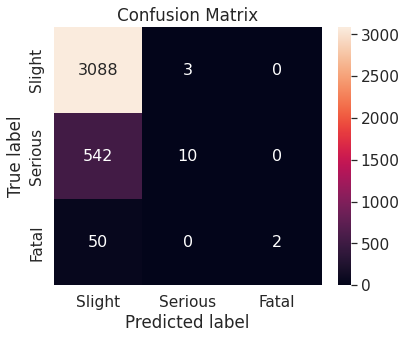

In [64]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)
y_pred = xgb.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [65]:
t_score = metrics.fbeta_score(y_train, xgb.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['XGBoost'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7976651993568283


Extra Trees:-

Weighted F1-score on the test set: 0.783086005597329


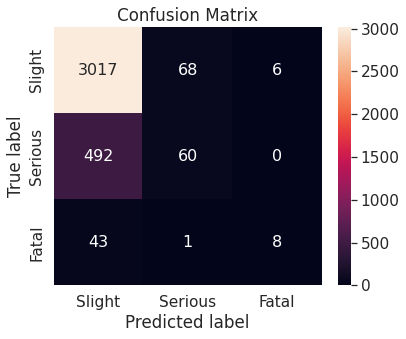

In [66]:
extree = ExtraTreesClassifier()
extree.fit(X_train, y_train)
y_pred = extree.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [67]:
t_score = metrics.fbeta_score(y_train, extree.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['ExtraTrees'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.8808430325850568


Logistic Regression:-

Weighted F1-score on the test set: 0.7041328603311099


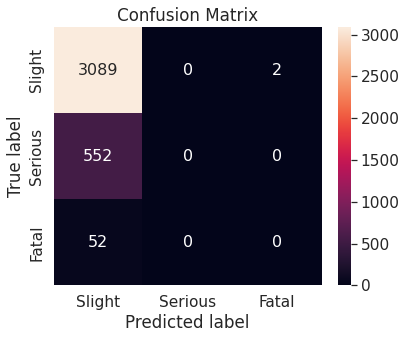

In [68]:
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [69]:
t_score = metrics.fbeta_score(y_train, lr.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Logistic'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7278530599317081


KNeighbors:-

Weighted F1-score on the test set: 0.7768003897405958


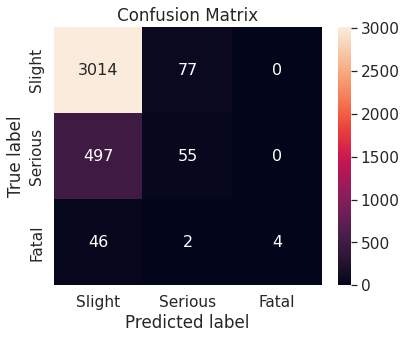

In [70]:
kn = KNeighborsClassifier()
kn.fit(X_train, y_train)
y_pred = kn.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [71]:
t_score = metrics.fbeta_score(y_train, kn.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['KNeighbors'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.8313240232830587


GaussianNB:-

Weighted F1-score on the test set: 0.41902188622784603


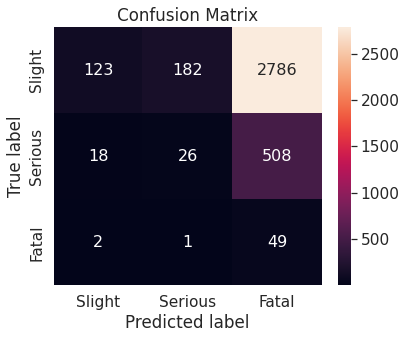

In [72]:
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred = gnb.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [73]:
t_score = metrics.fbeta_score(y_train, gnb.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['GaussianNB'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.42667894166222675


Linear Discriminant Analysis:-

Weighted F1-score on the test set: 0.7081313507241201


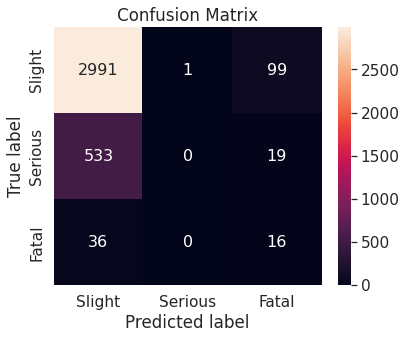

In [74]:
lda = LinearDiscriminantAnalysis()
lda.fit(X_train, y_train)
y_pred = lda.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [75]:
t_score = metrics.fbeta_score(y_train, lda.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Linear Discriminant Analysis'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7355030604270113


SGD Classifier:-

Weighted F1-score on the test set: 0.704219731276425


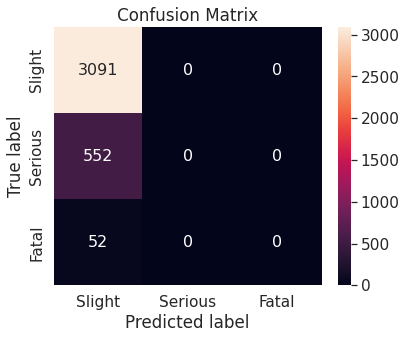

In [76]:
sgd = SGDClassifier()
sgd.fit(X_train, y_train)
y_pred = sgd.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [77]:
t_score = metrics.fbeta_score(y_train, sgd.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['SGD Classifier'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7259416003798568


Ridge Classifier:-

Weighted F1-score on the test set: 0.704219731276425


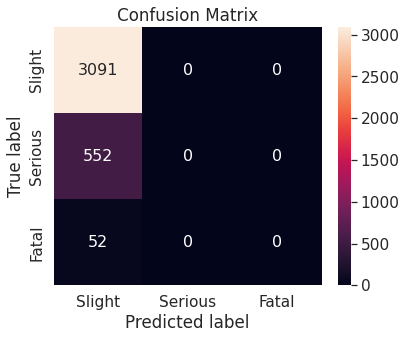

In [78]:
rc = RidgeClassifier()
rc.fit(X_train, y_train)
y_pred = rc.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [79]:
t_score = metrics.fbeta_score(y_train, rc.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Ridge Classifier'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7259416003798568


AdaBoostClassifier

Weighted F1-score on the test set: 0.7079480623882403


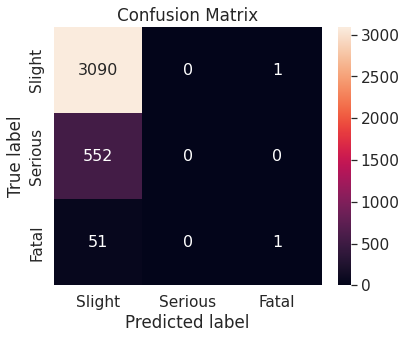

In [80]:
abc = AdaBoostClassifier()
abc.fit(X_train, y_train)
y_pred = abc.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
conf_mat(y_pred, y_test)

In [81]:
t_score = metrics.fbeta_score(y_train, abc.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Ada Boost Classifier'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))

Weighted F1-score on the train set: 0.7410762221750301


In [82]:
# Summary dataframe
f1_df = pd.DataFrame(f1_dict.items(), columns = ['Classifier', 'F1-score (test vs train)'])
f1_df.sort_values(by = ['F1-score (test vs train)'][0], ascending = False)

,Classifier,F1-score (test vs train)
3,ExtraTrees,"(0.783086005597329, -----------, 0.88084303258..."
1,Random Forest,"(0.7800724508058965, -----------, 0.8779533936..."
0,Decision Tree,"(0.7773204576389567, -----------, 0.8808430325..."
5,KNeighbors,"(0.7768003897405958, -----------, 0.8313240232..."
2,XGBoost,"(0.7577744667478398, -----------, 0.7976651993..."
7,Linear Discriminant Analysis,"(0.7081313507241201, -----------, 0.7355030604..."
10,Ada Boost Classifier,"(0.7079480623882403, -----------, 0.7410762221..."
8,SGD Classifier,"(0.704219731276425, -----------, 0.72594160037..."
9,Ridge Classifier,"(0.704219731276425, -----------, 0.72594160037..."
4,Logistic,"(0.7041328603311099, -----------, 0.7278530599..."


Following classifiers are working better:

* ***Gaussian NB***: Advantage- low overfitting, spread of confusion matrix is good.
* ***Extra Trees Classifier***: Drawback- Medium overfitting, spread of confusion matrix is very bad.
* ***Decision Tree Classifier***: Drawback- Medium overfitting, spread of confusion matrix is *very* bad.
* ***Random Forest Classifier***: Drawback- Medium overfitting, spread of confusion matrix is *very* bad.
* ***KNeighbors Classifier***: Advantage- low overfitting, Drawback- spread of confusion matrix is bad.
* ***Linear Discriminant Analysis***: Advantage- low overfitting, Drawback- spread of confusion matrix is bad.

#### Hyperparameter Tuning

Following classifiers are working better:

* Gaussian NB ✅
* Extra Trees Classifier ✅
* Decision Tree Classifier ✅
* Random Forest Classifier ✅
* KNeighbors Classifier
* Linear Discriminant Analysis

In [83]:
f2_dict = {}

###### Random Forest:-

[I 2022-04-19 08:01:32,774] A new study created in memory with name: no-name-29d7f705-d999-4a26-86f0-d0899244ae0e
[I 2022-04-19 08:01:37,123] Trial 0 finished with value: 0.7955563437412477 and parameters: {'n_estimators': 135, 'max_depth': 15, 'min_samples_split': 8, 'max_features': 0.3179948642812611}. Best is trial 0 with value: 0.7955563437412477.
[I 2022-04-19 08:01:39,876] Trial 1 finished with value: 0.7946898726158742 and parameters: {'n_estimators': 79, 'max_depth': 18, 'min_samples_split': 13, 'max_features': 0.34973436606880987}. Best is trial 0 with value: 0.7955563437412477.
[I 2022-04-19 08:01:40,923] Trial 2 finished with value: 0.7260457014948419 and parameters: {'n_estimators': 47, 'max_depth': 3, 'min_samples_split': 6, 'max_features': 0.6354119953449067}. Best is trial 0 with value: 0.7955563437412477.
[I 2022-04-19 08:01:49,388] Trial 3 finished with value: 0.7991162614393001 and parameters: {'n_estimators': 164, 'max_depth': 14, 'min_samples_split': 4, 'max_feature

Best Fbeta score: 0.803327342096582
Optimized parameters: {'n_estimators': 123, 'max_depth': 15, 'min_samples_split': 6, 'max_features': 0.49047061678065657}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7880143090524367
Weighted F1-score on the train set: 0.8643788152561287


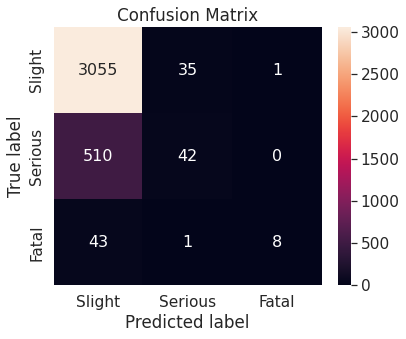

In [84]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_rf(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, RandomForestClassifier, "rf", data, target, bta)

rf_param, rf_score = tuner(objective_rf, n = 200)
rf_tuned = RandomForestClassifier(**rf_param)
rf_tuned.fit(X_train, y_train)
y_pred = rf_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, rf_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Random Forest (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 08:18:28,878] A new study created in memory with name: no-name-deb1f0ac-e405-4f9b-a4f7-5d6c1d52e1a0
[I 2022-04-19 08:18:34,077] Trial 0 finished with value: 0.8237819019048588 and parameters: {'n_estimators': 106, 'max_depth': 17, 'min_samples_split': 20, 'max_features': 0.8476916460193007}. Best is trial 0 with value: 0.8237819019048588.
[I 2022-04-19 08:18:36,122] Trial 1 finished with value: 0.820832040404127 and parameters: {'n_estimators': 91, 'max_depth': 4, 'min_samples_split': 9, 'max_features': 0.5230459653478109}. Best is trial 0 with value: 0.8237819019048588.
[I 2022-04-19 08:18:36,942] Trial 2 finished with value: 0.8294449311773954 and parameters: {'n_estimators': 21, 'max_depth': 15, 'min_samples_split': 5, 'max_features': 0.43534267130102317}. Best is trial 2 with value: 0.8294449311773954.
[I 2022-04-19 08:18:38,101] Trial 3 finished with value: 0.8235007610448561 and parameters: {'n_estimators': 44, 'max_depth': 11, 'min_samples_split': 9, 'max_features'

Best Fbeta score: 0.8325279885736069
Optimized parameters: {'n_estimators': 78, 'max_depth': 15, 'min_samples_split': 5, 'max_features': 0.3766797098441184}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7902696370328713
Weighted F1-score on the train set: 0.8641641980386103


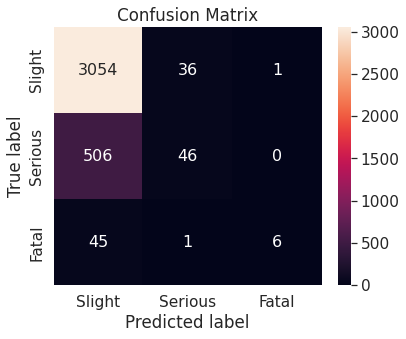

In [85]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_rf(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, RandomForestClassifier, "rf", data, target, bta)

rf_param, rf_score = tuner(objective_rf, n = 200)
rf_tuned = RandomForestClassifier(**rf_param)
rf_tuned.fit(X_train, y_train)
y_pred = rf_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, rf_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Random Forest (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Decision Tree:-

[I 2022-04-19 08:27:18,415] A new study created in memory with name: no-name-ce48bb1e-9c46-4839-8d1a-96da60b789f3
[I 2022-04-19 08:27:18,483] Trial 0 finished with value: 0.7494962281310372 and parameters: {'max_depth': 12, 'min_samples_split': 2, 'max_features': 0.34472073733586567, 'max_leaf_nodes': 7}. Best is trial 0 with value: 0.7494962281310372.
[I 2022-04-19 08:27:18,558] Trial 1 finished with value: 0.7672218924829641 and parameters: {'max_depth': 8, 'min_samples_split': 10, 'max_features': 0.8624933440762282, 'max_leaf_nodes': 9}. Best is trial 1 with value: 0.7672218924829641.
[I 2022-04-19 08:27:18,618] Trial 2 finished with value: 0.7260457014948419 and parameters: {'max_depth': 3, 'min_samples_split': 4, 'max_features': 0.41078436399683976, 'max_leaf_nodes': 9}. Best is trial 1 with value: 0.7672218924829641.
[I 2022-04-19 08:27:18,682] Trial 3 finished with value: 0.7383909708085127 and parameters: {'max_depth': 16, 'min_samples_split': 4, 'max_features': 0.1927627835867

Best Fbeta score: 0.7826575065954176
Optimized parameters: {'max_depth': 13, 'min_samples_split': 6, 'max_features': 0.9006260337451646, 'max_leaf_nodes': 18}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7582436977027583
Weighted F1-score on the train set: 0.7880123490205928


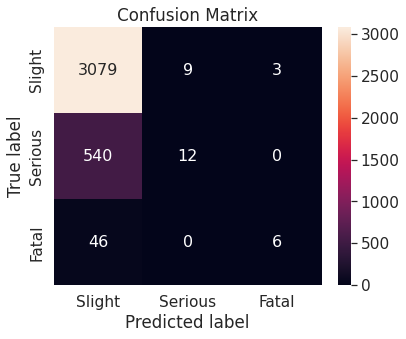

In [86]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_dt(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, DecisionTreeClassifier, "dt", data, target, bta)

dt_param, dt_score = tuner(objective_dt, n = 200)
dt_tuned = DecisionTreeClassifier(**dt_param)
dt_tuned.fit(X_train, y_train)
y_pred = dt_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, dt_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Decision Tree (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 08:27:35,530] A new study created in memory with name: no-name-386ba4ee-d2ce-43ff-a208-453c2ddb8c48
[I 2022-04-19 08:27:35,603] Trial 0 finished with value: 0.8219948727750298 and parameters: {'max_depth': 6, 'min_samples_split': 5, 'max_features': 0.8135674518487861, 'max_leaf_nodes': 10}. Best is trial 0 with value: 0.8219948727750298.
[I 2022-04-19 08:27:35,675] Trial 1 finished with value: 0.8236928320726274 and parameters: {'max_depth': 4, 'min_samples_split': 10, 'max_features': 0.708072126530259, 'max_leaf_nodes': 11}. Best is trial 1 with value: 0.8236928320726274.
[I 2022-04-19 08:27:35,742] Trial 2 finished with value: 0.8214907503464586 and parameters: {'max_depth': 17, 'min_samples_split': 19, 'max_features': 0.2125153346358014, 'max_leaf_nodes': 17}. Best is trial 1 with value: 0.8236928320726274.
[I 2022-04-19 08:27:35,804] Trial 3 finished with value: 0.8204991413270818 and parameters: {'max_depth': 2, 'min_samples_split': 2, 'max_features': 0.6938167190553

Best Fbeta score: 0.8261084157307325
Optimized parameters: {'max_depth': 11, 'min_samples_split': 10, 'max_features': 0.7735443983077883, 'max_leaf_nodes': 20}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7602127437456442
Weighted F1-score on the train set: 0.7912309601203132


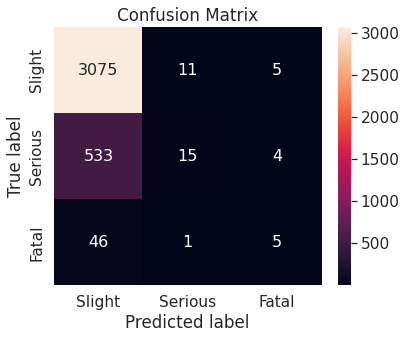

In [87]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_dt(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, DecisionTreeClassifier, "dt", data, target, bta)

dt_param, dt_score = tuner(objective_dt, n = 200)
dt_tuned = DecisionTreeClassifier(**dt_param)
dt_tuned.fit(X_train, y_train)
y_pred = dt_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, dt_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Decision Tree (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Extra Trees Classifier:-

[I 2022-04-19 08:27:52,050] A new study created in memory with name: no-name-751b9c4b-8cb8-4362-983c-d5da76254963
[I 2022-04-19 08:27:55,187] Trial 0 finished with value: 0.7756195766438164 and parameters: {'n_estimators': 111, 'max_depth': 6, 'min_samples_split': 9, 'max_features': 0.5897587874092024}. Best is trial 0 with value: 0.7756195766438164.
[I 2022-04-19 08:27:57,652] Trial 1 finished with value: 0.790430383135511 and parameters: {'n_estimators': 44, 'max_depth': 15, 'min_samples_split': 10, 'max_features': 0.7790096004696501}. Best is trial 1 with value: 0.790430383135511.
[I 2022-04-19 08:28:01,528] Trial 2 finished with value: 0.8005986280681259 and parameters: {'n_estimators': 91, 'max_depth': 15, 'min_samples_split': 6, 'max_features': 0.4841056660785974}. Best is trial 2 with value: 0.8005986280681259.
[I 2022-04-19 08:28:05,904] Trial 3 finished with value: 0.7912933775609851 and parameters: {'n_estimators': 80, 'max_depth': 14, 'min_samples_split': 2, 'max_features': 

Best Fbeta score: 0.8022587487992999
Optimized parameters: {'n_estimators': 114, 'max_depth': 17, 'min_samples_split': 12, 'max_features': 0.17217473039367928}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7684215452252432
Weighted F1-score on the train set: 0.8566263224225602


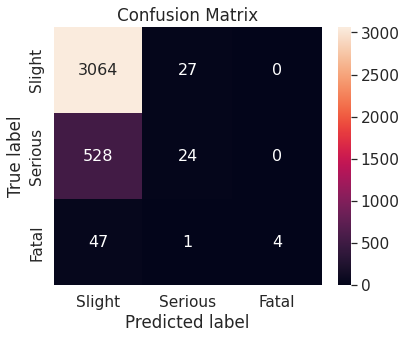

In [88]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_et(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, ExtraTreesClassifier, "rf", data, target, bta)

et_param, et_score = tuner(objective_et, n = 200)
et_tuned = ExtraTreesClassifier(**et_param)
et_tuned.fit(X_train, y_train)
y_pred = et_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, et_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Extra Trees (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 08:39:45,134] A new study created in memory with name: no-name-103fead7-46c2-45fe-bc82-96fec0b16f71
[I 2022-04-19 08:39:46,782] Trial 0 finished with value: 0.8262161438686956 and parameters: {'n_estimators': 32, 'max_depth': 19, 'min_samples_split': 5, 'max_features': 0.5220329794888852}. Best is trial 0 with value: 0.8262161438686956.
[I 2022-04-19 08:39:50,041] Trial 1 finished with value: 0.8230026800906556 and parameters: {'n_estimators': 124, 'max_depth': 4, 'min_samples_split': 19, 'max_features': 0.7902441749601609}. Best is trial 0 with value: 0.8262161438686956.
[I 2022-04-19 08:39:55,212] Trial 2 finished with value: 0.8227511439718951 and parameters: {'n_estimators': 173, 'max_depth': 4, 'min_samples_split': 18, 'max_features': 0.9467171587070157}. Best is trial 0 with value: 0.8262161438686956.
[I 2022-04-19 08:39:59,548] Trial 3 finished with value: 0.8287205913578104 and parameters: {'n_estimators': 109, 'max_depth': 13, 'min_samples_split': 5, 'max_feature

Best Fbeta score: 0.8315136141527923
Optimized parameters: {'n_estimators': 44, 'max_depth': 15, 'min_samples_split': 7, 'max_features': 0.3391915656051327}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7855080799112789
Weighted F1-score on the train set: 0.867812479407712


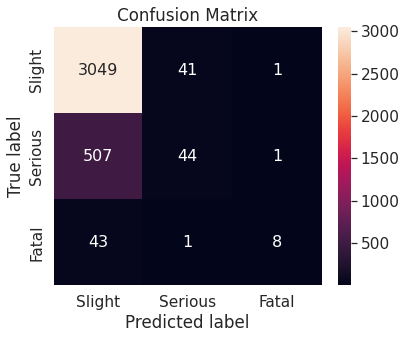

In [89]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_et(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, ExtraTreesClassifier, "rf", data, target, bta)

et_param, et_score = tuner(objective_et, n = 200)
et_tuned = ExtraTreesClassifier(**et_param)
et_tuned.fit(X_train, y_train)
y_pred = et_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, et_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Extra Trees (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Gaussian NB:-

[I 2022-04-19 08:50:01,933] A new study created in memory with name: no-name-9fb47698-c7e6-4cc6-84bb-f3aeda881fcb
[I 2022-04-19 08:50:02,016] Trial 0 finished with value: 0.7751972467622427 and parameters: {'var_smoothing': 0.2832822072713269}. Best is trial 0 with value: 0.7751972467622427.
[I 2022-04-19 08:50:02,088] Trial 1 finished with value: 0.7617893079675883 and parameters: {'var_smoothing': 0.34152995413682163}. Best is trial 0 with value: 0.7751972467622427.
[I 2022-04-19 08:50:02,161] Trial 2 finished with value: 0.7740588049938957 and parameters: {'var_smoothing': 0.22216388031148904}. Best is trial 0 with value: 0.7751972467622427.
[I 2022-04-19 08:50:02,237] Trial 3 finished with value: 0.7547546844870207 and parameters: {'var_smoothing': 0.3983599784333351}. Best is trial 0 with value: 0.7751972467622427.
[I 2022-04-19 08:50:02,310] Trial 4 finished with value: 0.7726034234085094 and parameters: {'var_smoothing': 0.06846156805815132}. Best is trial 0 with value: 0.775197

Best Fbeta score: 0.7776735236133959
Optimized parameters: {'var_smoothing': 0.1462681241343997}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7505411459512124
Weighted F1-score on the train set: 0.7800646140597676


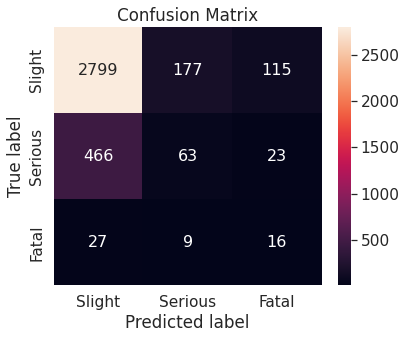

In [90]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_gnb(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, GaussianNB, "gnb", data, target, bta)

gnb_param, gnb_score = tuner(objective_gnb, n = 1000)
gnb_tuned = GaussianNB(**gnb_param)
gnb_tuned.fit(X_train, y_train)
y_pred = gnb_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, gnb_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Gaussian NB (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 08:51:26,249] A new study created in memory with name: no-name-774fed6f-3ead-48d3-860d-2e7229daa235
[I 2022-04-19 08:51:26,326] Trial 0 finished with value: 0.7659455172041278 and parameters: {'var_smoothing': 0.10266833425042764}. Best is trial 0 with value: 0.7659455172041278.
[I 2022-04-19 08:51:26,399] Trial 1 finished with value: 0.7781517669442173 and parameters: {'var_smoothing': 0.12079600349210289}. Best is trial 1 with value: 0.7781517669442173.
[I 2022-04-19 08:51:26,475] Trial 2 finished with value: 0.8208898813105563 and parameters: {'var_smoothing': 0.4809304109077278}. Best is trial 2 with value: 0.8208898813105563.
[I 2022-04-19 08:51:26,553] Trial 3 finished with value: 0.7902415914119394 and parameters: {'var_smoothing': 0.15252890585817322}. Best is trial 2 with value: 0.8208898813105563.
[I 2022-04-19 08:51:26,635] Trial 4 finished with value: 0.6765745819647587 and parameters: {'var_smoothing': 0.01684234823072145}. Best is trial 2 with value: 0.82088

Best Fbeta score: 0.8209107901107805
Optimized parameters: {'var_smoothing': 0.4980313332457633}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7087031870176419
Weighted F1-score on the train set: 0.7408577007165363


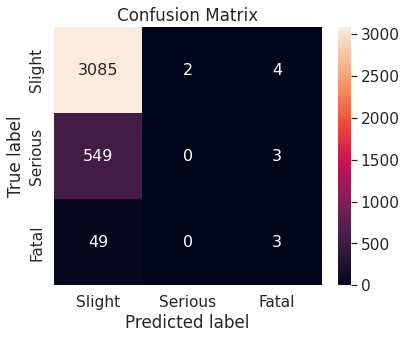

In [91]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_gnb(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, GaussianNB, "gnb", data, target, bta)

gnb_param, gnb_score = tuner(objective_gnb, n = 1000)
gnb_tuned = GaussianNB(**gnb_param)
gnb_tuned.fit(X_train, y_train)
y_pred = gnb_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, gnb_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Gaussian NB (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

##### Summay of F values:

In [92]:
# Summary dataframe
f2_df = pd.DataFrame(f2_dict.items(), columns = ['Classifier', 'F1-score (test vs train)'])
f2_df.sort_values(by = ['F1-score (test vs train)'], ascending = False)

,Classifier,F1-score (test vs train)
1,Random Forest (fbeta 2),"(0.7902696370328713, -----------, 0.8641641980..."
0,Random Forest (fbeta 0.2),"(0.7880143090524367, -----------, 0.8643788152..."
5,Extra Trees (fbeta 2),"(0.7855080799112789, -----------, 0.8678124794..."
4,Extra Trees (fbeta 0.2),"(0.7684215452252432, -----------, 0.8566263224..."
3,Decision Tree (fbeta 2),"(0.7602127437456442, -----------, 0.7912309601..."
2,Decision Tree (fbeta 0.2),"(0.7582436977027583, -----------, 0.7880123490..."
6,Gaussian NB (fbeta 0.2),"(0.7505411459512124, -----------, 0.7800646140..."
7,Gaussian NB (fbeta 2),"(0.7087031870176419, -----------, 0.7408577007..."


Although Random Foreset classifier, Extra Trees Classifier are giving best F score, we should not rely on them as the confusion matrix is implying different.

We rather rely on Gaussian NB Classifier as the outcome of confusion matrix is much better others.

We can safely rely on Gaussian NB as it is barely ovrfitting than other models.

## Final Thoughts

In stage 2, we have one-hot-encoded every column resulting rather worse F value but better confusion matrix. In the next stage, We can combine the last two stage and use both one-hot-encoding and level-encoding combined with chi square test.

# Stage 3

In stage 2, we have one-hot-encoded every column resulting rather worse F value but better confusion matrix. In the next stage, We can combine the last two stage and use both one-hot-encoding and level-encoding combined with chi square test.

#### Parameters

In [3]:
chi_alpha = 0.01

## General Functions

### All purpose use

In [4]:
def format_float(x):
    return "{:.2f}".format(x)

def uniques(df, max_unique_values=20):
    '''
    This function returns a dataframe with unique value of each
    categorical column along with persentages of each categories.
    Input: Pandas DataFrame, max number of unique values should contain
           so that the the column quilifies as categorical data
    Output: Columns with unique values with ratio (in persentage)
    packages required: pandas, numpy
    '''
    column_list = df.columns
    df_len = len(df)
    req_col_list = []
    for column in column_list:
        x = len(df[column].unique())
        if x <= max_unique_values:
            req_col_list.append(column)
    df = df[req_col_list]
    d = {}
    for col in req_col_list:
        d[col] = []
        l = list(df[col].unique())
        if np.nan in l:
            l.remove(np.nan)
        col_value_counts = ((df[col].value_counts())/df_len) * 100
        for x in l:
            d[col].append(str(x) + ": " + str(format_float(col_value_counts[x])) + "%")
        if len(d[col]) < max_unique_values:
            d[col].extend([np.nan] * (max_unique_values - len(d[col])))

    df_uniques = pd.DataFrame(d)
    return df_uniques

def add_annotations(ax):
    '''
    Assign annotation to bar plot
    '''
    for p in ax.patches:
        frequency = p.get_height()
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_y() + p.get_height()
        ax.annotate(f'{frequency}', (x, y), size = 12, ha = 'center', va = 'bottom')

def column_barplot(df, column, target_col, top_fig_size=(20, 4), importance=2):
    '''
    This function give barplots for a cloumn along with th target column.
    In addition to that, it shows the relation between the column and the target column with barplot.
    Input: DataFrame, column with which you want to compare the target column, target column,
           figure size of main (first two) plots, importance which specifies if you want
           only top plot(1) or every plot.
    Output: Plots (no return)
    '''
    print("Showing Frequency Plots here for {}:\n".format(column))
    plt.figure(figsize = top_fig_size)
    ax_col = plt.subplot(1, 2, 1)
    count = sns.countplot(x = df[column])
    ax_col.set_xticklabels(labels = ax_col.get_xticklabels(), rotation = 90)
    ax_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_col)
    ax_target_col = plt.subplot(1, 2, 2)
    count = sns.countplot(x = df[target_col])
    ax_target_col.set_xticklabels(labels = ax_target_col.get_xticklabels(), rotation = 90)
    ax_target_col.set_ylabel('')
    sns.despine(top = True, right = True)
    add_annotations(ax_target_col)
    plt.suptitle("Frequency of {} and {}".format(column, target_col), fontsize = 16)
    if importance == 1:
        plt.show()
    else:
        plt.show()

        print("\nShowing Frequency Comparison of {} vs {}\n".format(column, target_col))
        plt.figure(figsize = (18, 14))
        elements = list(df[column].unique())
        target_els = list(df[target_col].unique())
        if np.nan in elements:
            elements.remove(np.nan)
        l = len(elements)
        d = int(l / 3) + 1

        for i in range(l):
            ax = plt.subplot(d, 3, i+1)
            sub_df = df[df[column] == elements[i]]
            count = sns.countplot(x = sub_df[target_col], order=target_els)
            ax.set_title(str(elements[i]), fontsize=14)
            ax.set_xlabel('')
            ax.set_ylabel('')
            sns.despine(top = True, right = True)
            add_annotations(ax)
        plt.tight_layout()
        plt.suptitle("Frequency Comparison of {} vs {}".format(column, target_col), y=-0.03, fontsize = 16)
        plt.show()
    print("\n\n")

def na_count_table(df, show_missing_only=True):
    d = {"column": [], "na_count": [], "ratio (in persentage)": [], "is_missing": []}
    l = len(df)
    for col in df.columns:
        d["column"].append(col)
        d["na_count"].append(df[col].isna().sum())
        d["is_missing"].append(True if df[col].isna().sum() > 0 else False)
        d["ratio (in persentage)"].append(float(format_float((df[col].isna().sum() * 100) / l)))
    df_ = pd.DataFrame(d)
    if show_missing_only:
        return df_[df_.is_missing == True].drop("is_missing", axis=1)
    else:
        return df_.drop("is_missing", axis=1)

def missing_value_fillup_1(df, missed_col, fill_cats, target_col):
    df_ = df.copy()
    l = []
    for cat in fill_cats:
        df__ = df_[df_[missed_col] == cat]
        df__.drop(missed_col, axis=1, inplace=True)
        l.append(df__)
    final_values = []
    for df__ in l:
        x = []
        cols = [col for col in df__.columns if col is not target_col]
        for col in cols:
            x.append(max(df__[col].value_counts().to_dict().values()))
        final_values.append(int(sum(x) / len(x)))
    del df__
    missed_values = [x / sum(final_values) for x in final_values]
    df_["temp_col"] = df_[missed_col].apply(lambda x: True if x is np.nan else False)
    df_[missed_col] = df_.apply(lambda x: np.random.choice(fill_cats, p=missed_values) if x["temp_col"] else x[missed_col], axis=1)
    df_.drop("temp_col", axis=1, inplace=True)
    return df_

def convert_to_na(df, col, cats):
    df_ = df.copy()
    for cat in cats:
        assert cat in df_[col].unique(), f"Category {cat} is not in column {col}"
        df_[col] = df_[col].apply(lambda x: np.nan if x == cat else x)
    return df_

def cat_data_encoding(df, target_col, ohe=None, le=None, le_order=None):
    '''
    This function encode all column provided in the function arguments.
    The takes dataframe, target column, to be one-hot-encoded columns as 
    list, to be label-encoded columns as list and a list of lists which 
    contain the order of categories in  to be label-encoded columns.
    Note that the order should contain very categories of a column to
    be label-encoded. It also moves the target column to last. You 
    need to have each category as strings. Returns the modified
    dataframe.
    '''
    df_ = df.copy()
    assert target_col not in ohe, "Target column should not be label encoded"
    # one-hot-encoding
    if ohe is not None:
        for col in ohe:
            cats = list(df_[col].unique())
            assert np.nan not in cats, f"Remove NaN from column {col}"
            for cat in cats:
                df_[col + "_" + "_".join(cat.split(" "))] = df_[col].apply(lambda x: 1.0 if x == cat else 0)
            df_.drop(col, axis=1, inplace=True)
            df_.drop(sorted([col + "_" + "_".join(f.split(" ")) for f in cats])[-1], axis=1, inplace=True)
    # label-encoding
    if le is not None:
        assert len(le) == len(le_order), "Length of label encoding column and label encoding column order is not same."
        for i in range(len(le)):
            cats = list(df_[le[i]].unique())
            assert np.nan not in cats, f"Remove NaN from column {le[i]}"
            assert sorted(le_order[i]) == sorted(cats), f"The category order of column {le[i]} missing something..."
            d = {}
            idx = 1.0
            for cat in le_order[i]:
                d[cat] = idx
                idx += 1.0
            df_[le[i]] = df_[le[i]].map(d)
    # putting target column at the end of dataframe
    x = df_.pop(target_col)
    df_.insert(len(df_.columns), target_col, x)
    return df_

def heatmap(data, fig_size=(36, 27)):
    '''
    Generates Heatmap
    '''
    plt.figure(figsize = fig_size)
    sns.heatmap(data.corr(), annot = True, cmap = plt.cm.CMRmap_r)

def predictor_target_split(data, target):
    '''
    Splits target from main dataframe
    '''
    y = data[target] # target variable
    X = data.drop(target, axis = 1) # independent variables
    return X, y

def chi2_features_selction(df, target_col, alpha=0.05):
    X_train = df.drop(target_col, axis=1)
    y_train = df[target_col]
    values = chi2(X_train, y_train)
    d = {"stat_value": values[0], "p_value": values[1]}
    p_df = pd.DataFrame(d, index=X_train.columns).sort_values("p_value")
    p_df["Test_result"] = p_df["p_value"].apply(lambda x: "Rejected" if x < alpha else "Fails to reject")
    return p_df

### Dataframe related functions and pipeline

In [5]:
def data_cat_reduction_v2(df):
    '''
    This function reduces the number of categories.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df = df.copy()
    d = {}
    l = [f for f in df.Educational_level.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ["Above high school", "Writing & reading", "Illiterate"] else val
    df["Educational_level"] = df["Educational_level"].map(d)

    d = {}
    l = [f for f in df.Vehicle_driver_relation.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ["Owner", "Other"] else val
    df["Vehicle_driver_relation"] = df["Vehicle_driver_relation"].map(d)

    d = {}
    l = [f for f in df.Type_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Ridden horse', 'Other', 'Bajaj', 'Turbo', 'Motorcycle', 'Special vehicle', 'Bicycle'] else val
    df["Type_of_vehicle"] = df["Type_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Owner_of_vehicle.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ["Governmental", "Organization", "Other"] else val
    df["Owner_of_vehicle"] = df["Owner_of_vehicle"].map(d)

    d = {}
    l = [f for f in df.Area_accident_occured.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['  Recreational areas', ' Industrial areas', 'Other', ' Church areas', '  Market areas', 'Rural village areas', ' Outside rural areas', ' Hospital areas', 'School areas', 'Rural village areasOffice areas', 'Recreational areas'] else val
    df["Area_accident_occured"] = df["Area_accident_occured"].map(d)

    d = {}
    l = [f for f in df.Road_allignment.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Tangent road with mild grade and flat terrain', 'Escarpments', 'Tangent road with rolling terrain', 'Gentle horizontal curve', 'Tangent road with mountainous terrain and', 'Steep grade downward with mountainous terrain', 'Sharp reverse curve', 'Steep grade upward with mountainous terrain'] else val
    df["Road_allignment"] = df["Road_allignment"].map(d)

    d = {}
    l = [f for f in df.Types_of_Junction.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['O Shape', 'Other', 'T Shape', 'X Shape'] else val
    df["Types_of_Junction"] = df["Types_of_Junction"].map(d)

    d = {}
    l = [f for f in df.Road_surface_type.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Earth roads', 'Asphalt roads with some distress', 'Gravel roads', 'Other'] else val
    df["Road_surface_type"] = df["Road_surface_type"].map(d)

    d = {}
    l = [f for f in df.Road_surface_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Snow', 'Flood over 3cm. deep'] else val
    df["Road_surface_conditions"] = df["Road_surface_conditions"].map(d)

    d = {}
    l = [f for f in df.Weather_conditions.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Raining', 'Raining and Windy', 'Cloudy', 'Other', 'Windy', 'Snow', 'Fog or mist'] else val
    df["Weather_conditions"] = df["Weather_conditions"].map(d)

    d = {}
    l = [f for f in df.Type_of_collision.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Collision with roadside-parked vehicles', 'Collision with animals', 'Other', 'Rollover', 'Fall from vehicles', 'Collision with pedestrians', 'With Train'] else val
    df["Type_of_collision"] = df["Type_of_collision"].map(d)

    d = {}
    l = [f for f in df.Vehicle_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['U-Turn', 'Waiting to go', 'Parked', 'Stopping', 'Overtaking', 'Other', 'Entering a junction'] else val
    df["Vehicle_movement"] = df["Vehicle_movement"].map(d)

    d = {}
    l = [f for f in df.Work_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Other', 'Unemployed', 'Student', 'Unknown'] else val
    df["Work_of_casuality"] = df["Work_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Fitness_of_casuality.unique() if f is not np.nan]
    for val in l:
        d[val] = "Others" if val in ['Deaf', 'Other', 'Blind', 'NormalNormal'] else val
    df["Fitness_of_casuality"] = df["Fitness_of_casuality"].map(d)

    d = {}
    l = [f for f in df.Pedestrian_movement.unique() if f is not np.nan]
    for val in l:
        d[val] = "Possibly Pedestrian" if val in ["Crossing from driver's nearside", 'Crossing from nearside - masked by parked or statioNot a Pedestrianry vehicle', 'Unknown or other', 'Crossing from offside - masked by  parked or statioNot a Pedestrianry vehicle', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing)', 'Walking along in carriageway, back to traffic', 'Walking along in carriageway, facing traffic', 'In carriageway, statioNot a Pedestrianry - not crossing  (standing or playing) - masked by parked or statioNot a Pedestrianry vehicle'] else val
    df["Pedestrian_movement"] = df["Pedestrian_movement"].map(d)
    return df

def modify_time_column(df):
    '''
    This function modifies the Time column and converts it
    to categorical column.
    Input: DataFrame
    Output: DataFrame
    Note that this is a function specific to Road Traffic Accidents Severity data.
    '''
    df_ = df.copy()
    df_['Time_of_Day'] = df_.Time.apply(lambda x: int(x.split(":")[0]))
    df_.Time_of_Day = df_.Time_of_Day.apply(lambda x: "Morning" if 6 <= x <= 12 else ("Afternoon" if 12 < x <= 18 else ("Evening" if 18 < x <= 22 else "Night")))
    del df_["Time"]
    t = df_.pop("Time_of_Day")
    df_.insert(0, "Time_of_day", t)
    return df_

def missing_value_imputation_v3(df):
    # missing more than 20%
    ## Service_year_of_vehicle
    df.drop("Service_year_of_vehicle", axis=1, inplace=True)
    ## Defect_of_vehicle
    df.drop("Defect_of_vehicle", axis=1, inplace=True)
    ## Fitness_of_casuality
    df.drop("Fitness_of_casuality", axis=1, inplace=True)
    ## Work_of_casuality
    df.drop("Work_of_casuality", axis=1, inplace=True)

    # missing less than 5%
    ## Area_accident_occured
    df = convert_to_na(df, "Area_accident_occured", ["Unknown"])
    df = missing_value_fillup_1(df, "Area_accident_occured", ['Others', 'Office areas', 'Residential areas'], "Accident_severity")
    ## Road_allignment
    df.Road_allignment.fillna("Tangent road with flat terrain", inplace=True)
    ## Road_surface_type
    df.Road_surface_type.fillna("Asphalt roads", inplace=True)
    ## Type_of_collision
    df = convert_to_na(df, "Type_of_collision", ["Unknown"])
    df.Type_of_collision.fillna("Vehicle with vehicle collision", inplace=True)
    ## Vehicle_movement
    df = convert_to_na(df, "Vehicle_movement", ["Unknown"])
    df.Vehicle_movement.fillna("Going straight", inplace=True)
    ## Owner_of_vehicle
    df.Owner_of_vehicle.fillna("Owner", inplace=True)
    ## Lanes_or_Medians
    df = convert_to_na(df, "Lanes_or_Medians", ["Unknown"])
    df = missing_value_fillup_1(df, "Lanes_or_Medians", ['Undivided Two way', 'Two-way (divided with broken lines road marking)', 'other', 'Double carriageway (median)', 'One way'], "Accident_severity")
    ## Vehicle_driver_relation
    df = convert_to_na(df, "Vehicle_driver_relation", ["Unknown"])
    df.Vehicle_driver_relation.fillna("Employee", inplace=True)
    ## Weather_conditions
    df = convert_to_na(df, "Weather_conditions", ["Unknown"])
    df.Weather_conditions.fillna("Normal", inplace=True)

    # missing more than 5%
    ## Education_level
    df = convert_to_na(df, "Educational_level", ["Unknown"])
    df.Educational_level.fillna("Junior high school", inplace=True)
    ## Driving_experience
    df = convert_to_na(df, "Driving_experience", ["unknown"])
    df = missing_value_fillup_1(df, "Driving_experience", ['1-2yr', 'Above 10yr', '5-10yr', '2-5yr', 'Below 1yr'], "Accident_severity")
    ## Type_of_vehicle
    df = missing_value_fillup_1(df, "Type_of_vehicle", ['Automobile', 'Lorry (41?100Q)'], "Accident_severity")
    ## Types_of_Junction
    df = convert_to_na(df, "Types_of_Junction", ["Unknown"])
    df = missing_value_fillup_1(df, "Types_of_Junction", ['No junction', 'Y Shape', 'Crossing'], "Accident_severity")

    # Remaining missings
    ## Casualty_class
    df.drop("Casualty_class", axis=1, inplace=True)
    ## Sex_of_casualty
    df.drop("Sex_of_casualty", axis=1, inplace=True)
    ## Age_band_of_casualty
    df.drop("Age_band_of_casualty", axis=1, inplace=True)
    ## Casualty_severity
    df.drop("Casualty_severity", axis=1, inplace=True)
    ## Sex_of_driver
    df = convert_to_na(df, "Sex_of_driver", ["Unknown"])
    df.Sex_of_driver.fillna("Male", inplace=True)
    ## Cause_of_accident
    df = convert_to_na(df, "Cause_of_accident", ["Unknown"])
    df.Cause_of_accident.fillna("No distancing", inplace=True)
    ## Age_band_of_driver
    df = convert_to_na(df, "Age_band_of_driver", ["Unknown"])
    df = missing_value_fillup_1(df, "Age_band_of_driver", ['18-30', '31-50'], "Accident_severity")
    return df

def categorical_encoding_df_v2(df):
    df_ = df.copy()
    ohe = ["Time_of_day", "Day_of_week", "Sex_of_driver", "Vehicle_driver_relation", "Type_of_vehicle", "Owner_of_vehicle", \
       "Area_accident_occured", "Lanes_or_Medians", "Road_allignment", "Types_of_Junction", "Road_surface_type", \
       "Road_surface_conditions", "Type_of_collision", "Vehicle_movement", "Pedestrian_movement", "Cause_of_accident"]
    le = ["Age_band_of_driver", "Educational_level", "Driving_experience", "Light_conditions", "Weather_conditions", "Accident_severity"]
    abod = ["Under 18", "18-30", "31-50", "Over 51"]
    edl = ["Elementary school", "High school", "Junior high school", "Others"]
    dre = ["No Licence", "Below 1yr", "1-2yr", "2-5yr", "5-10yr", "Above 10yr"]
    lc = ["Daylight", "Darkness - lights lit", "Darkness - lights unlit", "Darkness - no lighting"]
    wc = ["Normal", "Others"]
    accs = ["Slight Injury", "Serious Injury", "Fatal injury"]
    le_order = [abod, edl, dre, lc, wc, accs]
    df_cat = cat_data_encoding(df_, target_col, ohe=ohe, le=le, le_order=le_order)
    return df_cat

## Understanding The Data

### Re-looking at data

#### Data Head

In [6]:
data.head()

,Time,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,17:02:00,Monday,18-30,Male,Above high school,Employee,1-2yr,Automobile,Owner,Above 10yr,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Moving Backward,Slight Injury
1,17:02:00,Monday,31-50,Male,Junior high school,Employee,Above 10yr,Public (> 45 seats),Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury
2,17:02:00,Monday,18-30,Male,Junior high school,Employee,1-2yr,Lorry (41?100Q),Owner,NaN,...,Going straight,Driver or rider,Male,31-50,3,Driver,NaN,Not a Pedestrian,Changing lane to the left,Serious Injury
3,1:06:00,Sunday,18-30,Male,Junior high school,Employee,5-10yr,Public (> 45 seats),Governmental,NaN,...,Going straight,Pedestrian,Female,18-30,3,Driver,Normal,Not a Pedestrian,Changing lane to the right,Slight Injury
4,1:06:00,Sunday,18-30,Male,Junior high school,Employee,2-5yr,NaN,Owner,5-10yrs,...,Going straight,na,na,na,na,NaN,NaN,Not a Pedestrian,Overtaking,Slight Injury


In [7]:
data.columns

Index(['Time', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Service_year_of_vehicle',
       'Defect_of_vehicle', 'Area_accident_occured', 'Lanes_or_Medians',
       'Road_allignment', 'Types_of_Junction', 'Road_surface_type',
       'Road_surface_conditions', 'Light_conditions', 'Weather_conditions',
       'Type_of_collision', 'Number_of_vehicles_involved',
       'Number_of_casualties', 'Vehicle_movement', 'Casualty_class',
       'Sex_of_casualty', 'Age_band_of_casualty', 'Casualty_severity',
       'Work_of_casuality', 'Fitness_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

#### Categorization of Time column

In [8]:
# Categorizating time column, deleting it, insert categorised column as first column
df = modify_time_column(data)
df.columns

Index(['Time_of_day', 'Day_of_week', 'Age_band_of_driver', 'Sex_of_driver',
       'Educational_level', 'Vehicle_driver_relation', 'Driving_experience',
       'Type_of_vehicle', 'Owner_of_vehicle', 'Service_year_of_vehicle',
       'Defect_of_vehicle', 'Area_accident_occured', 'Lanes_or_Medians',
       'Road_allignment', 'Types_of_Junction', 'Road_surface_type',
       'Road_surface_conditions', 'Light_conditions', 'Weather_conditions',
       'Type_of_collision', 'Number_of_vehicles_involved',
       'Number_of_casualties', 'Vehicle_movement', 'Casualty_class',
       'Sex_of_casualty', 'Age_band_of_casualty', 'Casualty_severity',
       'Work_of_casuality', 'Fitness_of_casuality', 'Pedestrian_movement',
       'Cause_of_accident', 'Accident_severity'],
      dtype='object')

#### Reduction of categories for smoother analysis

In [9]:
# Reduction of Data categories
df = data_cat_reduction_v2(df)
uniques(df)

,Time_of_day,Day_of_week,Age_band_of_driver,Sex_of_driver,Educational_level,Vehicle_driver_relation,Driving_experience,Type_of_vehicle,Owner_of_vehicle,Service_year_of_vehicle,...,Vehicle_movement,Casualty_class,Sex_of_casualty,Age_band_of_casualty,Casualty_severity,Work_of_casuality,Fitness_of_casuality,Pedestrian_movement,Cause_of_accident,Accident_severity
0,Afternoon: 43.76%,Monday: 13.65%,18-30: 34.68%,Male: 92.86%,Others: 4.73%,Employee: 78.17%,1-2yr: 14.26%,Automobile: 26.02%,Owner: 84.92%,Above 10yr: 10.75%,...,Going straight: 66.24%,na: 36.08%,na: 36.08%,na: 36.08%,na: 36.08%,Driver: 47.93%,Normal: 78.01%,Not a Pedestrian: 92.48%,Moving Backward: 9.23%,Slight Injury: 84.56%
1,Night: 7.18%,Sunday: 11.91%,31-50: 33.18%,Female: 5.69%,Junior high school: 61.86%,Unknown: 0.11%,Above 10yr: 18.37%,Public (> 45 seats): 3.28%,Others: 11.16%,5-10yrs: 10.39%,...,Others: 11.25%,Driver or rider: 40.14%,Male: 42.65%,31-50: 19.93%,3: 57.45%,Others: 5.02%,Others: 0.59%,Possibly Pedestrian: 7.52%,Overtaking: 3.49%,Serious Injury: 14.15%
2,Evening: 17.17%,Friday: 16.57%,Under 18: 6.70%,Unknown: 1.45%,Elementary school: 17.56%,Others: 17.02%,5-10yr: 27.31%,Lorry (41?100Q): 17.75%,NaN,1-2yr: 6.71%,...,Moving Backward: 8.00%,Pedestrian: 13.39%,Female: 21.27%,18-30: 25.54%,2: 6.26%,Employee: 4.49%,NaN,NaN,Changing lane to the left: 11.96%,Fatal injury: 1.28%
3,Morning: 31.89%,Wednesday: 14.94%,Over 51: 12.87%,NaN,High school: 9.01%,NaN,2-5yr: 21.22%,Public (13?45 seats): 4.32%,NaN,2-5yrs: 14.55%,...,Turnover: 3.97%,Passenger: 10.39%,NaN,Under 18: 8.40%,1: 0.21%,Self-employed: 16.60%,NaN,NaN,Changing lane to the right: 14.68%,NaN
4,NaN,Saturday: 13.53%,Unknown: 12.57%,NaN,Unknown: 0.81%,NaN,No Licence: 0.96%,Lorry (11?40Q): 4.39%,NaN,Unknown: 23.41%,...,Getting off: 2.75%,NaN,NaN,Over 51: 8.07%,NaN,NaN,NaN,NaN,Overloading: 0.48%,NaN
5,NaN,Thursday: 15.03%,NaN,NaN,NaN,NaN,Below 1yr: 10.90%,Long lorry: 3.11%,NaN,Below 1yr: 2.29%,...,Reversing: 4.57%,NaN,NaN,5: 1.98%,NaN,NaN,NaN,NaN,Other: 3.70%,NaN
6,NaN,Tuesday: 14.37%,NaN,NaN,NaN,NaN,unknown: 0.27%,Public (12 seats): 5.77%,NaN,NaN,...,Unknown: 0.71%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to vehicle: 9.80%,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taxi: 2.15%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No priority to pedestrian: 5.85%,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pick up upto 10Q: 6.58%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No distancing: 18.37%,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Stationwagen: 5.58%,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Getting off the vehicle improperly: 1.60%,NaN


### Preprocessing of the data

#### Train Test Split

In [10]:
# Setting the target column
target_col = "Accident_severity"
# Spliting target column
X, y = predictor_target_split(df, target_col)

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=20)

In [12]:
# Joining X, y for furthers inspection eases
df = pd.concat([X_train, y_train], axis=1)
df_test = pd.concat([X_test, y_test], axis=1)

#### Missing value imputation

In [13]:
df = missing_value_imputation_v3(df)
df_test = missing_value_imputation_v3(df_test)

#### Categorical data encoding

In [14]:
df_cat = categorical_encoding_df_v2(df)
df_test_cat = categorical_encoding_df_v2(df_test)

In [15]:
# train data unique values
uniques(df_cat)

,Age_band_of_driver,Educational_level,Driving_experience,Light_conditions,Weather_conditions,Number_of_vehicles_involved,Number_of_casualties,Time_of_day_Afternoon,Time_of_day_Morning,Time_of_day_Evening,...,Cause_of_accident_Other,Cause_of_accident_Overloading,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Driving_under_the_influence_of_drugs,Cause_of_accident_Overturning,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Overspeed,Cause_of_accident_Drunk_driving,Cause_of_accident_Improper_parking,Accident_severity
0,3.0: 39.72%,1.0: 17.19%,3.0: 15.87%,1.0: 71.86%,1.0: 84.22%,2: 67.86%,1: 68.12%,1.0: 44.07%,0.0: 68.03%,0.0: 82.96%,...,0.0: 96.39%,0.0: 99.51%,0.0: 98.61%,0.0: 97.24%,0.0: 98.86%,0.0: 98.47%,0.0: 99.44%,0.0: 99.79%,0.0: 99.80%,1.0: 84.75%
1,4.0: 12.59%,3.0: 69.31%,5.0: 29.29%,2.0: 26.32%,2.0: 15.78%,1: 15.93%,2: 18.64%,0.0: 55.93%,1.0: 31.97%,1.0: 17.04%,...,1.0: 3.61%,1.0: 0.49%,1.0: 1.39%,1.0: 2.76%,1.0: 1.14%,1.0: 1.53%,1.0: 0.56%,1.0: 0.21%,1.0: 0.20%,2.0: 13.97%
2,2.0: 40.84%,2.0: 8.80%,4.0: 22.60%,3.0: 0.31%,NaN,6: 0.39%,4: 3.29%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0: 1.29%
3,1.0: 6.86%,4.0: 4.70%,6.0: 19.63%,4.0: 1.51%,NaN,3: 12.98%,5: 1.54%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,1.0: 1.03%,NaN,NaN,4: 2.78%,3: 7.42%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,2.0: 11.59%,NaN,NaN,7: 0.06%,6: 0.70%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,8: 0.08%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,7: 0.20%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
# test data unique values
uniques(df_test_cat)

,Age_band_of_driver,Educational_level,Driving_experience,Light_conditions,Weather_conditions,Number_of_vehicles_involved,Number_of_casualties,Time_of_day_Morning,Time_of_day_Afternoon,Time_of_day_Evening,...,Cause_of_accident_Changing_lane_to_the_left,Cause_of_accident_Other,Cause_of_accident_Getting_off_the_vehicle_improperly,Cause_of_accident_Driving_at_high_speed,Cause_of_accident_Driving_to_the_left,Cause_of_accident_Improper_parking,Cause_of_accident_Overloading,Cause_of_accident_Drunk_driving,Cause_of_accident_Overspeed,Accident_severity
0,3.0: 39.49%,1.0: 18.43%,5.0: 29.61%,1.0: 70.45%,1.0: 83.73%,1: 16.86%,2: 18.48%,1.0: 31.69%,0.0: 56.94%,0.0: 82.52%,...,0.0: 88.82%,0.0: 96.08%,0.0: 98.24%,0.0: 98.54%,0.0: 97.59%,0.0: 99.78%,0.0: 99.54%,0.0: 99.76%,0.0: 99.65%,1.0: 84.14%
1,4.0: 13.53%,3.0: 67.25%,3.0: 14.29%,4.0: 1.68%,2.0: 16.27%,3: 12.15%,1: 68.31%,0.0: 68.31%,1.0: 43.06%,1.0: 17.48%,...,1.0: 11.18%,1.0: 3.92%,1.0: 1.76%,1.0: 1.46%,1.0: 2.41%,1.0: 0.22%,1.0: 0.46%,1.0: 0.24%,1.0: 0.35%,2.0: 14.59%
2,2.0: 40.65%,2.0: 9.50%,6.0: 19.89%,2.0: 27.52%,NaN,2: 67.39%,3: 7.28%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0: 1.27%
3,1.0: 6.33%,4.0: 4.82%,4.0: 23.36%,3.0: 0.35%,NaN,4: 3.33%,5: 2.00%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,2.0: 12.07%,NaN,NaN,6: 0.22%,4: 2.98%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,1.0: 0.78%,NaN,NaN,7: 0.05%,6: 0.78%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,7: 0.14%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,8: 0.03%,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
assert list(df_test_cat.columns).sort() == list(df_cat.columns).sort()

#### Future Selection

##### Heatmap

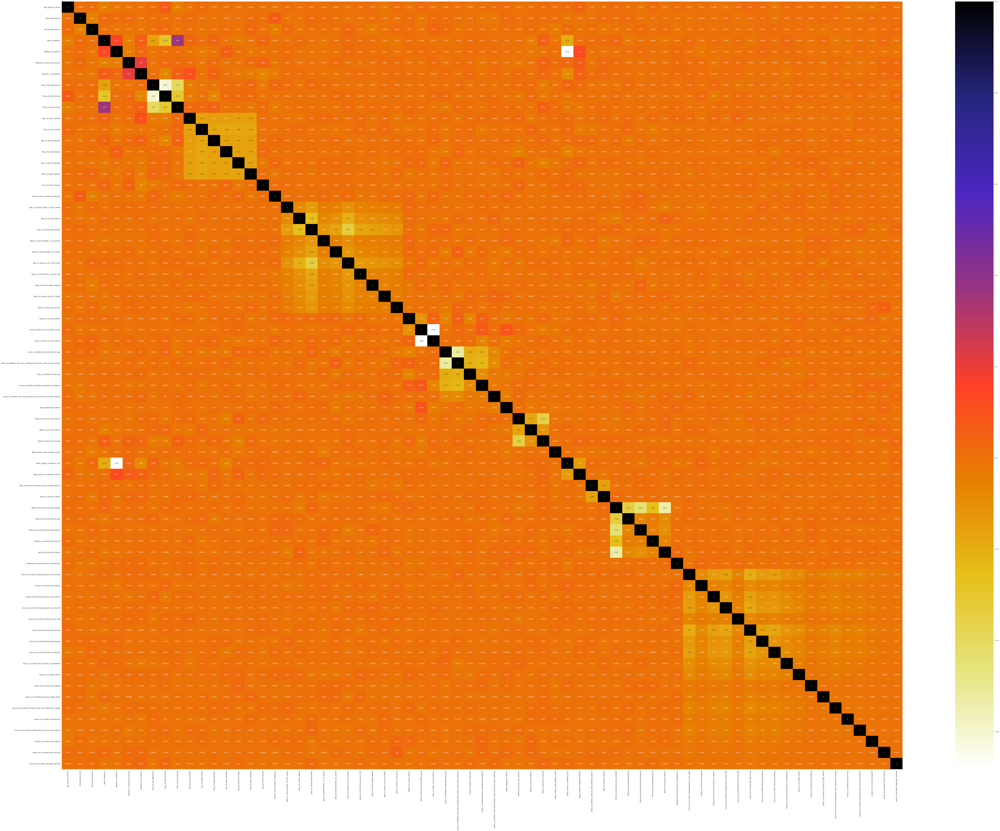

In [18]:
# Heatmap
data_heat = df_cat.drop(target_col, axis = 1)
fig_len = 125
heatmap(data_heat, (fig_len, fig_len*0.75))

##### Chi-Squared Feature Selection

In [19]:
chi2_p_vals = chi2_features_selction(df_cat, target_col, alpha=chi_alpha)
chi2_p_vals

,stat_value,p_value,Test_result
Number_of_casualties,55.814171,7.587640e-13,Rejected
Types_of_Junction_Crossing,20.006611,4.525012e-05,Rejected
Day_of_week_Sunday,16.617411,2.463627e-04,Rejected
Time_of_day_Evening,16.024664,3.313511e-04,Rejected
Number_of_vehicles_involved,15.492219,4.324216e-04,Rejected
...,...,...,...
Pedestrian_movement_Not_a_Pedestrian,0.087770,9.570639e-01,Fails to reject
Lanes_or_Medians_Two-way_(divided_with_solid_lines_road_marking),0.062537,9.692152e-01,Fails to reject
Educational_level,0.057887,9.714712e-01,Fails to reject
Road_surface_type_Asphalt_roads,0.046446,9.770445e-01,Fails to reject


In [20]:
# significant columns
selected_cols = chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index, len(chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index)
selected_cols

(Index(['Number_of_casualties', 'Types_of_Junction_Crossing',
        'Day_of_week_Sunday', 'Time_of_day_Evening',
        'Number_of_vehicles_involved', 'Time_of_day_Morning',
        'Types_of_Junction_No_junction'],
       dtype='object'), 7)

Showing Frequency Plots here for Number_of_casualties:



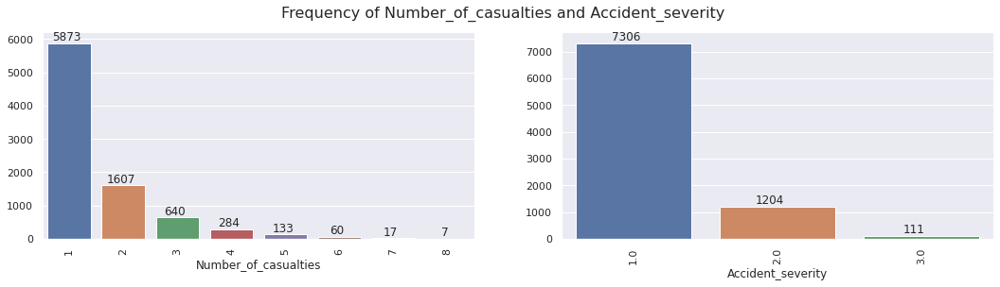


Showing Frequency Comparison of Number_of_casualties vs Accident_severity



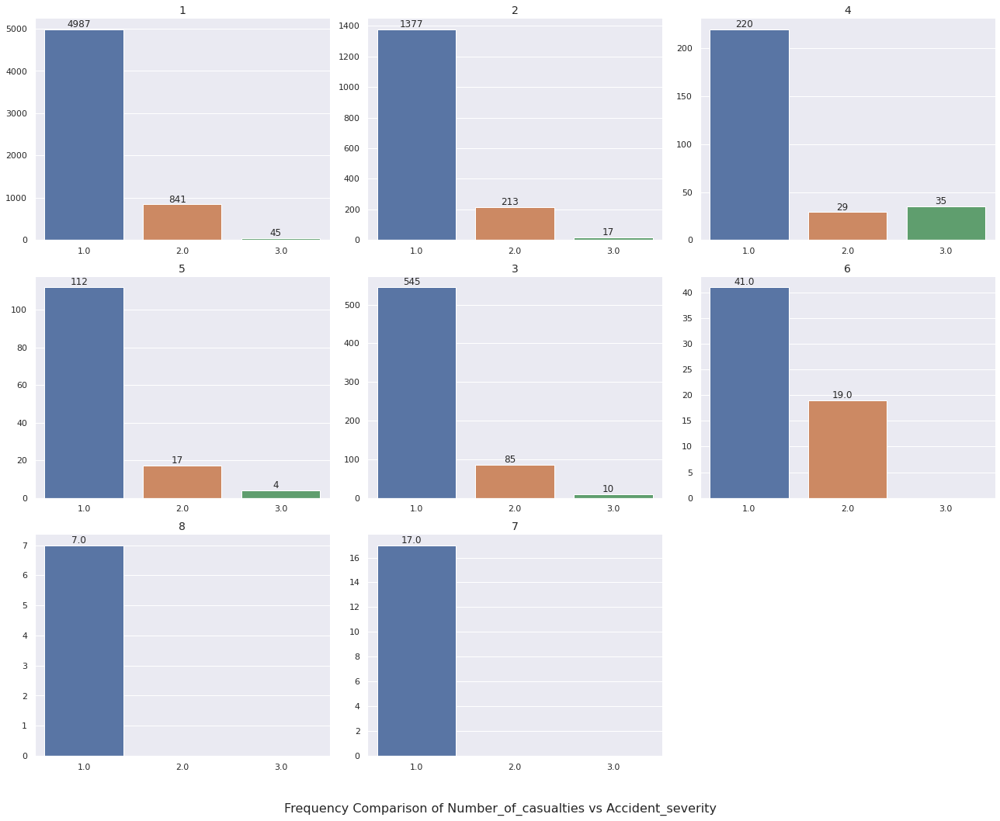




Showing Frequency Plots here for Types_of_Junction_Crossing:



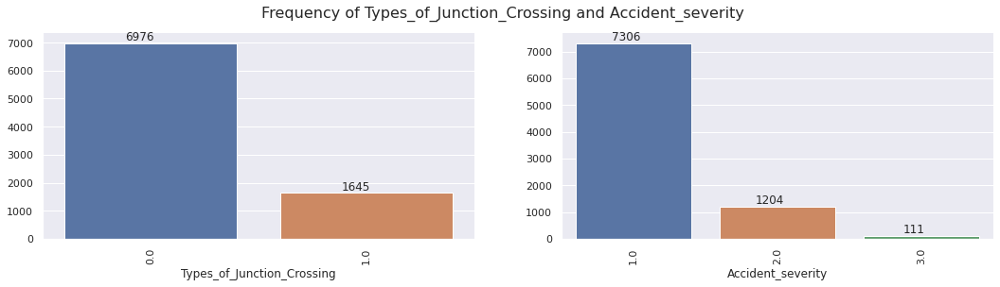


Showing Frequency Comparison of Types_of_Junction_Crossing vs Accident_severity



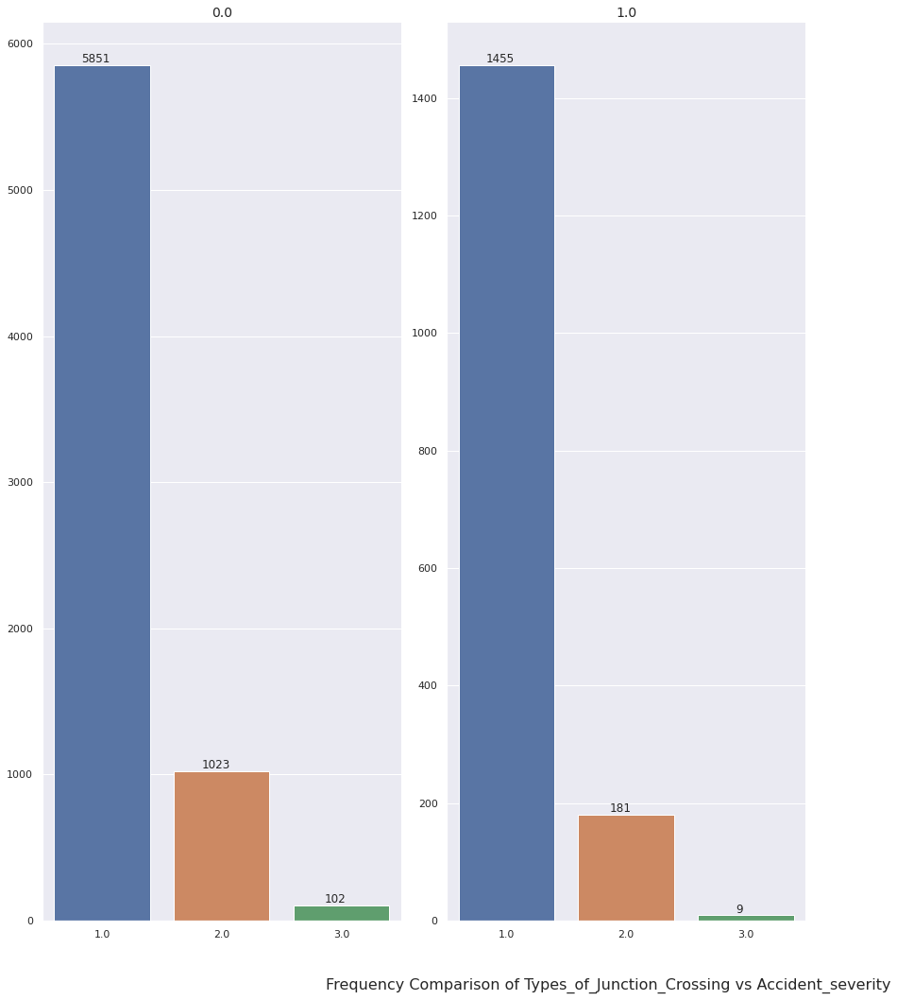




Showing Frequency Plots here for Day_of_week_Sunday:



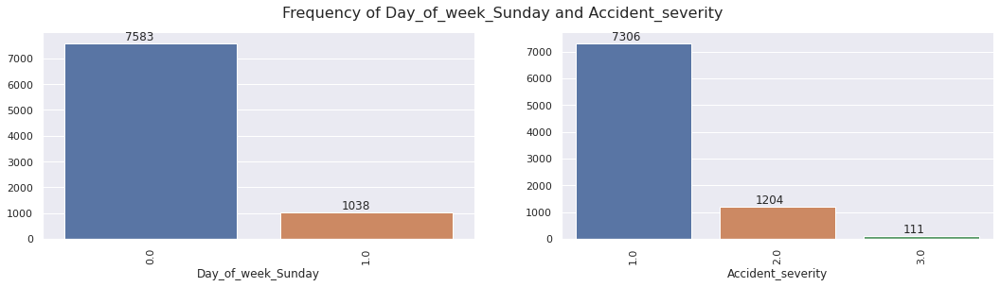


Showing Frequency Comparison of Day_of_week_Sunday vs Accident_severity



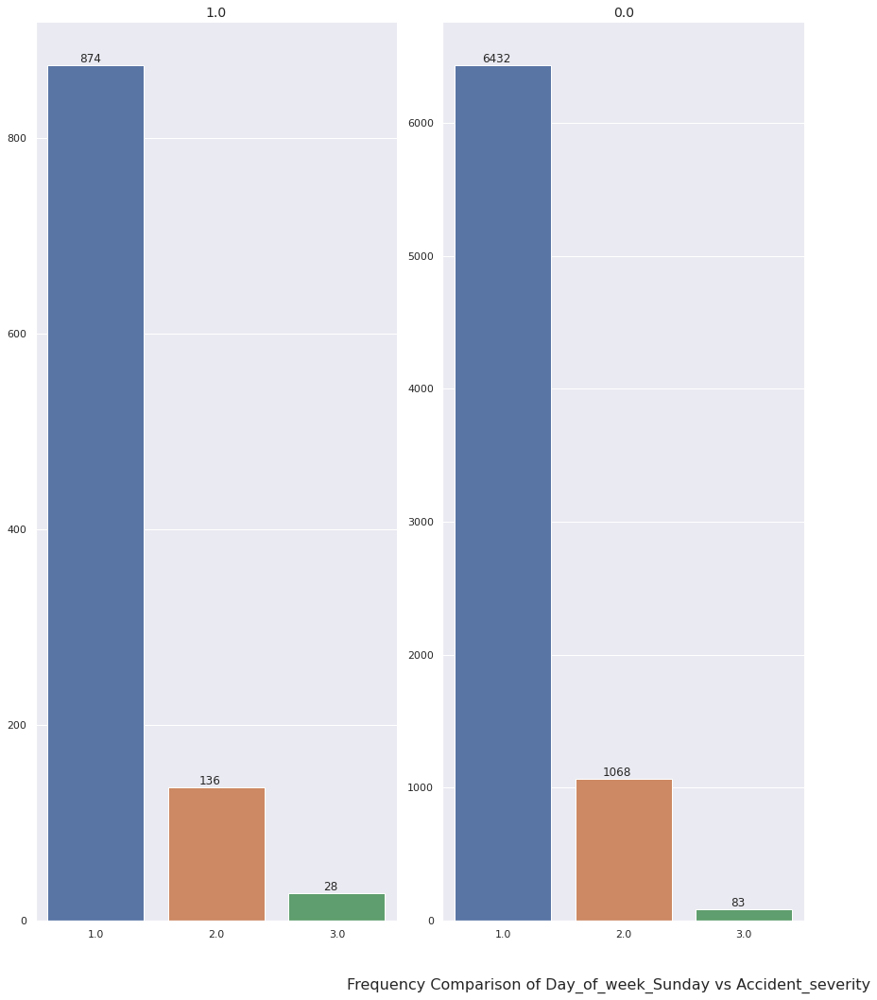




Showing Frequency Plots here for Time_of_day_Evening:



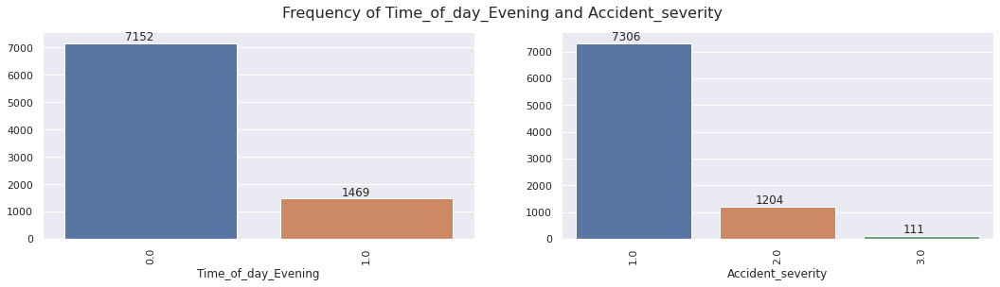


Showing Frequency Comparison of Time_of_day_Evening vs Accident_severity



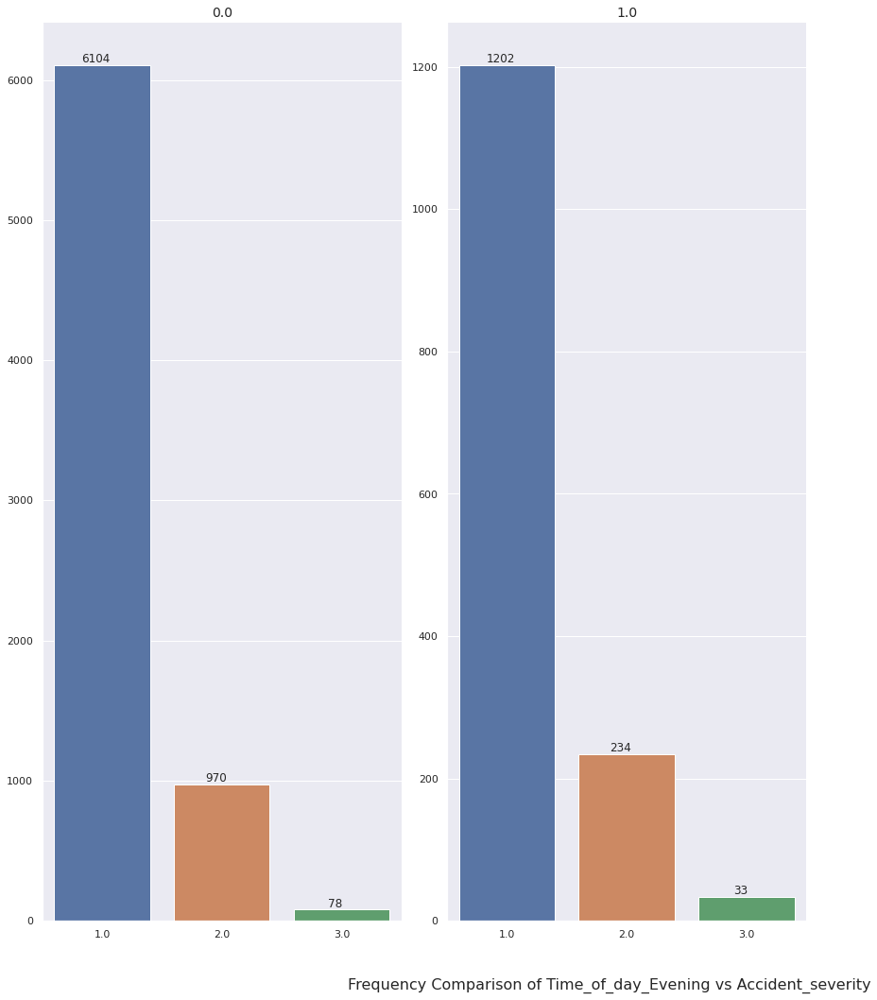




Showing Frequency Plots here for Number_of_vehicles_involved:



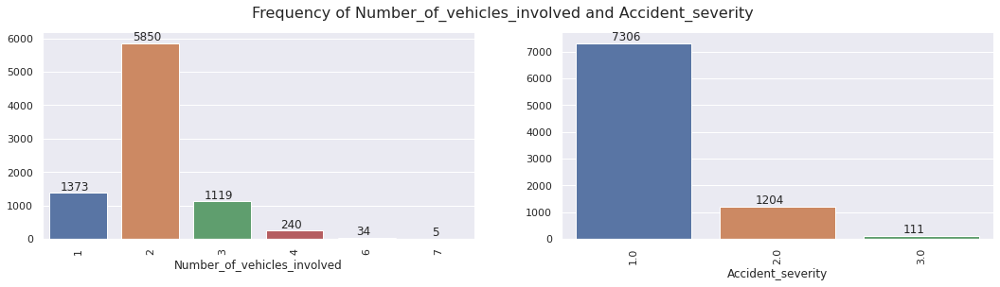


Showing Frequency Comparison of Number_of_vehicles_involved vs Accident_severity



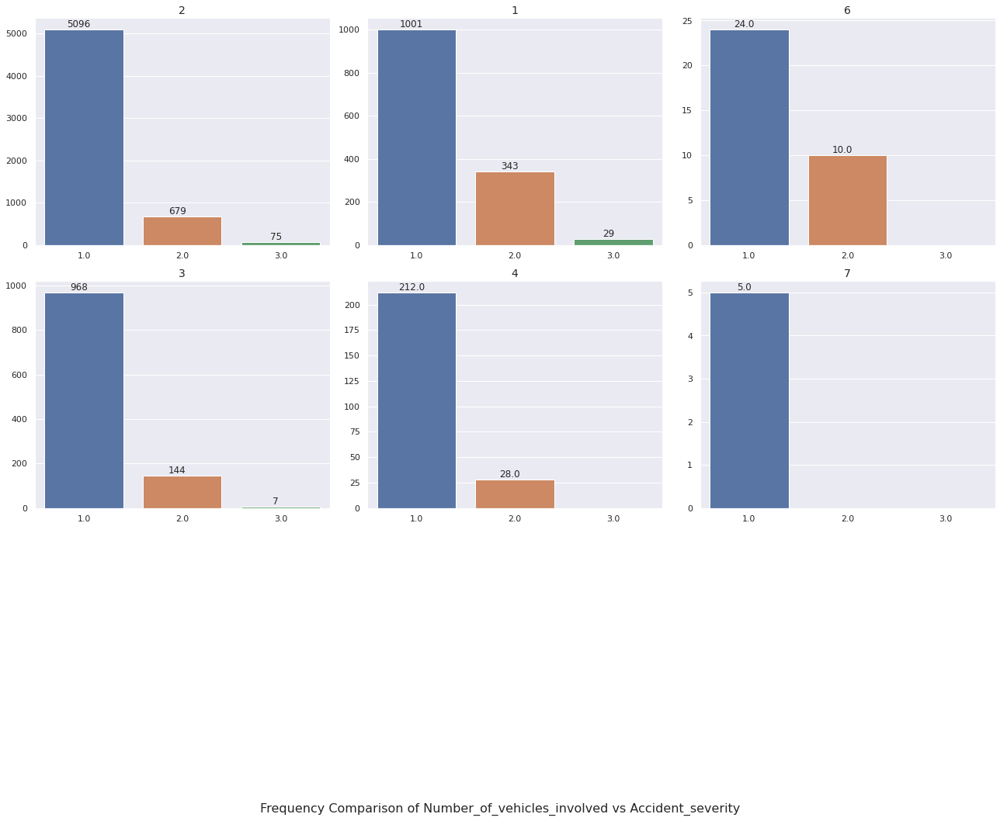




Showing Frequency Plots here for Time_of_day_Morning:



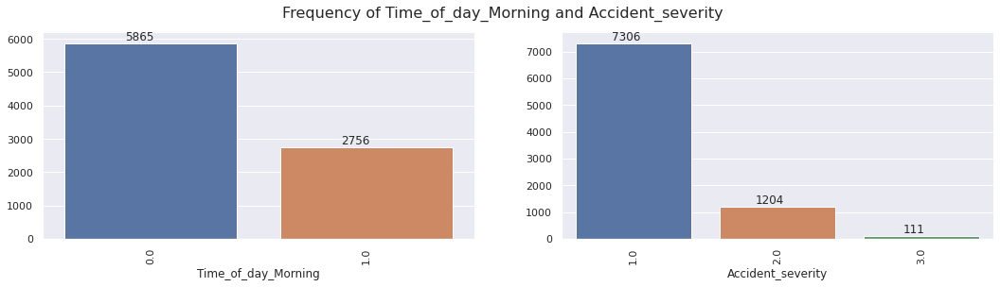


Showing Frequency Comparison of Time_of_day_Morning vs Accident_severity



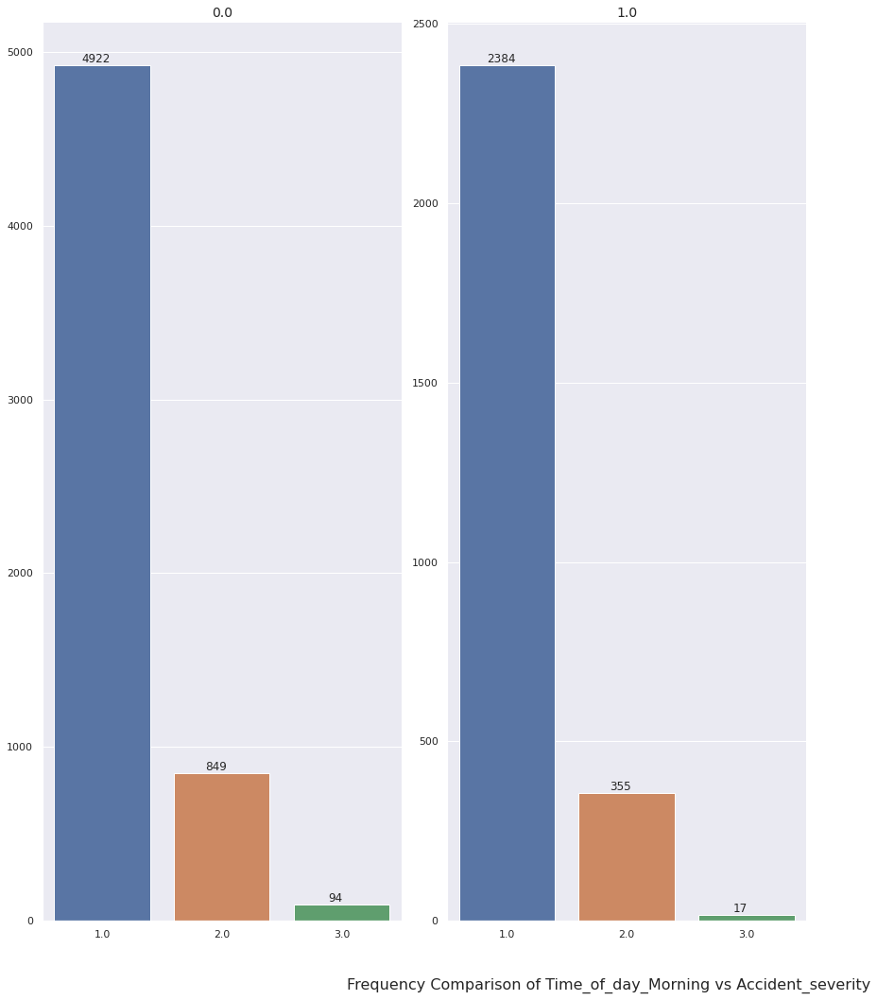




Showing Frequency Plots here for Types_of_Junction_No_junction:



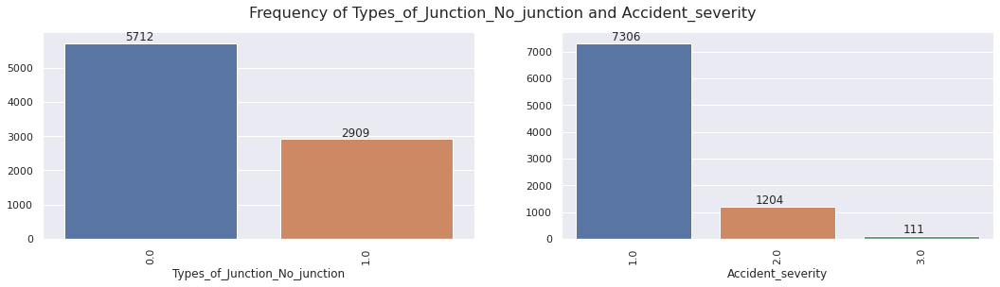


Showing Frequency Comparison of Types_of_Junction_No_junction vs Accident_severity



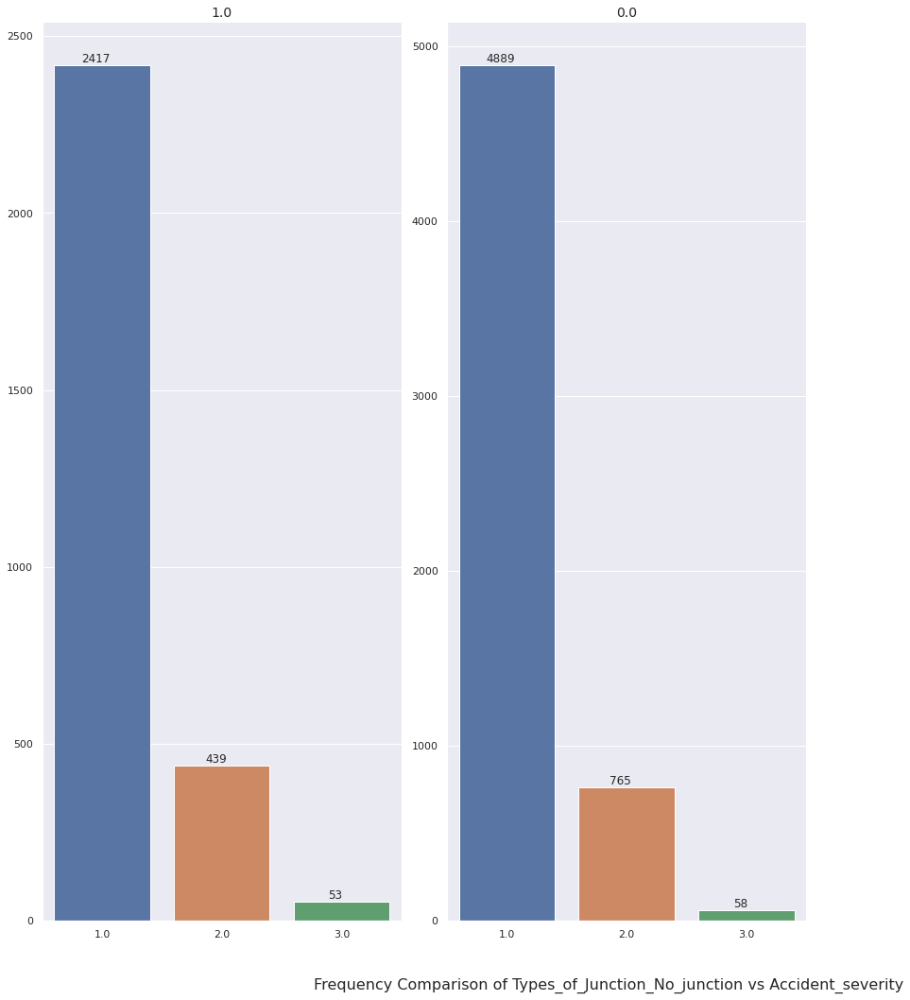

In [21]:
for col in chi2_p_vals[chi2_p_vals.Test_result == "Rejected"].index:
    column_barplot(df_cat, col, "Accident_severity", (18, 4))

In [22]:
df_chi = df_cat[list(selected_cols[0]) + [target_col]]
df_test_chi = df_test_cat[list(selected_cols[0]) + [target_col]]
# Checking the columns of train and test data are equal
assert list(df_test_chi.columns) == list(df_chi.columns)

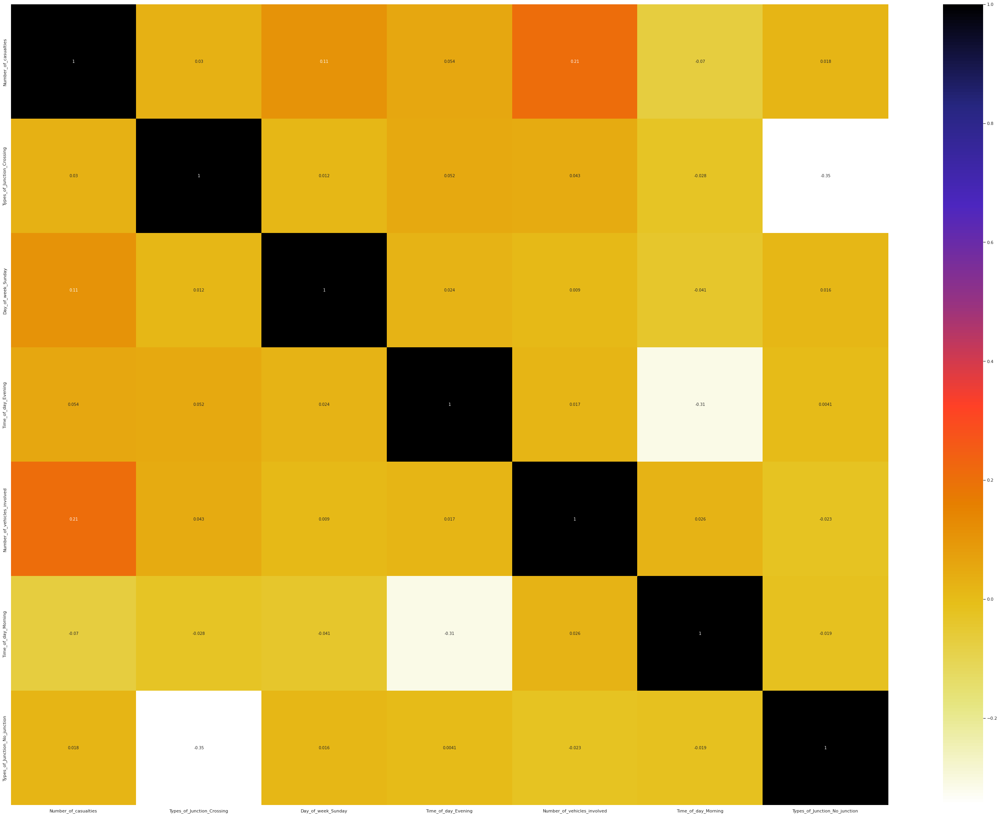

In [23]:
# Checking the modified Heatmap
data_heat = df_chi.drop(target_col, axis = 1)
fig_len = 50
heatmap(data_heat, (fig_len, fig_len*0.75))

## Analysis

### Train Test split for analysis

In [24]:
X_train, y_train = predictor_target_split(df_chi, target_col)
X_test, y_test = predictor_target_split(df_test_chi, target_col)

### General function

In [25]:
# Computation of confusion matrix
def conf_mat(y_pred, y_test):
    class_names = ['Slight', 'Serious', 'Fatal']
    tick_marks_y = [0.5, 1.5, 2.5]
    tick_marks_x = [0.5, 1.5, 2.5]
    confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
    confusion_matrix_df = pd.DataFrame(confusion_matrix, range(3), range(3))
    plt.figure(figsize = (6, 4.75))
    sns.set(font_scale = 1.4) # label size
    plt.title("Confusion Matrix")
    sns.heatmap(confusion_matrix_df, annot = True, annot_kws = {"size": 16}, fmt = 'd') # font size
    plt.yticks(tick_marks_y, class_names, rotation = 'vertical')
    plt.xticks(tick_marks_x, class_names, rotation = 'horizontal')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.grid(False)
    plt.show()

# Objective function
def objective_func(trial, mdl, model_type, data = X_train, target = y_train, bta = 0.2):
    if model_type == "rf":
        param = {
            "n_estimators": trial.suggest_int("n_estimators", 20, 200),
            "max_depth": trial.suggest_int("max_depth", 2, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "max_features": trial.suggest_float("max_features", 0.01, 0.95),
            # "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 2, 20),
            # "min_weight_fraction_leaf": trial.suggest_float("min_weight_fraction_leaf", 0.0, 0.4)
        }
    if model_type == "dt":
        param = {
            "max_depth": trial.suggest_int("max_depth", 2, 20),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "max_features": trial.suggest_float("max_features", 0.01, 0.95),
            "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 2, 20)
        }
    if model_type == "gnb":
        param = {
            "var_smoothing": trial.suggest_float("var_smoothing", 1e-9, 1e-2)
        }

    model = mdl(**param)
    fbeta_scorer = metrics.make_scorer(metrics.fbeta_score, beta=bta, average="weighted")
    kfolds = KFold(n_splits = 6, shuffle = True, random_state = 445)
    scores = cross_val_score(model, data, target, cv = kfolds, scoring = fbeta_scorer)
    # return scores.mean()
    return min(scores)

# Tuning function
def tuner(objective, n = 20, direction = 'maximize'):

    # Create Study object
    study = optuna.create_study(direction = direction)

    # Optimize the study
    study.optimize(objective, n_trials = n)
    display(optuna.visualization.plot_optimization_history(study))

    # Print the result
    best_params = study.best_params
    best_score = study.best_value
    print(f"Best Fbeta score: {best_score}")
    print(f"Optimized parameters: {best_params}\n")
    print("-------- Tuning complete --------")
    
    # Return best parameters for the model
    plt.show()
    return best_params, best_score

### Baseline Model

In [26]:
# Summary dictionary initialization
f1_dict = {}

###### Decision Tree Classifier:-

Weighted F1-score on the test set: 0.8067107213229711
Weighted F1-score on the train set: 0.8188607376828336


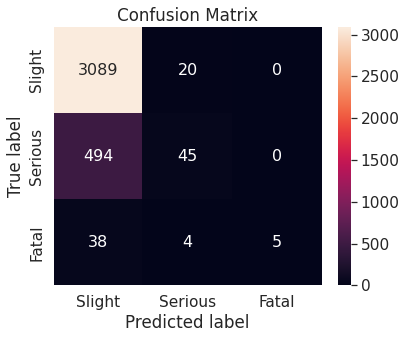

In [27]:
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, dt.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Decision Tree'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Random Forest Classifier:-

Weighted F1-score on the test set: 0.8049999038040863
Weighted F1-score on the train set: 0.8190320380967296


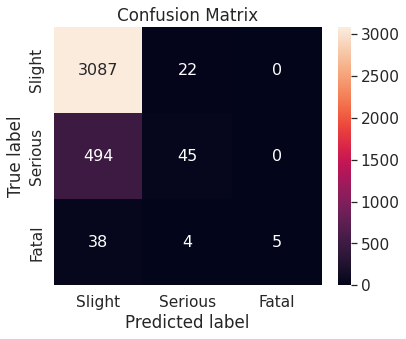

In [28]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, rf.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Random Forest'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Extra Trees Classifier:-

Weighted F1-score on the test set: 0.8067107213229711
Weighted F1-score on the train set: 0.8188607376828336


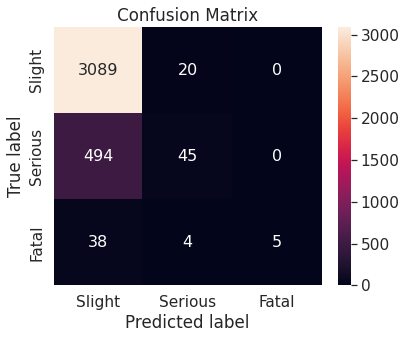

In [29]:
extree = ExtraTreesClassifier()
extree.fit(X_train, y_train)
y_pred = extree.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, extree.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['ExtraTrees'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Gaussian NB:-

Weighted F1-score on the test set: 0.7227975701441417
Weighted F1-score on the train set: 0.7409162224813038


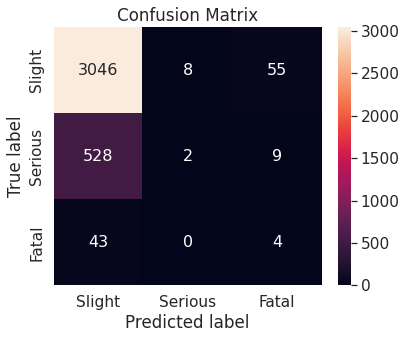

In [30]:
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred = gnb.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, gnb.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['GaussianNB'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Linear Discriminant Analysis:-

Weighted F1-score on the test set: 0.7118839108728495
Weighted F1-score on the train set: 0.7218814068004645


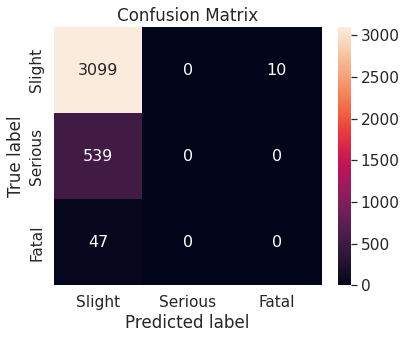

In [31]:
lda = LinearDiscriminantAnalysis()
lda.fit(X_train, y_train)
y_pred = lda.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, lda.predict(X_train), beta=0.2, average = 'weighted')
f1_dict['Linear Discriminant Analysis'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

##### Summary F score:

In [32]:
# Summary dataframe
f1_df = pd.DataFrame(f1_dict.items(), columns = ['Classifier', 'F1-score (test vs train)'])
f1_df.sort_values(by = ['F1-score (test vs train)'][0], ascending = False)

,Classifier,F1-score (test vs train)
0,Decision Tree,"(0.8067107213229711, -----------, 0.8188607376..."
2,ExtraTrees,"(0.8067107213229711, -----------, 0.8188607376..."
1,Random Forest,"(0.8049999038040863, -----------, 0.8190320380..."
3,GaussianNB,"(0.7227975701441417, -----------, 0.7409162224..."
4,Linear Discriminant Analysis,"(0.7118839108728495, -----------, 0.7218814068..."


### Hyperparameter Tuning

In [33]:
f2_dict = {}

###### Random Forest Classifier:-

[I 2022-04-19 08:57:42,146] A new study created in memory with name: no-name-662342f5-90c1-463a-823c-7af6d1a6b8a0
[I 2022-04-19 08:57:42,737] Trial 0 finished with value: 0.7764513573601206 and parameters: {'n_estimators': 25, 'max_depth': 13, 'min_samples_split': 12, 'max_features': 0.1118137537144376}. Best is trial 0 with value: 0.7764513573601206.
[I 2022-04-19 08:57:45,462] Trial 1 finished with value: 0.7738410566959733 and parameters: {'n_estimators': 114, 'max_depth': 11, 'min_samples_split': 9, 'max_features': 0.6153850503729454}. Best is trial 0 with value: 0.7764513573601206.
[I 2022-04-19 08:57:47,063] Trial 2 finished with value: 0.7748035829987893 and parameters: {'n_estimators': 75, 'max_depth': 12, 'min_samples_split': 13, 'max_features': 0.349910623318036}. Best is trial 0 with value: 0.7764513573601206.
[I 2022-04-19 08:57:50,468] Trial 3 finished with value: 0.7738410566959733 and parameters: {'n_estimators': 163, 'max_depth': 19, 'min_samples_split': 8, 'max_feature

Best Fbeta score: 0.7806783119494621
Optimized parameters: {'n_estimators': 70, 'max_depth': 20, 'min_samples_split': 14, 'max_features': 0.8629132322075169}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7998833800352159
Weighted F1-score on the train set: 0.816243171470288


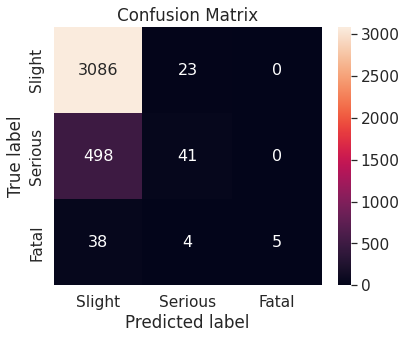

In [34]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_rf(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, RandomForestClassifier, "rf", data, target, bta)

rf_param, rf_score = tuner(objective_rf, n = 200)
rf_tuned = RandomForestClassifier(**rf_param)
rf_tuned.fit(X_train, y_train)
y_pred = rf_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, rf_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Random Forest (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 09:06:58,500] A new study created in memory with name: no-name-cf9b7840-1347-44c0-9ffc-b1dc6d76aa24
[I 2022-04-19 09:07:01,563] Trial 0 finished with value: 0.7975767100376102 and parameters: {'n_estimators': 199, 'max_depth': 2, 'min_samples_split': 16, 'max_features': 0.2532845658653879}. Best is trial 0 with value: 0.7975767100376102.
[I 2022-04-19 09:07:03,332] Trial 1 finished with value: 0.807890013677829 and parameters: {'n_estimators': 77, 'max_depth': 8, 'min_samples_split': 11, 'max_features': 0.6348703129640287}. Best is trial 1 with value: 0.807890013677829.
[I 2022-04-19 09:07:06,241] Trial 2 finished with value: 0.807890013677829 and parameters: {'n_estimators': 122, 'max_depth': 11, 'min_samples_split': 13, 'max_features': 0.6349944662722539}. Best is trial 1 with value: 0.807890013677829.
[I 2022-04-19 09:07:09,421] Trial 3 finished with value: 0.8071854788996436 and parameters: {'n_estimators': 158, 'max_depth': 12, 'min_samples_split': 6, 'max_features':

Best Fbeta score: 0.8088391697477024
Optimized parameters: {'n_estimators': 139, 'max_depth': 8, 'min_samples_split': 9, 'max_features': 0.41625967837436617}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7996208707425113
Weighted F1-score on the train set: 0.812061221977598


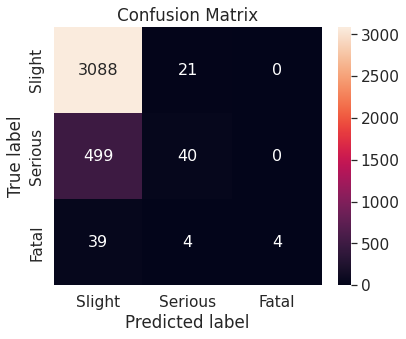

In [35]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_rf(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, RandomForestClassifier, "rf", data, target, bta)

rf_param, rf_score = tuner(objective_rf, n = 200)
rf_tuned = RandomForestClassifier(**rf_param)
rf_tuned.fit(X_train, y_train)
y_pred = rf_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, rf_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Random Forest (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Decision Tree Classifier:-

[I 2022-04-19 09:15:59,734] A new study created in memory with name: no-name-5c502541-7a15-49f9-8235-7829cff8bc36
[I 2022-04-19 09:15:59,797] Trial 0 finished with value: 0.6937658204009459 and parameters: {'max_depth': 6, 'min_samples_split': 17, 'max_features': 0.0917882334655368, 'max_leaf_nodes': 7}. Best is trial 0 with value: 0.6937658204009459.
[I 2022-04-19 09:15:59,858] Trial 1 finished with value: 0.7199625582483317 and parameters: {'max_depth': 4, 'min_samples_split': 9, 'max_features': 0.6720880433545741, 'max_leaf_nodes': 12}. Best is trial 1 with value: 0.7199625582483317.
[I 2022-04-19 09:15:59,925] Trial 2 finished with value: 0.6937658204009459 and parameters: {'max_depth': 10, 'min_samples_split': 12, 'max_features': 0.8452427741534696, 'max_leaf_nodes': 4}. Best is trial 1 with value: 0.7199625582483317.
[I 2022-04-19 09:15:59,987] Trial 3 finished with value: 0.727702892462888 and parameters: {'max_depth': 17, 'min_samples_split': 20, 'max_features': 0.8708784831973

Best Fbeta score: 0.7728243119389224
Optimized parameters: {'max_depth': 6, 'min_samples_split': 3, 'max_features': 0.9313074457979958, 'max_leaf_nodes': 20}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7779513078978931
Weighted F1-score on the train set: 0.7903487601965362


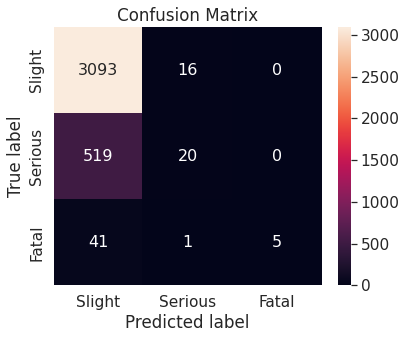

In [36]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_dt(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, DecisionTreeClassifier, "dt", data, target, bta)

dt_param, dt_score = tuner(objective_dt, n = 200)
dt_tuned = DecisionTreeClassifier(**dt_param)
dt_tuned.fit(X_train, y_train)
y_pred = dt_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, dt_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Decision Tree (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 09:16:14,904] A new study created in memory with name: no-name-f03ddbd8-b01b-456e-8cbd-f73c3cb14f74
[I 2022-04-19 09:16:14,963] Trial 0 finished with value: 0.7998163237098704 and parameters: {'max_depth': 11, 'min_samples_split': 8, 'max_features': 0.7884967563028223, 'max_leaf_nodes': 15}. Best is trial 0 with value: 0.7998163237098704.
[I 2022-04-19 09:16:15,021] Trial 1 finished with value: 0.8009081245678716 and parameters: {'max_depth': 17, 'min_samples_split': 11, 'max_features': 0.8214364667914861, 'max_leaf_nodes': 17}. Best is trial 1 with value: 0.8009081245678716.
[I 2022-04-19 09:16:15,077] Trial 2 finished with value: 0.8016795784322371 and parameters: {'max_depth': 8, 'min_samples_split': 2, 'max_features': 0.06313610549918985, 'max_leaf_nodes': 16}. Best is trial 2 with value: 0.8016795784322371.
[I 2022-04-19 09:16:15,136] Trial 3 finished with value: 0.8003623061123859 and parameters: {'max_depth': 17, 'min_samples_split': 17, 'max_features': 0.412208110

Best Fbeta score: 0.8079815872344696
Optimized parameters: {'max_depth': 9, 'min_samples_split': 15, 'max_features': 0.9045544795337814, 'max_leaf_nodes': 20}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7740905650989631
Weighted F1-score on the train set: 0.7929378266620083


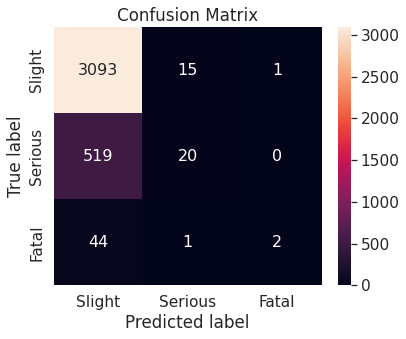

In [37]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_dt(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, DecisionTreeClassifier, "dt", data, target, bta)

dt_param, dt_score = tuner(objective_dt, n = 200)
dt_tuned = DecisionTreeClassifier(**dt_param)
dt_tuned.fit(X_train, y_train)
y_pred = dt_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, dt_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Decision Tree (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Extra Trees Classifier:-

[I 2022-04-19 09:16:30,207] A new study created in memory with name: no-name-8b45527e-31df-4218-8ab4-a3550998e1ef
[I 2022-04-19 09:16:30,971] Trial 0 finished with value: 0.7731635798338934 and parameters: {'n_estimators': 39, 'max_depth': 8, 'min_samples_split': 3, 'max_features': 0.4743343427850661}. Best is trial 0 with value: 0.7731635798338934.
[I 2022-04-19 09:16:32,014] Trial 1 finished with value: 0.7764513573601206 and parameters: {'n_estimators': 51, 'max_depth': 15, 'min_samples_split': 14, 'max_features': 0.5391387869879357}. Best is trial 1 with value: 0.7764513573601206.
[I 2022-04-19 09:16:33,445] Trial 2 finished with value: 0.7776985691327544 and parameters: {'n_estimators': 68, 'max_depth': 8, 'min_samples_split': 2, 'max_features': 0.7623866178647015}. Best is trial 2 with value: 0.7776985691327544.
[I 2022-04-19 09:16:34,080] Trial 3 finished with value: 0.6937658204009459 and parameters: {'n_estimators': 45, 'max_depth': 3, 'min_samples_split': 17, 'max_features': 

Best Fbeta score: 0.7829283526917832
Optimized parameters: {'n_estimators': 68, 'max_depth': 9, 'min_samples_split': 15, 'max_features': 0.3804408412683672}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.790152004702905
Weighted F1-score on the train set: 0.8124138946918354


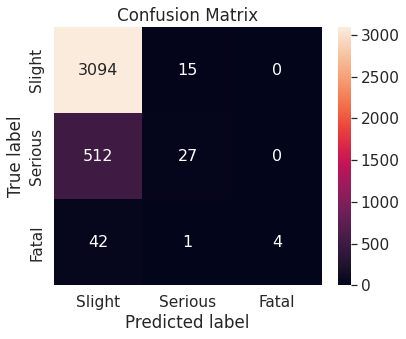

In [38]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_et(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, ExtraTreesClassifier, "rf", data, target, bta)

et_param, et_score = tuner(objective_et, n = 200)
et_tuned = ExtraTreesClassifier(**et_param)
et_tuned.fit(X_train, y_train)
y_pred = et_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, et_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Extra Trees (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 09:21:13,216] A new study created in memory with name: no-name-62be6e88-a563-4630-ae7c-4d96d7988ab5
[I 2022-04-19 09:21:16,165] Trial 0 finished with value: 0.8066339397988752 and parameters: {'n_estimators': 169, 'max_depth': 19, 'min_samples_split': 3, 'max_features': 0.016298702273810077}. Best is trial 0 with value: 0.8066339397988752.
[I 2022-04-19 09:21:18,257] Trial 1 finished with value: 0.7975767100376102 and parameters: {'n_estimators': 149, 'max_depth': 2, 'min_samples_split': 8, 'max_features': 0.714853133376372}. Best is trial 0 with value: 0.8066339397988752.
[I 2022-04-19 09:21:20,125] Trial 2 finished with value: 0.7975767100376102 and parameters: {'n_estimators': 138, 'max_depth': 5, 'min_samples_split': 7, 'max_features': 0.09271828347686102}. Best is trial 0 with value: 0.8066339397988752.
[I 2022-04-19 09:21:22,922] Trial 3 finished with value: 0.8067878408082522 and parameters: {'n_estimators': 144, 'max_depth': 11, 'min_samples_split': 14, 'max_featu

Best Fbeta score: 0.8089621447983062
Optimized parameters: {'n_estimators': 105, 'max_depth': 9, 'min_samples_split': 11, 'max_features': 0.10506944421859601}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7960632552716156
Weighted F1-score on the train set: 0.8130263181055323


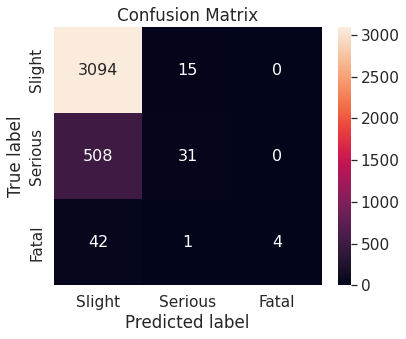

In [39]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_et(trail, data = X_train, target = y_train, bta = 2):
    return objective_func(trail, ExtraTreesClassifier, "rf", data, target, bta)

et_param, et_score = tuner(objective_et, n = 200)
et_tuned = ExtraTreesClassifier(**et_param)
et_tuned.fit(X_train, y_train)
y_pred = et_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, et_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Extra Trees (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

###### Gaussian NB:-

[I 2022-04-19 09:27:55,689] A new study created in memory with name: no-name-fa2efad9-9ee4-4d43-8be7-5bb04e6f0147
[I 2022-04-19 09:27:55,751] Trial 0 finished with value: 0.7099196237882018 and parameters: {'var_smoothing': 0.0073098560530362065}. Best is trial 0 with value: 0.7099196237882018.
[I 2022-04-19 09:27:55,813] Trial 1 finished with value: 0.7099196237882018 and parameters: {'var_smoothing': 0.007761016290924791}. Best is trial 0 with value: 0.7099196237882018.
[I 2022-04-19 09:27:55,881] Trial 2 finished with value: 0.7099196237882018 and parameters: {'var_smoothing': 0.00944139479003869}. Best is trial 0 with value: 0.7099196237882018.
[I 2022-04-19 09:27:55,951] Trial 3 finished with value: 0.7099196237882018 and parameters: {'var_smoothing': 0.008467879589562957}. Best is trial 0 with value: 0.7099196237882018.
[I 2022-04-19 09:27:56,016] Trial 4 finished with value: 0.7100676764061933 and parameters: {'var_smoothing': 0.0015453942229313674}. Best is trial 4 with value: 

Best Fbeta score: 0.7102876638868321
Optimized parameters: {'var_smoothing': 0.003508249809850641}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7234158040587658
Weighted F1-score on the train set: 0.7414779578079996


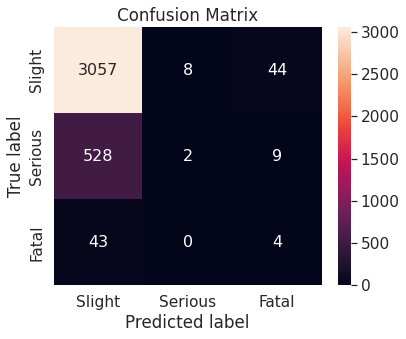

In [40]:
# Tuning the parameters and plotting optimization history
# beta = 0.2
def objective_gnb(trail, data = X_train, target = y_train, bta = 0.2):
    return objective_func(trail, GaussianNB, "gnb", data, target, bta)

gnb_param, gnb_score = tuner(objective_gnb, n = 1000)
gnb_tuned = GaussianNB(**gnb_param)
gnb_tuned.fit(X_train, y_train)
y_pred = gnb_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, gnb_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Gaussian NB (fbeta 0.2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

[I 2022-04-19 09:29:09,231] A new study created in memory with name: no-name-568e9b02-7577-480a-9e7c-9cbc5bc6e602
[I 2022-04-19 09:29:09,320] Trial 0 finished with value: 0.8124536461437184 and parameters: {'var_smoothing': 0.002327638613296021}. Best is trial 0 with value: 0.8124536461437184.
[I 2022-04-19 09:29:09,385] Trial 1 finished with value: 0.8124536461437184 and parameters: {'var_smoothing': 0.0031174758701311258}. Best is trial 0 with value: 0.8124536461437184.
[I 2022-04-19 09:29:09,446] Trial 2 finished with value: 0.816618487969263 and parameters: {'var_smoothing': 0.007840337553052641}. Best is trial 2 with value: 0.816618487969263.
[I 2022-04-19 09:29:09,512] Trial 3 finished with value: 0.816618487969263 and parameters: {'var_smoothing': 0.006986459952921477}. Best is trial 2 with value: 0.816618487969263.
[I 2022-04-19 09:29:09,575] Trial 4 finished with value: 0.8124536461437184 and parameters: {'var_smoothing': 0.0038413767244117342}. Best is trial 2 with value: 0.8

Best Fbeta score: 0.8180067458509404
Optimized parameters: {'var_smoothing': 0.009677839245087427}

-------- Tuning complete --------
Weighted F1-score on the test set: 0.7234158040587658
Weighted F1-score on the train set: 0.7413052839897397


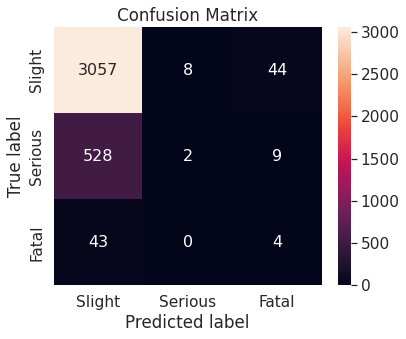

In [41]:
# Tuning the parameters and plotting optimization history
# beta = 2
def objective_gnb(trail, data = X_train, target = y_train, bta = 20):
    return objective_func(trail, GaussianNB, "gnb", data, target, bta)

gnb_param, gnb_score = tuner(objective_gnb, n = 1000)
gnb_tuned = GaussianNB(**gnb_param)
gnb_tuned.fit(X_train, y_train)
y_pred = gnb_tuned.predict(X_test)
score = metrics.fbeta_score(y_test, y_pred, beta=0.2, average = 'weighted')
print("Weighted F1-score on the test set: {}".format(score))
t_score = metrics.fbeta_score(y_train, gnb_tuned.predict(X_train), beta=0.2, average = 'weighted')
f2_dict['Gaussian NB (fbeta 2)'] = (score, "-----------", t_score)
print("Weighted F1-score on the train set: {}".format(t_score))
conf_mat(y_pred, y_test)

##### Summary F score:

In [42]:
# Summary dataframe
f2_df = pd.DataFrame(f2_dict.items(), columns = ['Classifier', 'F1-score (test vs train)'])
f2_df.sort_values(by = ['F1-score (test vs train)'], ascending = False)

,Classifier,F1-score (test vs train)
0,Random Forest (fbeta 0.2),"(0.7998833800352159, -----------, 0.8162431714..."
1,Random Forest (fbeta 2),"(0.7996208707425113, -----------, 0.8120612219..."
5,Extra Trees (fbeta 2),"(0.7960632552716156, -----------, 0.8130263181..."
4,Extra Trees (fbeta 0.2),"(0.790152004702905, -----------, 0.81241389469..."
2,Decision Tree (fbeta 0.2),"(0.7779513078978931, -----------, 0.7903487601..."
3,Decision Tree (fbeta 2),"(0.7740905650989631, -----------, 0.7929378266..."
6,Gaussian NB (fbeta 0.2),"(0.7234158040587658, -----------, 0.7414779578..."
7,Gaussian NB (fbeta 2),"(0.7234158040587658, -----------, 0.7413052839..."


## Final Thoughts